In [18]:
# Import necessary packages
from gerrychain import (GeographicPartition, Partition, Graph, MarkovChain,
                        proposals, updaters, constraints, accept, Election, grid)
from gerrychain.metrics import mean_median, partisan_bias, polsby_popper, efficiency_gap
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import inspect
import pickle
import geopandas as gp
from shapely.geometry import LineString, Polygon
from shapely.ops import unary_union
import itertools
import math

# Import tools file
from merges import *
from plotting import *

In [107]:
len(Graph.from_json('ChainUtilityData/graph_combined_vs_2018.json'))

2640

AlternativePlans/graph_recom_1000000_new.json is contiguous according to single_flip_contiguous


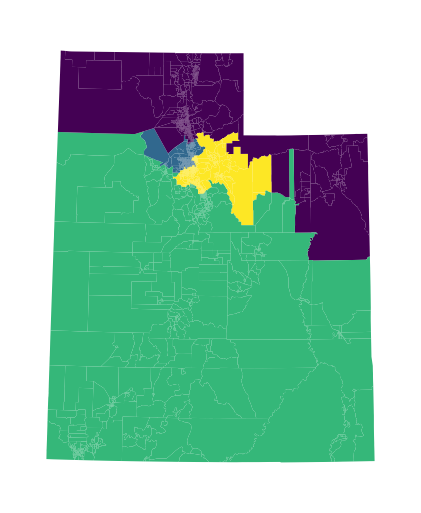

AlternativePlans/graph_recom_1000000_new.json is contiguous according to single_flip_contiguous


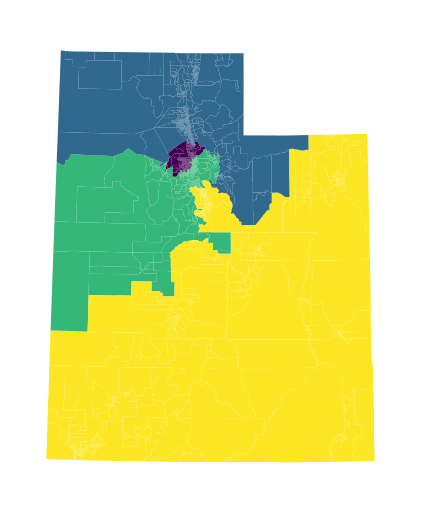

AlternativePlans/graph_recom_1000000_new.json is contiguous according to single_flip_contiguous


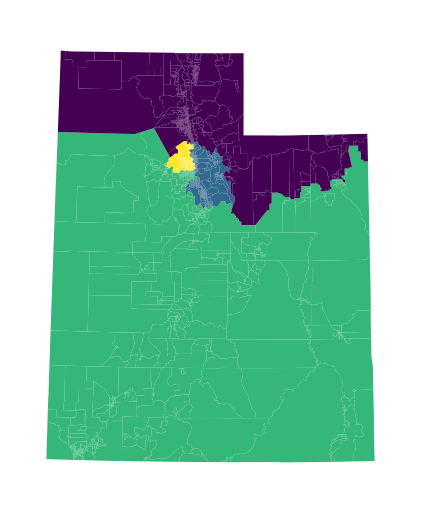

AlternativePlans/graph_recom_1000000_new.json is contiguous according to single_flip_contiguous


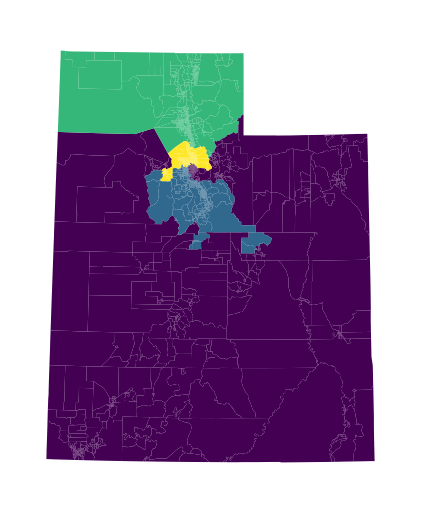

AlternativePlans/graph_recom_1000000_new.json is contiguous according to single_flip_contiguous


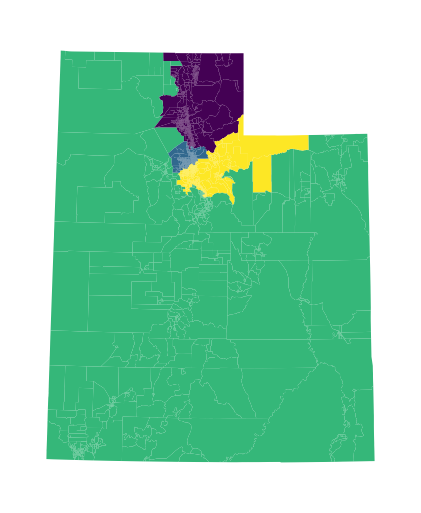

AlternativePlans/graph_recom_1000000_new.json is contiguous according to single_flip_contiguous


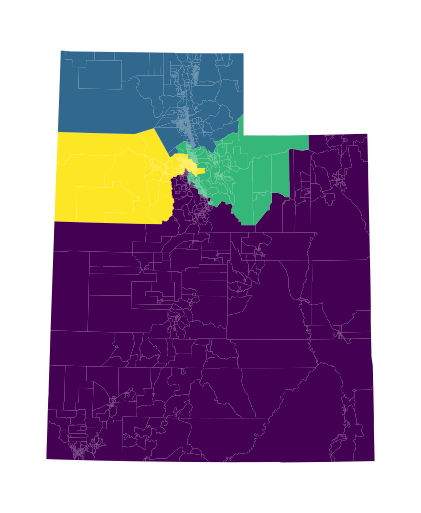

AlternativePlans/graph_recom_1000000_new.json is contiguous according to single_flip_contiguous


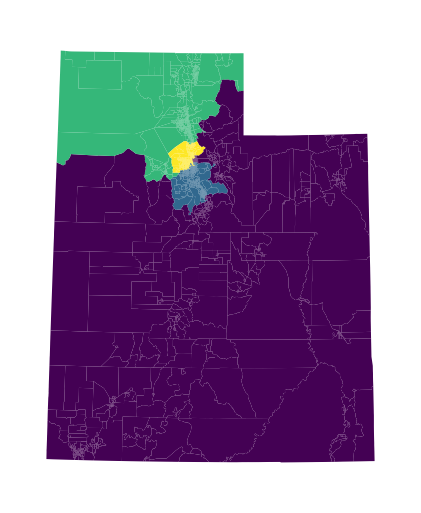

AlternativePlans/graph_recom_1000000_new.json is contiguous according to single_flip_contiguous


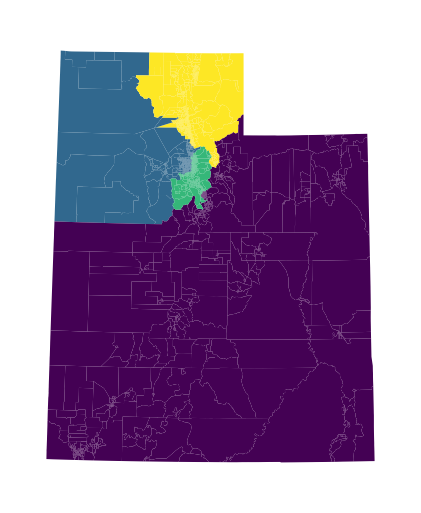

AlternativePlans/graph_recom_1000000_new.json is contiguous according to single_flip_contiguous


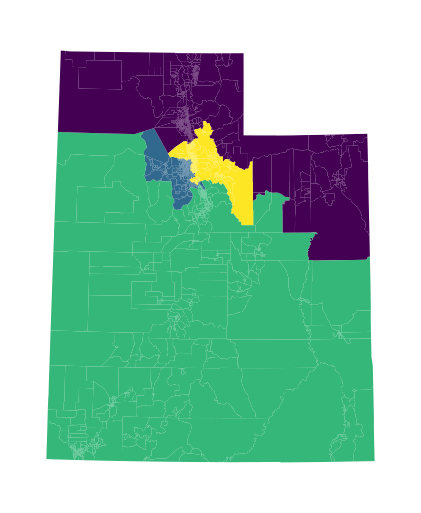

AlternativePlans/graph_recom_1000000_new.json is contiguous according to single_flip_contiguous


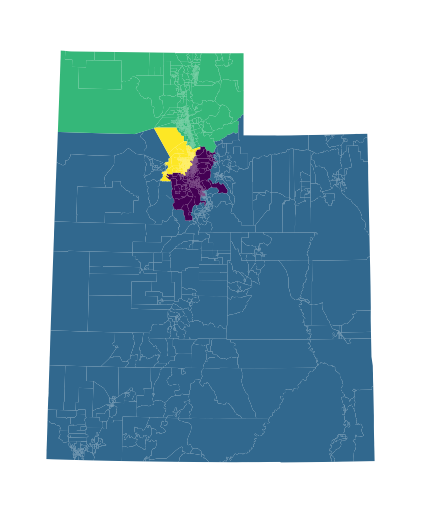

US_Distric is contiguous according to single_flip_contiguous


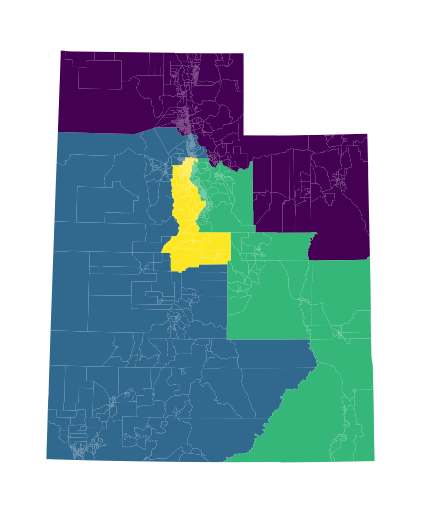

UT_HOUSE is contiguous according to single_flip_contiguous


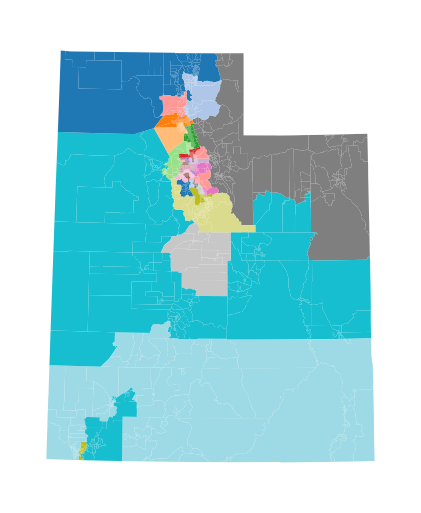

UT_SEN is contiguous according to single_flip_contiguous


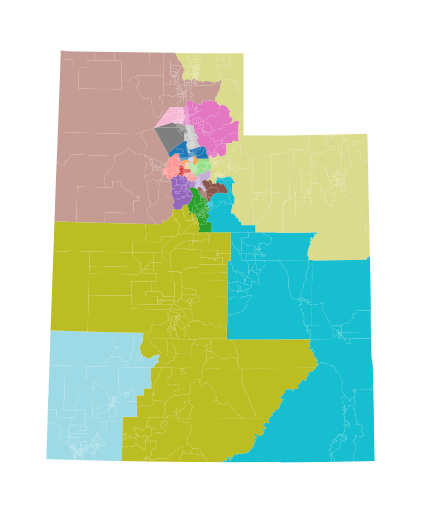

In [106]:
# Edges to add are based off of FixingUTHouseSen.ipynb, plus the edge (772, 1492) which Annika found

edges_to_add = [(216, 69), (216, 72), (130, 521), (130, 522), (100, 522), (100, 527), (100, 532), (100, 539), (211, 212), (772, 1492)]

non_contiguous = []

for  i in range(100000, 1100000, 100000):
    try:
        g = Graph.from_json(f'AlternativePlans/graph_recom_{i}_new.json')
        g.add_edges_from(edges_to_add, shared_perim=0.0)
        
        p = Partition(g, 'US_Distric')
        
        contiguous = constraints.single_flip_contiguous(p)
        if contiguous:
            print(f'{filename} is contiguous according to single_flip_contiguous')
        else:
            print(f'{filename} is NOT CONTIGUOUS according to single_flip_contiguous')
            non_contiguous.append(filename)
                
        plot_district_map(p.assignment, cmap='viridis', precincts='NewData/2018_all_votes_current.shp', save=True, savetitle=f'Plots/recom{i}plot.png')
        
        g.to_json(f'AlternativePlans/graph_recom_{i}_dec.json')
        
    except FileNotFoundError:
        print(f'Error opening {filename}')
        
g = Graph.from_json('ChainUtilityData/2018_all_votes_current_no_nan_add_edge.json')
g.add_edges_from(edges_to_add, shared_perim=0.0)

for kind in ['US_Distric', 'UT_HOUSE', 'UT_SEN']:
    p = Partition(g, kind)
    contiguous = constraints.single_flip_contiguous(p)
    if contiguous:
        print(f'{kind} is contiguous according to single_flip_contiguous')
    else:
        print(f'{kind} is NOT CONTIGUOUS according to single_flip_contiguous')
        non_contiguous.append(kind)
    if kind == 'US_Distric':
        plot_district_map(p.assignment, cmap='viridis', precincts='NewData/2018_all_votes_current.shp', save=True, savetitle=f'Plots/{kind}_december.png')
    else:
        plot_district_map(p.assignment, cmap='tab20', precincts='NewData/2018_all_votes_current.shp', save=True, savetitle=f'Plots/{kind}_december.png')
    
g.to_json('ChainUtilityData/graph_dec.json')

In [103]:
non_contiguous

[]

In [35]:
august_gdf = gp.read_file('UtahData/gdf_august.shp')
new_gdf = gp.read_file('NewData/2018_all_votes_current.shp')

In [39]:
all(august_gdf['geometry'] == new_gdf['geometry'])

True

In [40]:
august_graph = Graph.from_json('ChainUtilityData/graph_august.json')

In [49]:
dec_graph_annika = Graph.from_json('ChainUtilityData/2018_all_votes_current_no_nan_add_edge.json')

In [50]:
dec_graph = Graph.from_json('ChainUtilityData/2018_all_votes_current_no_nan.json')

In [52]:
def analyze_list_difference(list1, list2):
    not2 = []
    not1 = []
    for elem1 in list1:
        if elem1 not in list2:
            not2.append(elem1)
    for elem2 in list2:
        if elem2 not in list1:
            not1.append(elem2)
    return not1, not2
            
    

In [53]:
analyze_list_difference(list(dec_graph.edges), list(dec_graph_annika.edges))

([(69, 216), (72, 216), (772, 1492)], [])

In [54]:
analyze_list_difference(list(dec_graph.edges), list(august_graph.edges))

([(69, 216),
  (72, 216),
  (100, 522),
  (100, 527),
  (100, 532),
  (100, 539),
  (130, 521),
  (130, 522),
  (211, 212),
  (411, 412),
  (411, 455),
  (415, 442),
  (442, 487),
  (1259, 2588),
  (1949, 2193),
  (2631, 2638)],
 [])

In [55]:
analyze_list_difference(list(dec_graph_annika.edges), list(august_graph.edges))

([(100, 522),
  (100, 527),
  (100, 532),
  (100, 539),
  (130, 521),
  (130, 522),
  (211, 212),
  (411, 412),
  (411, 455),
  (415, 442),
  (442, 487),
  (1259, 2588),
  (1949, 2193),
  (2631, 2638)],
 [(772, 1492)])

In [70]:
def plot_outlines(indices, gdf):
    for i in indices:
        plt.plot(*gdf.iloc[i]['geometry'].exterior.coords.xy)
    plt.axis('off')
    plt.show()


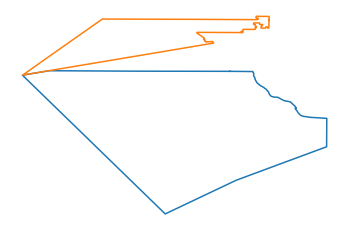

In [78]:
plot_outlines([772, 1492], new_gdf)

In [91]:
def neighborhood(G, node, n):
    path_lengths = nx.single_source_dijkstra_path_length(G, node)
    return [node for node, length in path_lengths.items()
                    if length == n]

In [99]:
neighborhood(dec_graph, 2, 1)

[13, 3, 5, 9, 1583, 136, 137, 131, 132]

1. Nodes 1 and 0 are connected


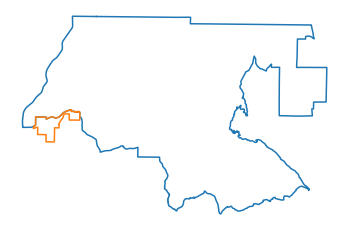

2. Nodes 3 and 2 are connected


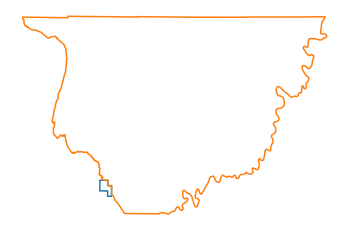

3. Nodes 4 and 1 are connected


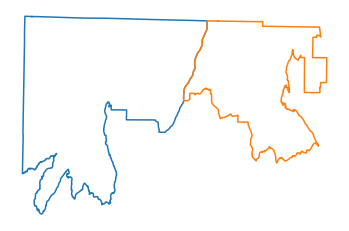

4. Nodes 5 and 2 are connected


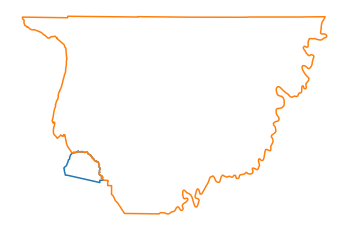

5. Nodes 5 and 3 are connected


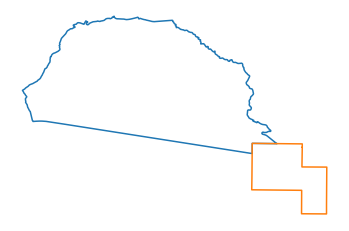

6. Nodes 6 and 0 are connected


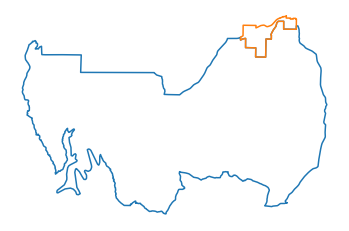

7. Nodes 6 and 1 are connected


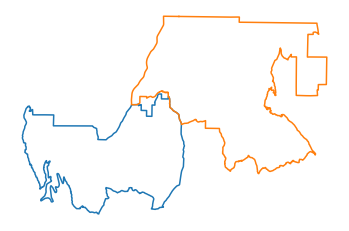

8. Nodes 6 and 4 are connected


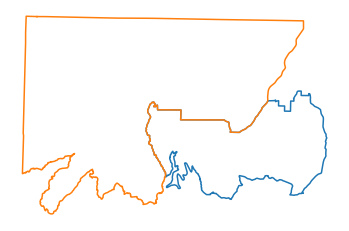

9. Nodes 8 and 7 are connected


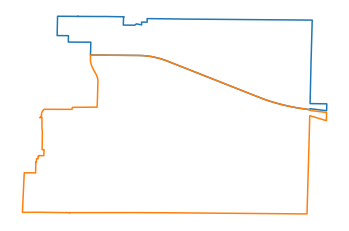

10. Nodes 9 and 1 are connected


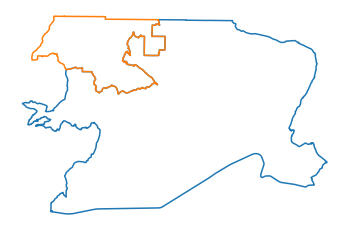

11. Nodes 9 and 2 are connected


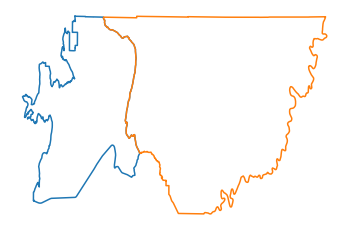

12. Nodes 9 and 5 are connected


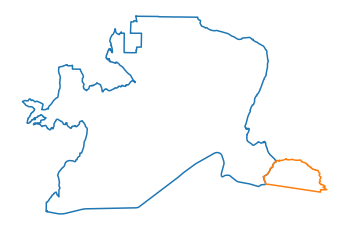

13. Nodes 9 and 6 are connected


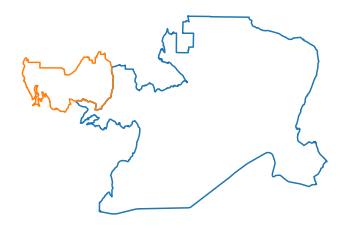

14. Nodes 9 and 7 are connected


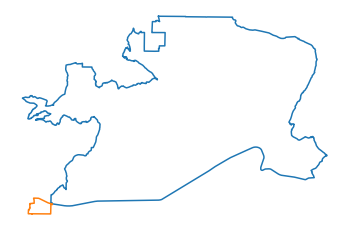

15. Nodes 9 and 8 are connected


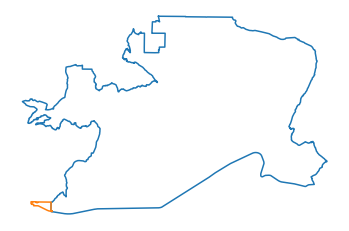

16. Nodes 10 and 7 are connected


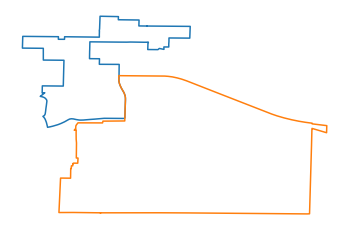

17. Nodes 10 and 8 are connected


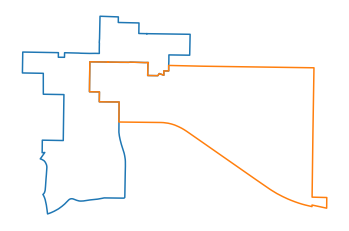

18. Nodes 11 and 8 are connected


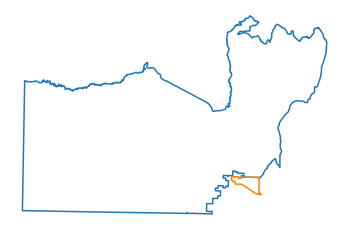

19. Nodes 11 and 9 are connected


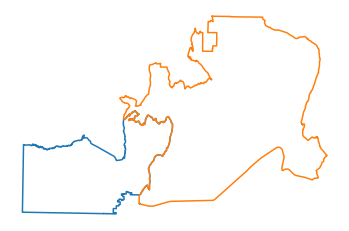

20. Nodes 11 and 10 are connected


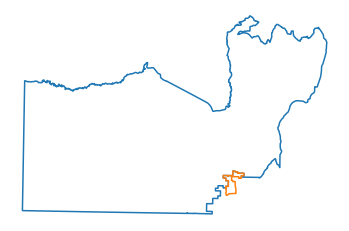

21. Nodes 12 and 7 are connected


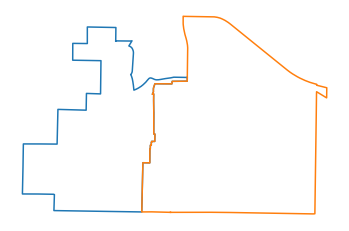

22. Nodes 12 and 10 are connected


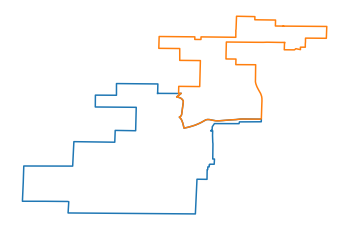

23. Nodes 12 and 11 are connected


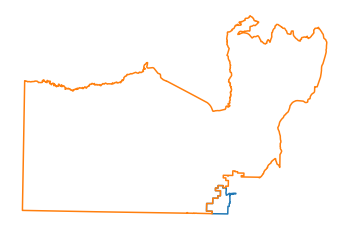

24. Nodes 13 and 2 are connected


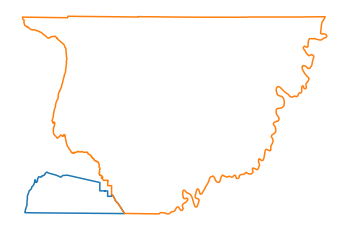

25. Nodes 13 and 3 are connected


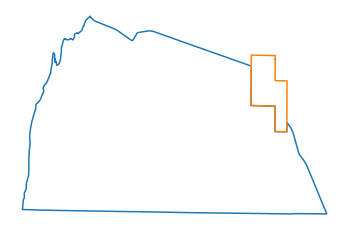

26. Nodes 13 and 5 are connected


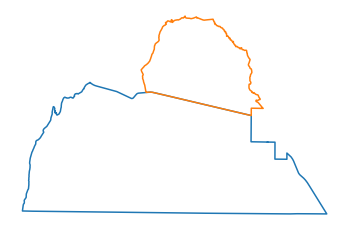

27. Nodes 13 and 9 are connected


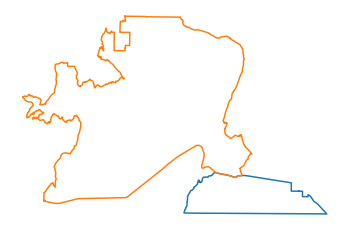

28. Nodes 14 and 4 are connected


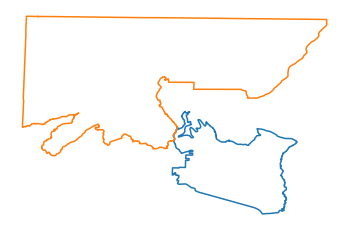

29. Nodes 14 and 6 are connected


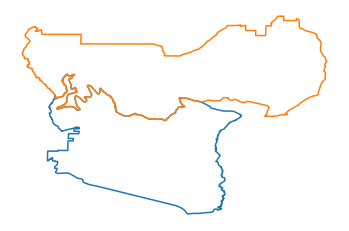

30. Nodes 14 and 9 are connected


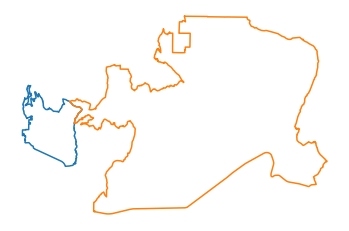

31. Nodes 14 and 11 are connected


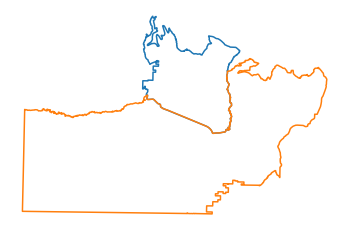

32. Nodes 15 and 4 are connected


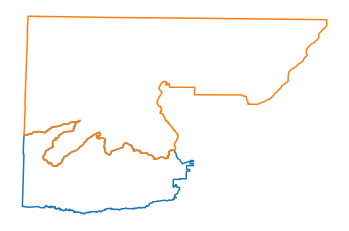

33. Nodes 15 and 11 are connected


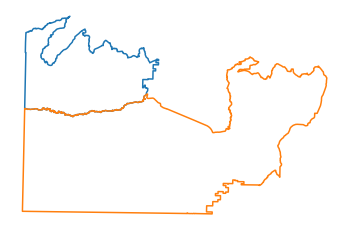

34. Nodes 15 and 14 are connected


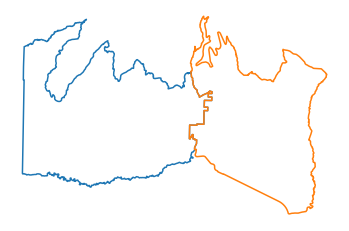

35. Nodes 16 and 7 are connected


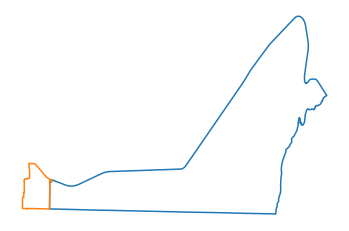

36. Nodes 16 and 9 are connected


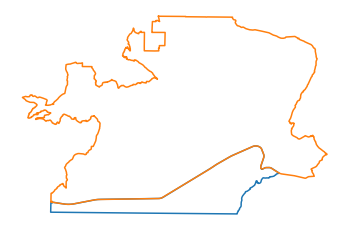

37. Nodes 16 and 13 are connected


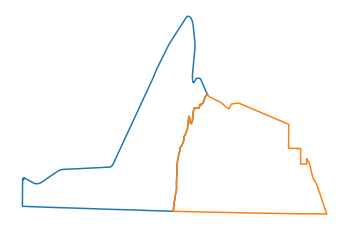

38. Nodes 20 and 19 are connected


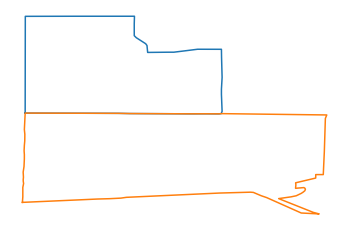

39. Nodes 22 and 20 are connected


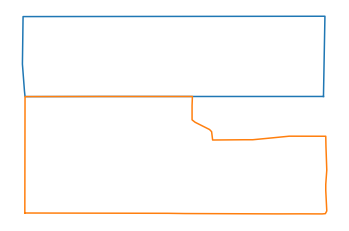

40. Nodes 23 and 17 are connected


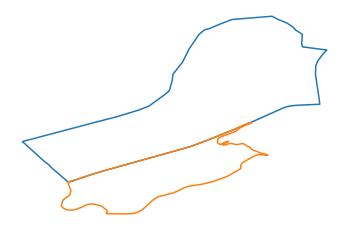

41. Nodes 24 and 17 are connected


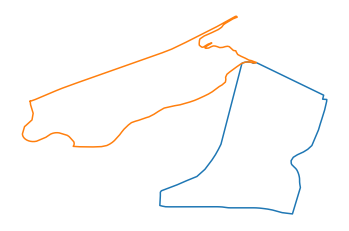

42. Nodes 25 and 24 are connected


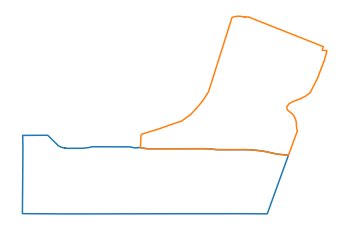

43. Nodes 31 and 29 are connected


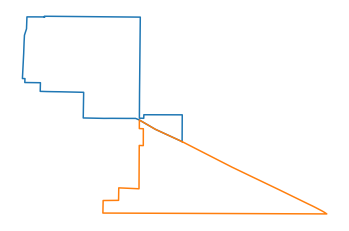

44. Nodes 31 and 30 are connected


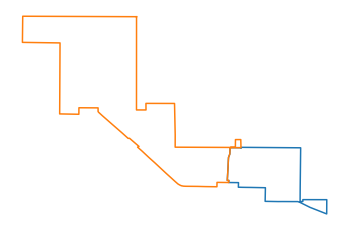

45. Nodes 32 and 30 are connected


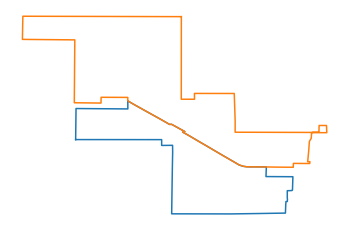

46. Nodes 33 and 23 are connected


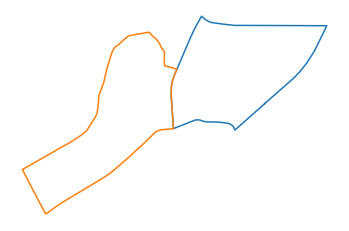

47. Nodes 35 and 34 are connected


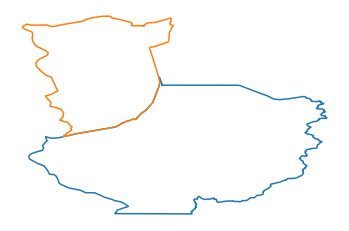

48. Nodes 36 and 17 are connected


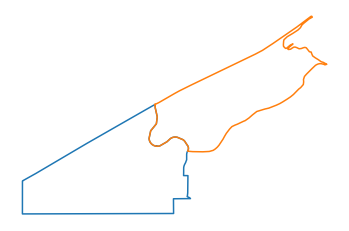

49. Nodes 38 and 21 are connected


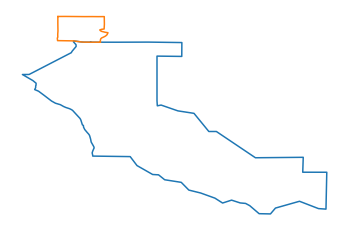

50. Nodes 39 and 18 are connected


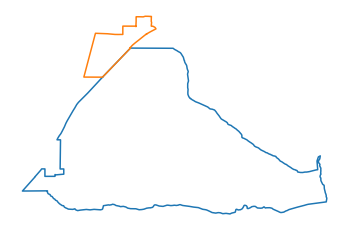

51. Nodes 39 and 38 are connected


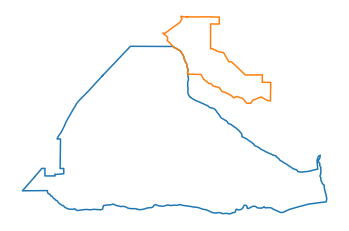

52. Nodes 40 and 39 are connected


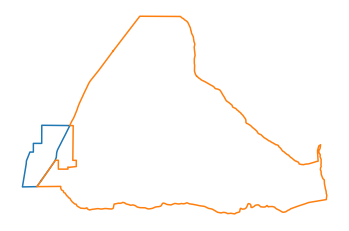

53. Nodes 41 and 39 are connected


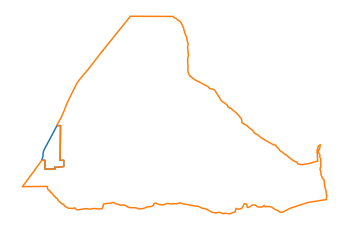

54. Nodes 41 and 40 are connected


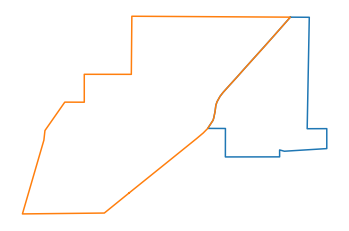

55. Nodes 42 and 28 are connected


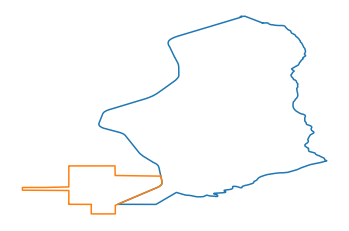

56. Nodes 42 and 33 are connected


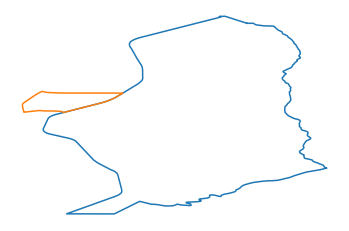

57. Nodes 43 and 25 are connected


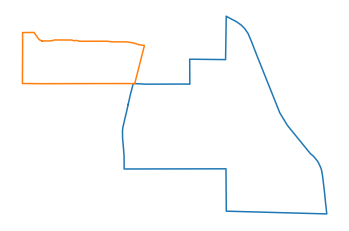

58. Nodes 43 and 28 are connected


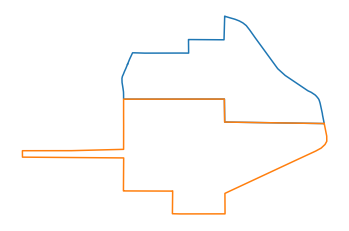

59. Nodes 43 and 42 are connected


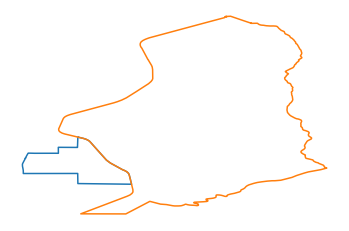

60. Nodes 44 and 24 are connected


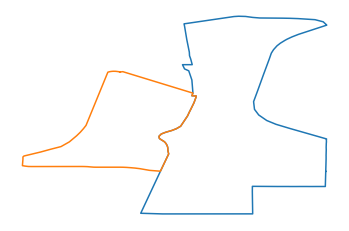

61. Nodes 44 and 25 are connected


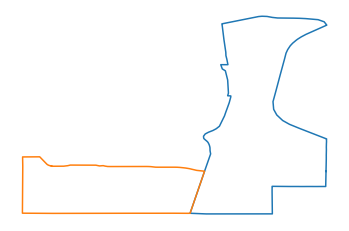

62. Nodes 44 and 33 are connected


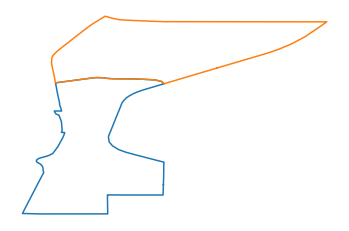

63. Nodes 44 and 42 are connected


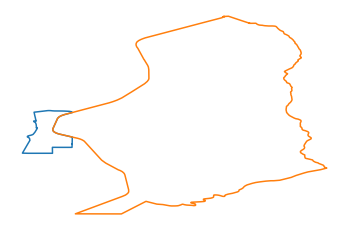

64. Nodes 44 and 43 are connected


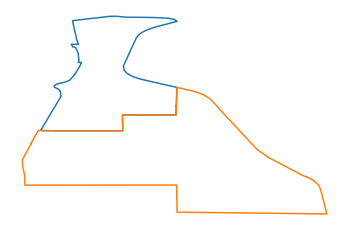

65. Nodes 45 and 17 are connected


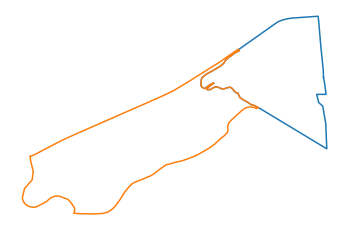

66. Nodes 45 and 23 are connected


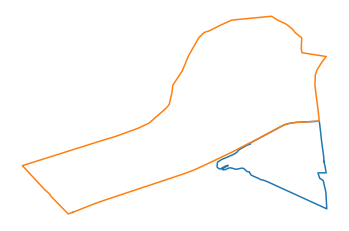

67. Nodes 45 and 24 are connected


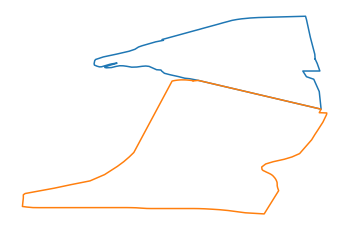

68. Nodes 45 and 44 are connected


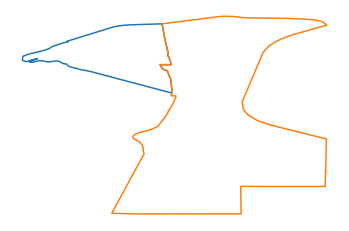

69. Nodes 46 and 29 are connected


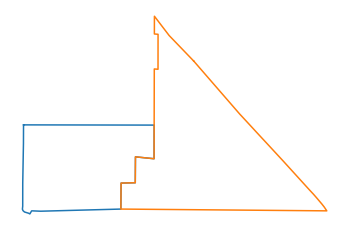

70. Nodes 47 and 20 are connected


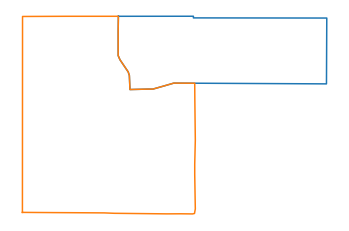

71. Nodes 48 and 22 are connected


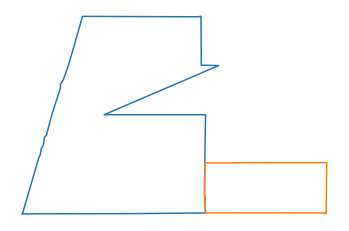

72. Nodes 48 and 27 are connected


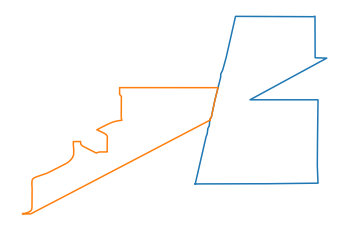

73. Nodes 48 and 28 are connected


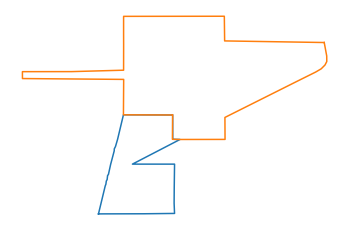

74. Nodes 49 and 19 are connected


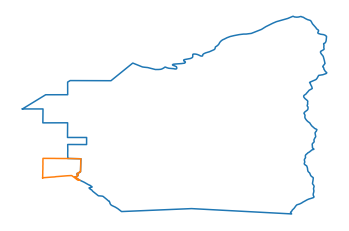

75. Nodes 49 and 20 are connected


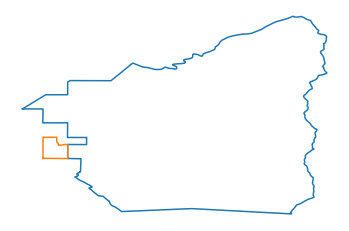

76. Nodes 49 and 22 are connected


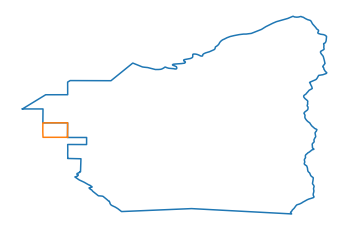

77. Nodes 49 and 28 are connected


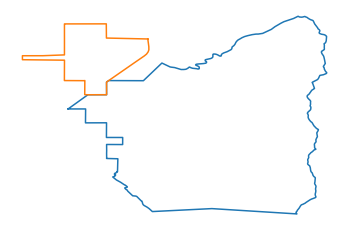

78. Nodes 49 and 42 are connected


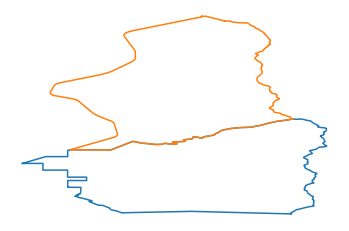

79. Nodes 49 and 47 are connected


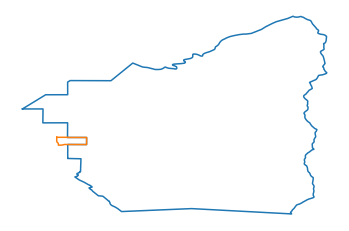

80. Nodes 49 and 48 are connected


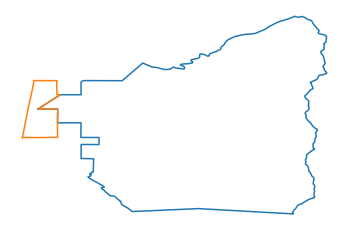

81. Nodes 50 and 26 are connected


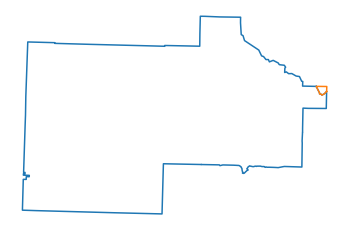

82. Nodes 51 and 27 are connected


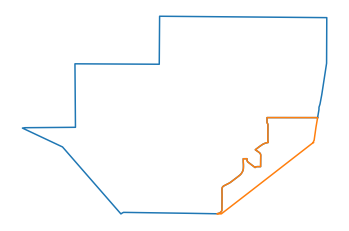

83. Nodes 51 and 28 are connected


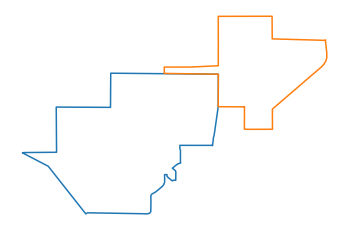

84. Nodes 51 and 48 are connected


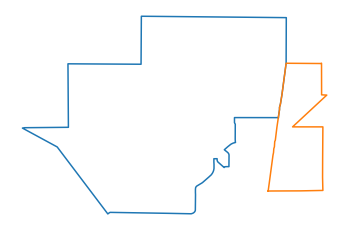

85. Nodes 52 and 37 are connected


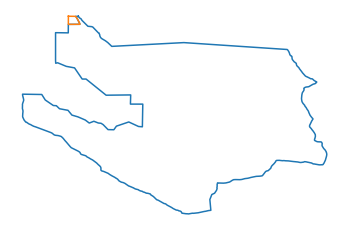

86. Nodes 52 and 38 are connected


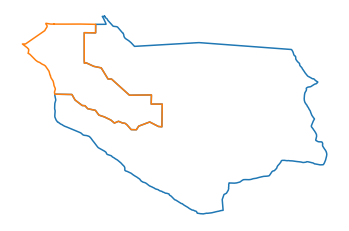

87. Nodes 52 and 39 are connected


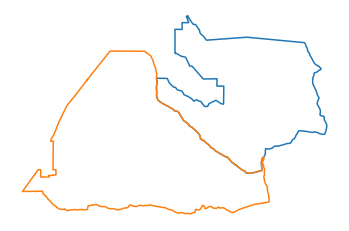

88. Nodes 52 and 49 are connected


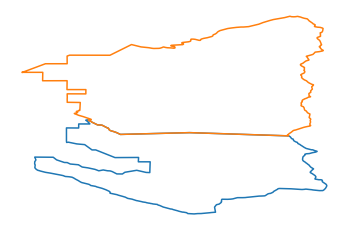

89. Nodes 53 and 30 are connected


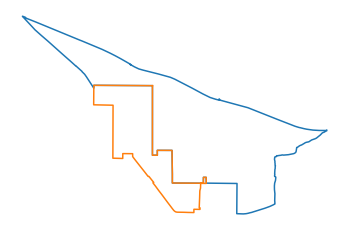

90. Nodes 53 and 31 are connected


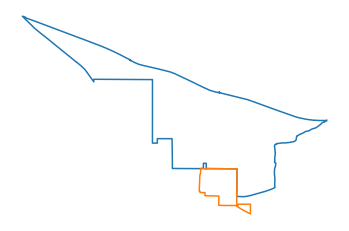

91. Nodes 54 and 27 are connected


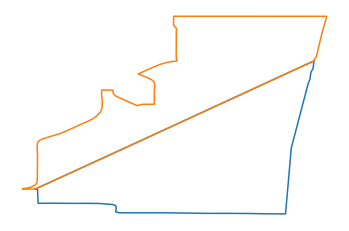

92. Nodes 54 and 48 are connected


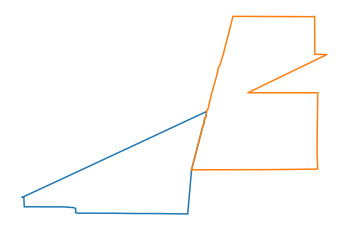

93. Nodes 55 and 25 are connected


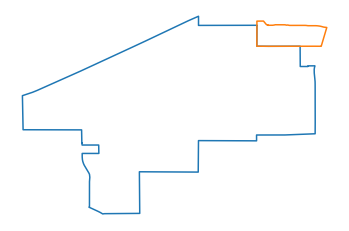

94. Nodes 55 and 28 are connected


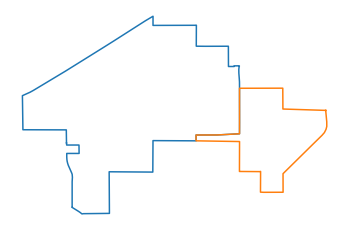

95. Nodes 55 and 29 are connected


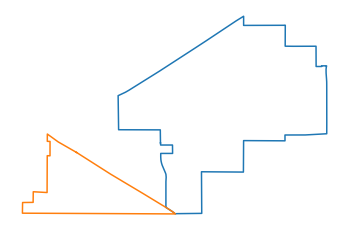

96. Nodes 55 and 36 are connected


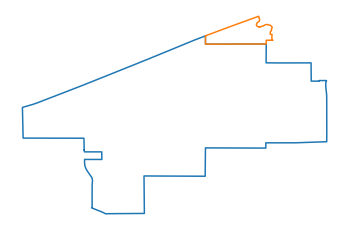

97. Nodes 55 and 43 are connected


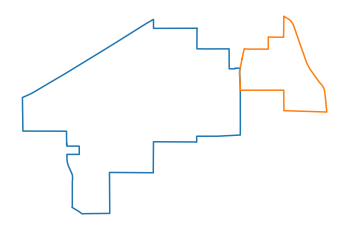

98. Nodes 55 and 51 are connected


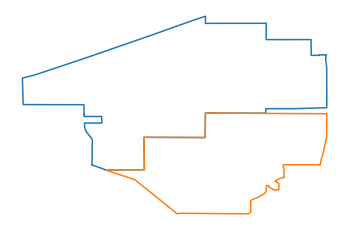

99. Nodes 55 and 53 are connected


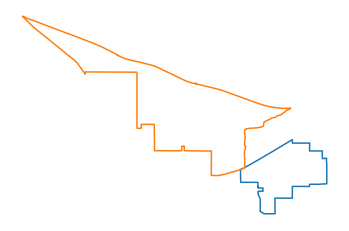

100. Nodes 56 and 29 are connected


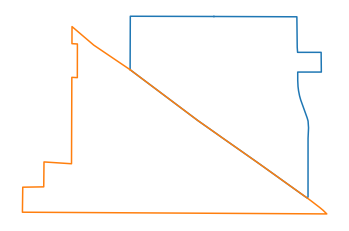

101. Nodes 56 and 31 are connected


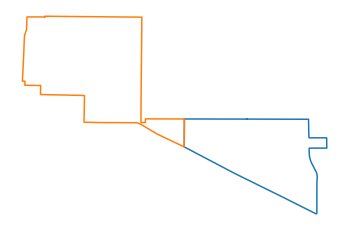

102. Nodes 56 and 55 are connected


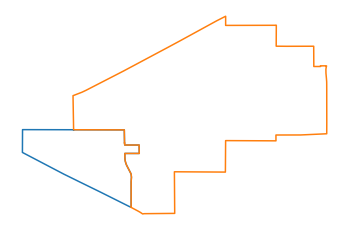

103. Nodes 57 and 18 are connected


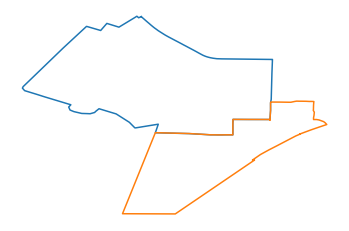

104. Nodes 57 and 51 are connected


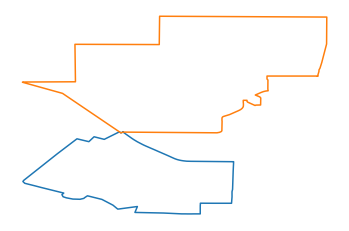

105. Nodes 58 and 19 are connected


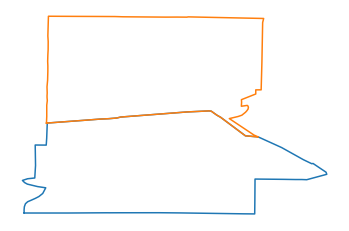

106. Nodes 58 and 21 are connected


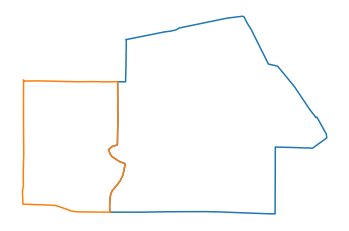

107. Nodes 58 and 37 are connected


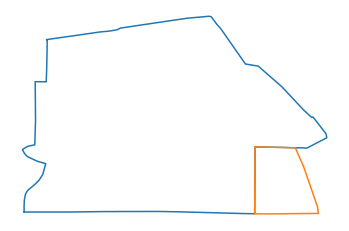

108. Nodes 58 and 38 are connected


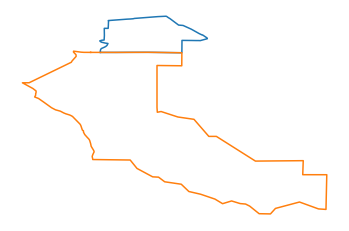

109. Nodes 58 and 49 are connected


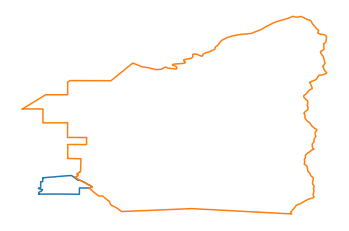

110. Nodes 58 and 52 are connected


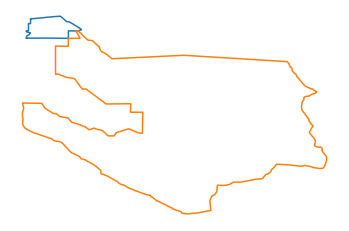

111. Nodes 59 and 29 are connected


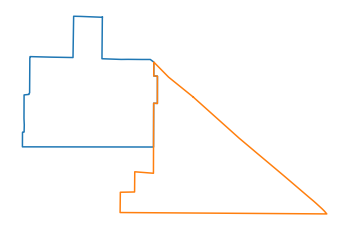

112. Nodes 59 and 31 are connected


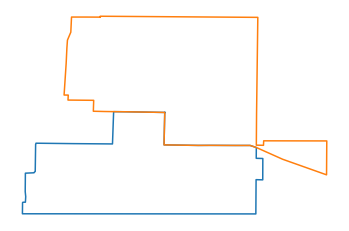

113. Nodes 59 and 32 are connected


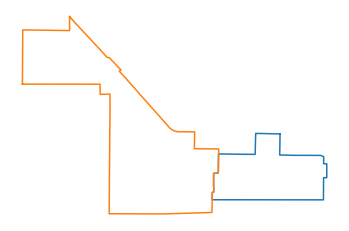

114. Nodes 59 and 46 are connected


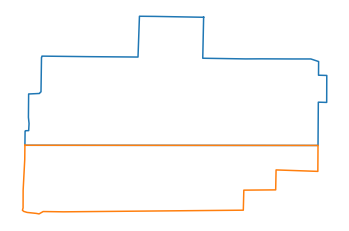

115. Nodes 60 and 17 are connected


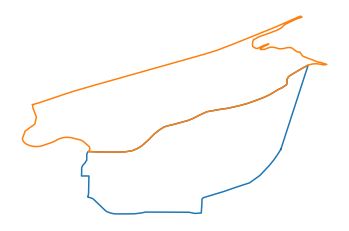

116. Nodes 60 and 24 are connected


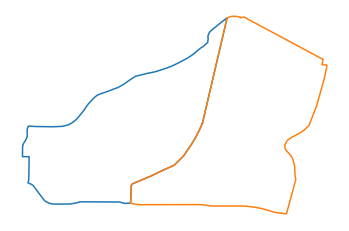

117. Nodes 60 and 25 are connected


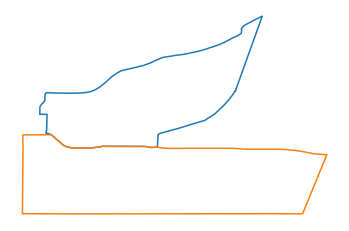

118. Nodes 60 and 36 are connected


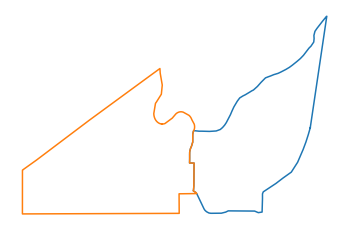

119. Nodes 61 and 51 are connected


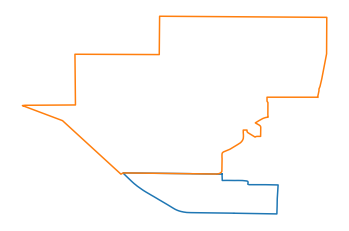

120. Nodes 61 and 54 are connected


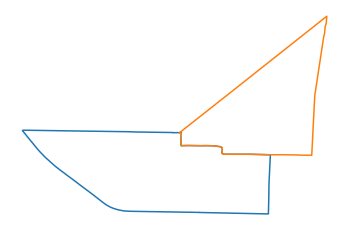

121. Nodes 61 and 57 are connected


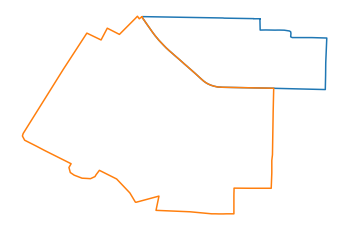

122. Nodes 62 and 19 are connected


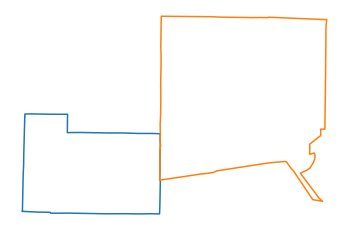

123. Nodes 62 and 21 are connected


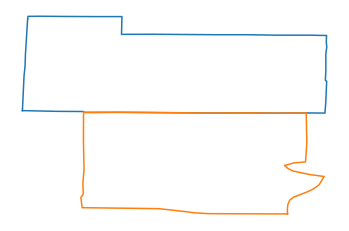

124. Nodes 62 and 58 are connected


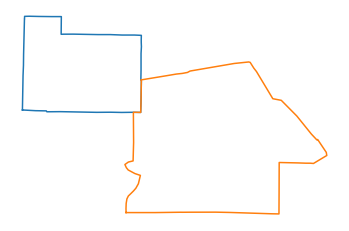

125. Nodes 63 and 30 are connected


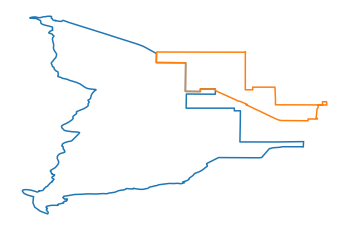

126. Nodes 63 and 32 are connected


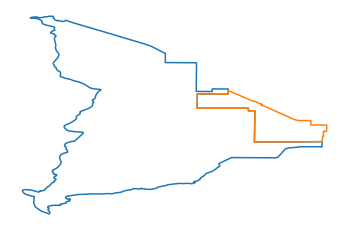

127. Nodes 63 and 46 are connected


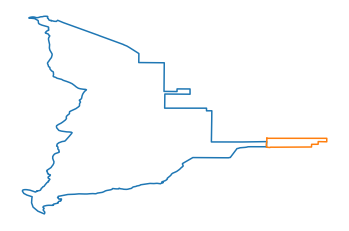

128. Nodes 63 and 53 are connected


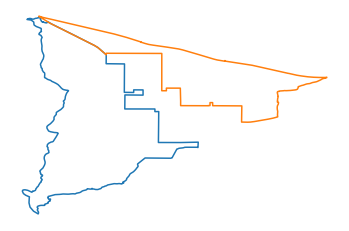

129. Nodes 64 and 18 are connected


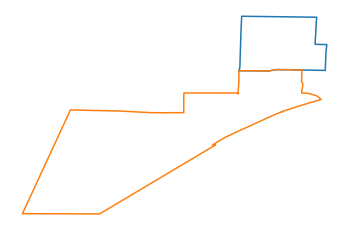

130. Nodes 64 and 57 are connected


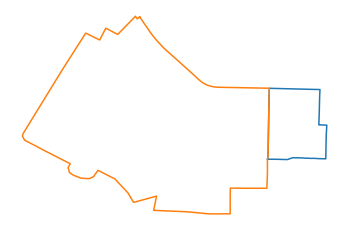

131. Nodes 64 and 61 are connected


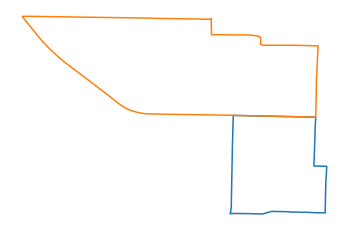

132. Nodes 65 and 54 are connected


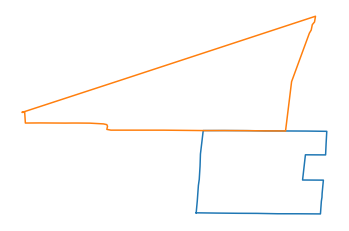

133. Nodes 65 and 61 are connected


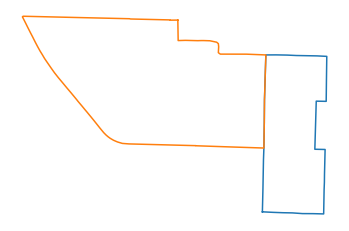

134. Nodes 65 and 62 are connected


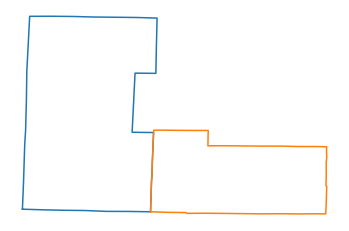

135. Nodes 65 and 64 are connected


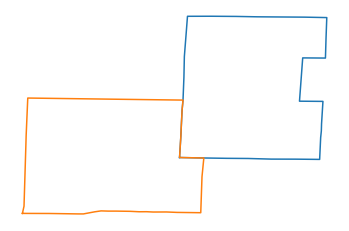

136. Nodes 66 and 30 are connected


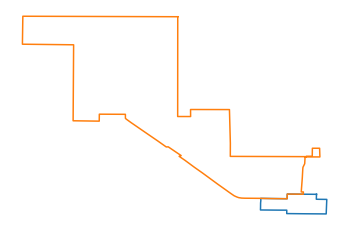

137. Nodes 66 and 31 are connected


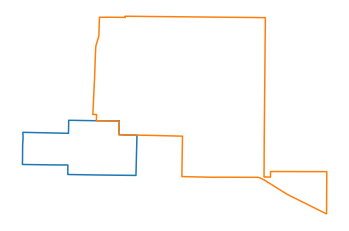

138. Nodes 66 and 32 are connected


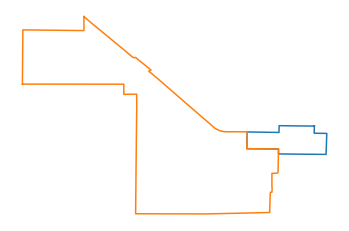

139. Nodes 66 and 59 are connected


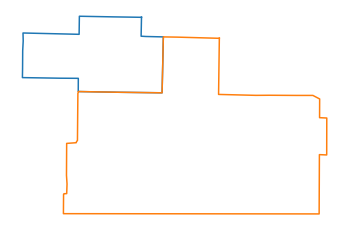

140. Nodes 67 and 18 are connected


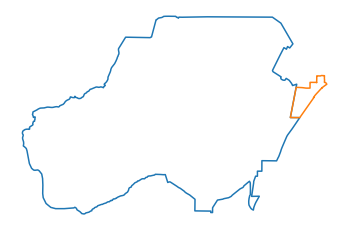

141. Nodes 67 and 29 are connected


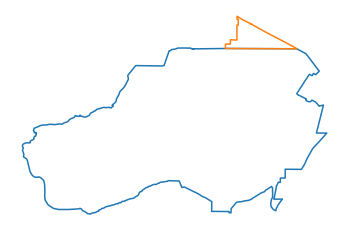

142. Nodes 67 and 34 are connected


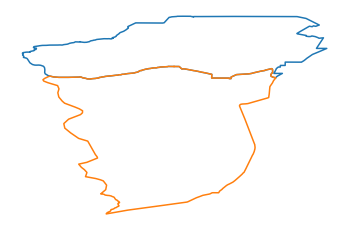

143. Nodes 67 and 39 are connected


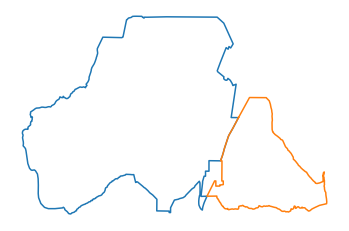

144. Nodes 67 and 40 are connected


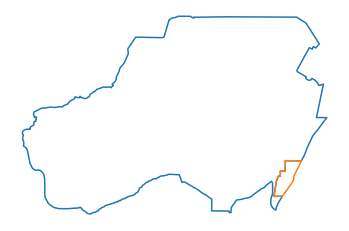

145. Nodes 67 and 46 are connected


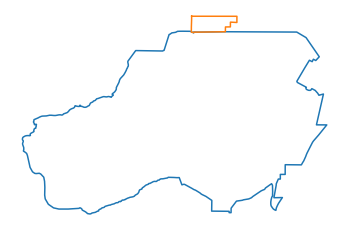

146. Nodes 67 and 51 are connected


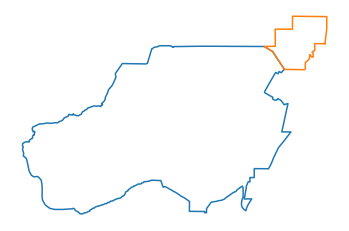

147. Nodes 67 and 57 are connected


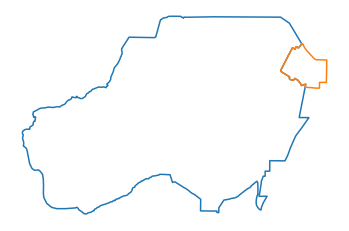

148. Nodes 67 and 63 are connected


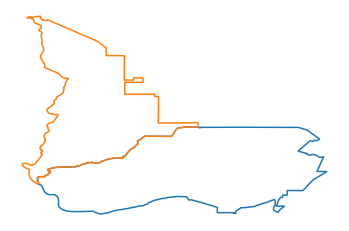

149. Nodes 68 and 50 are connected


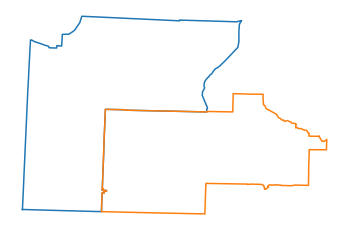

150. Nodes 69 and 23 are connected


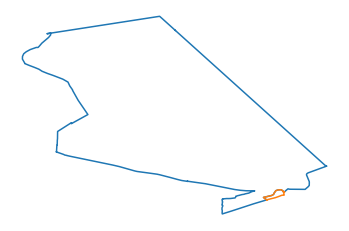

151. Nodes 69 and 33 are connected


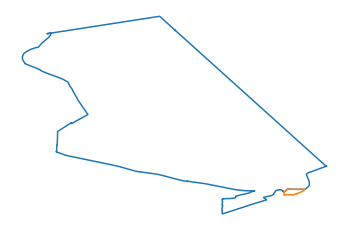

152. Nodes 69 and 36 are connected


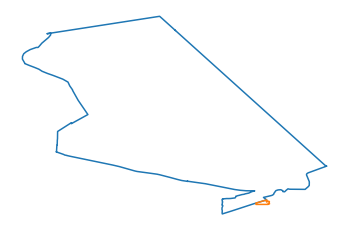

153. Nodes 69 and 42 are connected


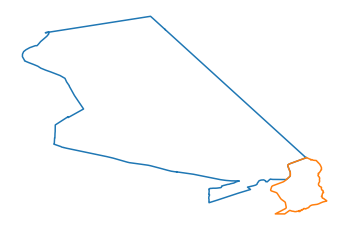

154. Nodes 69 and 53 are connected


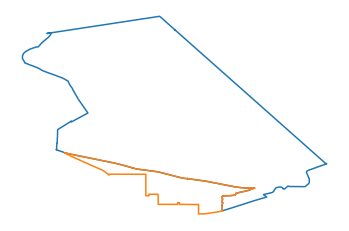

155. Nodes 70 and 34 are connected


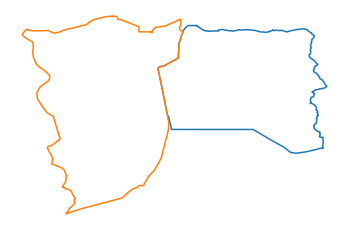

156. Nodes 70 and 35 are connected


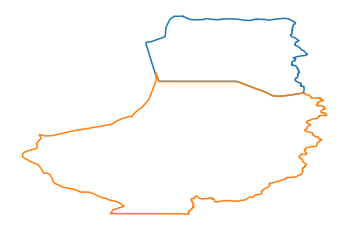

157. Nodes 70 and 39 are connected


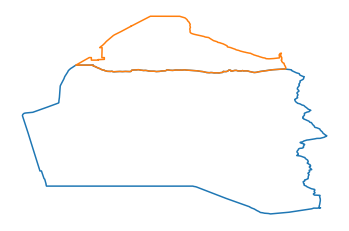

158. Nodes 70 and 67 are connected


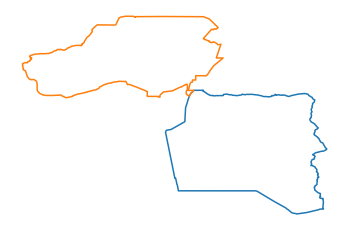

159. Nodes 71 and 26 are connected


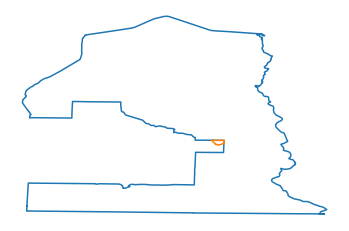

160. Nodes 71 and 34 are connected


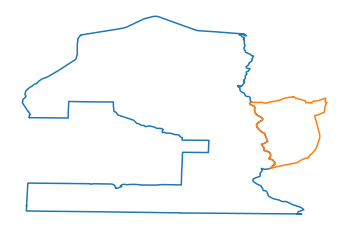

161. Nodes 71 and 35 are connected


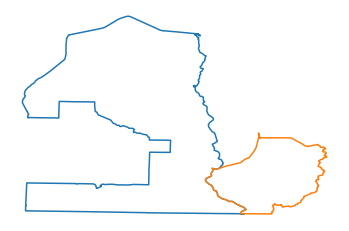

162. Nodes 71 and 50 are connected


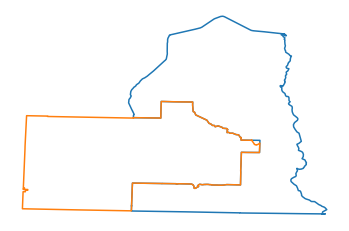

163. Nodes 71 and 53 are connected


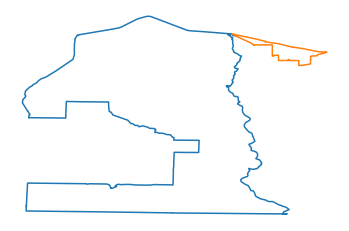

164. Nodes 71 and 63 are connected


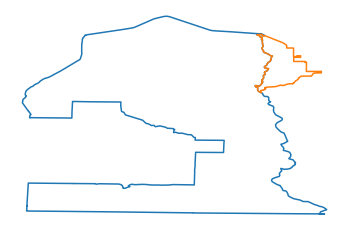

165. Nodes 71 and 67 are connected


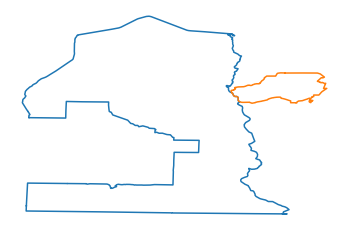

166. Nodes 71 and 68 are connected


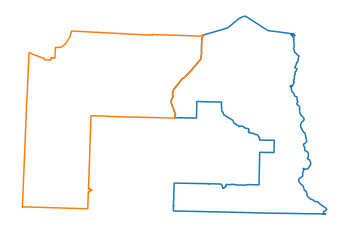

167. Nodes 72 and 53 are connected


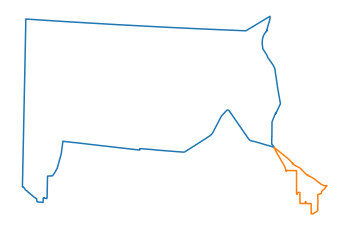

168. Nodes 72 and 68 are connected


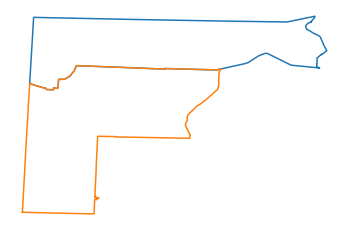

169. Nodes 72 and 69 are connected


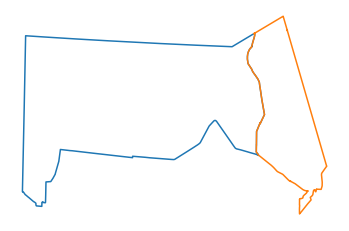

170. Nodes 72 and 71 are connected


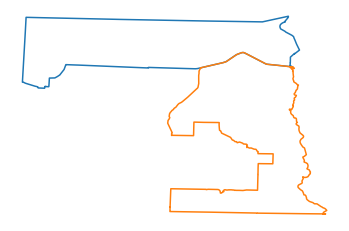

171. Nodes 73 and 18 are connected


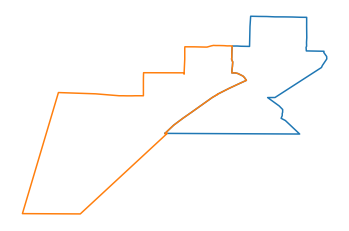

172. Nodes 73 and 21 are connected


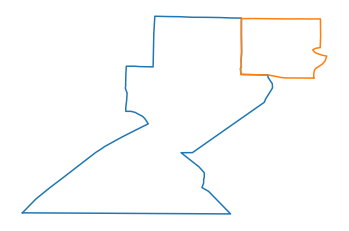

173. Nodes 73 and 38 are connected


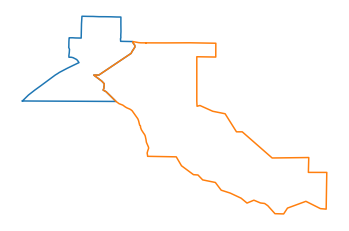

174. Nodes 73 and 62 are connected


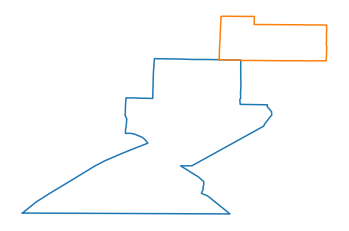

175. Nodes 73 and 64 are connected


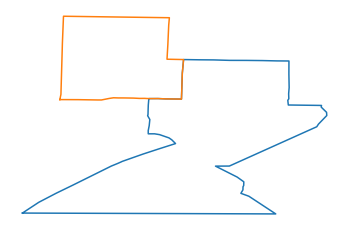

176. Nodes 73 and 65 are connected


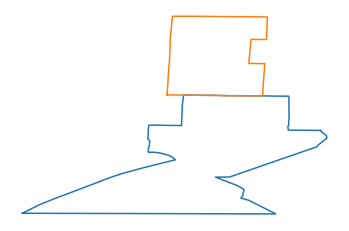

177. Nodes 74 and 19 are connected


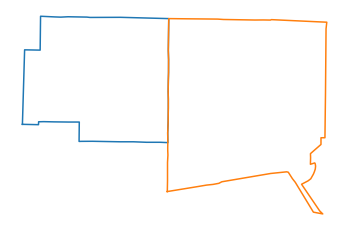

178. Nodes 74 and 62 are connected


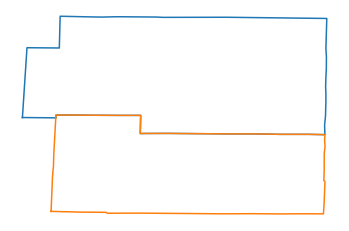

179. Nodes 74 and 65 are connected


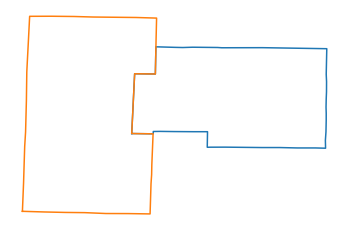

180. Nodes 75 and 20 are connected


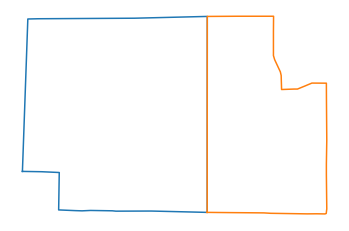

181. Nodes 75 and 48 are connected


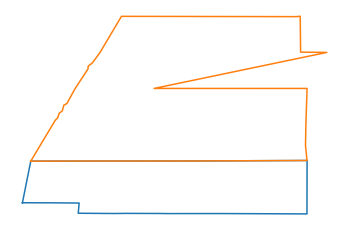

182. Nodes 75 and 54 are connected


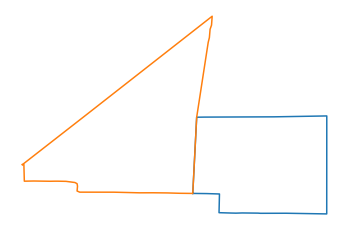

183. Nodes 75 and 65 are connected


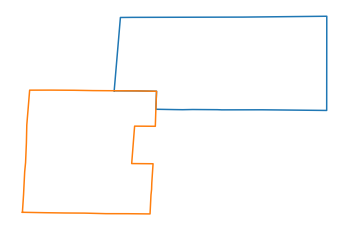

184. Nodes 75 and 74 are connected


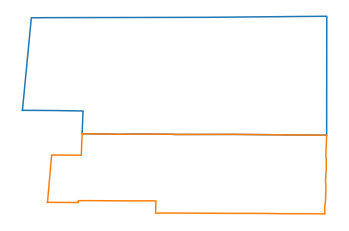

185. Nodes 77 and 76 are connected


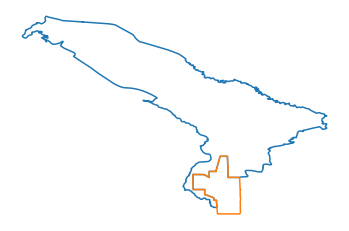

186. Nodes 78 and 76 are connected


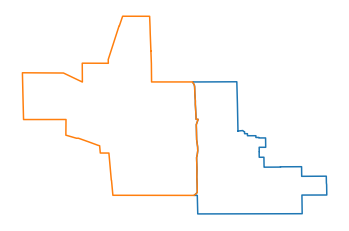

187. Nodes 79 and 76 are connected


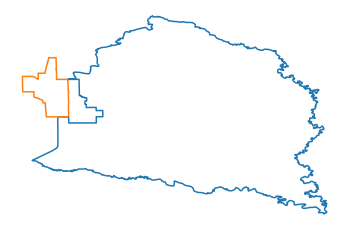

188. Nodes 79 and 77 are connected


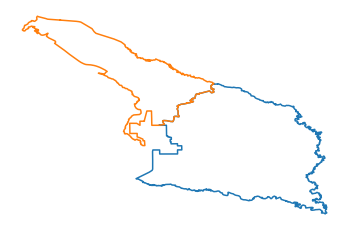

189. Nodes 79 and 78 are connected


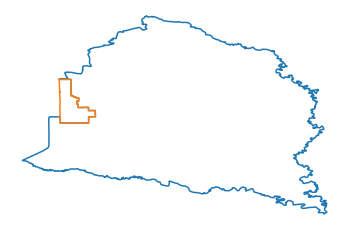

190. Nodes 81 and 79 are connected


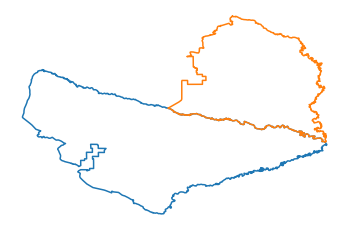

191. Nodes 81 and 80 are connected


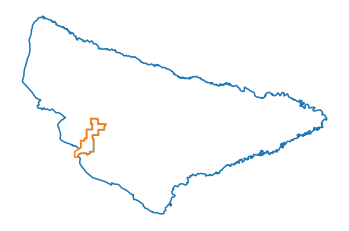

192. Nodes 83 and 82 are connected


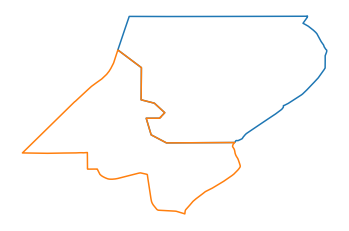

193. Nodes 86 and 81 are connected


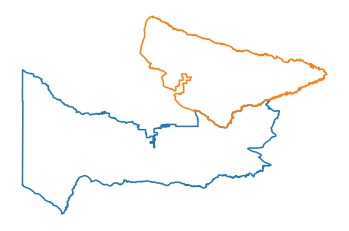

194. Nodes 86 and 84 are connected


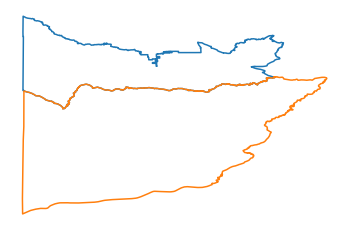

195. Nodes 86 and 85 are connected


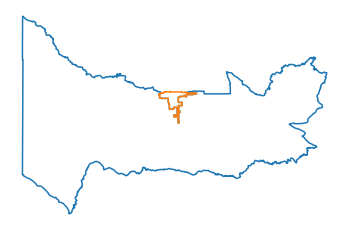

196. Nodes 87 and 85 are connected


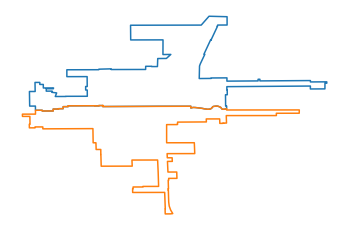

197. Nodes 87 and 86 are connected


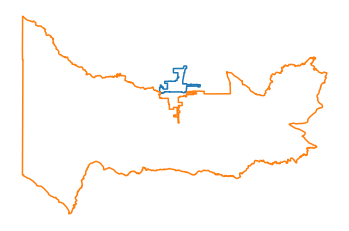

198. Nodes 88 and 80 are connected


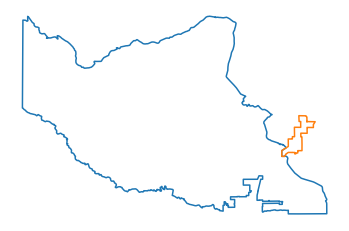

199. Nodes 88 and 81 are connected


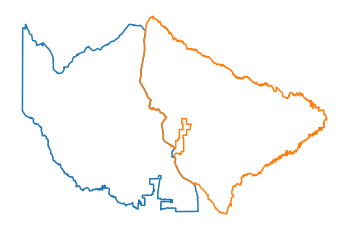

200. Nodes 88 and 86 are connected


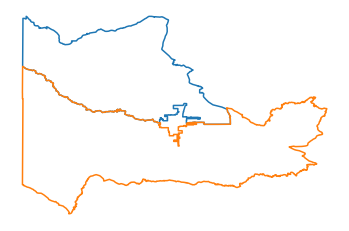

201. Nodes 88 and 87 are connected


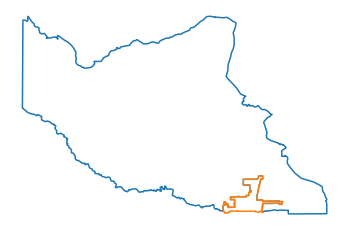

202. Nodes 90 and 89 are connected


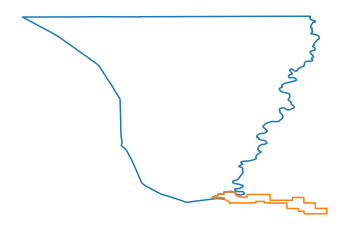

203. Nodes 92 and 79 are connected


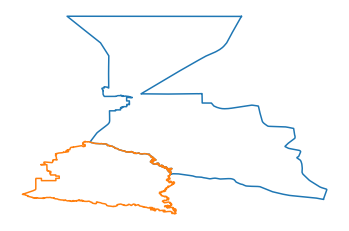

204. Nodes 92 and 82 are connected


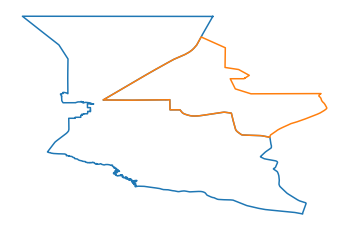

205. Nodes 92 and 83 are connected


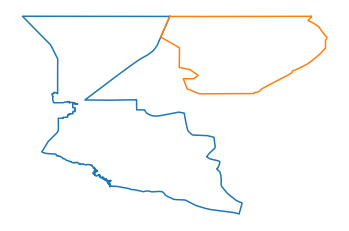

206. Nodes 92 and 91 are connected


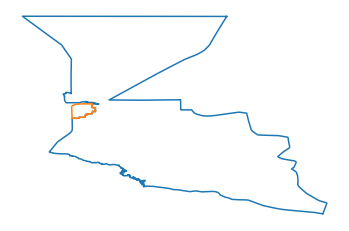

207. Nodes 93 and 91 are connected


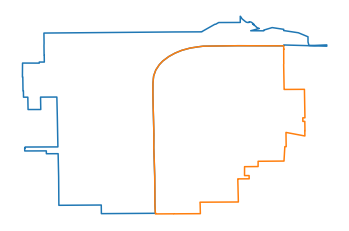

208. Nodes 93 and 92 are connected


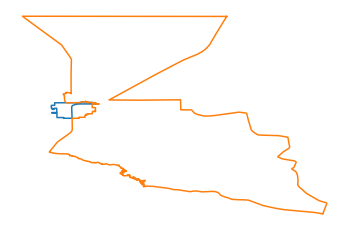

209. Nodes 94 and 77 are connected


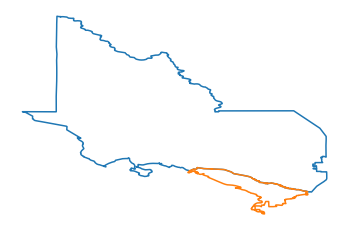

210. Nodes 94 and 79 are connected


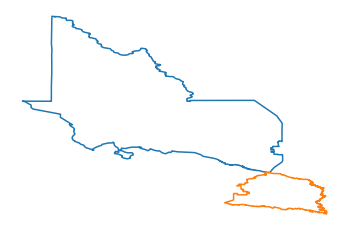

211. Nodes 94 and 92 are connected


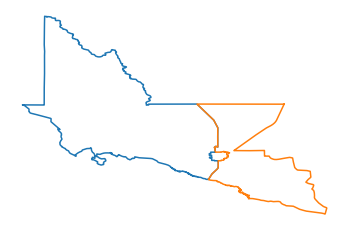

212. Nodes 94 and 93 are connected


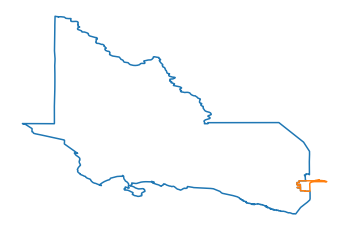

213. Nodes 95 and 76 are connected


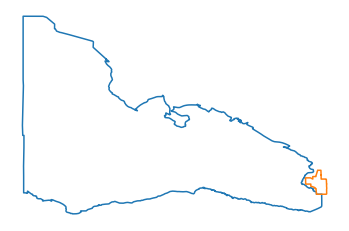

214. Nodes 95 and 77 are connected


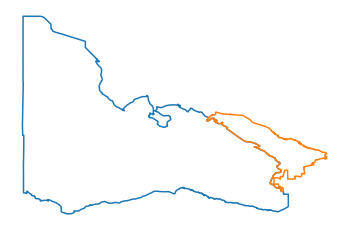

215. Nodes 95 and 79 are connected


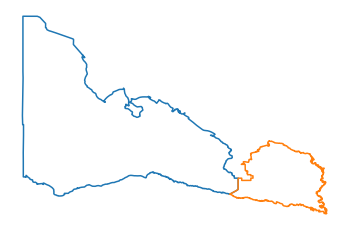

216. Nodes 95 and 81 are connected


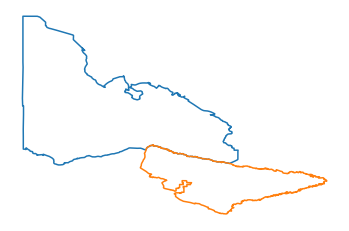

217. Nodes 95 and 88 are connected


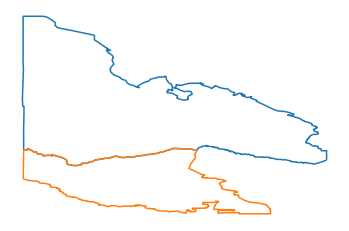

218. Nodes 95 and 94 are connected


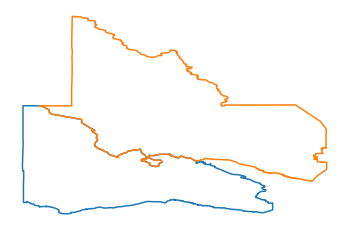

219. Nodes 96 and 79 are connected


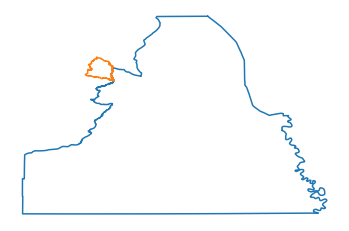

220. Nodes 96 and 81 are connected


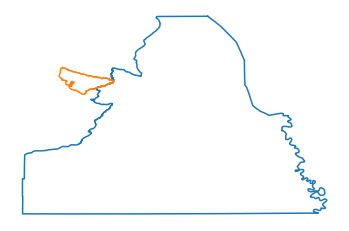

221. Nodes 96 and 82 are connected


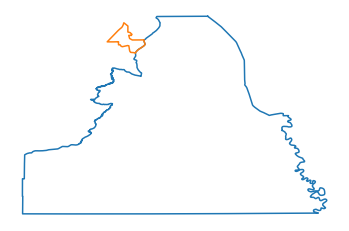

222. Nodes 96 and 83 are connected


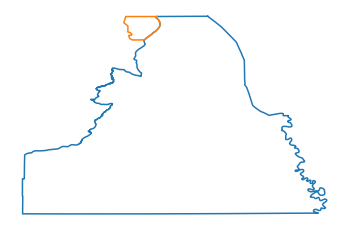

223. Nodes 96 and 84 are connected


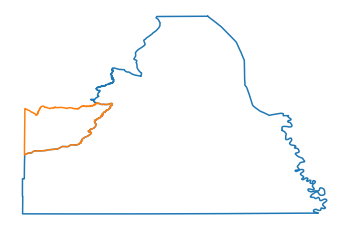

224. Nodes 96 and 86 are connected


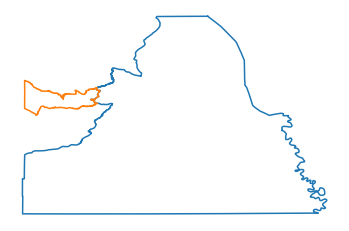

225. Nodes 96 and 89 are connected


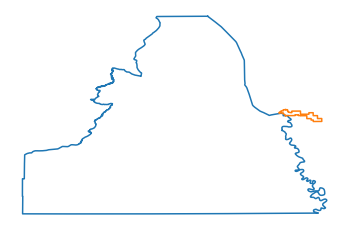

226. Nodes 96 and 90 are connected


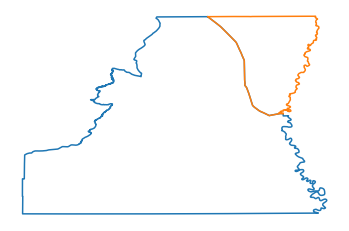

227. Nodes 96 and 92 are connected


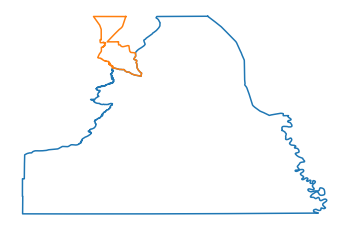

228. Nodes 97 and 89 are connected


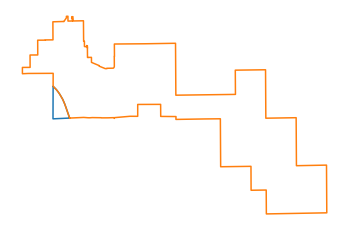

229. Nodes 97 and 96 are connected


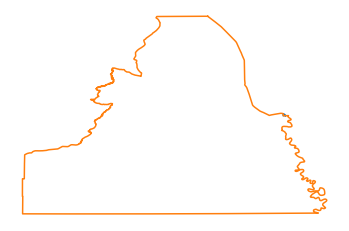

230. Nodes 100 and 98 are connected


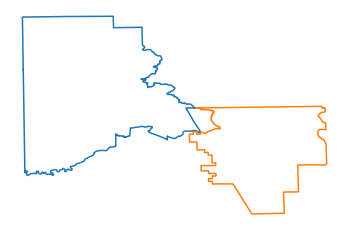

231. Nodes 102 and 99 are connected


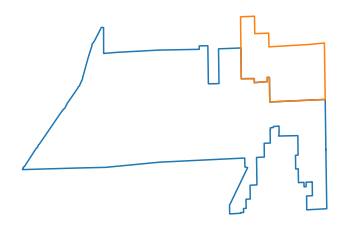

232. Nodes 103 and 101 are connected


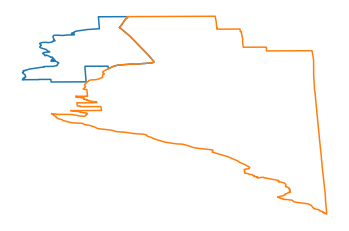

233. Nodes 104 and 101 are connected


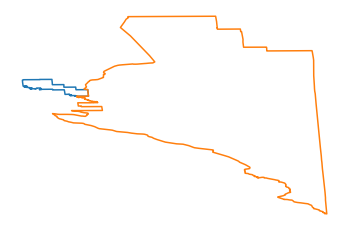

234. Nodes 104 and 103 are connected


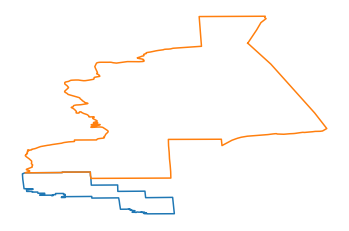

235. Nodes 105 and 102 are connected


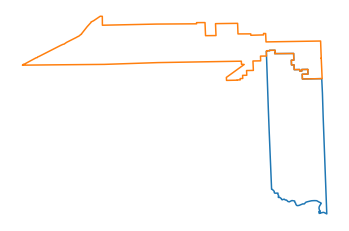

236. Nodes 106 and 101 are connected


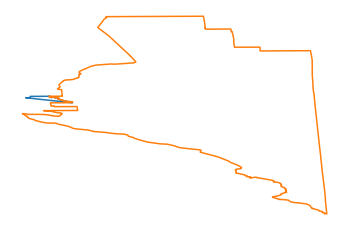

237. Nodes 107 and 101 are connected


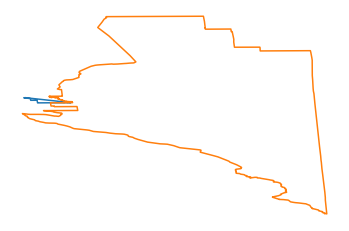

238. Nodes 107 and 106 are connected


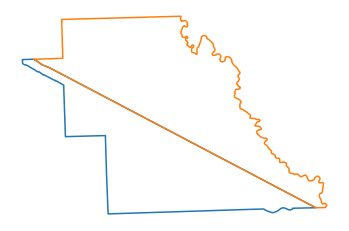

239. Nodes 108 and 98 are connected


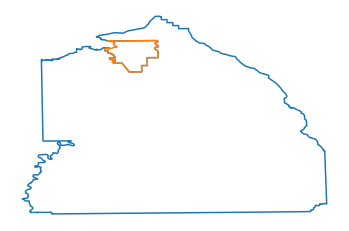

240. Nodes 108 and 100 are connected


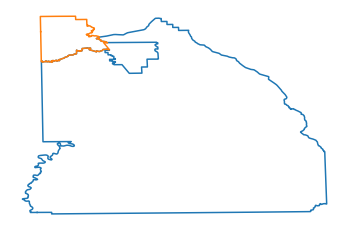

241. Nodes 108 and 101 are connected


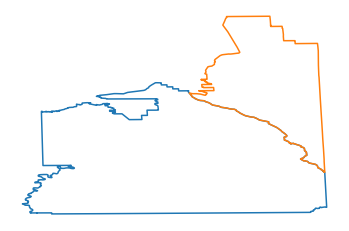

242. Nodes 109 and 104 are connected


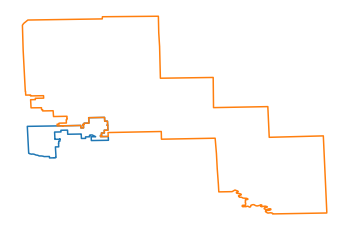

243. Nodes 110 and 99 are connected


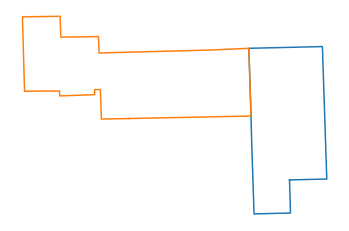

244. Nodes 110 and 102 are connected


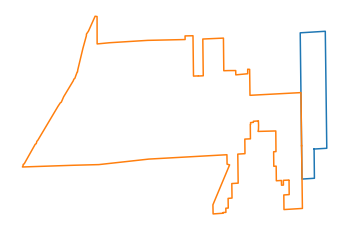

245. Nodes 110 and 109 are connected


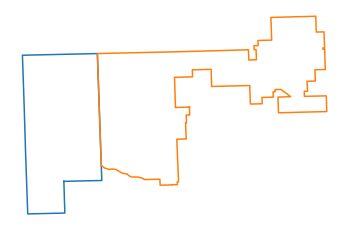

246. Nodes 111 and 101 are connected


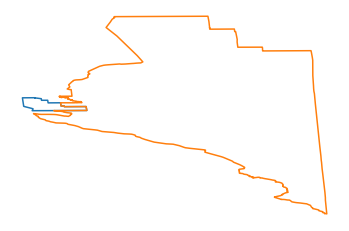

247. Nodes 111 and 107 are connected


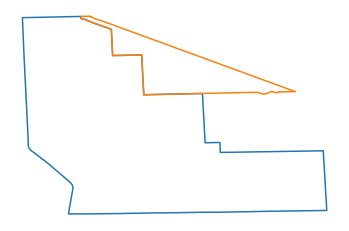

248. Nodes 112 and 102 are connected


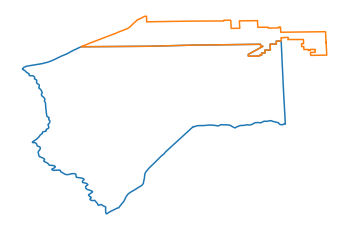

249. Nodes 112 and 105 are connected


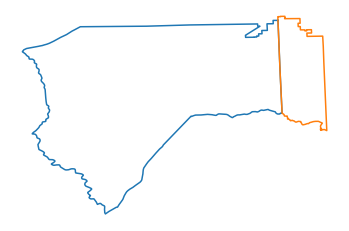

250. Nodes 112 and 108 are connected


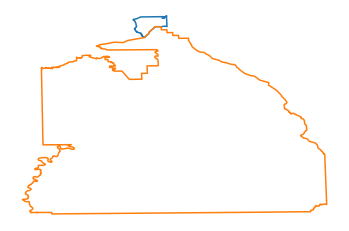

251. Nodes 113 and 100 are connected


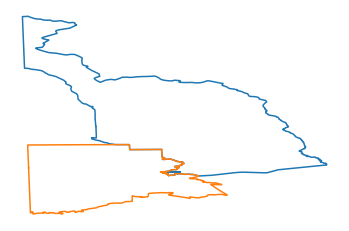

252. Nodes 113 and 108 are connected


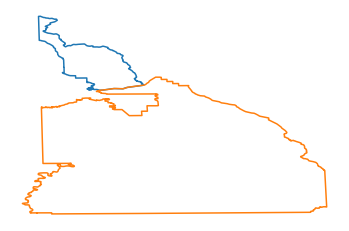

253. Nodes 113 and 112 are connected


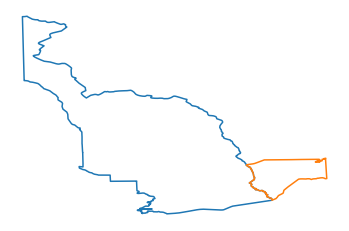

254. Nodes 114 and 105 are connected


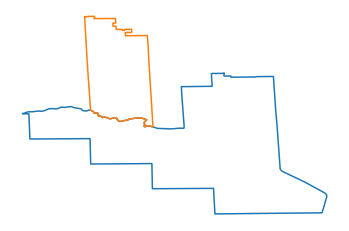

255. Nodes 114 and 108 are connected


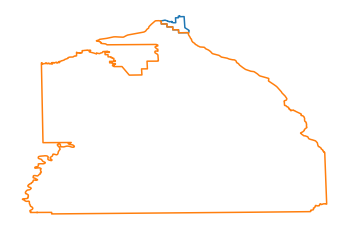

256. Nodes 114 and 111 are connected


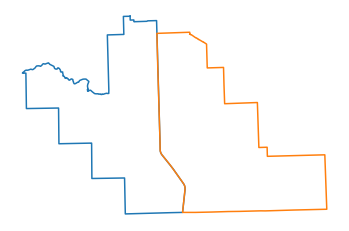

257. Nodes 114 and 112 are connected


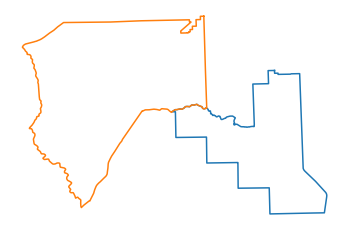

258. Nodes 115 and 98 are connected


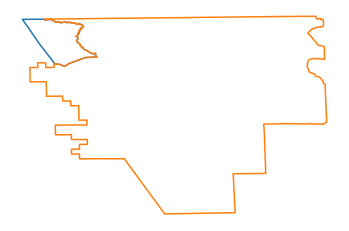

259. Nodes 115 and 100 are connected


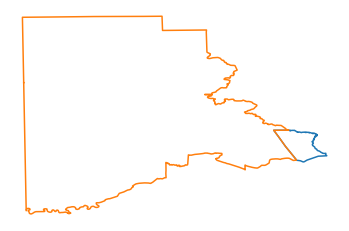

260. Nodes 116 and 99 are connected


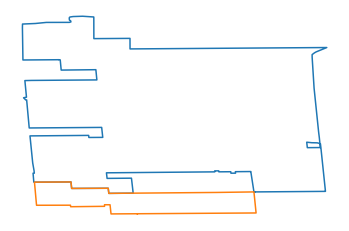

261. Nodes 116 and 104 are connected


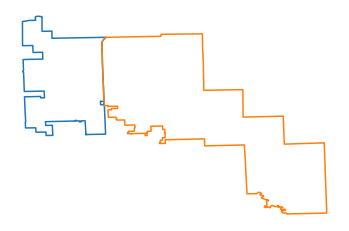

262. Nodes 116 and 110 are connected


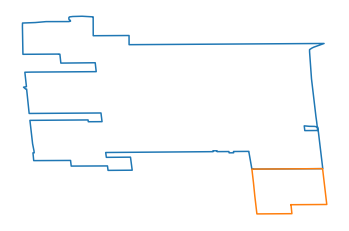

263. Nodes 117 and 99 are connected


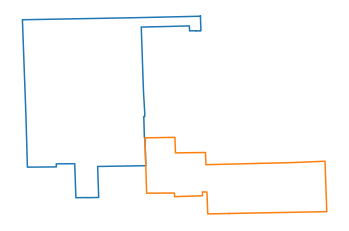

264. Nodes 117 and 102 are connected


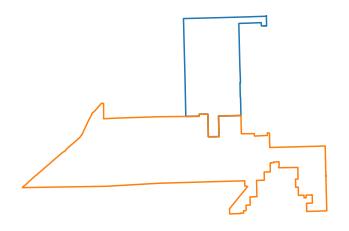

265. Nodes 117 and 116 are connected


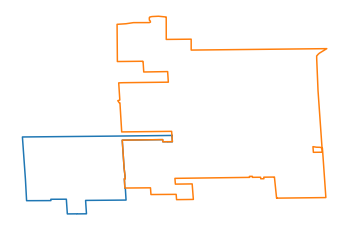

266. Nodes 118 and 104 are connected


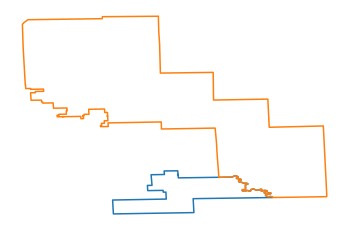

267. Nodes 118 and 106 are connected


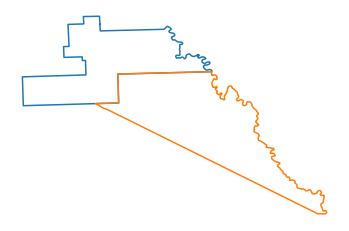

268. Nodes 118 and 107 are connected


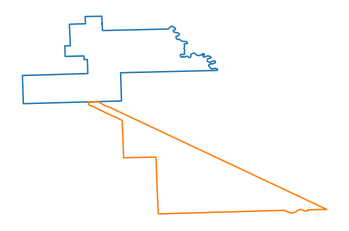

269. Nodes 118 and 111 are connected


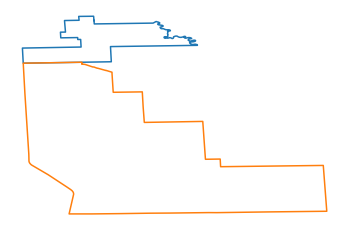

270. Nodes 118 and 114 are connected


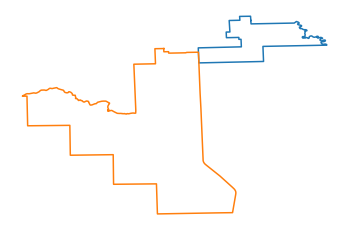

271. Nodes 119 and 101 are connected


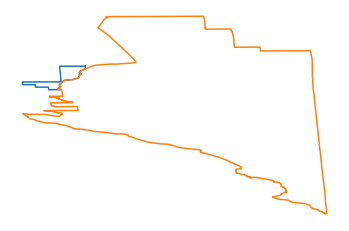

272. Nodes 119 and 103 are connected


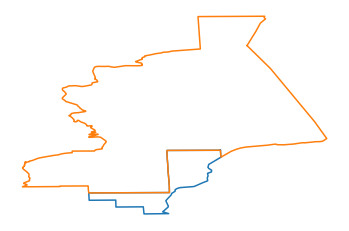

273. Nodes 119 and 104 are connected


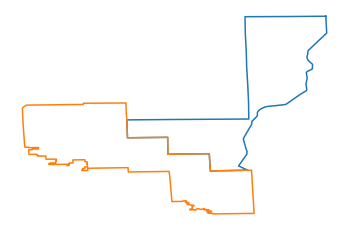

274. Nodes 120 and 116 are connected


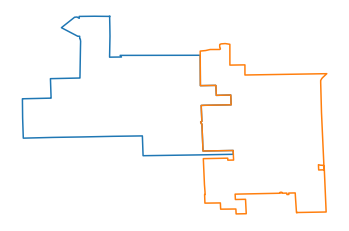

275. Nodes 120 and 117 are connected


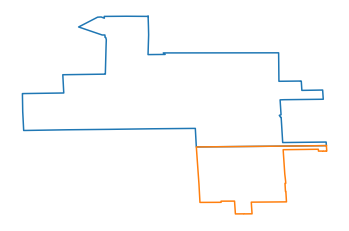

276. Nodes 121 and 116 are connected


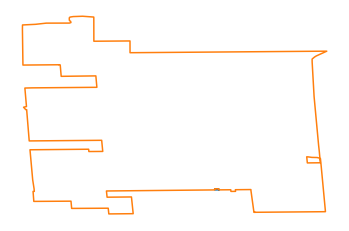

277. Nodes 122 and 99 are connected


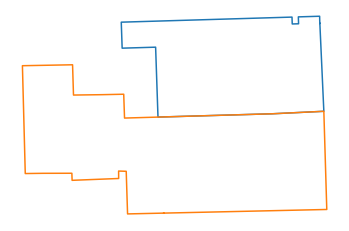

278. Nodes 122 and 116 are connected


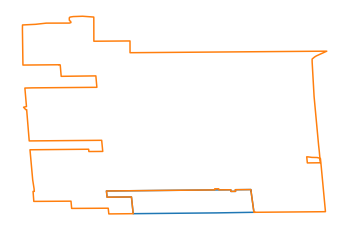

279. Nodes 122 and 121 are connected


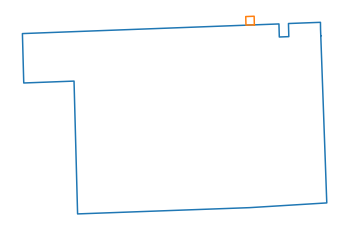

280. Nodes 123 and 102 are connected


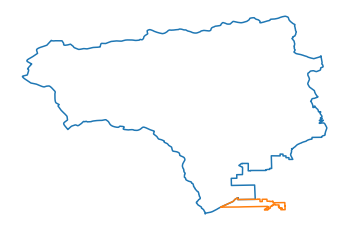

281. Nodes 123 and 103 are connected


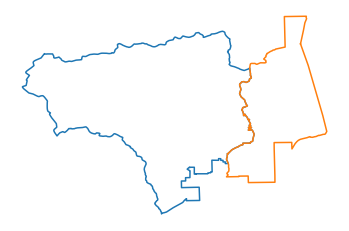

282. Nodes 123 and 112 are connected


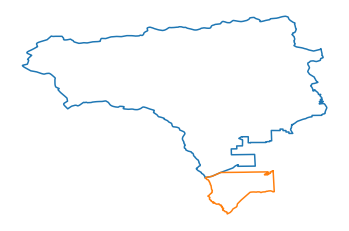

283. Nodes 123 and 113 are connected


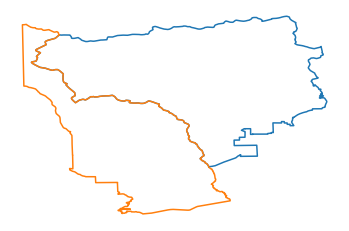

284. Nodes 123 and 116 are connected


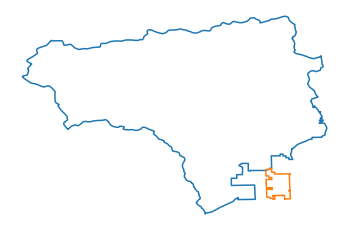

285. Nodes 123 and 117 are connected


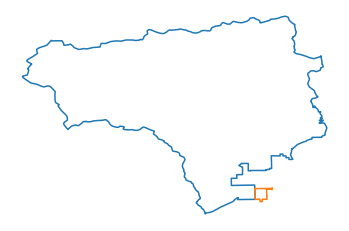

286. Nodes 123 and 120 are connected


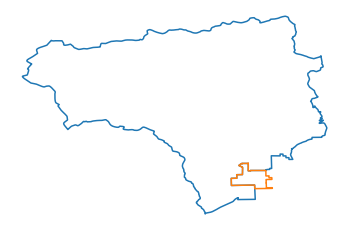

287. Nodes 124 and 104 are connected


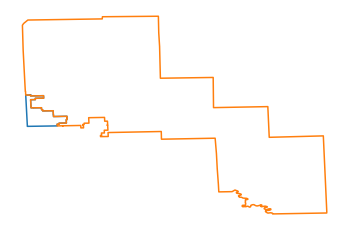

288. Nodes 124 and 109 are connected


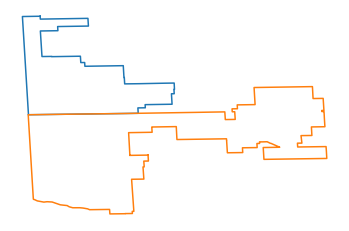

289. Nodes 124 and 116 are connected


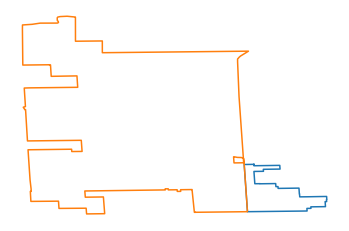

290. Nodes 125 and 102 are connected


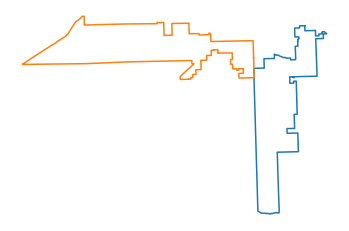

291. Nodes 125 and 105 are connected


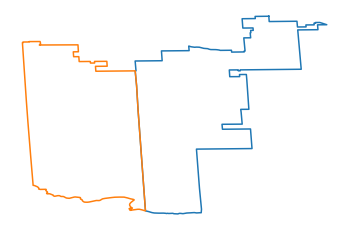

292. Nodes 125 and 109 are connected


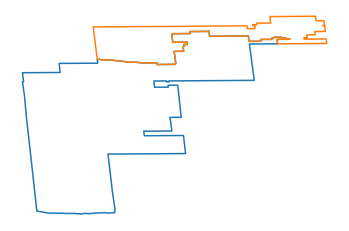

293. Nodes 125 and 110 are connected


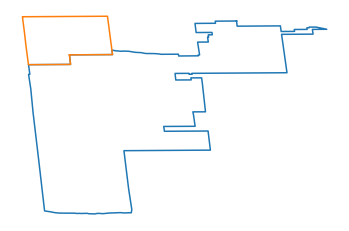

294. Nodes 125 and 114 are connected


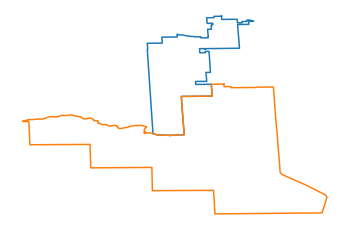

295. Nodes 126 and 101 are connected


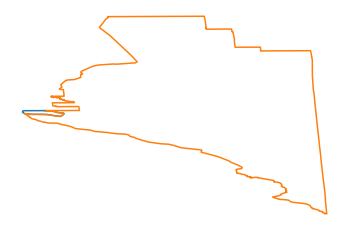

296. Nodes 126 and 108 are connected


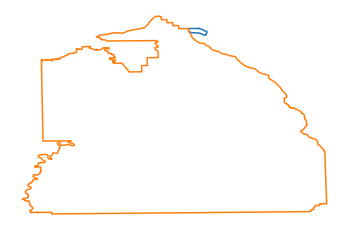

297. Nodes 126 and 111 are connected


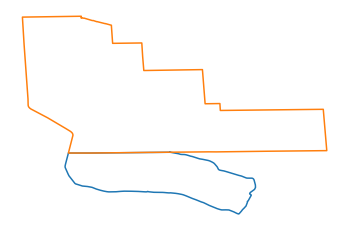

298. Nodes 127 and 104 are connected


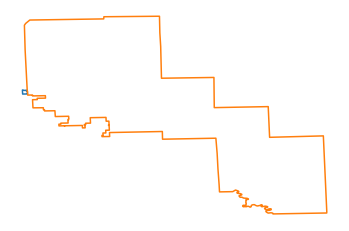

299. Nodes 127 and 116 are connected


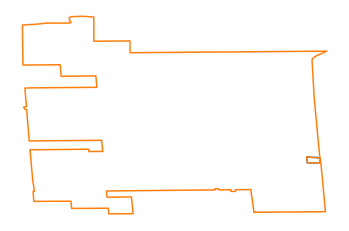

300. Nodes 128 and 104 are connected


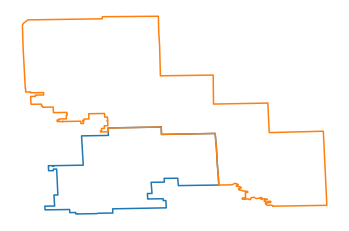

301. Nodes 128 and 109 are connected


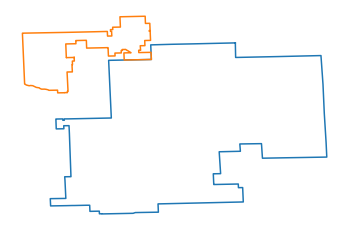

302. Nodes 128 and 114 are connected


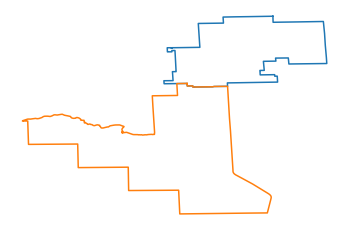

303. Nodes 128 and 118 are connected


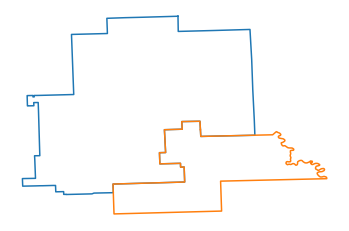

304. Nodes 128 and 125 are connected


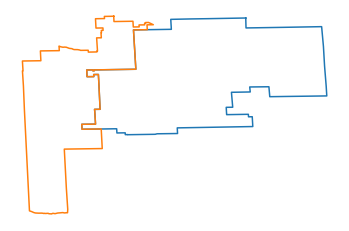

305. Nodes 129 and 103 are connected


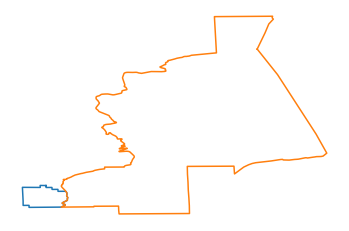

306. Nodes 129 and 116 are connected


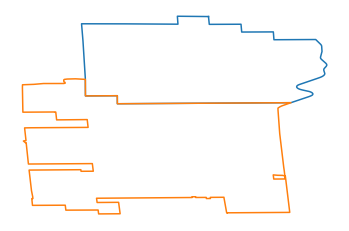

307. Nodes 129 and 123 are connected


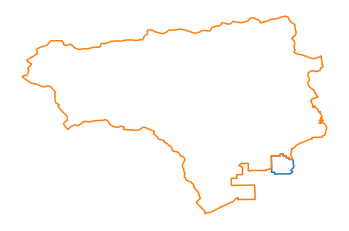

308. Nodes 130 and 100 are connected


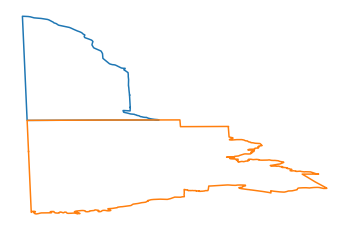

309. Nodes 130 and 113 are connected


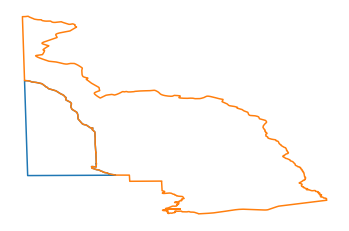

310. Nodes 131 and 2 are connected


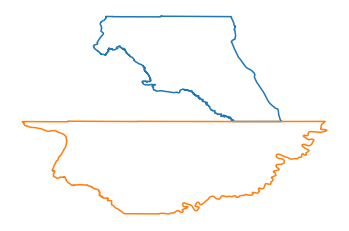

311. Nodes 132 and 2 are connected


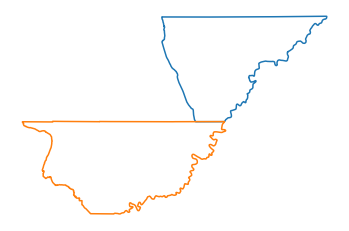

312. Nodes 132 and 131 are connected


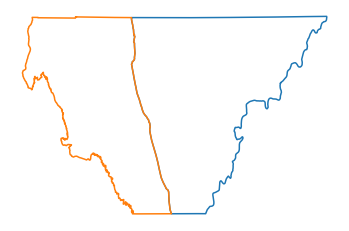

313. Nodes 133 and 131 are connected


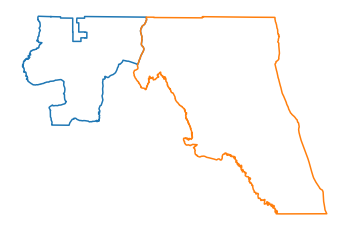

314. Nodes 134 and 9 are connected


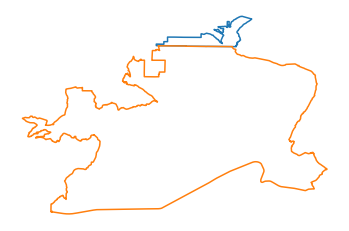

315. Nodes 135 and 133 are connected


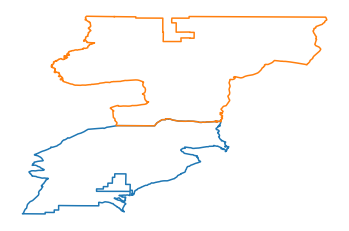

316. Nodes 135 and 134 are connected


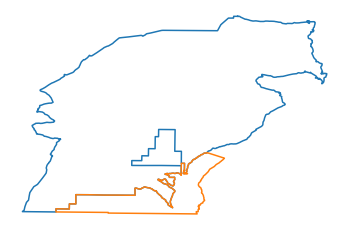

317. Nodes 136 and 2 are connected


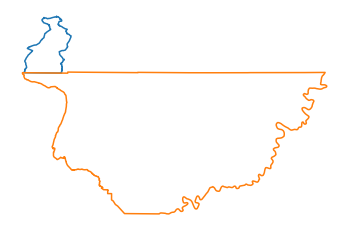

318. Nodes 136 and 134 are connected


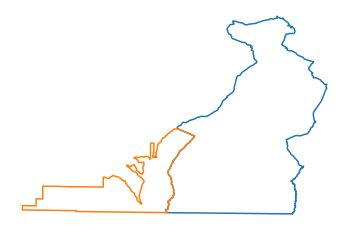

319. Nodes 136 and 135 are connected


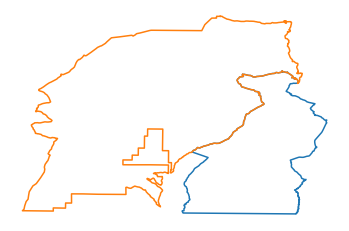

320. Nodes 137 and 2 are connected


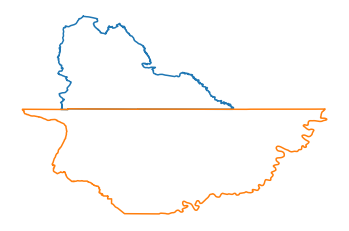

321. Nodes 137 and 131 are connected


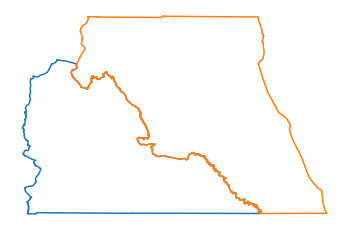

322. Nodes 137 and 133 are connected


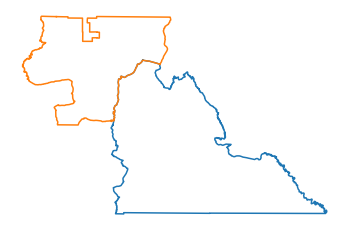

323. Nodes 137 and 135 are connected


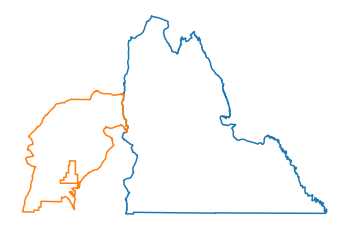

324. Nodes 137 and 136 are connected


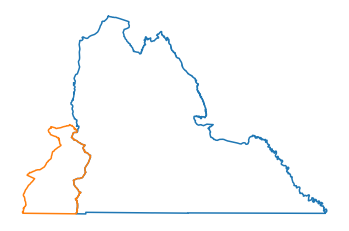

325. Nodes 138 and 1 are connected


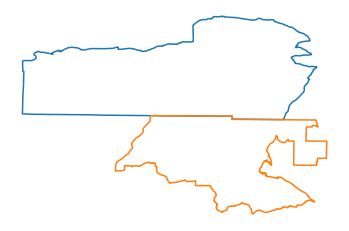

326. Nodes 138 and 4 are connected


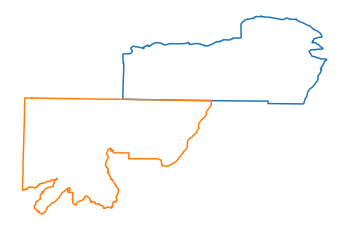

327. Nodes 138 and 135 are connected


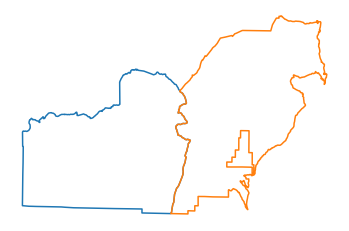

328. Nodes 139 and 133 are connected


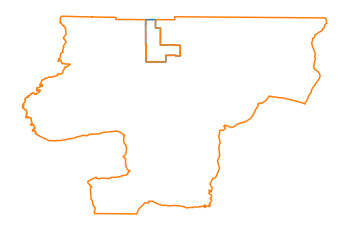

329. Nodes 140 and 134 are connected


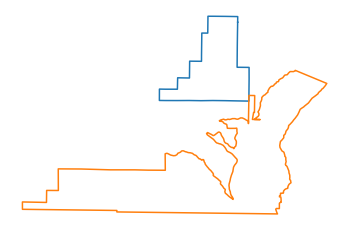

330. Nodes 140 and 135 are connected


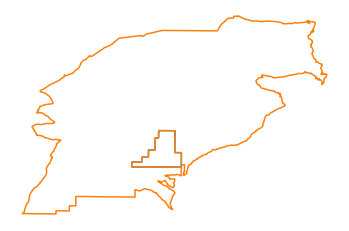

331. Nodes 142 and 35 are connected


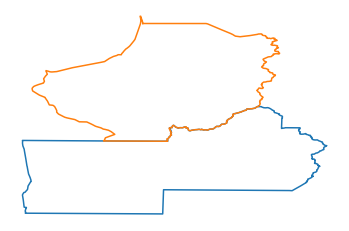

332. Nodes 142 and 71 are connected


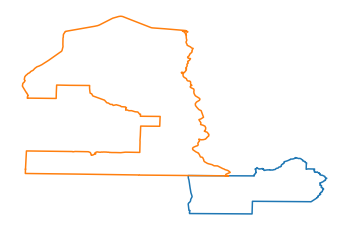

333. Nodes 143 and 50 are connected


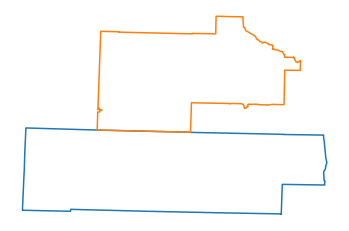

334. Nodes 143 and 71 are connected


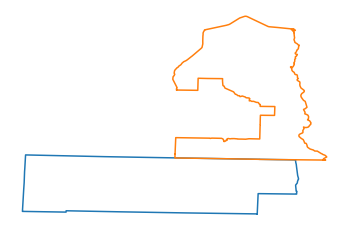

335. Nodes 143 and 142 are connected


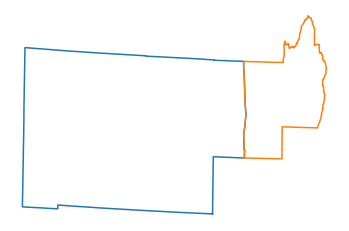

336. Nodes 144 and 141 are connected


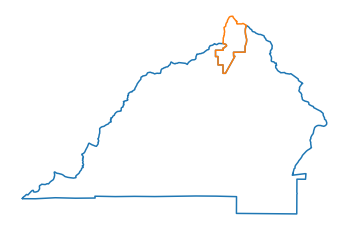

337. Nodes 146 and 145 are connected


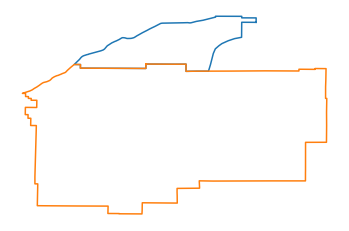

338. Nodes 147 and 142 are connected


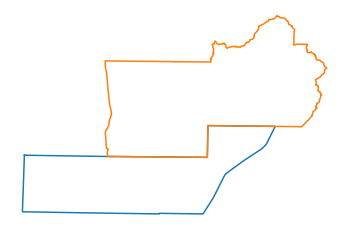

339. Nodes 147 and 143 are connected


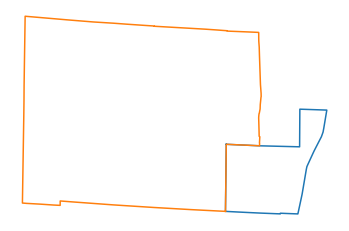

340. Nodes 148 and 144 are connected


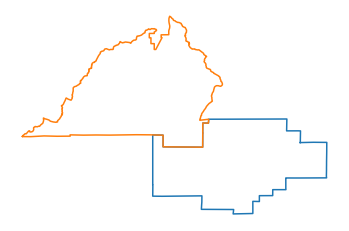

341. Nodes 149 and 145 are connected


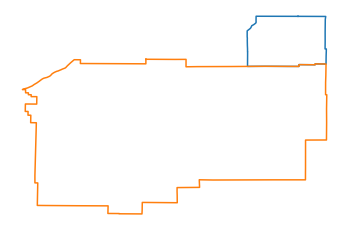

342. Nodes 149 and 148 are connected


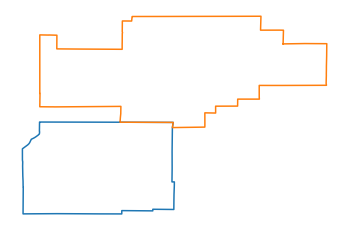

343. Nodes 150 and 146 are connected


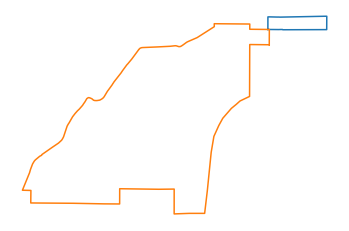

344. Nodes 150 and 148 are connected


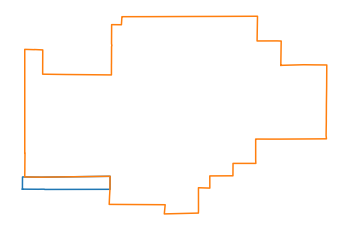

345. Nodes 151 and 146 are connected


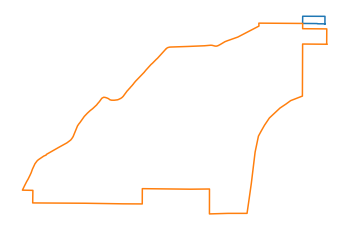

346. Nodes 152 and 146 are connected


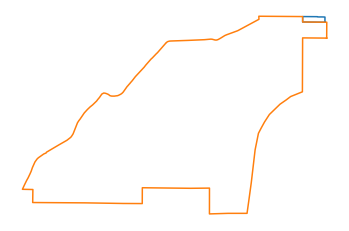

347. Nodes 152 and 151 are connected


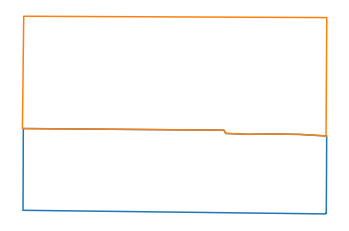

348. Nodes 153 and 146 are connected


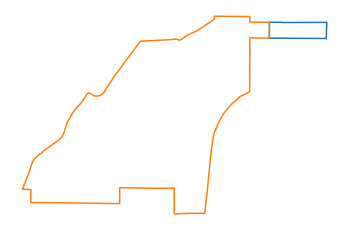

349. Nodes 153 and 148 are connected


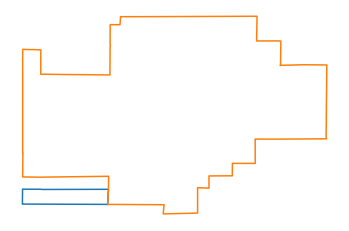

350. Nodes 153 and 149 are connected


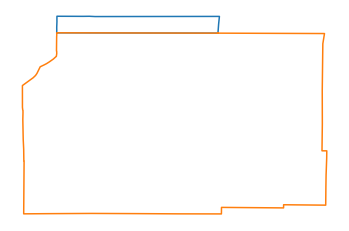

351. Nodes 153 and 150 are connected


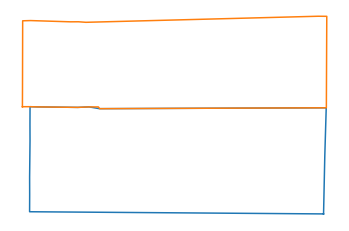

352. Nodes 154 and 145 are connected


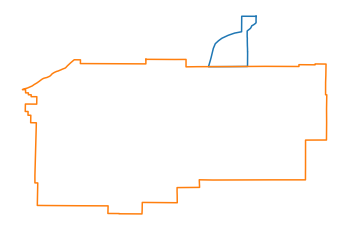

353. Nodes 154 and 146 are connected


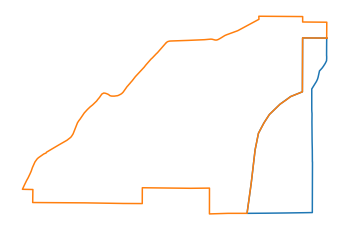

354. Nodes 154 and 149 are connected


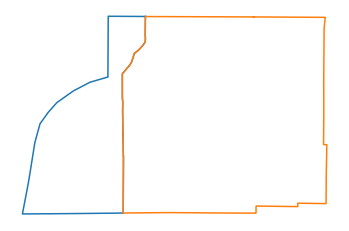

355. Nodes 154 and 153 are connected


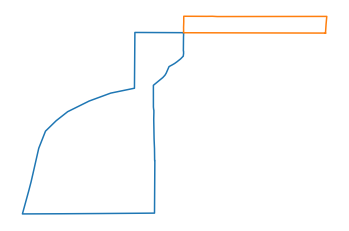

356. Nodes 156 and 142 are connected


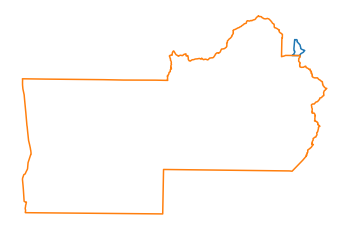

357. Nodes 156 and 155 are connected


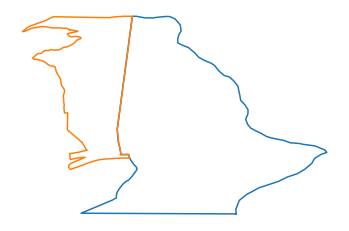

358. Nodes 157 and 142 are connected


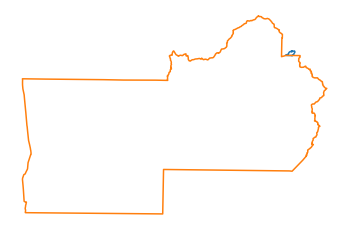

359. Nodes 157 and 155 are connected


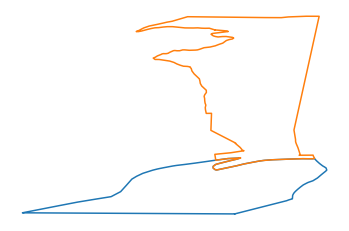

360. Nodes 157 and 156 are connected


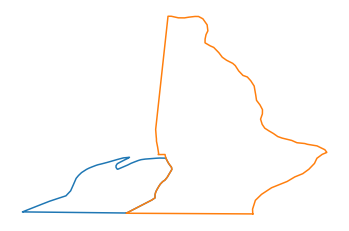

361. Nodes 158 and 142 are connected


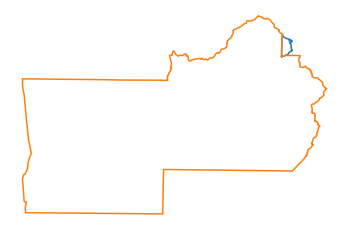

362. Nodes 158 and 155 are connected


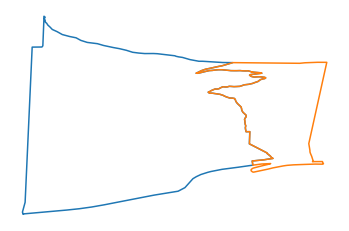

363. Nodes 158 and 157 are connected


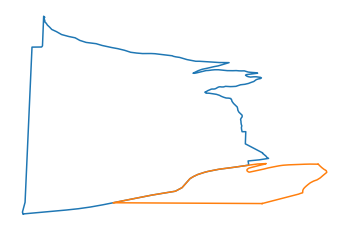

364. Nodes 159 and 142 are connected


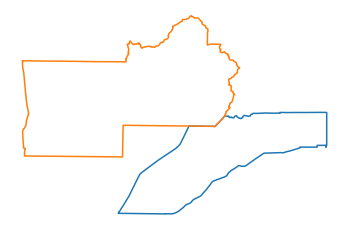

365. Nodes 159 and 144 are connected


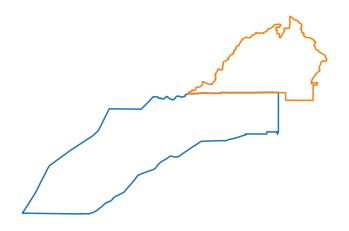

366. Nodes 159 and 145 are connected


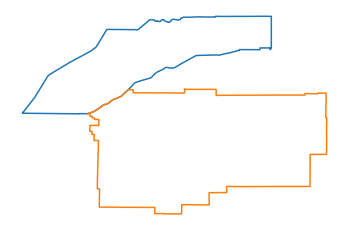

367. Nodes 159 and 146 are connected


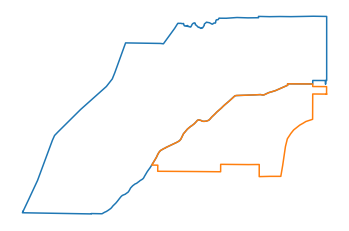

368. Nodes 159 and 147 are connected


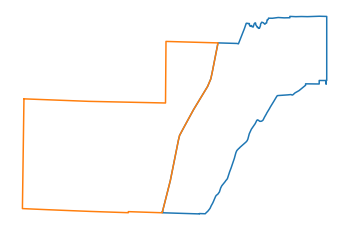

369. Nodes 159 and 148 are connected


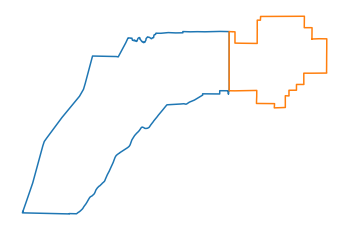

370. Nodes 159 and 151 are connected


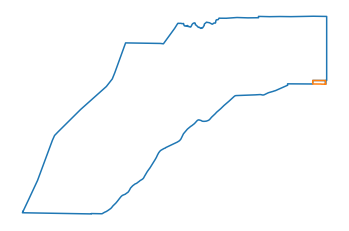

371. Nodes 160 and 131 are connected


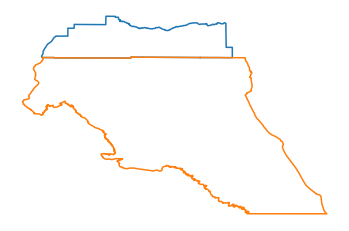

372. Nodes 160 and 133 are connected


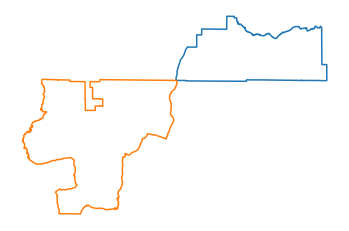

373. Nodes 161 and 160 are connected


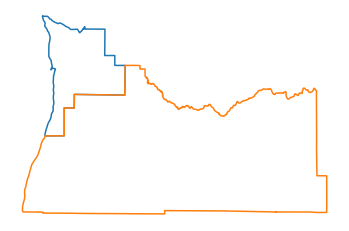

374. Nodes 162 and 133 are connected


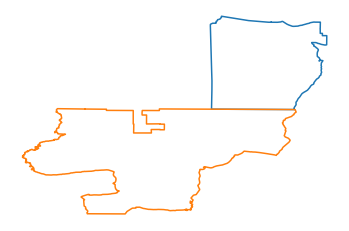

375. Nodes 162 and 160 are connected


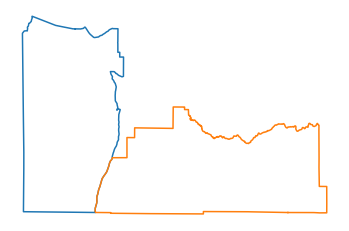

376. Nodes 162 and 161 are connected


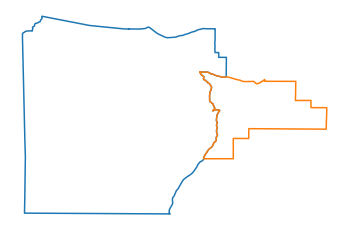

377. Nodes 163 and 96 are connected


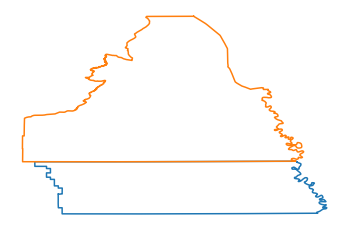

378. Nodes 163 and 131 are connected


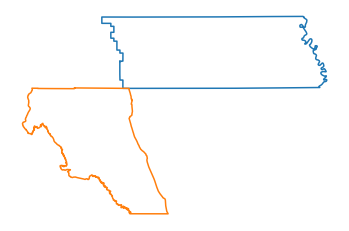

379. Nodes 163 and 132 are connected


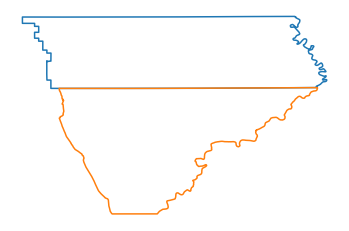

380. Nodes 163 and 160 are connected


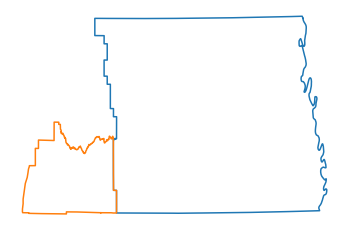

381. Nodes 164 and 96 are connected


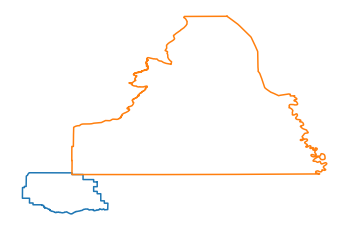

382. Nodes 164 and 160 are connected


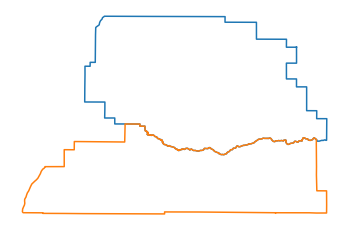

383. Nodes 164 and 161 are connected


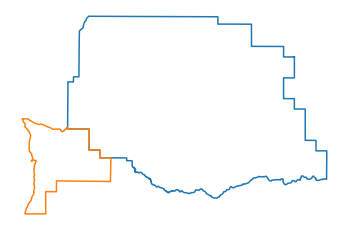

384. Nodes 164 and 163 are connected


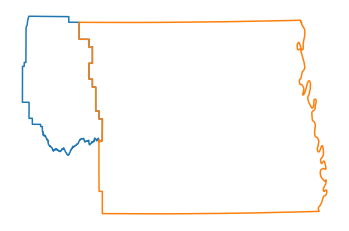

385. Nodes 165 and 161 are connected


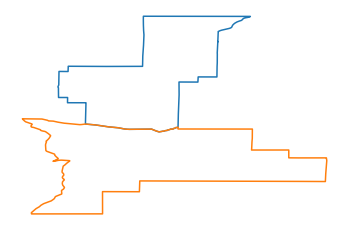

386. Nodes 165 and 162 are connected


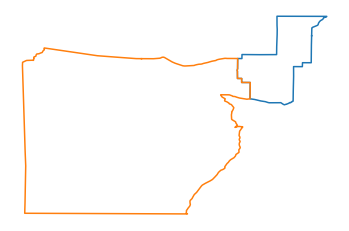

387. Nodes 165 and 164 are connected


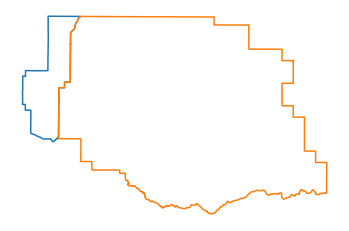

388. Nodes 166 and 162 are connected


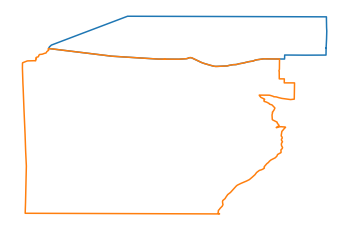

389. Nodes 166 and 165 are connected


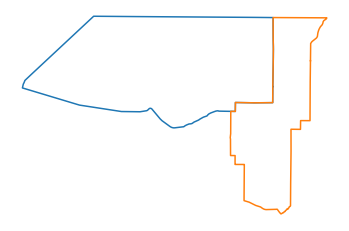

390. Nodes 167 and 162 are connected


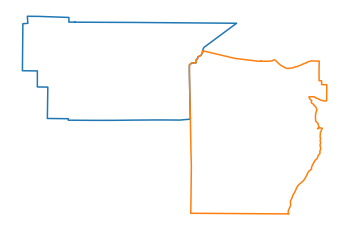

391. Nodes 167 and 166 are connected


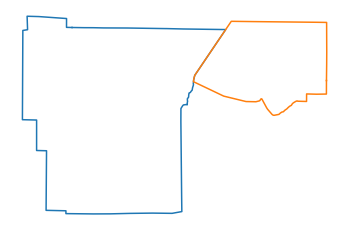

392. Nodes 168 and 133 are connected


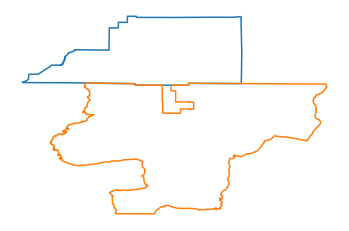

393. Nodes 168 and 139 are connected


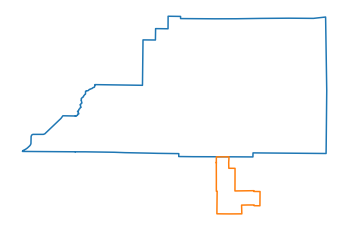

394. Nodes 168 and 162 are connected


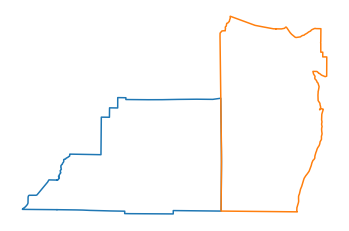

395. Nodes 168 and 167 are connected


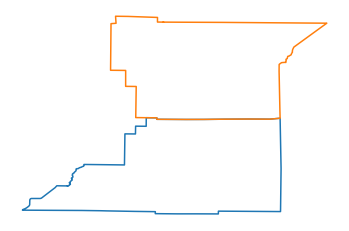

396. Nodes 169 and 168 are connected


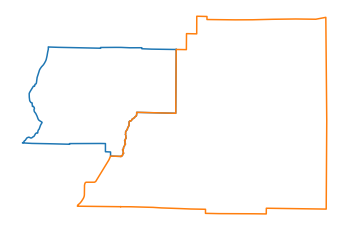

397. Nodes 170 and 167 are connected


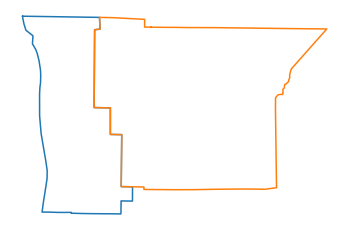

398. Nodes 170 and 168 are connected


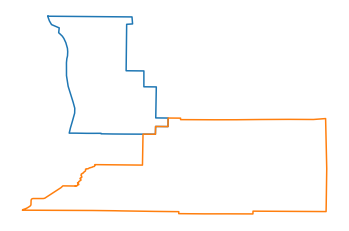

399. Nodes 170 and 169 are connected


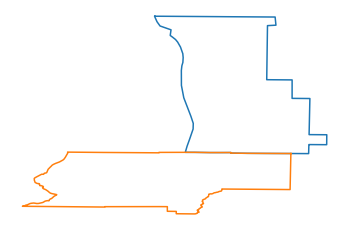

400. Nodes 171 and 169 are connected


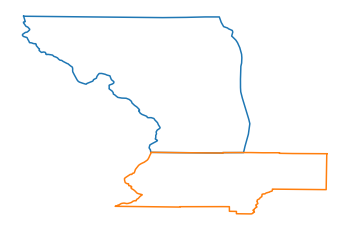

401. Nodes 171 and 170 are connected


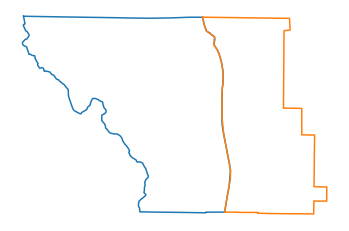

402. Nodes 172 and 168 are connected


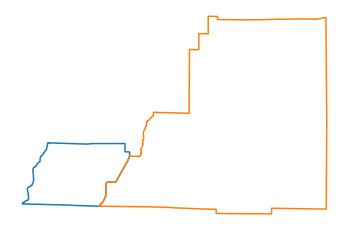

403. Nodes 172 and 169 are connected


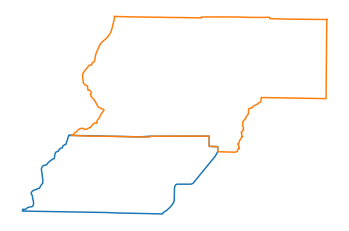

404. Nodes 174 and 173 are connected


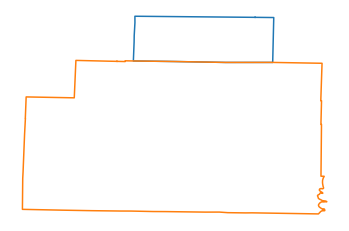

405. Nodes 175 and 173 are connected


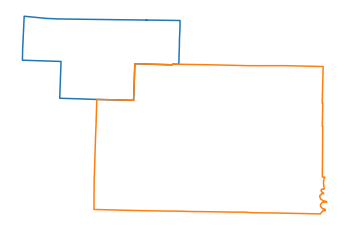

406. Nodes 175 and 174 are connected


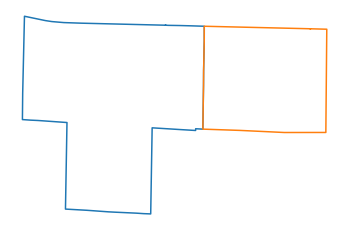

407. Nodes 177 and 176 are connected


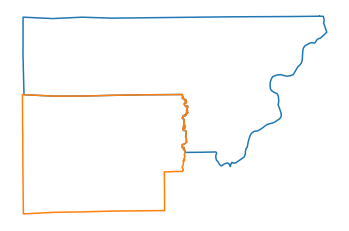

408. Nodes 178 and 173 are connected


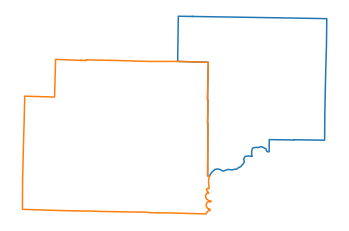

409. Nodes 178 and 174 are connected


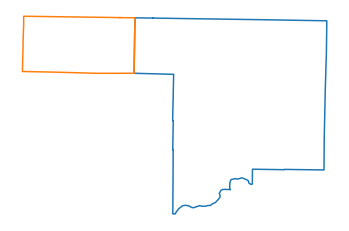

410. Nodes 180 and 177 are connected


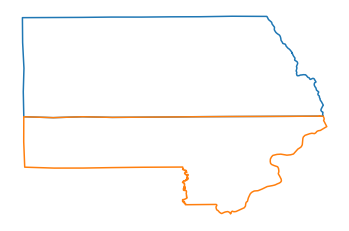

411. Nodes 180 and 179 are connected


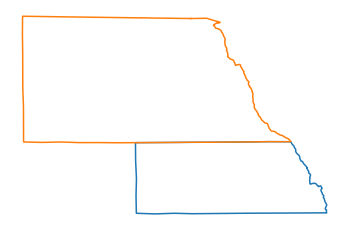

412. Nodes 181 and 178 are connected


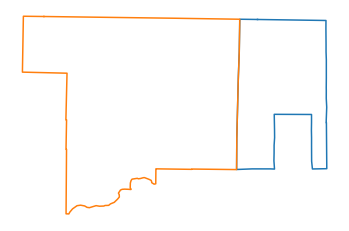

413. Nodes 181 and 179 are connected


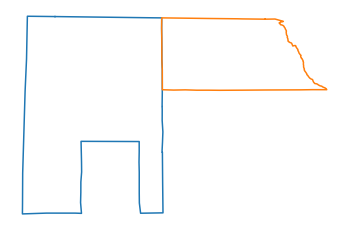

414. Nodes 185 and 183 are connected


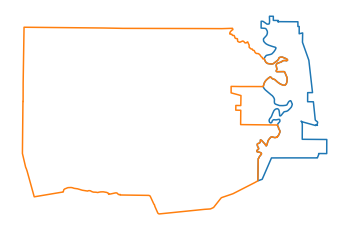

415. Nodes 186 and 184 are connected


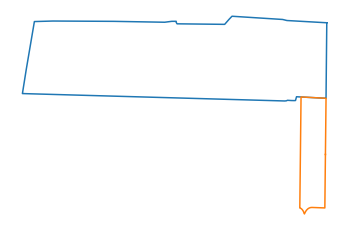

416. Nodes 186 and 185 are connected


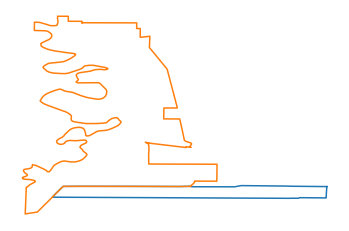

417. Nodes 187 and 184 are connected


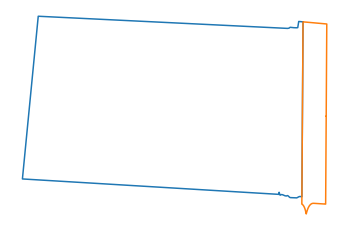

418. Nodes 187 and 185 are connected


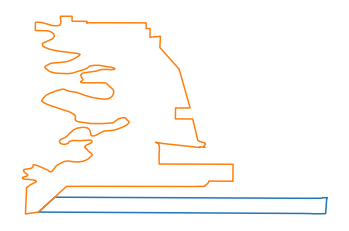

419. Nodes 187 and 186 are connected


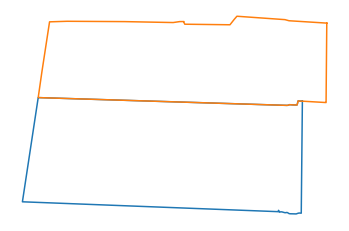

420. Nodes 188 and 185 are connected


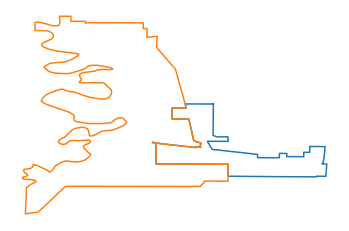

421. Nodes 189 and 185 are connected


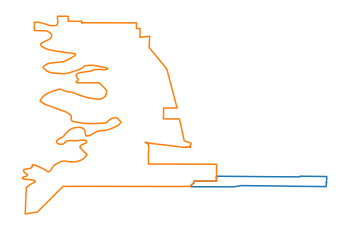

422. Nodes 189 and 186 are connected


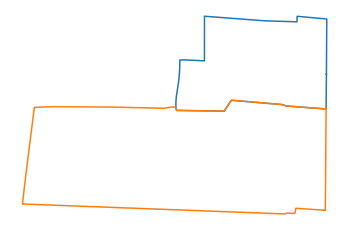

423. Nodes 189 and 188 are connected


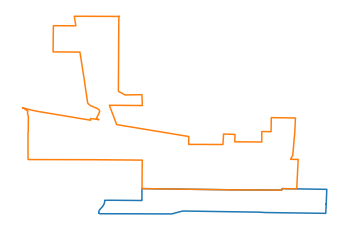

424. Nodes 190 and 188 are connected


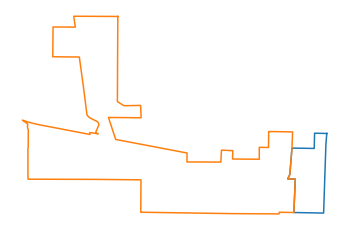

425. Nodes 190 and 189 are connected


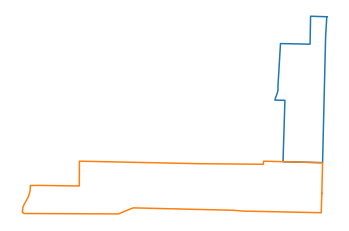

426. Nodes 191 and 189 are connected


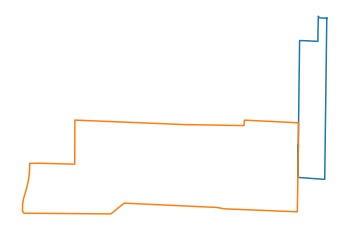

427. Nodes 191 and 190 are connected


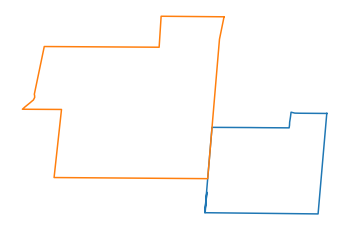

428. Nodes 192 and 191 are connected


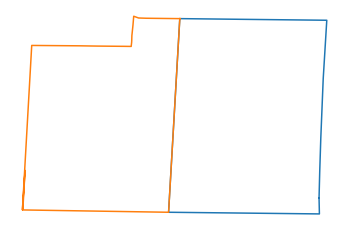

429. Nodes 193 and 192 are connected


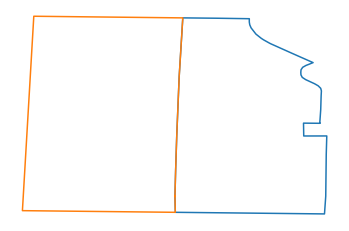

430. Nodes 194 and 190 are connected


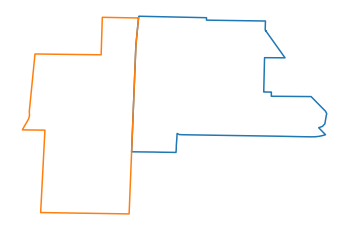

431. Nodes 194 and 191 are connected


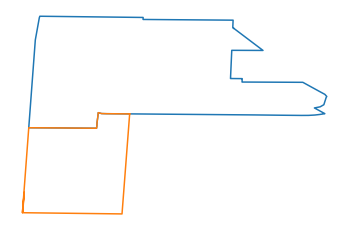

432. Nodes 194 and 192 are connected


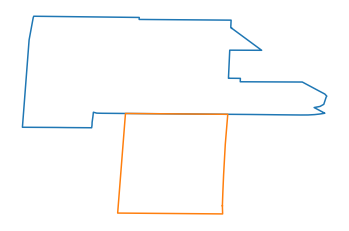

433. Nodes 194 and 193 are connected


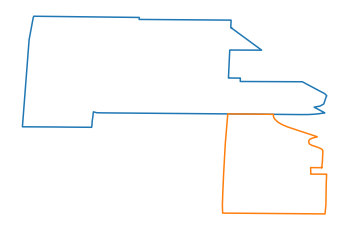

434. Nodes 195 and 183 are connected


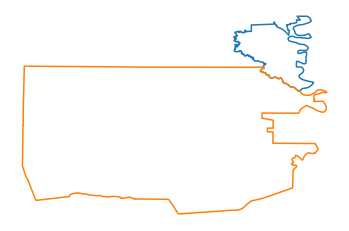

435. Nodes 195 and 185 are connected


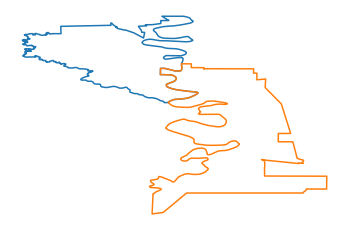

436. Nodes 197 and 176 are connected


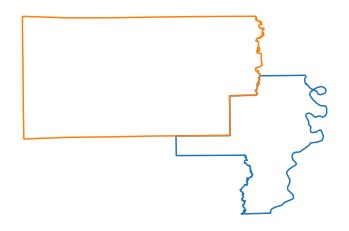

437. Nodes 197 and 177 are connected


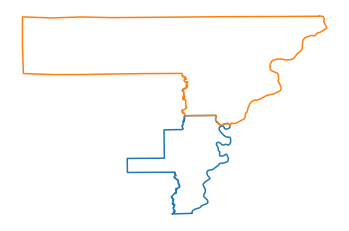

438. Nodes 198 and 197 are connected


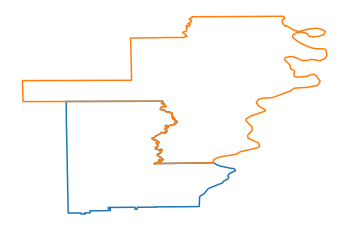

439. Nodes 199 and 195 are connected


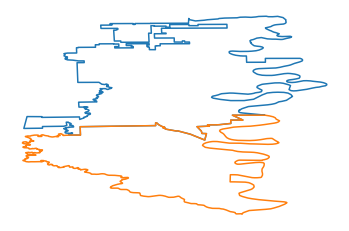

440. Nodes 199 and 196 are connected


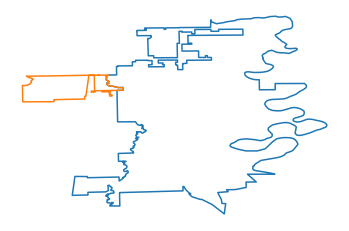

441. Nodes 199 and 198 are connected


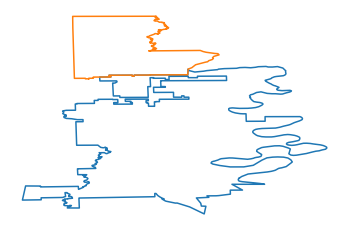

442. Nodes 200 and 198 are connected


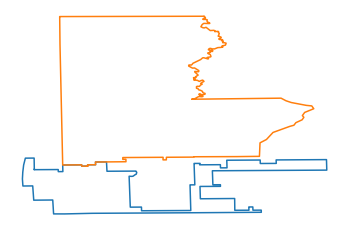

443. Nodes 200 and 199 are connected


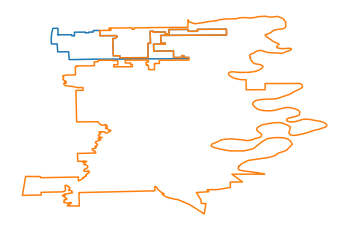

444. Nodes 201 and 200 are connected


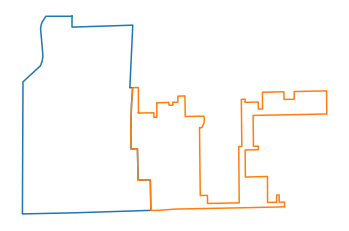

445. Nodes 202 and 176 are connected


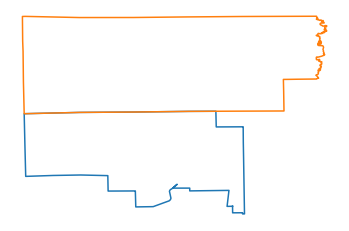

446. Nodes 202 and 197 are connected


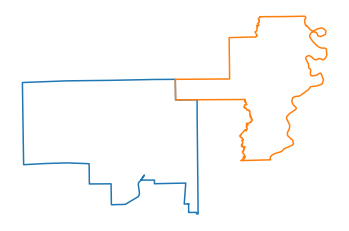

447. Nodes 202 and 198 are connected


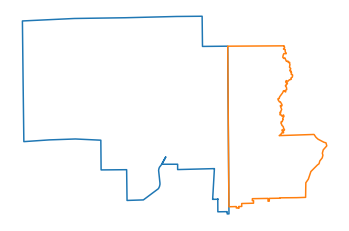

448. Nodes 202 and 200 are connected


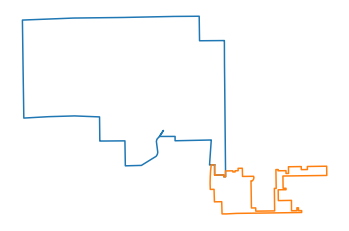

449. Nodes 202 and 201 are connected


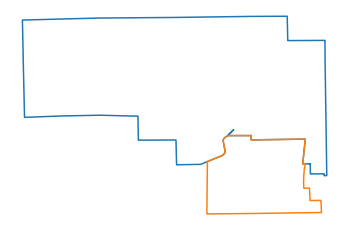

450. Nodes 203 and 176 are connected


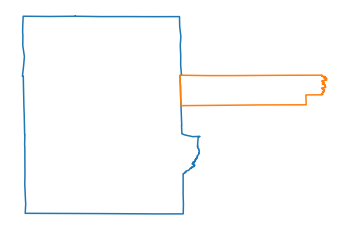

451. Nodes 203 and 177 are connected


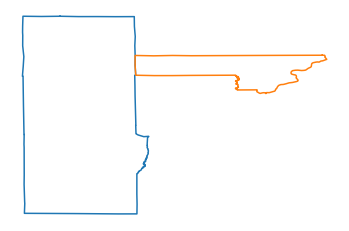

452. Nodes 203 and 179 are connected


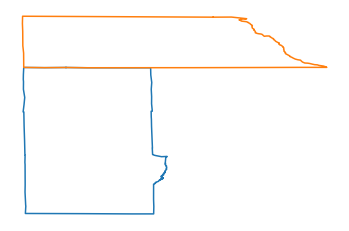

453. Nodes 203 and 180 are connected


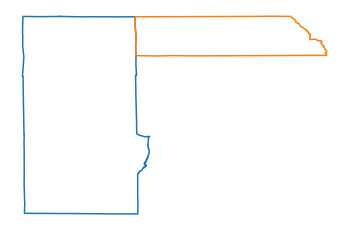

454. Nodes 203 and 181 are connected


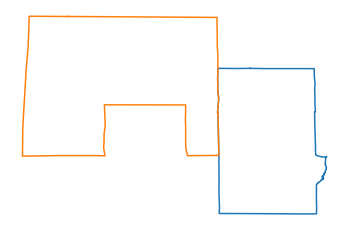

455. Nodes 203 and 183 are connected


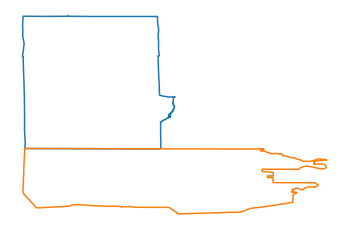

456. Nodes 203 and 202 are connected


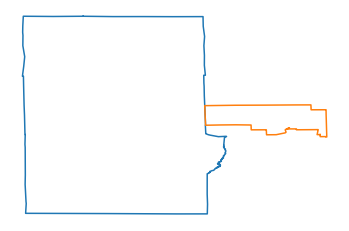

457. Nodes 204 and 183 are connected


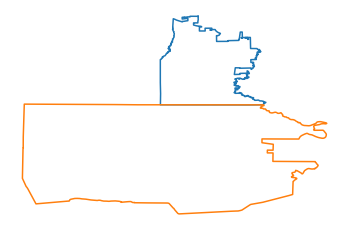

458. Nodes 204 and 195 are connected


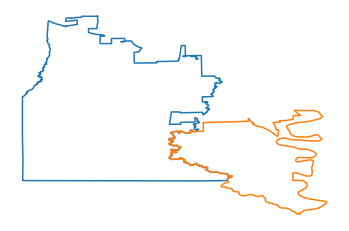

459. Nodes 204 and 196 are connected


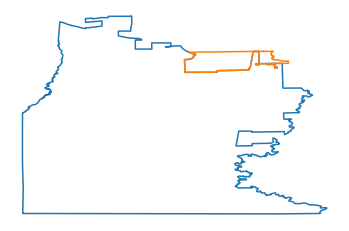

460. Nodes 204 and 199 are connected


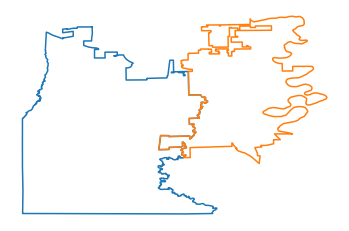

461. Nodes 204 and 203 are connected


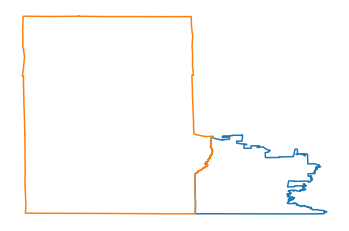

462. Nodes 205 and 196 are connected


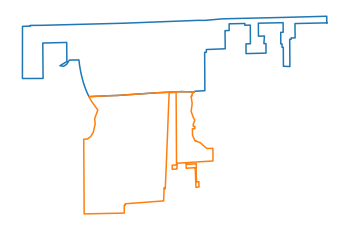

463. Nodes 205 and 199 are connected


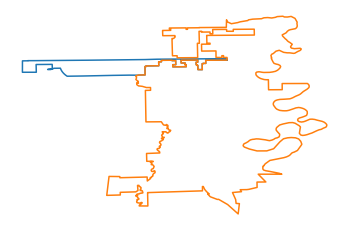

464. Nodes 205 and 200 are connected


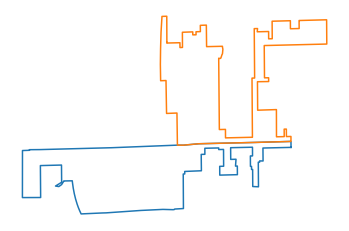

465. Nodes 205 and 201 are connected


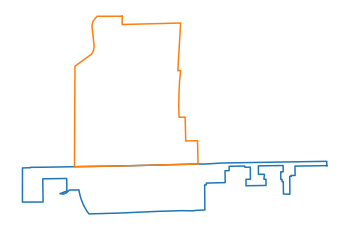

466. Nodes 205 and 204 are connected


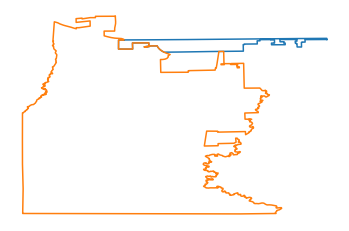

467. Nodes 206 and 184 are connected


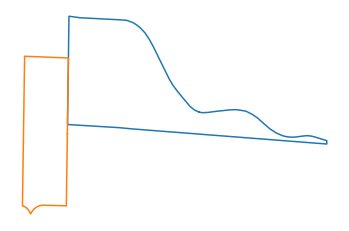

468. Nodes 206 and 186 are connected


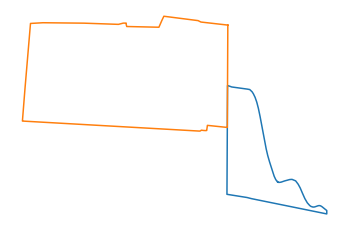

469. Nodes 207 and 184 are connected


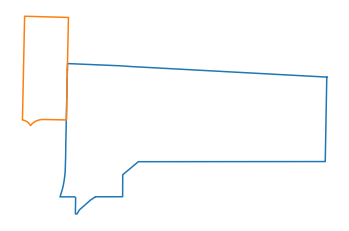

470. Nodes 207 and 206 are connected


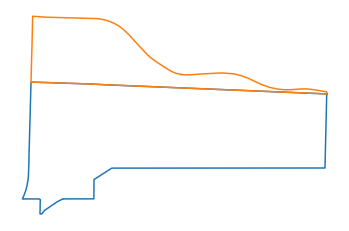

471. Nodes 208 and 199 are connected


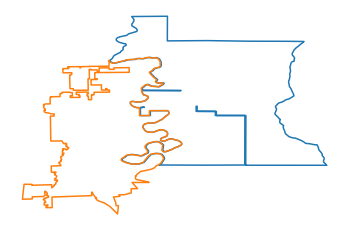

472. Nodes 209 and 185 are connected


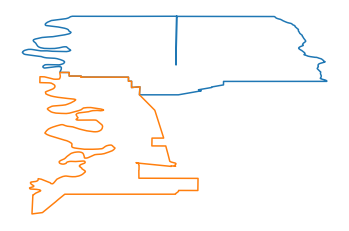

473. Nodes 209 and 195 are connected


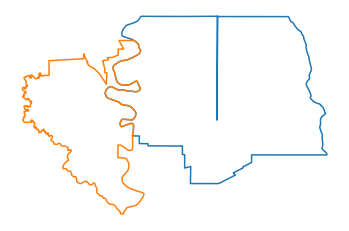

474. Nodes 209 and 199 are connected


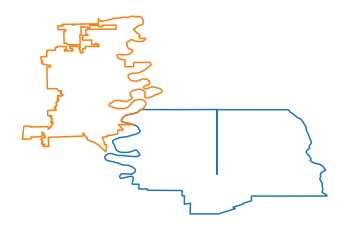

475. Nodes 209 and 208 are connected


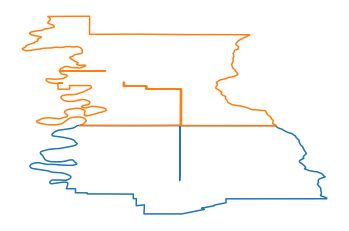

476. Nodes 210 and 207 are connected


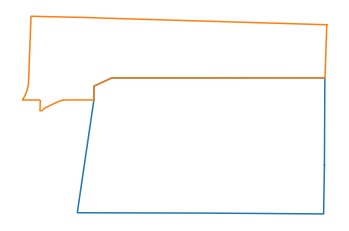

477. Nodes 211 and 185 are connected


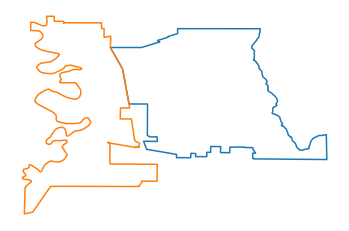

478. Nodes 211 and 188 are connected


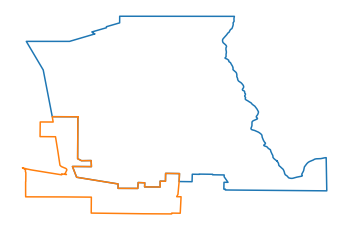

479. Nodes 211 and 190 are connected


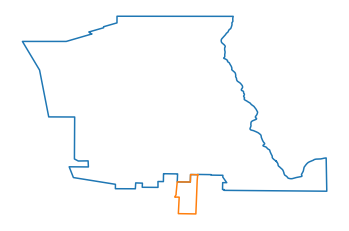

480. Nodes 211 and 194 are connected


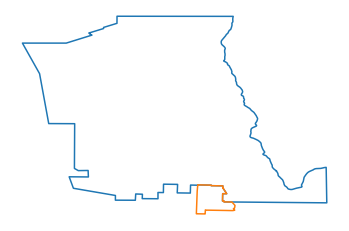

481. Nodes 211 and 209 are connected


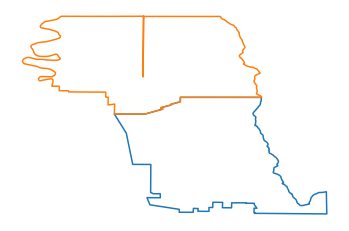

482. Nodes 212 and 206 are connected


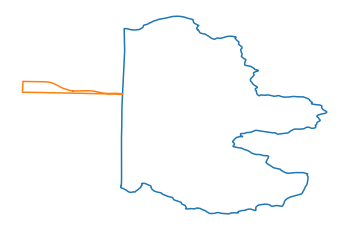

483. Nodes 212 and 207 are connected


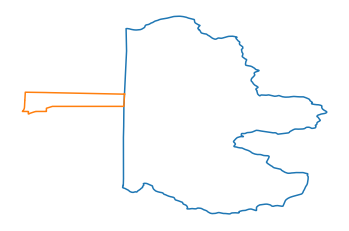

484. Nodes 212 and 210 are connected


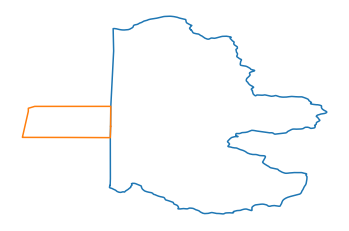

485. Nodes 213 and 186 are connected


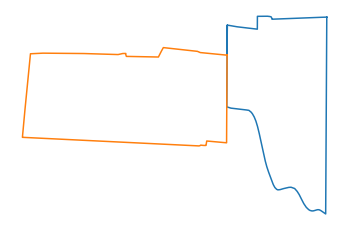

486. Nodes 213 and 189 are connected


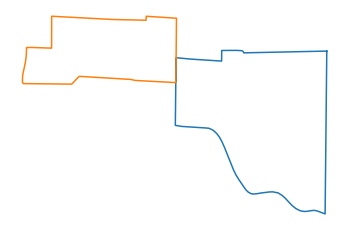

487. Nodes 213 and 191 are connected


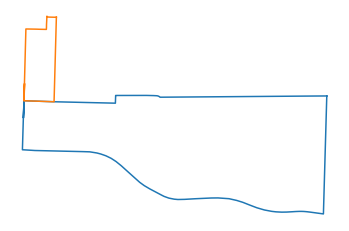

488. Nodes 213 and 192 are connected


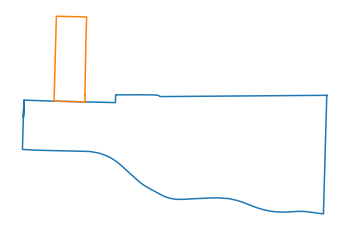

489. Nodes 213 and 193 are connected


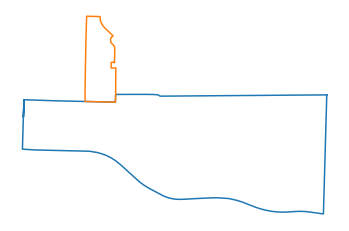

490. Nodes 213 and 206 are connected


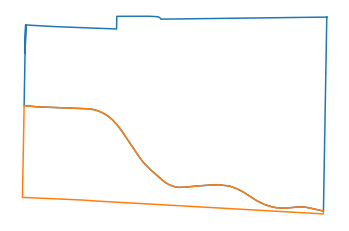

491. Nodes 213 and 212 are connected


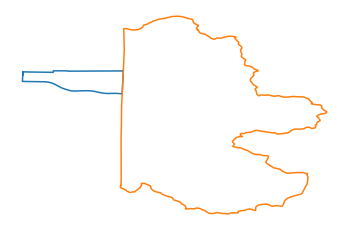

492. Nodes 214 and 193 are connected


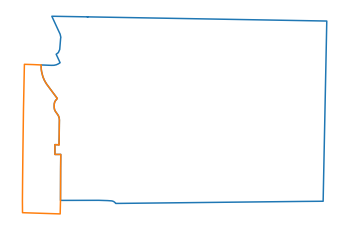

493. Nodes 214 and 194 are connected


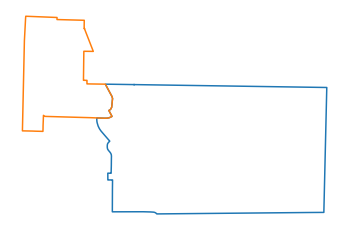

494. Nodes 214 and 211 are connected


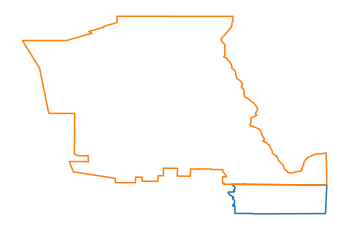

495. Nodes 214 and 212 are connected


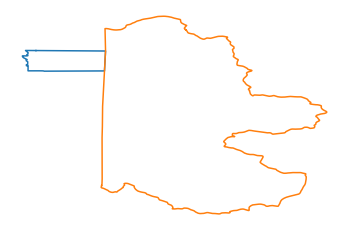

496. Nodes 214 and 213 are connected


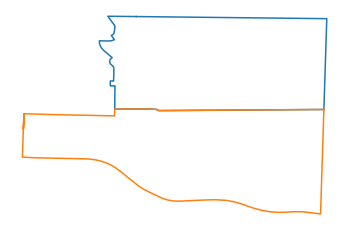

497. Nodes 216 and 173 are connected


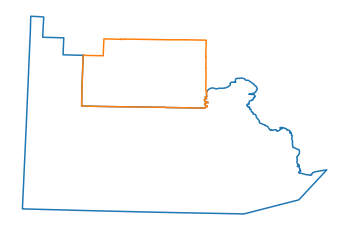

498. Nodes 216 and 175 are connected


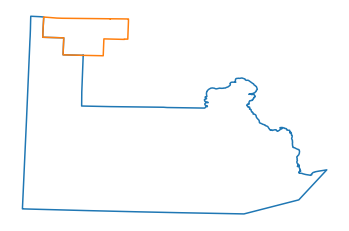

499. Nodes 216 and 178 are connected


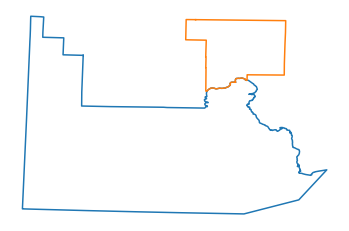

500. Nodes 217 and 183 are connected


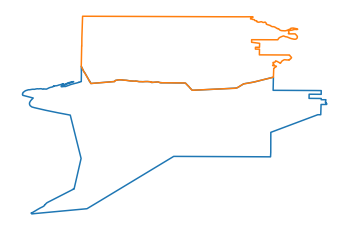

501. Nodes 217 and 215 are connected


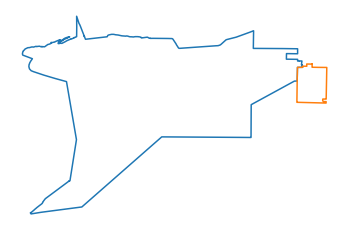

502. Nodes 217 and 216 are connected


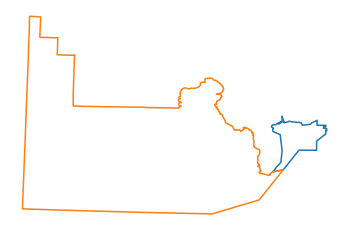

503. Nodes 218 and 178 are connected


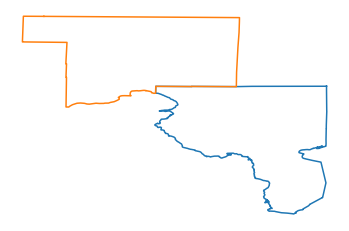

504. Nodes 218 and 181 are connected


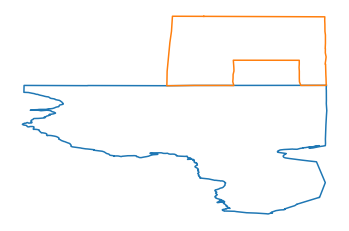

505. Nodes 218 and 183 are connected


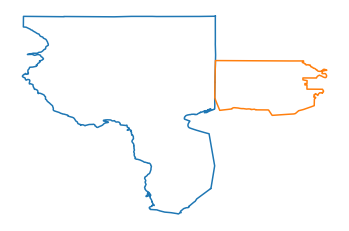

506. Nodes 218 and 203 are connected


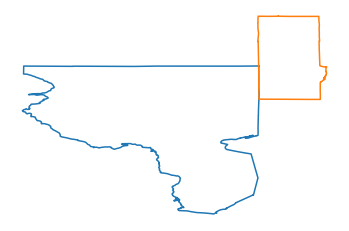

507. Nodes 218 and 216 are connected


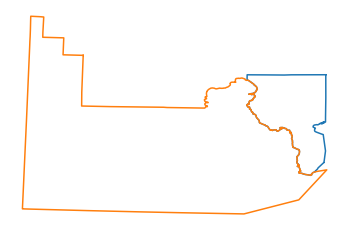

508. Nodes 218 and 217 are connected


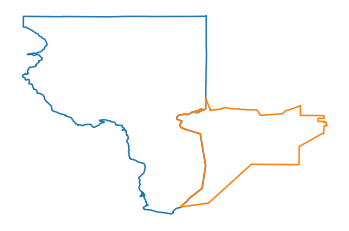

509. Nodes 219 and 184 are connected


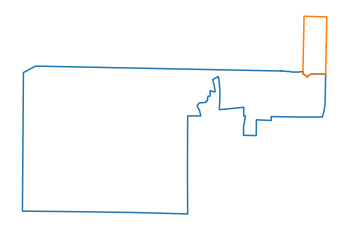

510. Nodes 219 and 185 are connected


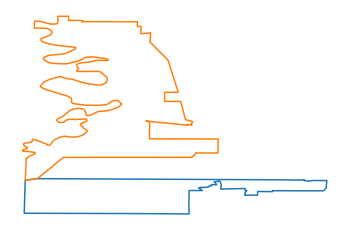

511. Nodes 219 and 187 are connected


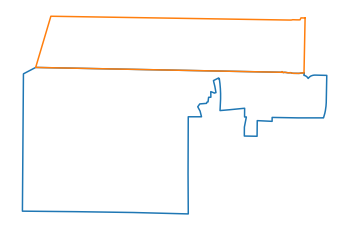

512. Nodes 219 and 207 are connected


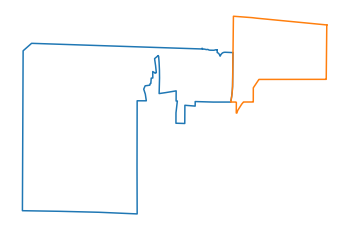

513. Nodes 219 and 217 are connected


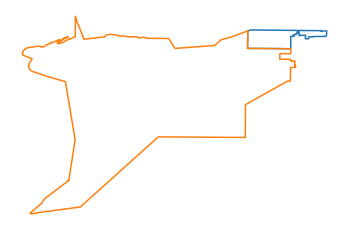

514. Nodes 220 and 182 are connected


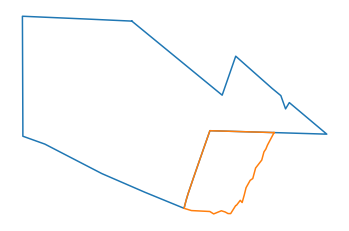

515. Nodes 220 and 217 are connected


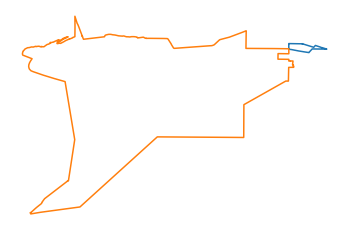

516. Nodes 220 and 219 are connected


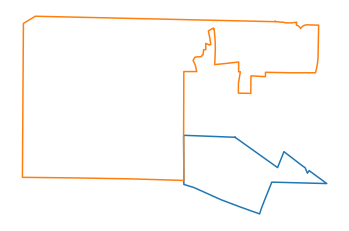

517. Nodes 221 and 210 are connected


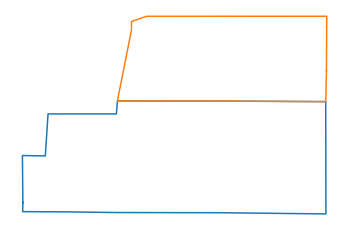

518. Nodes 221 and 212 are connected


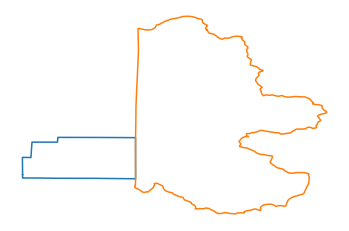

519. Nodes 221 and 215 are connected


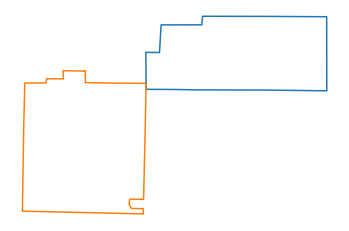

520. Nodes 222 and 183 are connected


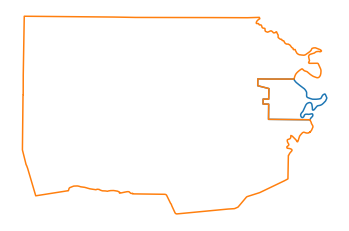

521. Nodes 222 and 185 are connected


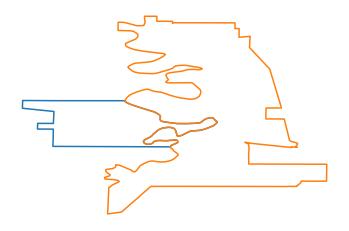

522. Nodes 223 and 181 are connected


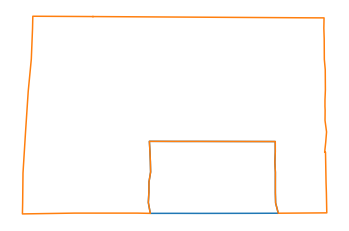

523. Nodes 223 and 218 are connected


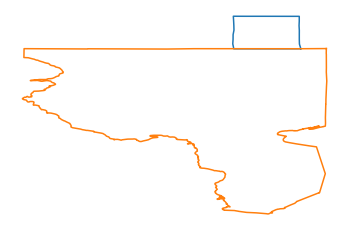

524. Nodes 224 and 212 are connected


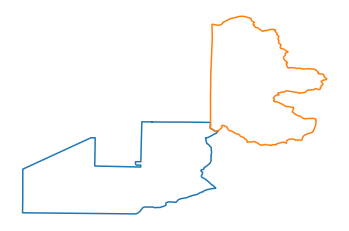

525. Nodes 224 and 215 are connected


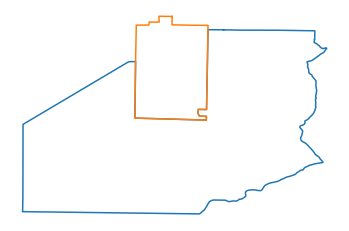

526. Nodes 224 and 217 are connected


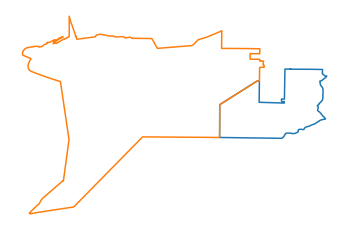

527. Nodes 224 and 221 are connected


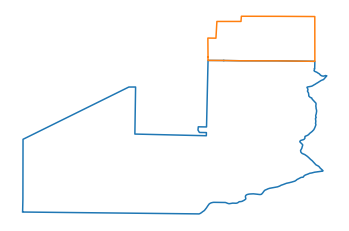

528. Nodes 225 and 207 are connected


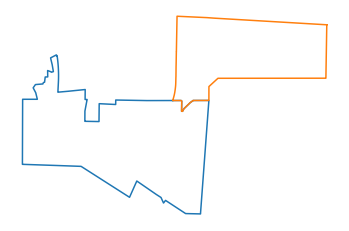

529. Nodes 225 and 210 are connected


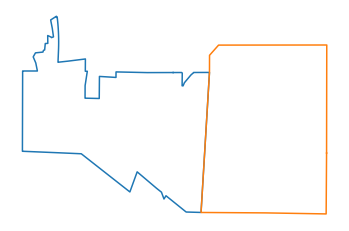

530. Nodes 225 and 219 are connected


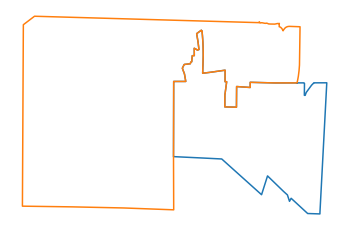

531. Nodes 225 and 220 are connected


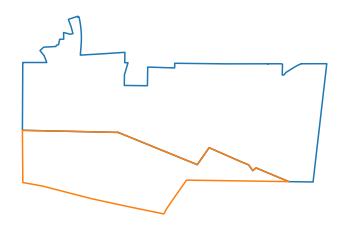

532. Nodes 226 and 182 are connected


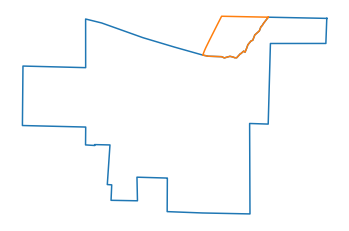

533. Nodes 226 and 215 are connected


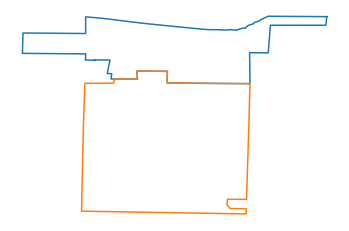

534. Nodes 226 and 217 are connected


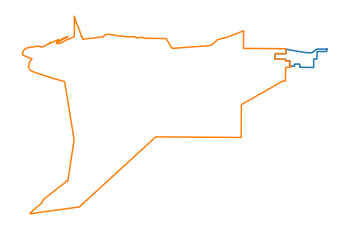

535. Nodes 226 and 220 are connected


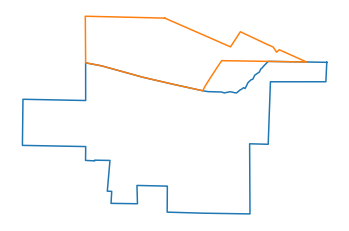

536. Nodes 226 and 221 are connected


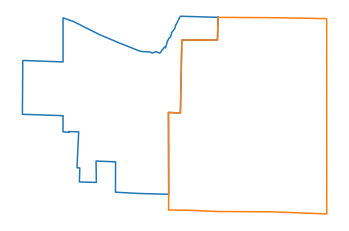

537. Nodes 226 and 225 are connected


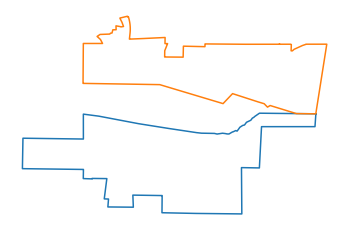

538. Nodes 227 and 201 are connected


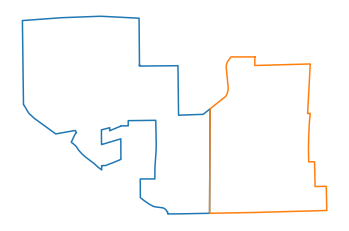

539. Nodes 227 and 202 are connected


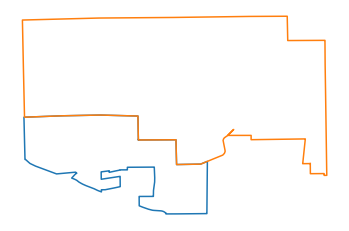

540. Nodes 227 and 203 are connected


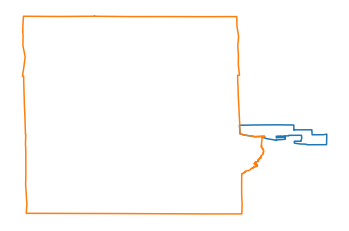

541. Nodes 227 and 204 are connected


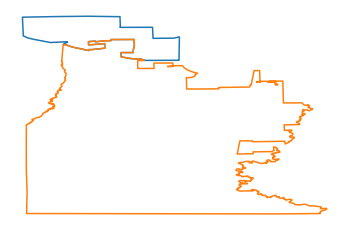

542. Nodes 227 and 205 are connected


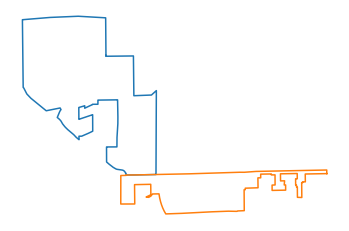

543. Nodes 229 and 228 are connected


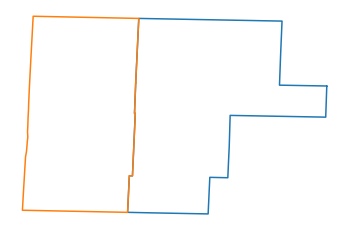

544. Nodes 230 and 229 are connected


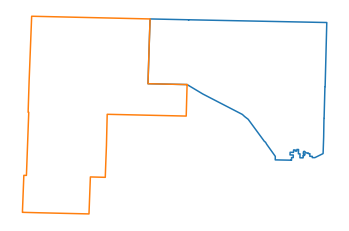

545. Nodes 231 and 229 are connected


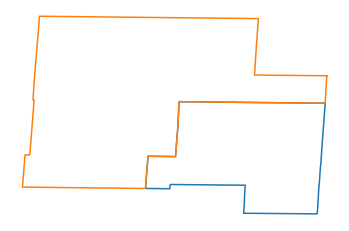

546. Nodes 234 and 230 are connected


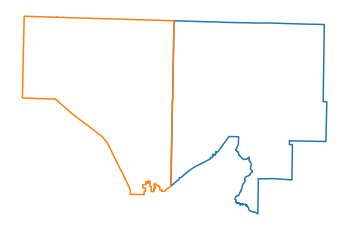

547. Nodes 235 and 234 are connected


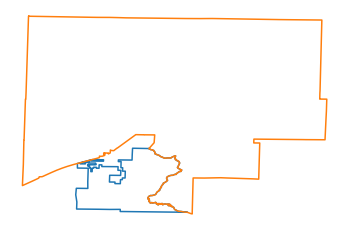

548. Nodes 236 and 234 are connected


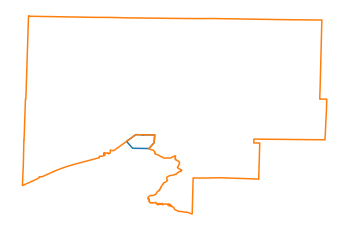

549. Nodes 236 and 235 are connected


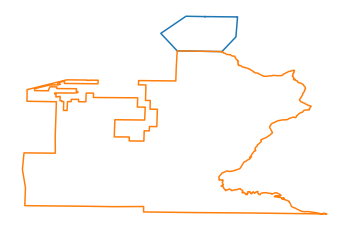

550. Nodes 237 and 230 are connected


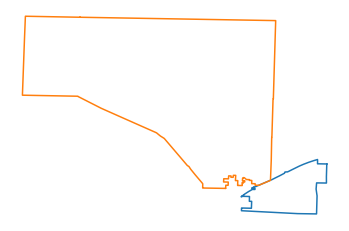

551. Nodes 237 and 233 are connected


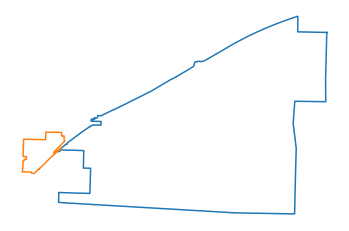

552. Nodes 237 and 234 are connected


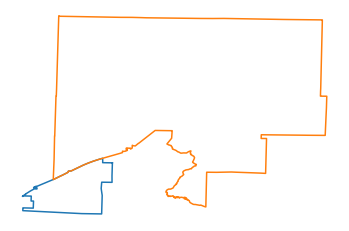

553. Nodes 237 and 235 are connected


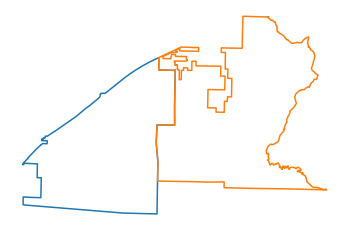

554. Nodes 238 and 233 are connected


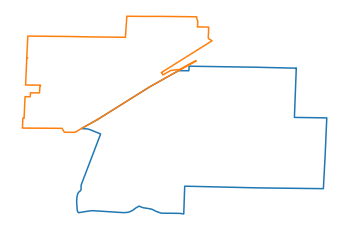

555. Nodes 238 and 237 are connected


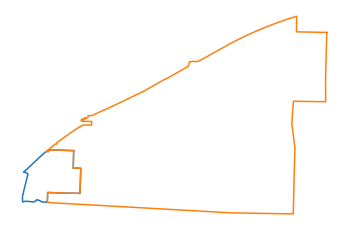

556. Nodes 240 and 238 are connected


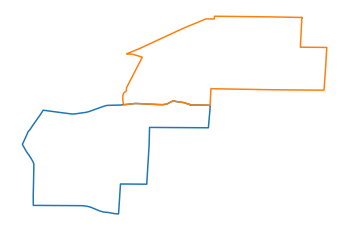

557. Nodes 240 and 239 are connected


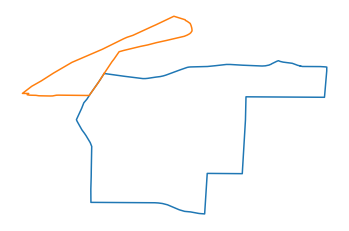

558. Nodes 241 and 239 are connected


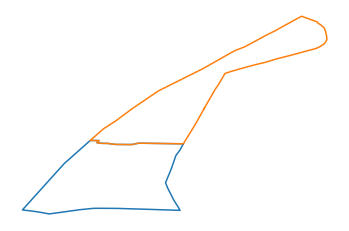

559. Nodes 241 and 240 are connected


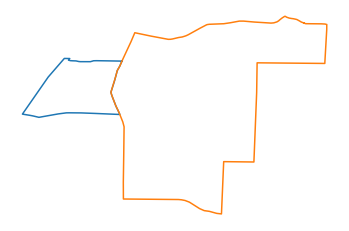

560. Nodes 242 and 240 are connected


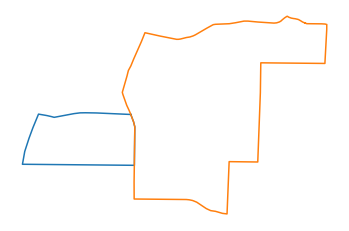

561. Nodes 242 and 241 are connected


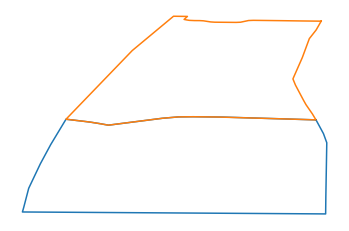

562. Nodes 243 and 240 are connected


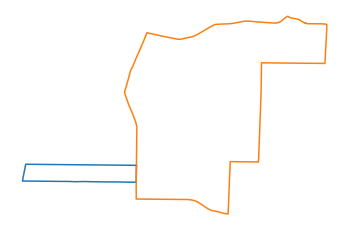

563. Nodes 243 and 242 are connected


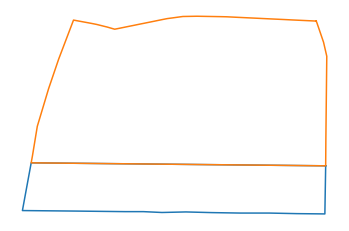

564. Nodes 244 and 232 are connected


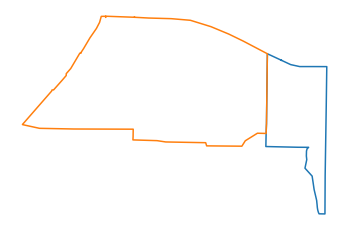

565. Nodes 245 and 240 are connected


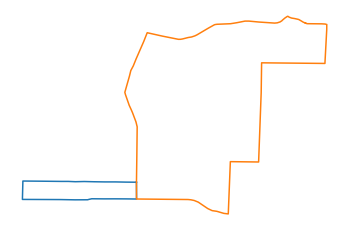

566. Nodes 245 and 243 are connected


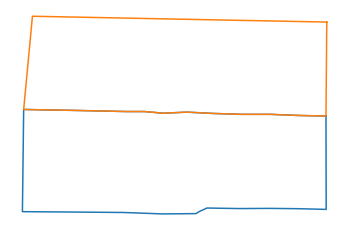

567. Nodes 245 and 244 are connected


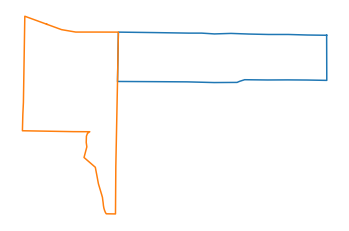

568. Nodes 246 and 245 are connected


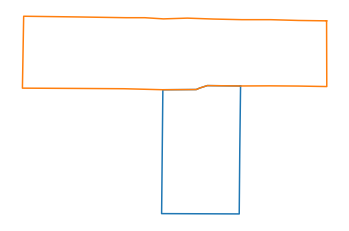

569. Nodes 247 and 245 are connected


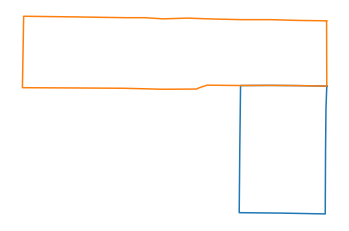

570. Nodes 247 and 246 are connected


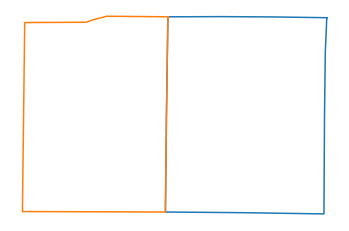

571. Nodes 248 and 240 are connected


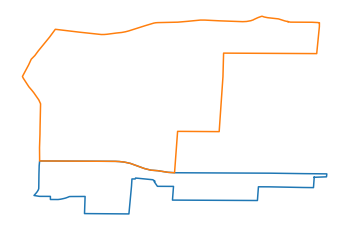

572. Nodes 248 and 247 are connected


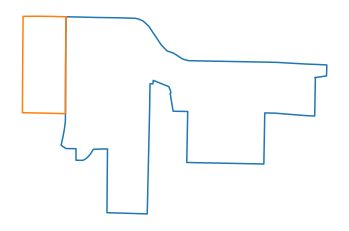

573. Nodes 249 and 244 are connected


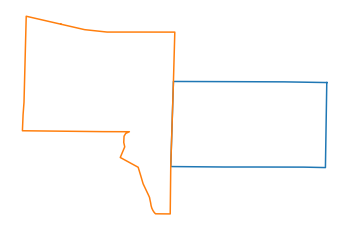

574. Nodes 249 and 245 are connected


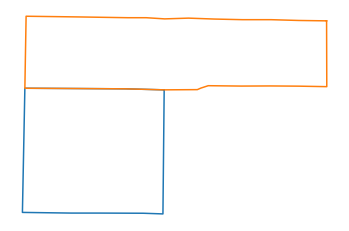

575. Nodes 249 and 246 are connected


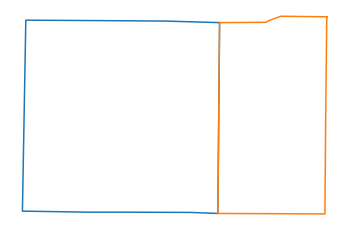

576. Nodes 250 and 232 are connected


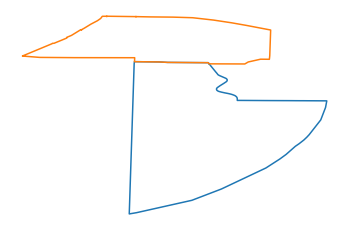

577. Nodes 251 and 244 are connected


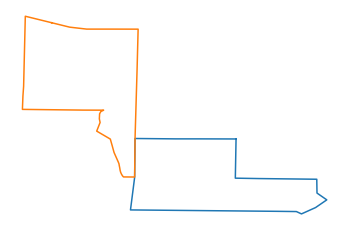

578. Nodes 251 and 249 are connected


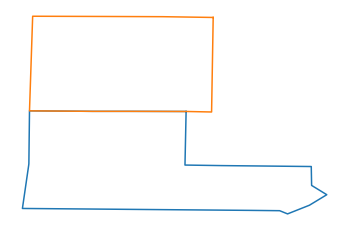

579. Nodes 252 and 246 are connected


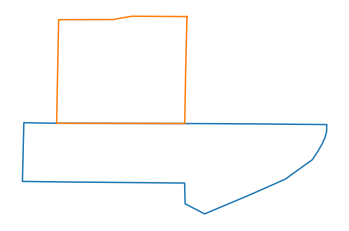

580. Nodes 252 and 247 are connected


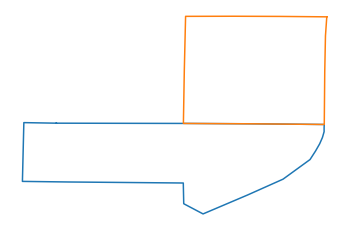

581. Nodes 252 and 248 are connected


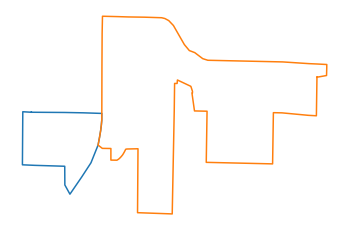

582. Nodes 252 and 249 are connected


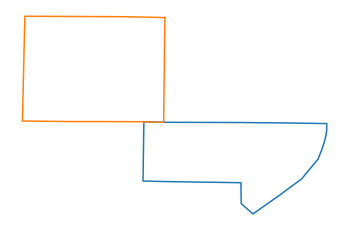

583. Nodes 252 and 251 are connected


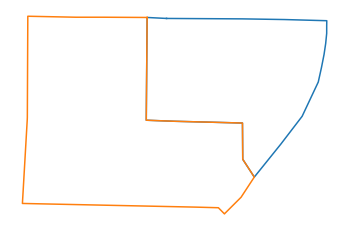

584. Nodes 253 and 248 are connected


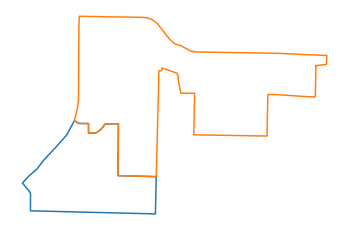

585. Nodes 253 and 251 are connected


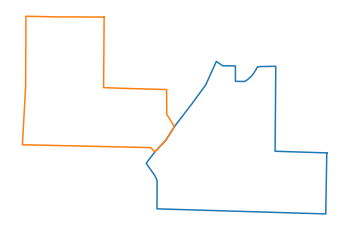

586. Nodes 253 and 252 are connected


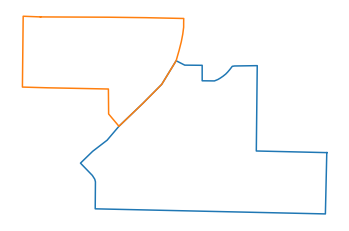

587. Nodes 254 and 250 are connected


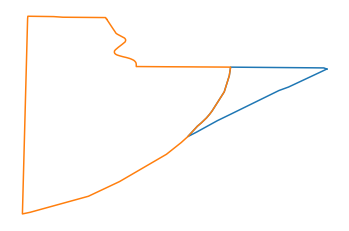

588. Nodes 254 and 251 are connected


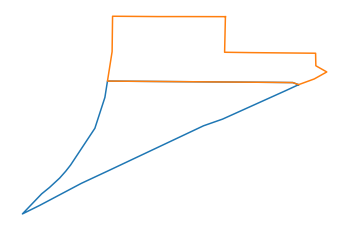

589. Nodes 254 and 253 are connected


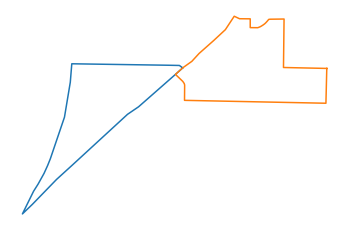

590. Nodes 255 and 248 are connected


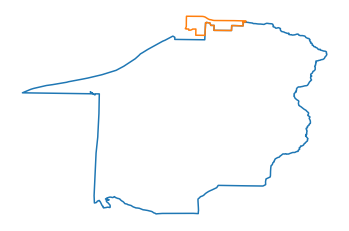

591. Nodes 255 and 250 are connected


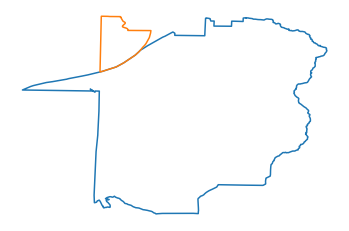

592. Nodes 255 and 253 are connected


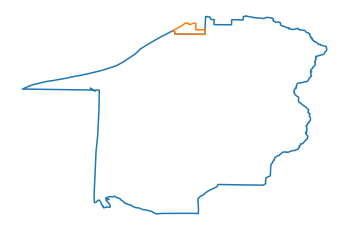

593. Nodes 255 and 254 are connected


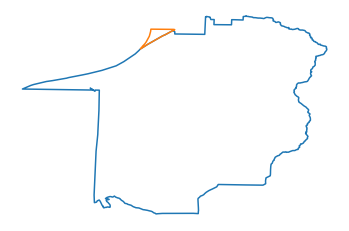

594. Nodes 256 and 232 are connected


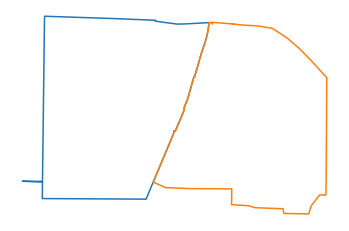

595. Nodes 257 and 232 are connected


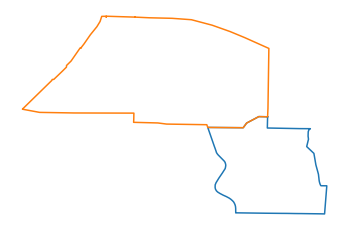

596. Nodes 257 and 244 are connected


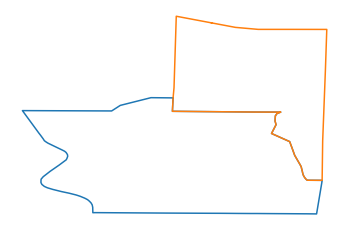

597. Nodes 257 and 250 are connected


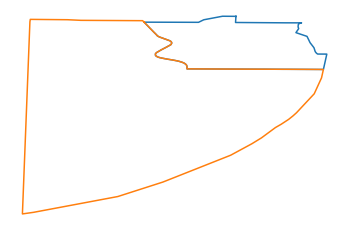

598. Nodes 257 and 251 are connected


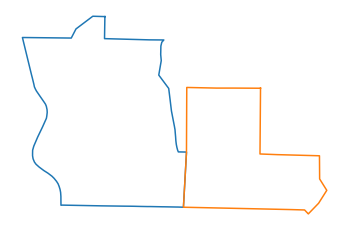

599. Nodes 258 and 233 are connected


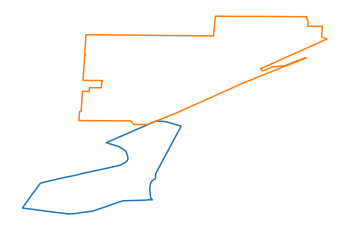

600. Nodes 258 and 238 are connected


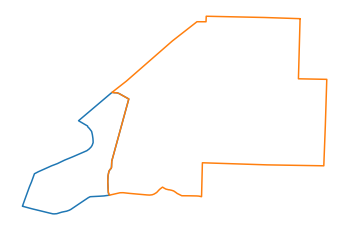

601. Nodes 258 and 239 are connected


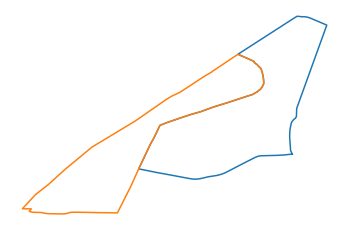

602. Nodes 258 and 240 are connected


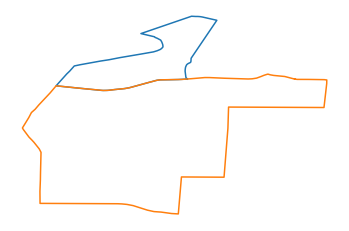

603. Nodes 259 and 230 are connected


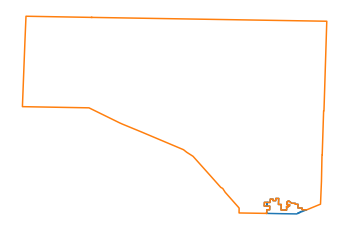

604. Nodes 259 and 237 are connected


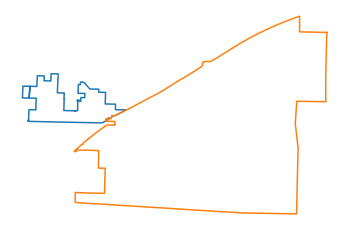

605. Nodes 260 and 235 are connected


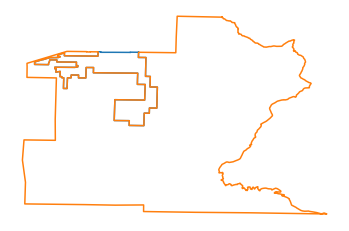

606. Nodes 261 and 233 are connected


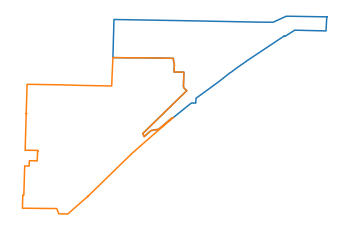

607. Nodes 261 and 237 are connected


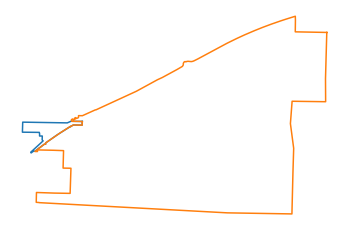

608. Nodes 261 and 259 are connected


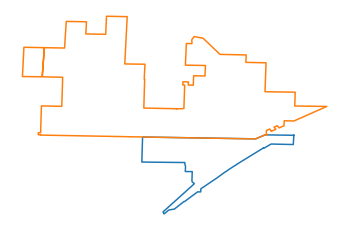

609. Nodes 262 and 233 are connected


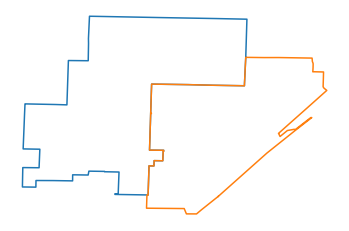

610. Nodes 262 and 259 are connected


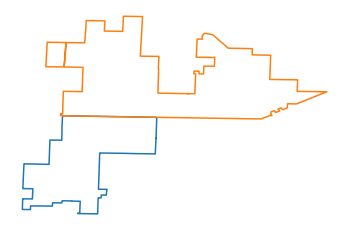

611. Nodes 262 and 261 are connected


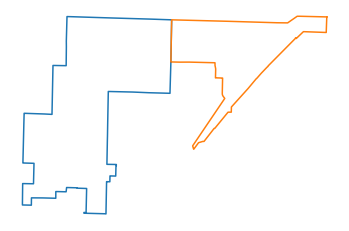

612. Nodes 263 and 234 are connected


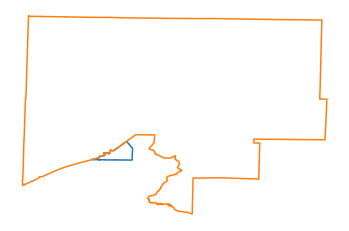

613. Nodes 263 and 235 are connected


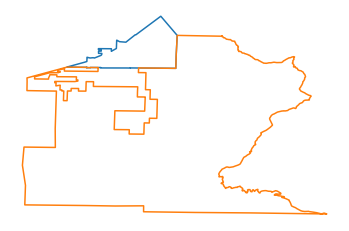

614. Nodes 263 and 236 are connected


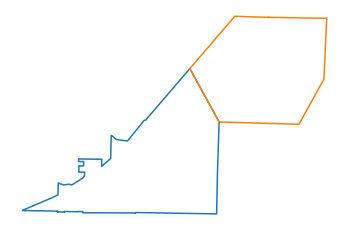

615. Nodes 263 and 260 are connected


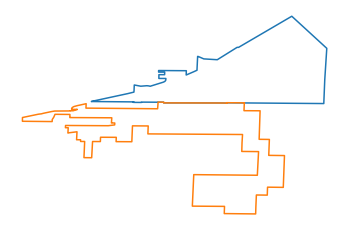

616. Nodes 264 and 231 are connected


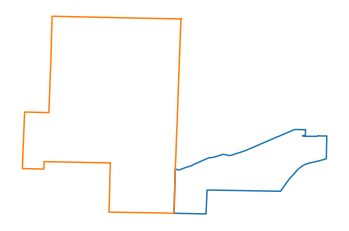

617. Nodes 264 and 232 are connected


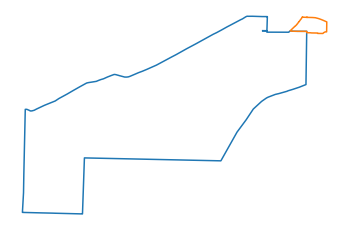

618. Nodes 264 and 250 are connected


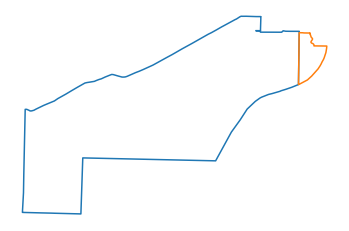

619. Nodes 264 and 255 are connected


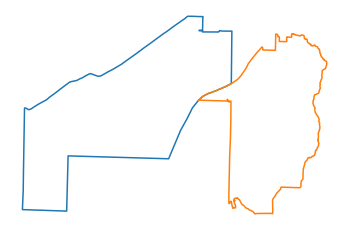

620. Nodes 264 and 256 are connected


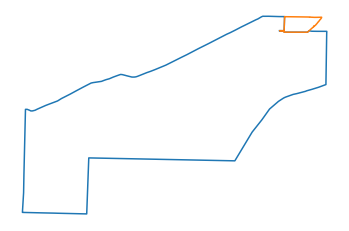

621. Nodes 265 and 229 are connected


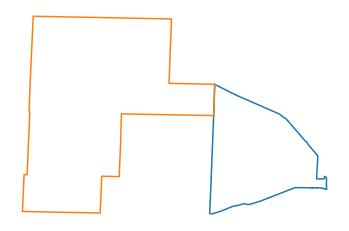

622. Nodes 265 and 230 are connected


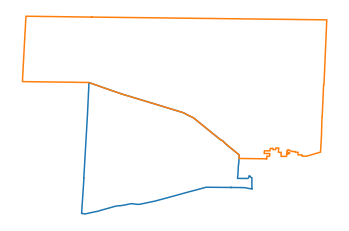

623. Nodes 265 and 231 are connected


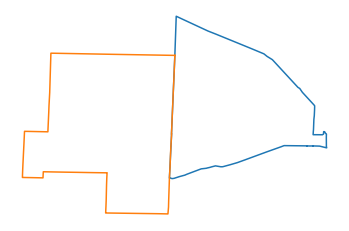

624. Nodes 265 and 232 are connected


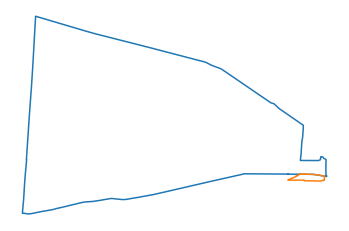

625. Nodes 265 and 244 are connected


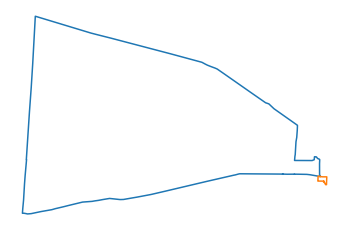

626. Nodes 265 and 256 are connected


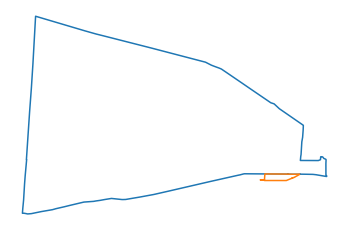

627. Nodes 265 and 264 are connected


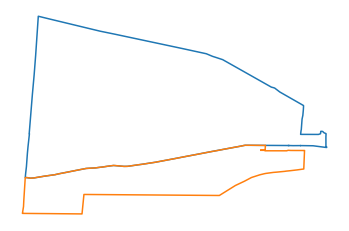

628. Nodes 266 and 4 are connected


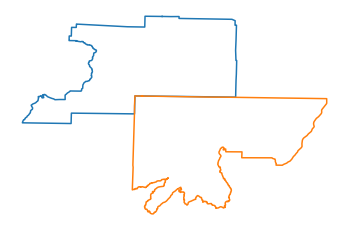

629. Nodes 266 and 138 are connected


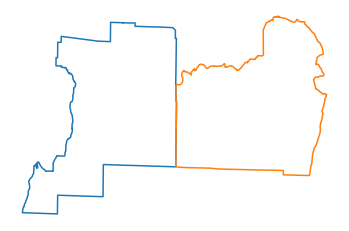

630. Nodes 266 and 234 are connected


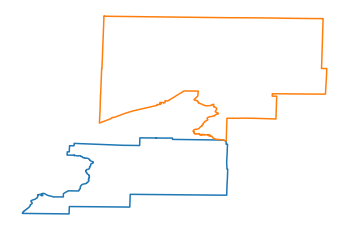

631. Nodes 266 and 235 are connected


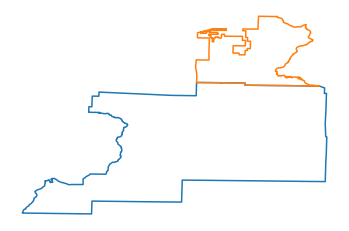

632. Nodes 266 and 237 are connected


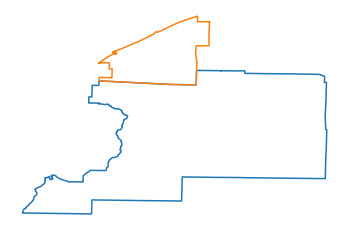

633. Nodes 266 and 240 are connected


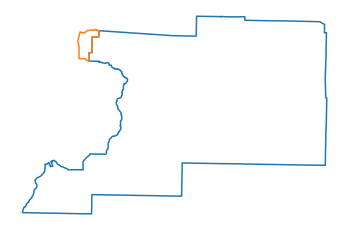

634. Nodes 266 and 248 are connected


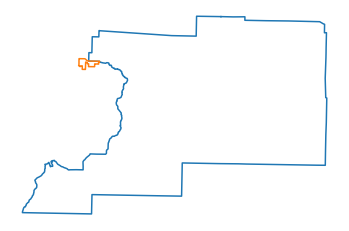

635. Nodes 266 and 255 are connected


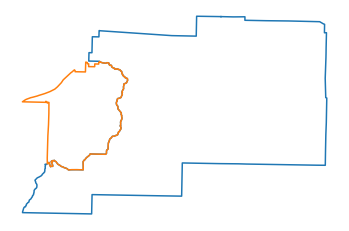

636. Nodes 267 and 230 are connected


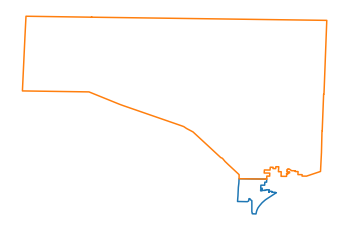

637. Nodes 267 and 233 are connected


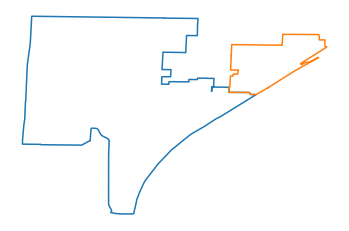

638. Nodes 267 and 239 are connected


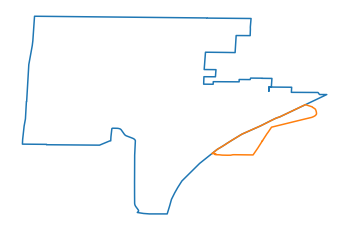

639. Nodes 267 and 241 are connected


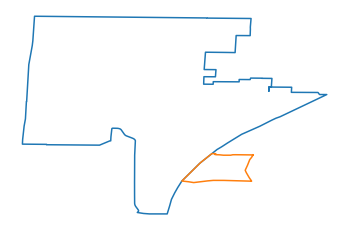

640. Nodes 267 and 242 are connected


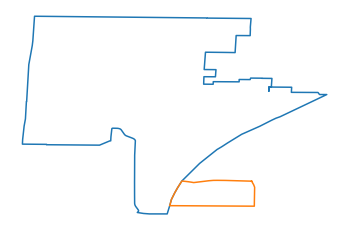

641. Nodes 267 and 243 are connected


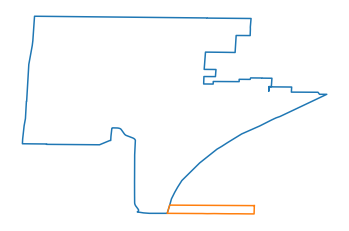

642. Nodes 267 and 244 are connected


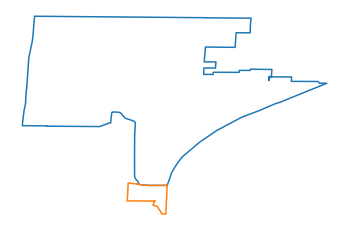

643. Nodes 267 and 258 are connected


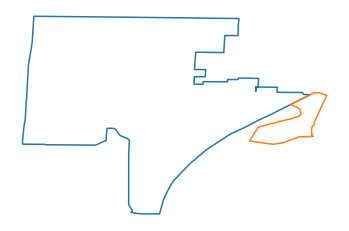

644. Nodes 267 and 262 are connected


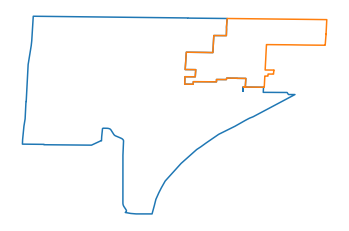

645. Nodes 267 and 265 are connected


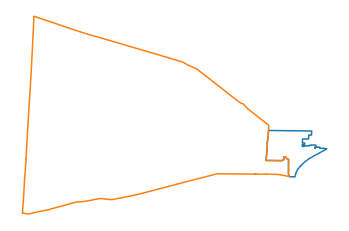

646. Nodes 268 and 255 are connected


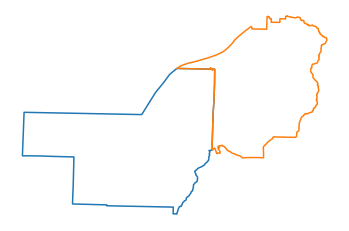

647. Nodes 268 and 264 are connected


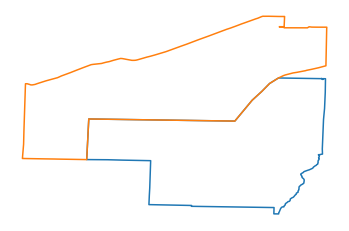

648. Nodes 268 and 266 are connected


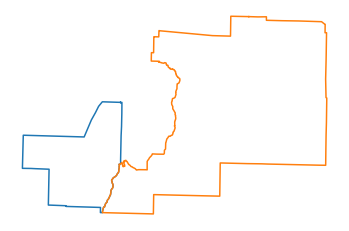

649. Nodes 269 and 169 are connected


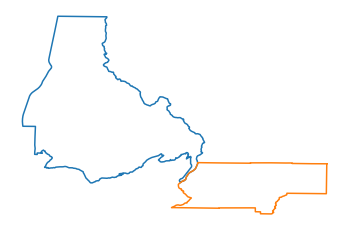

650. Nodes 269 and 171 are connected


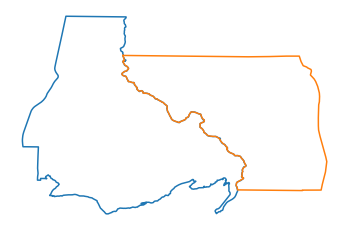

651. Nodes 271 and 228 are connected


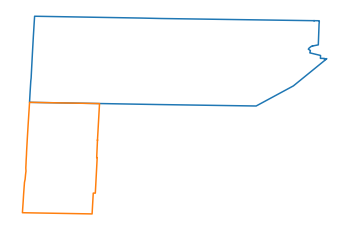

652. Nodes 271 and 229 are connected


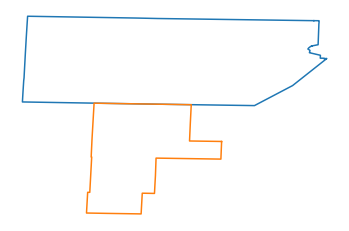

653. Nodes 271 and 230 are connected


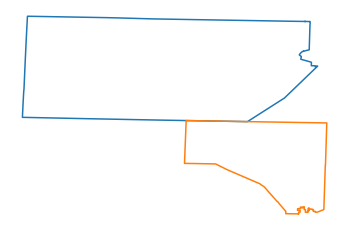

654. Nodes 272 and 270 are connected


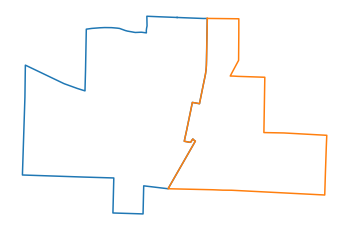

655. Nodes 272 and 271 are connected


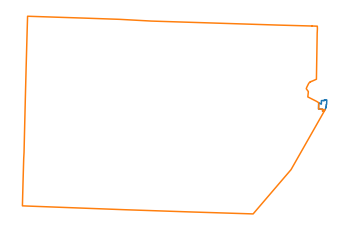

656. Nodes 273 and 269 are connected


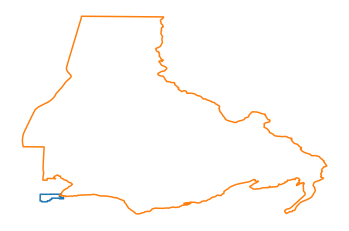

657. Nodes 274 and 273 are connected


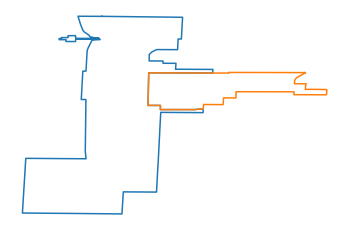

658. Nodes 275 and 230 are connected


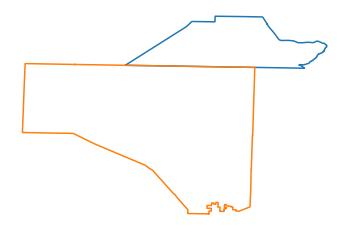

659. Nodes 275 and 234 are connected


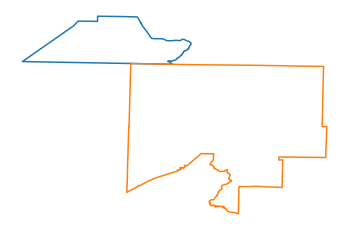

660. Nodes 275 and 271 are connected


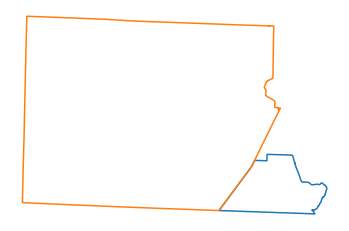

661. Nodes 276 and 234 are connected


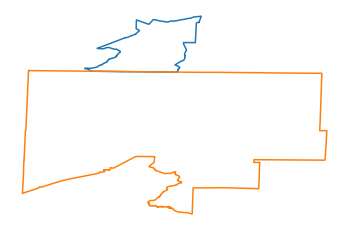

662. Nodes 276 and 275 are connected


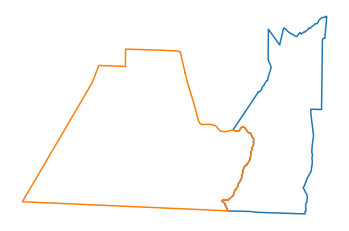

663. Nodes 277 and 169 are connected


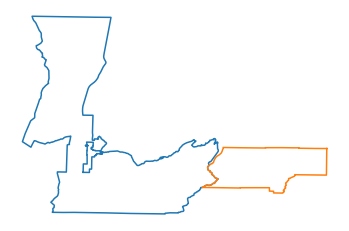

664. Nodes 277 and 172 are connected


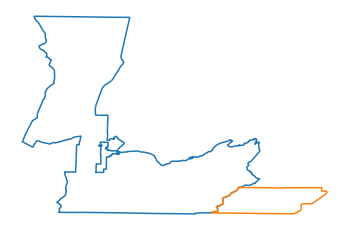

665. Nodes 277 and 234 are connected


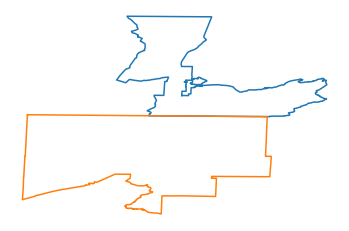

666. Nodes 277 and 269 are connected


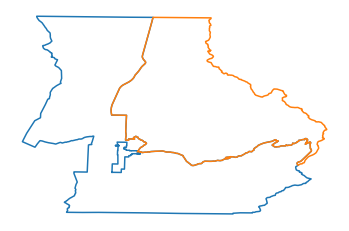

667. Nodes 277 and 273 are connected


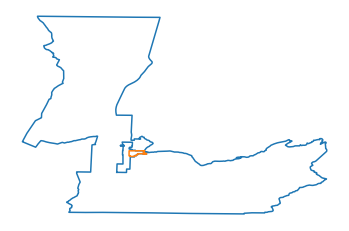

668. Nodes 277 and 274 are connected


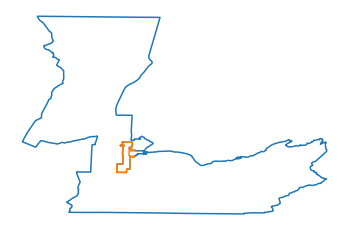

669. Nodes 277 and 276 are connected


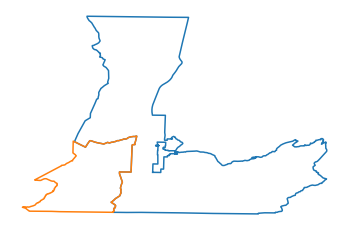

670. Nodes 278 and 270 are connected


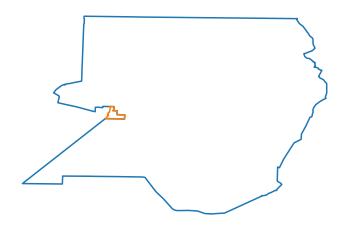

671. Nodes 278 and 271 are connected


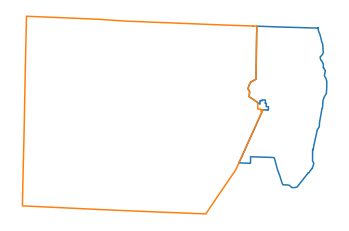

672. Nodes 278 and 272 are connected


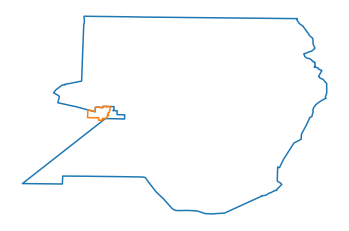

673. Nodes 278 and 275 are connected


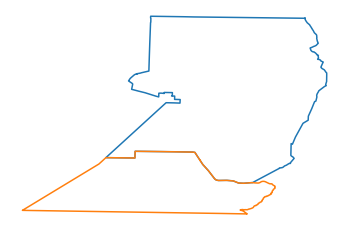

674. Nodes 278 and 276 are connected


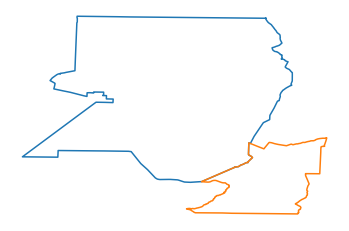

675. Nodes 278 and 277 are connected


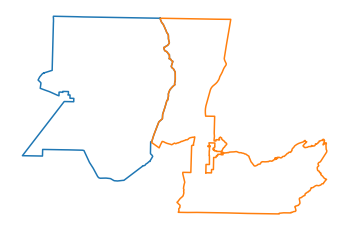

676. Nodes 279 and 101 are connected


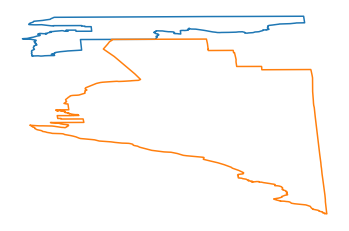

677. Nodes 279 and 103 are connected


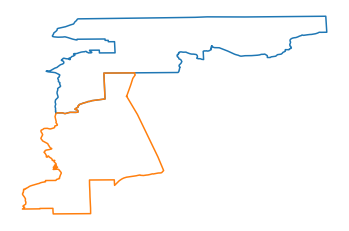

678. Nodes 280 and 103 are connected


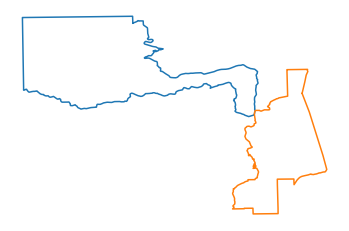

679. Nodes 280 and 113 are connected


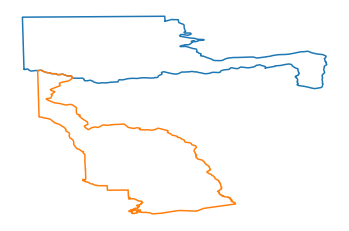

680. Nodes 280 and 123 are connected


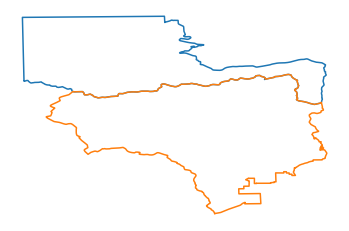

681. Nodes 280 and 279 are connected


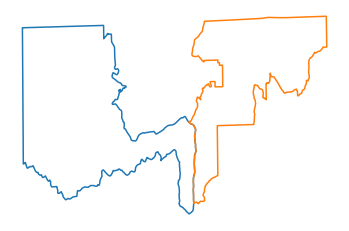

682. Nodes 281 and 101 are connected


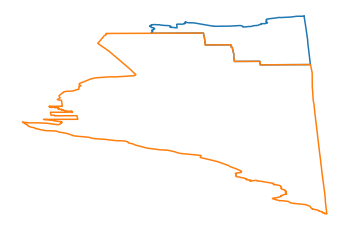

683. Nodes 281 and 279 are connected


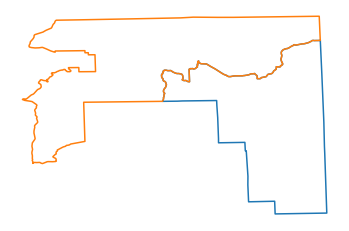

684. Nodes 283 and 279 are connected


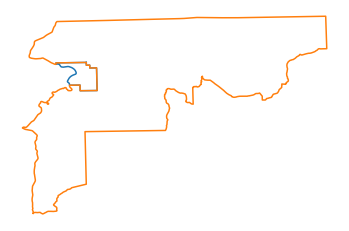

685. Nodes 283 and 282 are connected


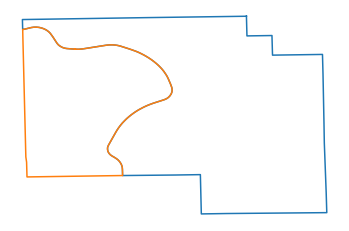

686. Nodes 285 and 280 are connected


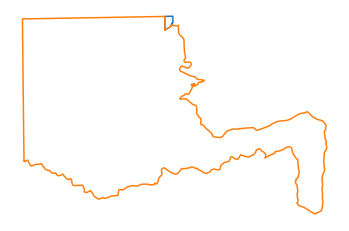

687. Nodes 286 and 284 are connected


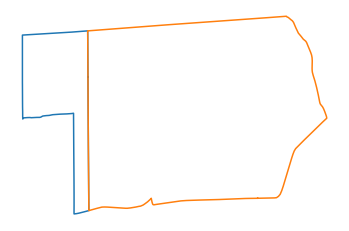

688. Nodes 287 and 286 are connected


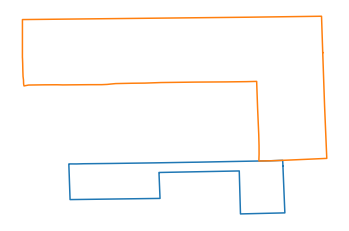

689. Nodes 288 and 280 are connected


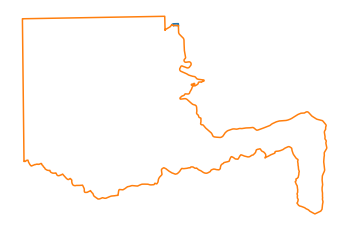

690. Nodes 288 and 287 are connected


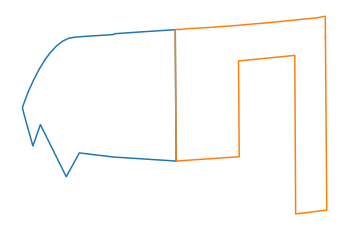

691. Nodes 289 and 280 are connected


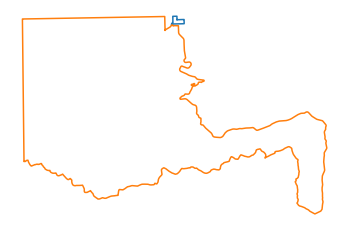

692. Nodes 289 and 285 are connected


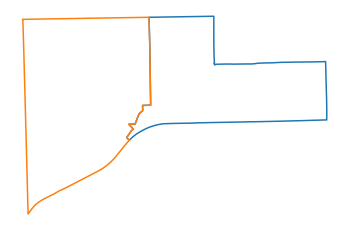

693. Nodes 289 and 286 are connected


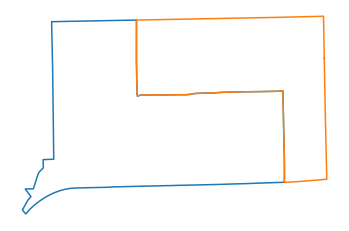

694. Nodes 289 and 287 are connected


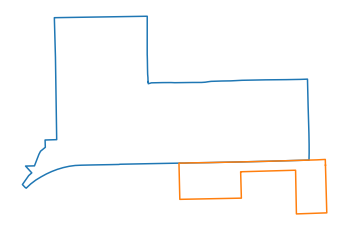

695. Nodes 289 and 288 are connected


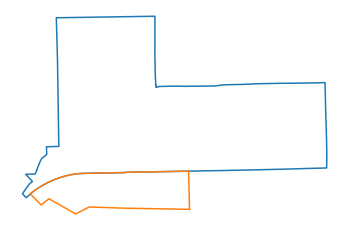

696. Nodes 290 and 280 are connected


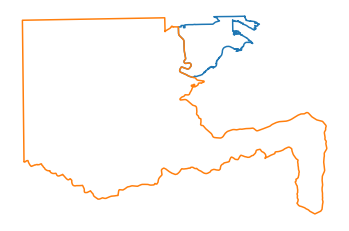

697. Nodes 290 and 284 are connected


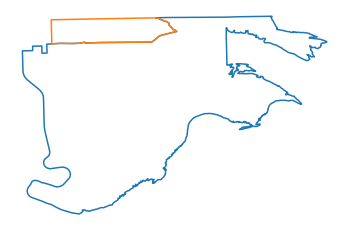

698. Nodes 290 and 286 are connected


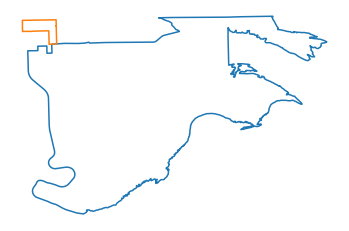

699. Nodes 290 and 287 are connected


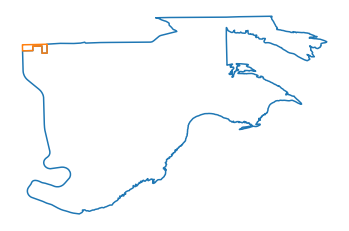

700. Nodes 291 and 279 are connected


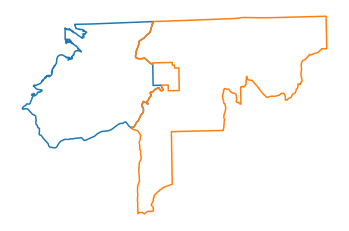

701. Nodes 291 and 280 are connected


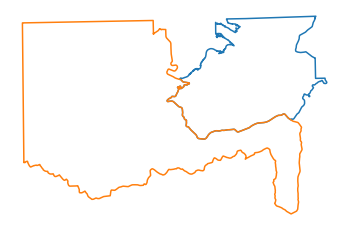

702. Nodes 291 and 282 are connected


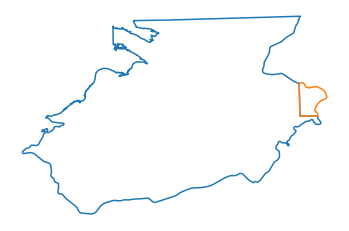

703. Nodes 291 and 290 are connected


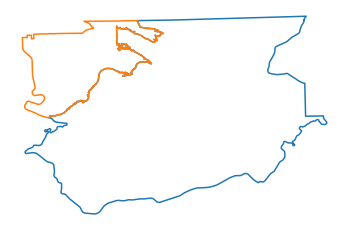

704. Nodes 293 and 84 are connected


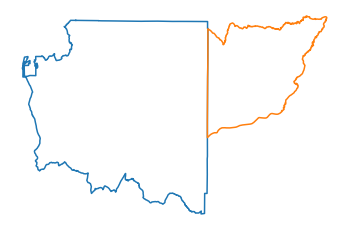

705. Nodes 293 and 86 are connected


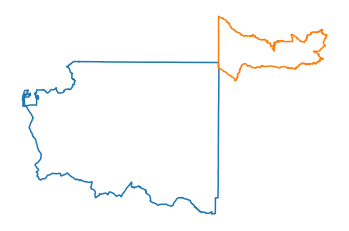

706. Nodes 293 and 96 are connected


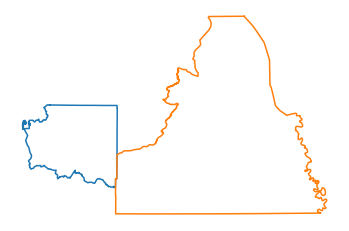

707. Nodes 294 and 293 are connected


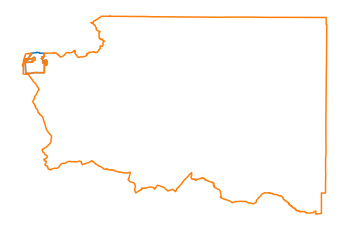

708. Nodes 295 and 293 are connected


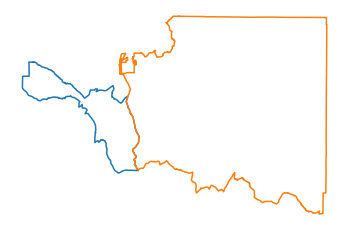

709. Nodes 296 and 295 are connected


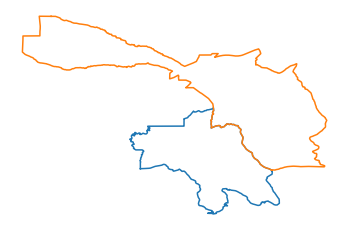

710. Nodes 297 and 296 are connected


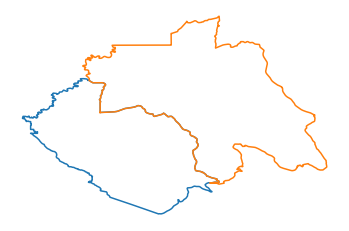

711. Nodes 298 and 297 are connected


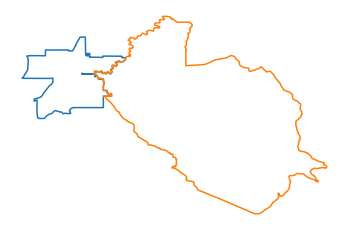

712. Nodes 301 and 300 are connected


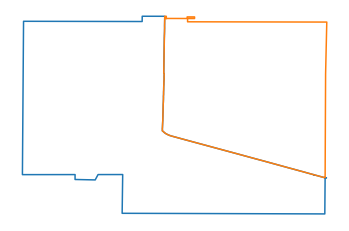

713. Nodes 302 and 167 are connected


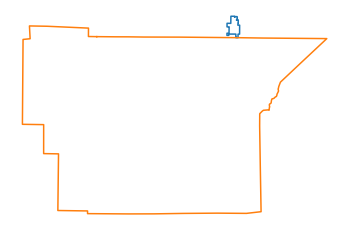

714. Nodes 303 and 298 are connected


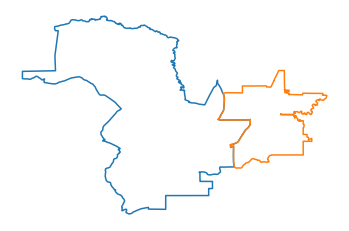

715. Nodes 304 and 299 are connected


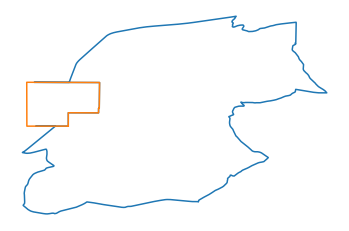

716. Nodes 304 and 303 are connected


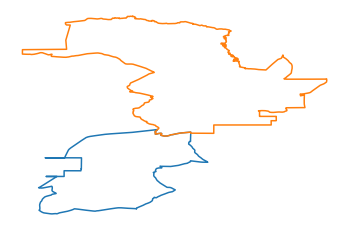

717. Nodes 305 and 292 are connected


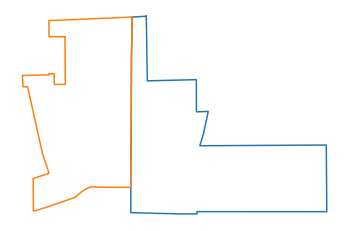

718. Nodes 305 and 293 are connected


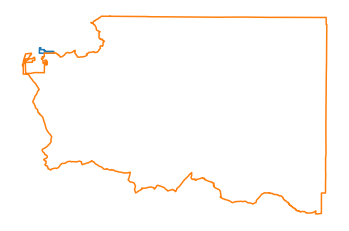

719. Nodes 305 and 294 are connected


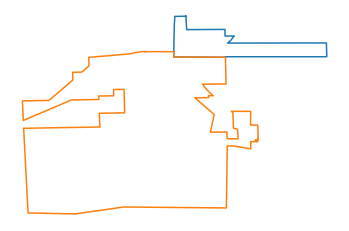

720. Nodes 306 and 293 are connected


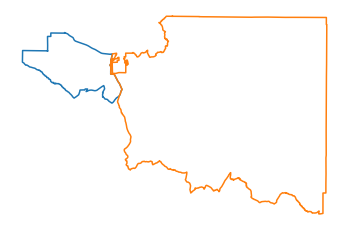

721. Nodes 306 and 295 are connected


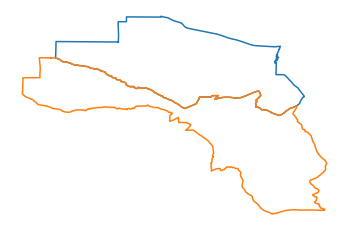

722. Nodes 307 and 170 are connected


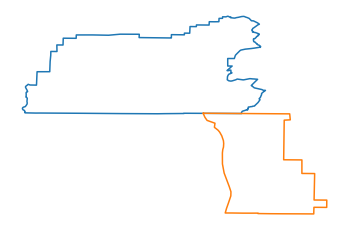

723. Nodes 307 and 171 are connected


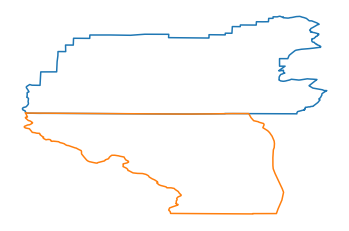

724. Nodes 307 and 269 are connected


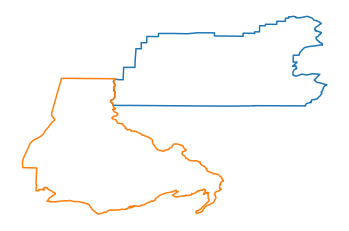

725. Nodes 307 and 299 are connected


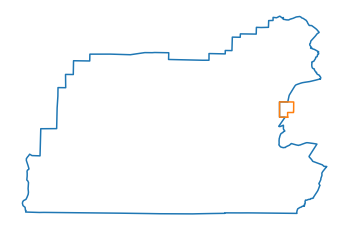

726. Nodes 307 and 303 are connected


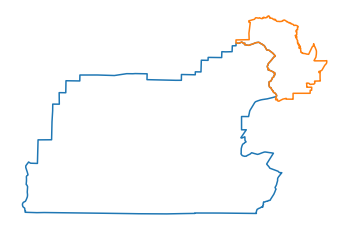

727. Nodes 307 and 304 are connected


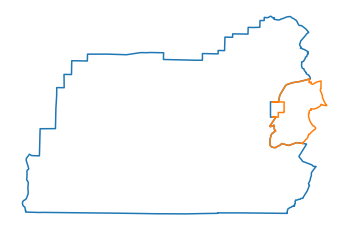

728. Nodes 308 and 96 are connected


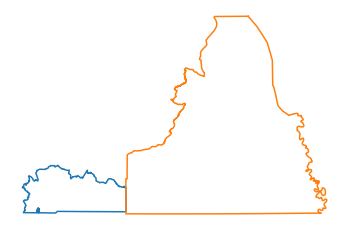

729. Nodes 308 and 164 are connected


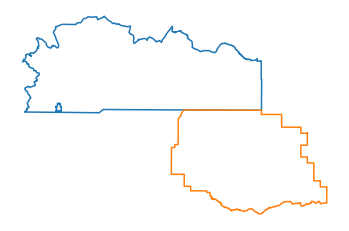

730. Nodes 308 and 165 are connected


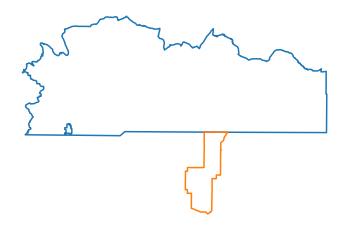

731. Nodes 308 and 166 are connected


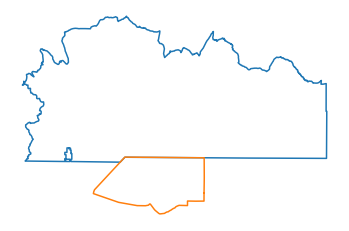

732. Nodes 308 and 167 are connected


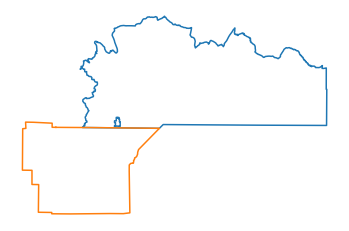

733. Nodes 308 and 293 are connected


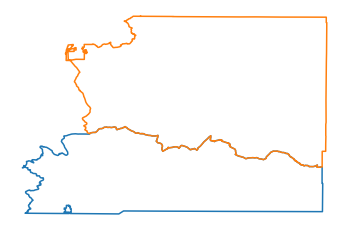

734. Nodes 308 and 295 are connected


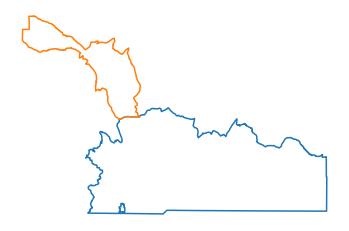

735. Nodes 308 and 296 are connected


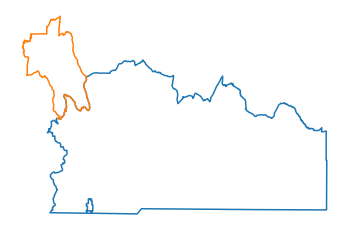

736. Nodes 308 and 297 are connected


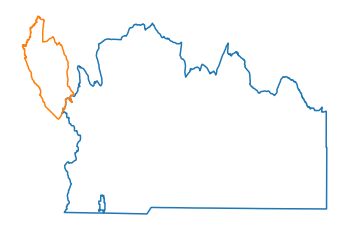

737. Nodes 308 and 302 are connected


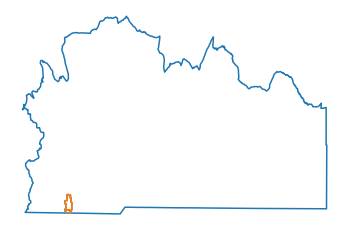

738. Nodes 309 and 167 are connected


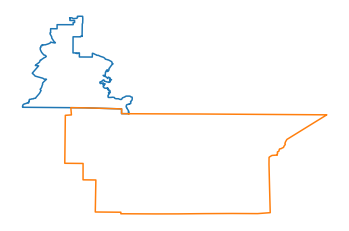

739. Nodes 309 and 170 are connected


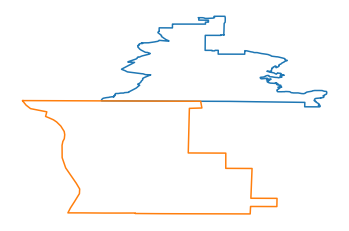

740. Nodes 309 and 301 are connected


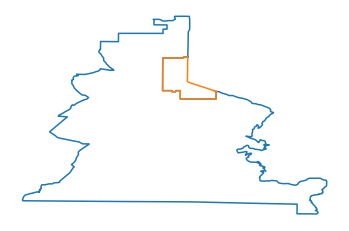

741. Nodes 309 and 303 are connected


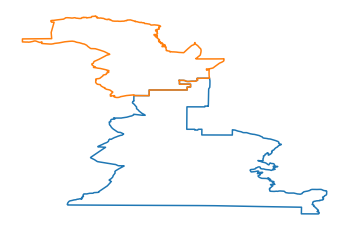

742. Nodes 309 and 304 are connected


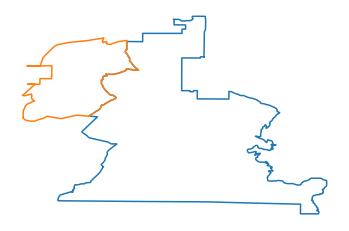

743. Nodes 309 and 307 are connected


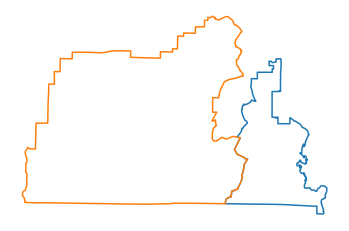

744. Nodes 310 and 167 are connected


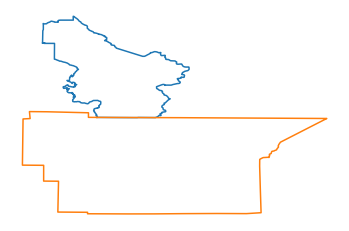

745. Nodes 310 and 297 are connected


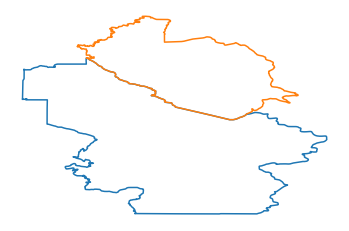

746. Nodes 310 and 298 are connected


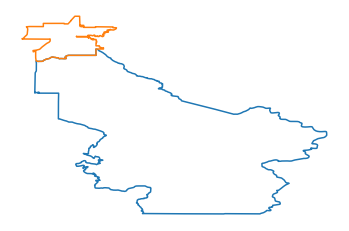

747. Nodes 310 and 300 are connected


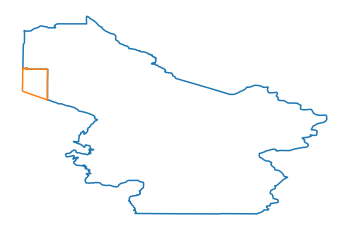

748. Nodes 310 and 301 are connected


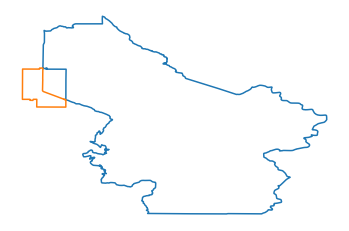

749. Nodes 310 and 308 are connected


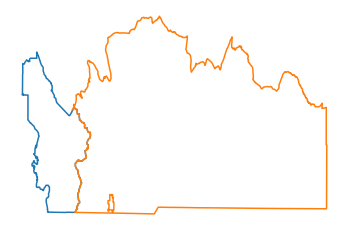

750. Nodes 310 and 309 are connected


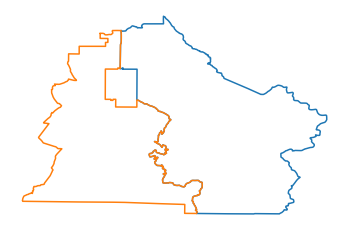

751. Nodes 311 and 306 are connected


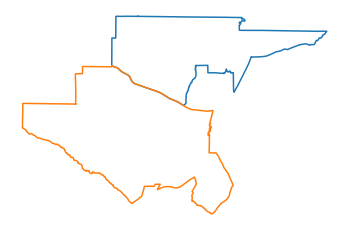

752. Nodes 312 and 296 are connected


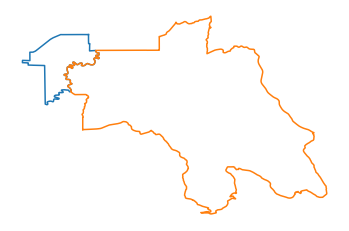

753. Nodes 312 and 297 are connected


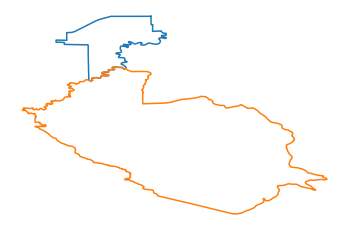

754. Nodes 314 and 313 are connected


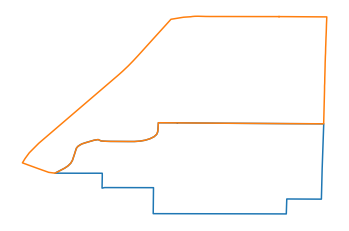

755. Nodes 315 and 297 are connected


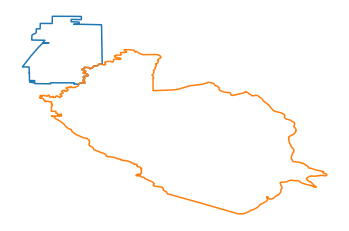

756. Nodes 315 and 298 are connected


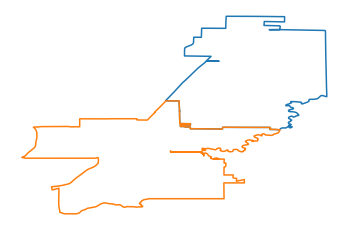

757. Nodes 315 and 312 are connected


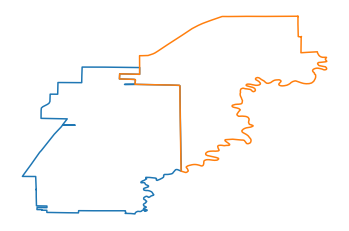

758. Nodes 315 and 314 are connected


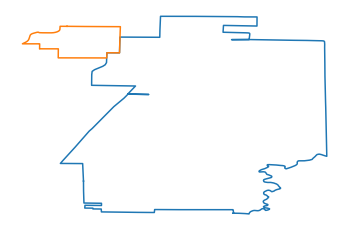

759. Nodes 316 and 313 are connected


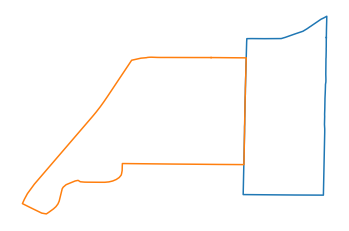

760. Nodes 316 and 314 are connected


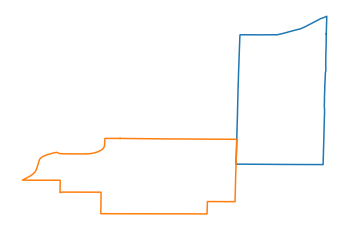

761. Nodes 316 and 315 are connected


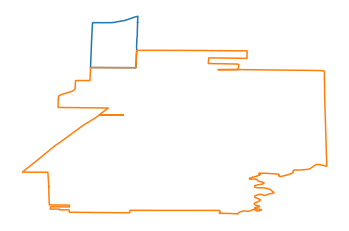

762. Nodes 318 and 312 are connected


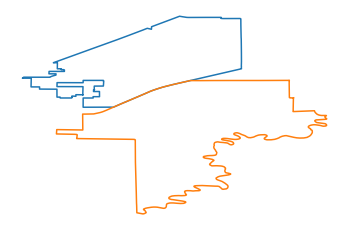

763. Nodes 318 and 317 are connected


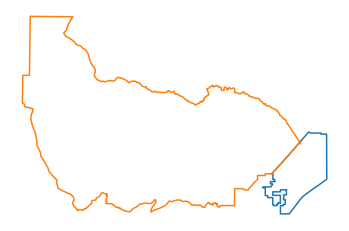

764. Nodes 319 and 298 are connected


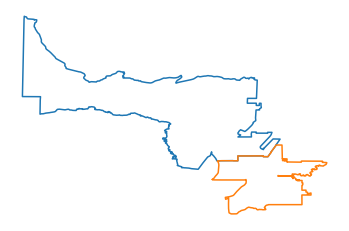

765. Nodes 319 and 303 are connected


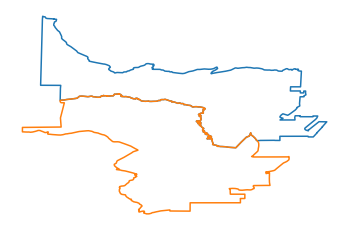

766. Nodes 319 and 315 are connected


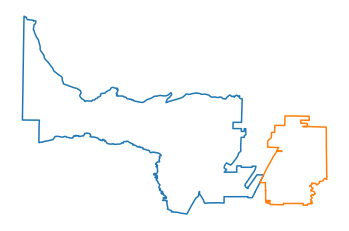

767. Nodes 319 and 317 are connected


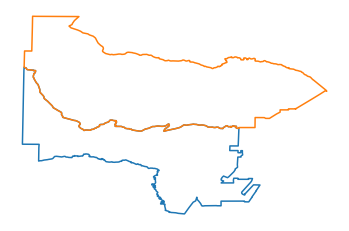

768. Nodes 320 and 292 are connected


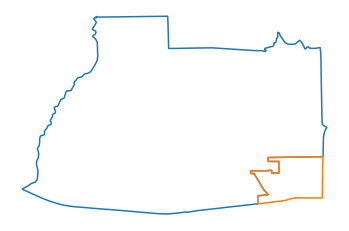

769. Nodes 320 and 293 are connected


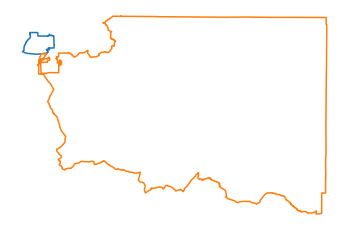

770. Nodes 320 and 294 are connected


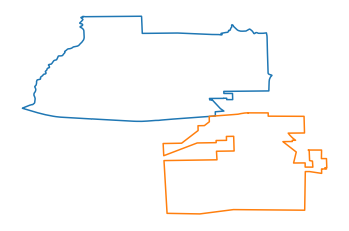

771. Nodes 320 and 306 are connected


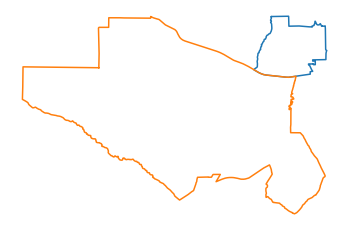

772. Nodes 320 and 311 are connected


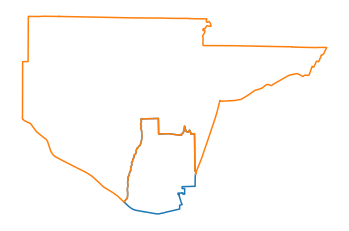

773. Nodes 321 and 293 are connected


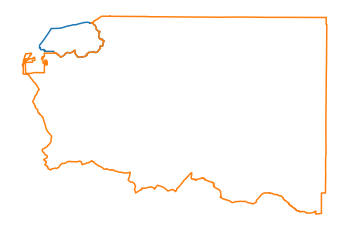

774. Nodes 321 and 305 are connected


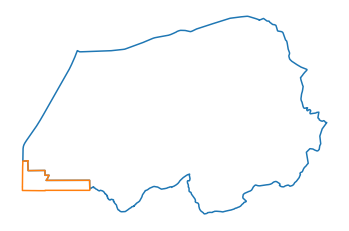

775. Nodes 321 and 311 are connected


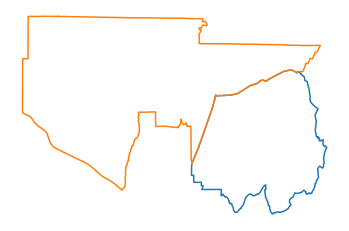

776. Nodes 321 and 320 are connected


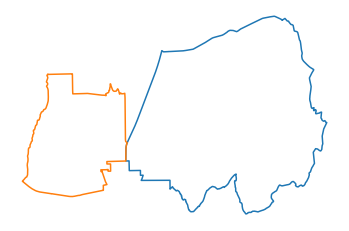

777. Nodes 322 and 295 are connected


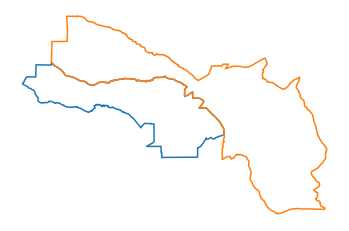

778. Nodes 322 and 296 are connected


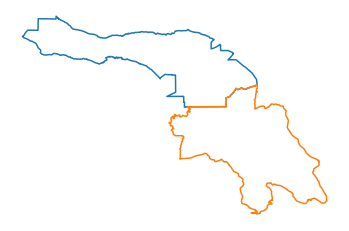

779. Nodes 322 and 312 are connected


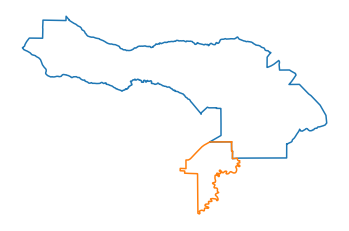

780. Nodes 322 and 317 are connected


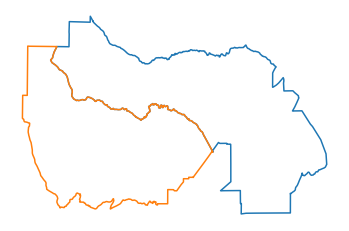

781. Nodes 322 and 318 are connected


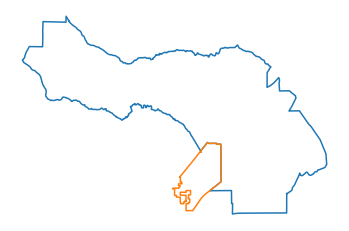

782. Nodes 323 and 313 are connected


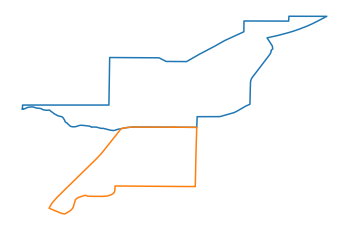

783. Nodes 323 and 316 are connected


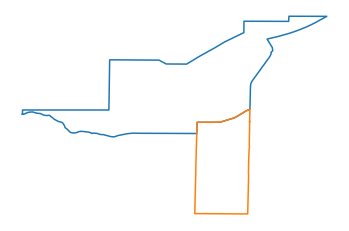

784. Nodes 323 and 317 are connected


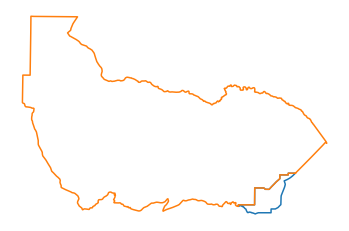

785. Nodes 324 and 315 are connected


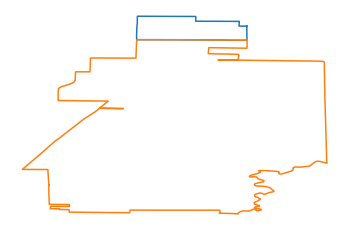

786. Nodes 324 and 316 are connected


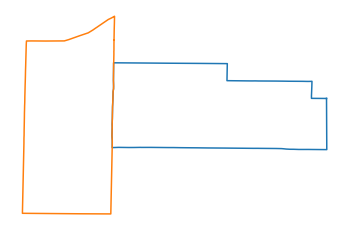

787. Nodes 325 and 313 are connected


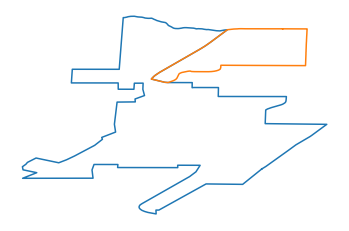

788. Nodes 325 and 314 are connected


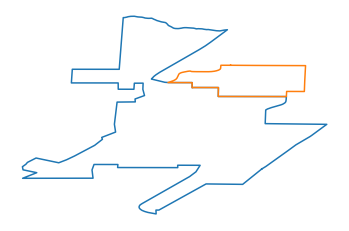

789. Nodes 325 and 315 are connected


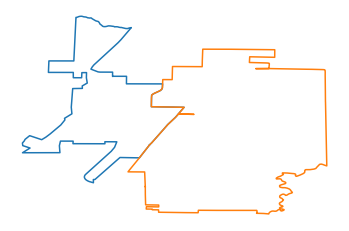

790. Nodes 325 and 319 are connected


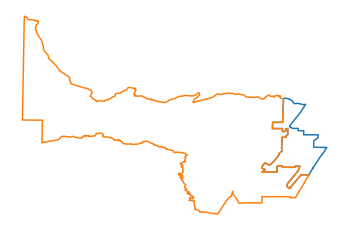

791. Nodes 325 and 323 are connected


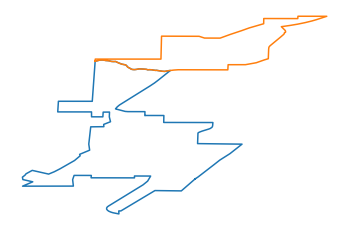

792. Nodes 326 and 312 are connected


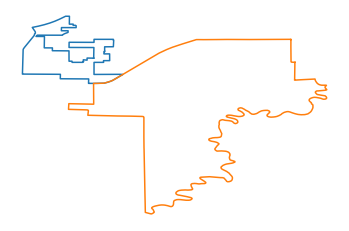

793. Nodes 326 and 316 are connected


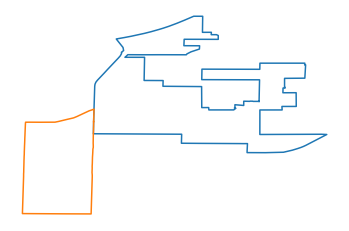

794. Nodes 326 and 318 are connected


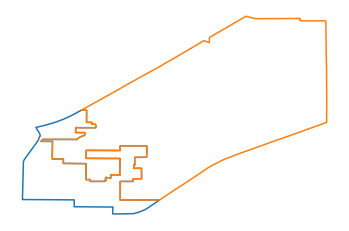

795. Nodes 326 and 323 are connected


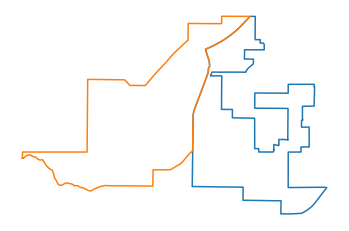

796. Nodes 326 and 324 are connected


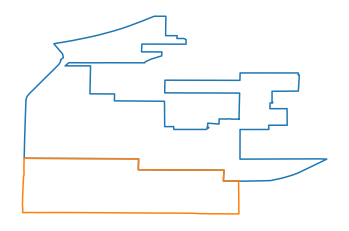

797. Nodes 327 and 147 are connected


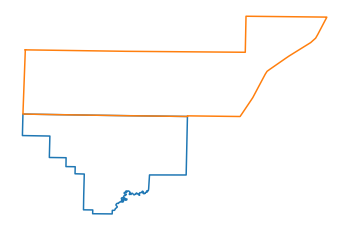

798. Nodes 328 and 143 are connected


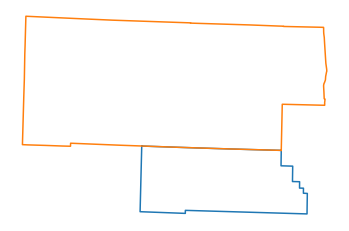

799. Nodes 328 and 327 are connected


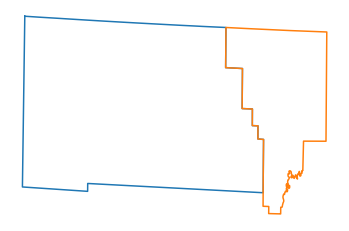

800. Nodes 330 and 329 are connected


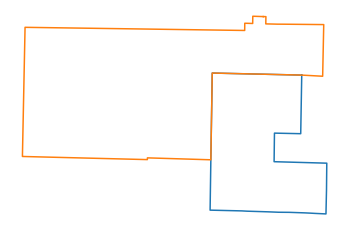

801. Nodes 331 and 143 are connected


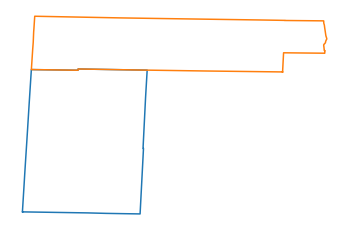

802. Nodes 331 and 271 are connected


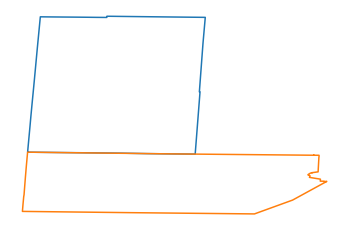

803. Nodes 331 and 328 are connected


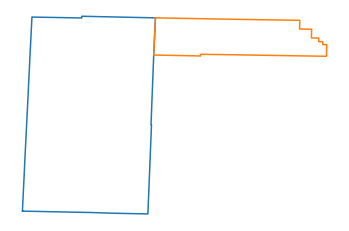

804. Nodes 331 and 329 are connected


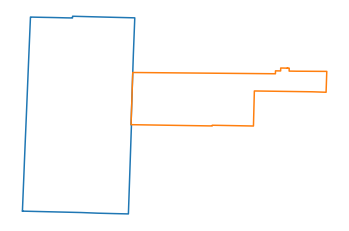

805. Nodes 333 and 145 are connected


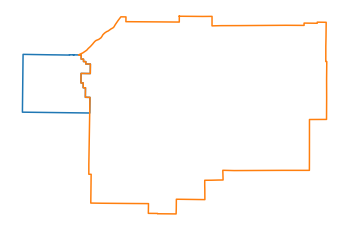

806. Nodes 333 and 159 are connected


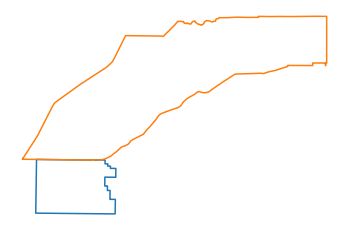

807. Nodes 334 and 147 are connected


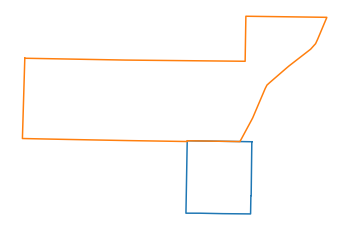

808. Nodes 334 and 327 are connected


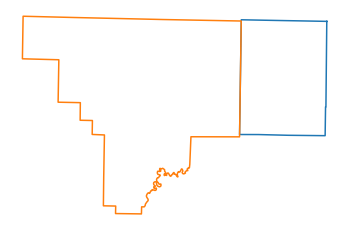

809. Nodes 334 and 333 are connected


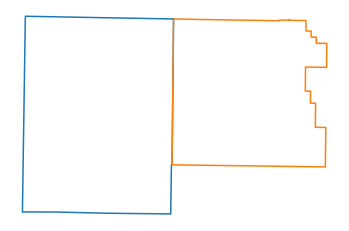

810. Nodes 335 and 145 are connected


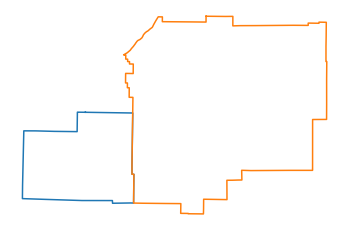

811. Nodes 335 and 327 are connected


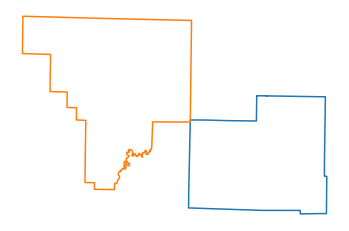

812. Nodes 335 and 333 are connected


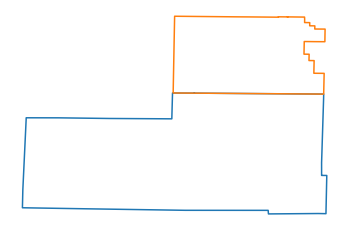

813. Nodes 335 and 334 are connected


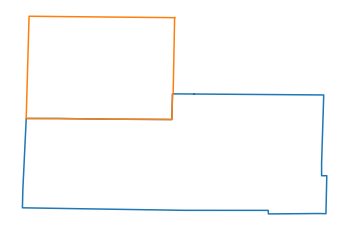

814. Nodes 336 and 327 are connected


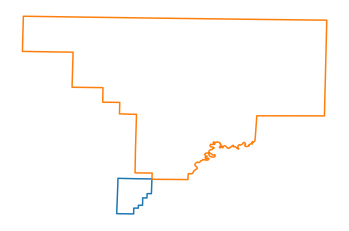

815. Nodes 337 and 295 are connected


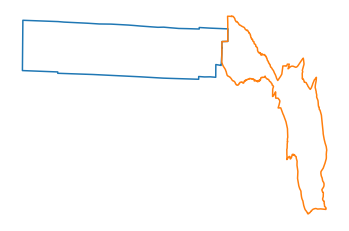

816. Nodes 337 and 317 are connected


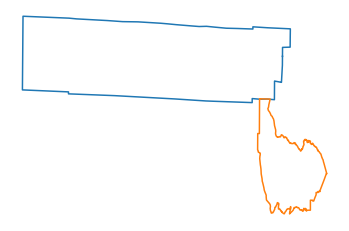

817. Nodes 337 and 322 are connected


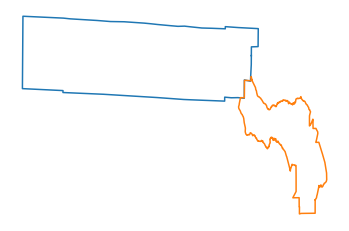

818. Nodes 337 and 330 are connected


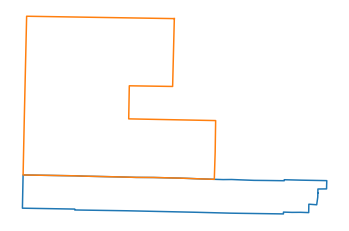

819. Nodes 338 and 269 are connected


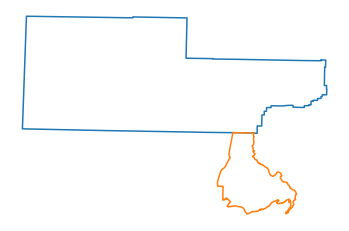

820. Nodes 338 and 271 are connected


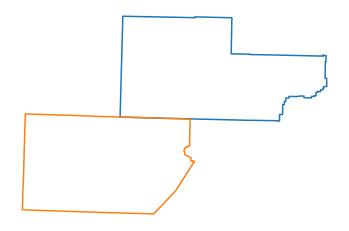

821. Nodes 338 and 277 are connected


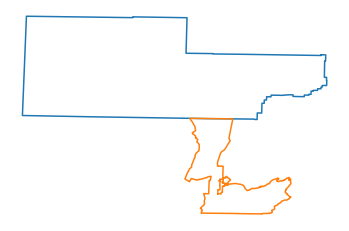

822. Nodes 338 and 278 are connected


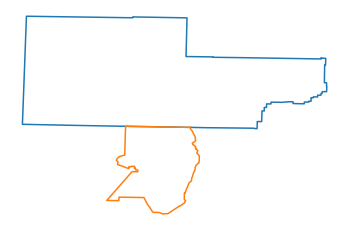

823. Nodes 338 and 303 are connected


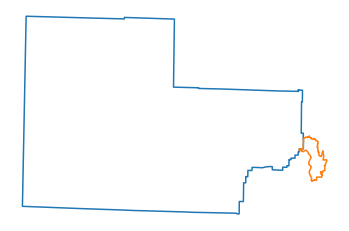

824. Nodes 338 and 307 are connected


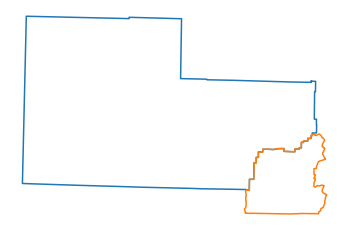

825. Nodes 338 and 317 are connected


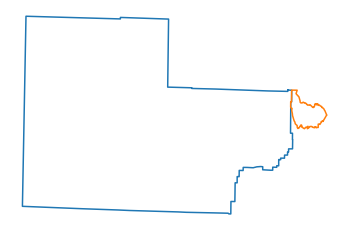

826. Nodes 338 and 319 are connected


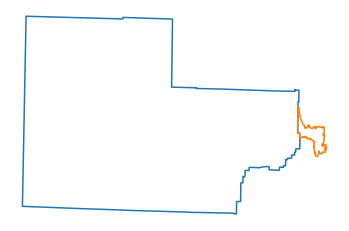

827. Nodes 338 and 329 are connected


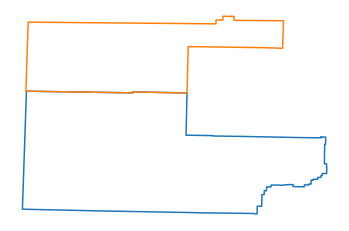

828. Nodes 338 and 330 are connected


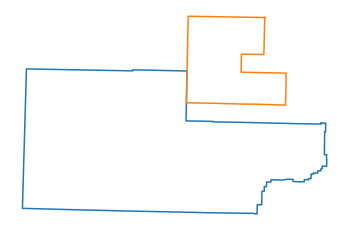

829. Nodes 338 and 331 are connected


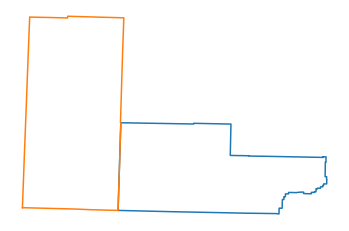

830. Nodes 338 and 337 are connected


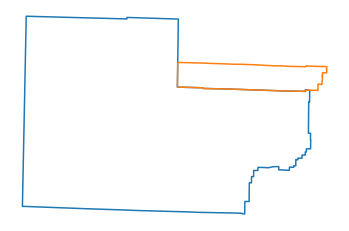

831. Nodes 339 and 145 are connected


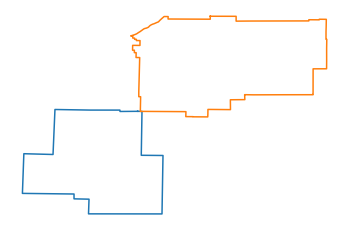

832. Nodes 339 and 329 are connected


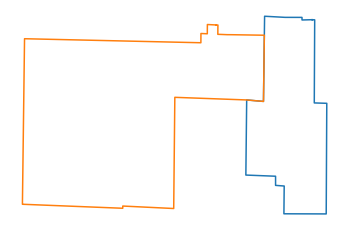

833. Nodes 339 and 330 are connected


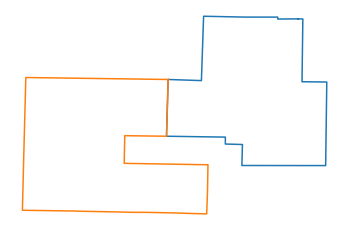

834. Nodes 339 and 335 are connected


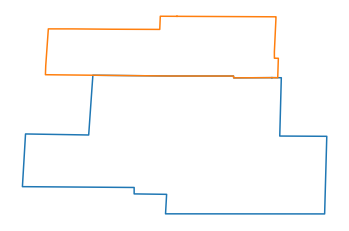

835. Nodes 340 and 330 are connected


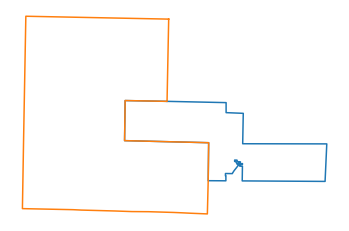

836. Nodes 340 and 339 are connected


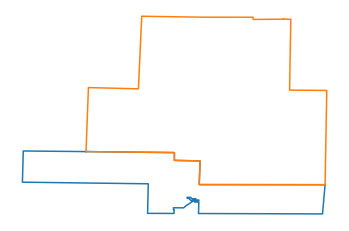

837. Nodes 341 and 295 are connected


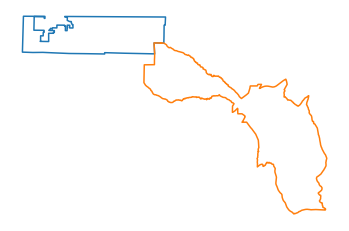

838. Nodes 341 and 306 are connected


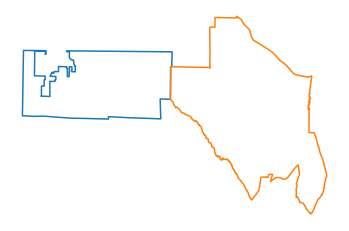

839. Nodes 341 and 330 are connected


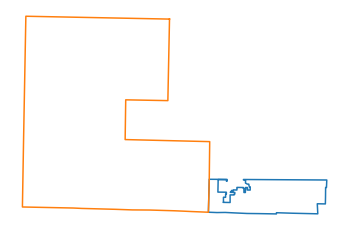

840. Nodes 341 and 337 are connected


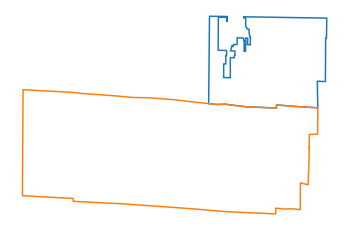

841. Nodes 341 and 340 are connected


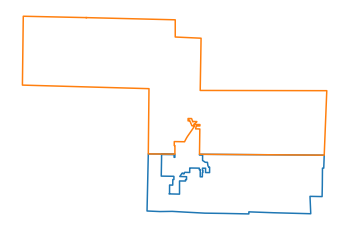

842. Nodes 342 and 340 are connected


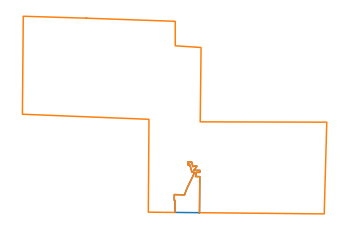

843. Nodes 343 and 341 are connected


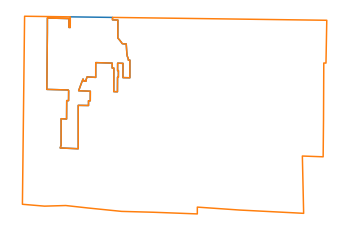

844. Nodes 343 and 342 are connected


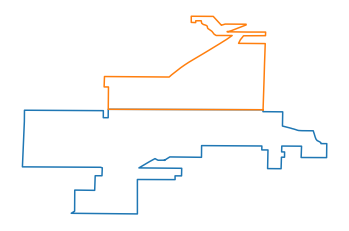

845. Nodes 344 and 145 are connected


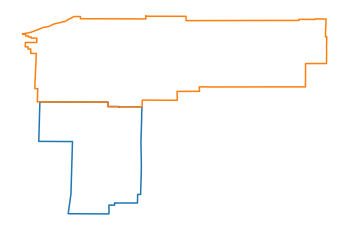

846. Nodes 344 and 306 are connected


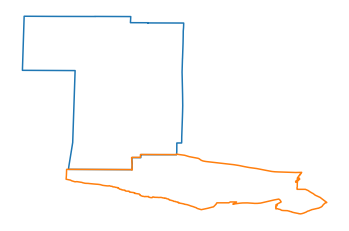

847. Nodes 344 and 311 are connected


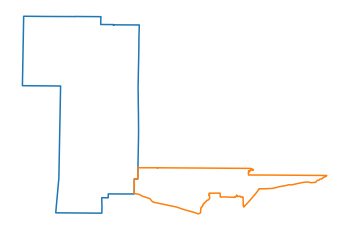

848. Nodes 344 and 339 are connected


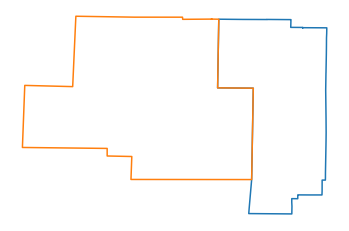

849. Nodes 344 and 340 are connected


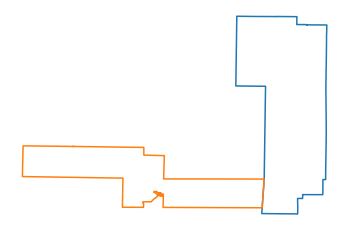

850. Nodes 344 and 341 are connected


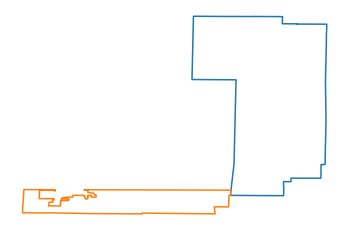

851. Nodes 345 and 327 are connected


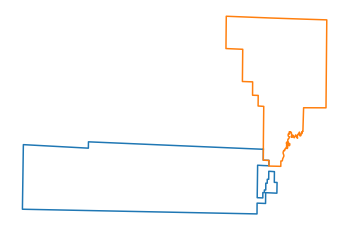

852. Nodes 345 and 328 are connected


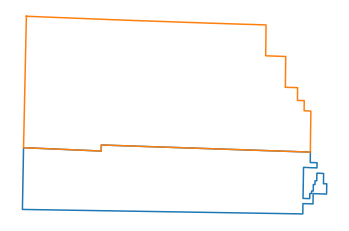

853. Nodes 345 and 329 are connected


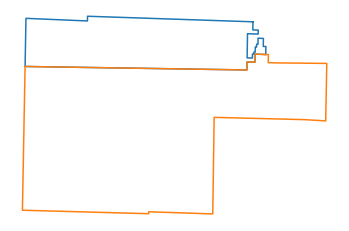

854. Nodes 345 and 331 are connected


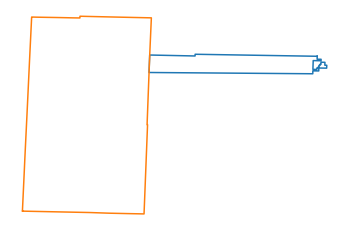

855. Nodes 345 and 336 are connected


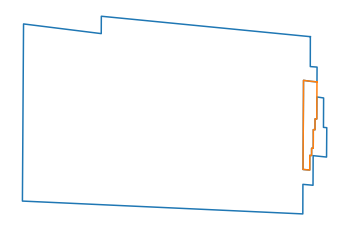

856. Nodes 346 and 327 are connected


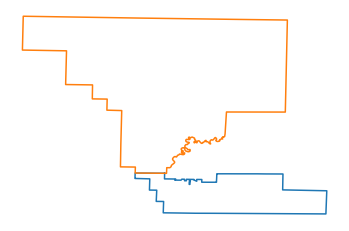

857. Nodes 346 and 329 are connected


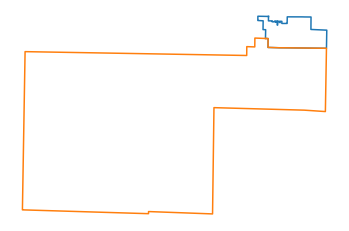

858. Nodes 346 and 335 are connected


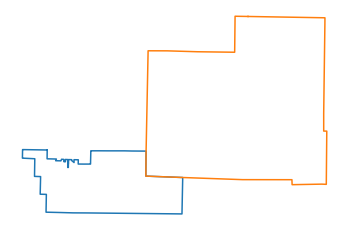

859. Nodes 346 and 336 are connected


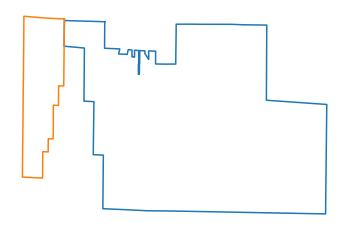

860. Nodes 346 and 339 are connected


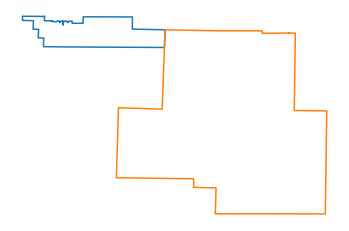

861. Nodes 346 and 345 are connected


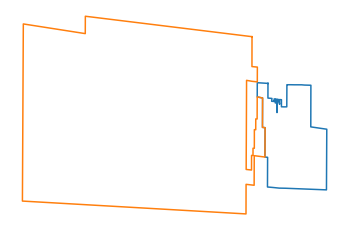

862. Nodes 347 and 327 are connected


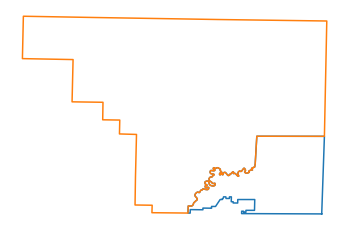

863. Nodes 347 and 332 are connected


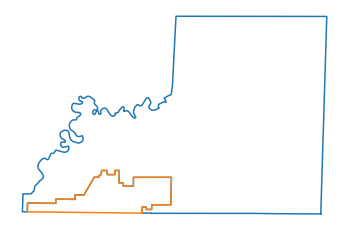

864. Nodes 347 and 335 are connected


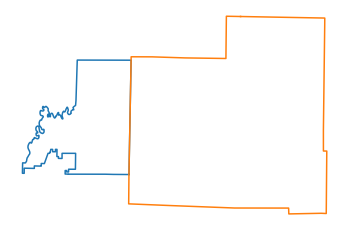

865. Nodes 347 and 346 are connected


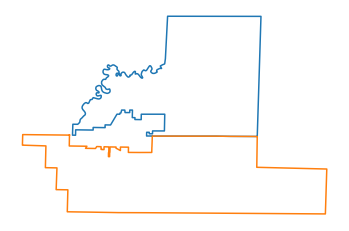

866. Nodes 348 and 327 are connected


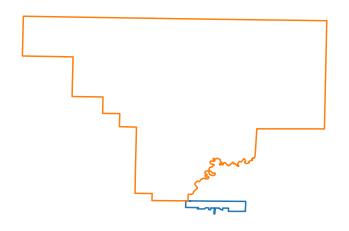

867. Nodes 348 and 332 are connected


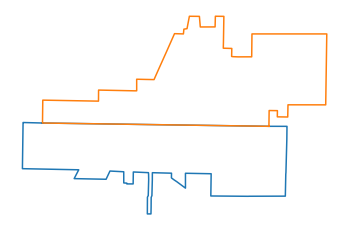

868. Nodes 348 and 346 are connected


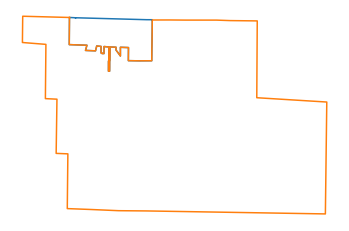

869. Nodes 348 and 347 are connected


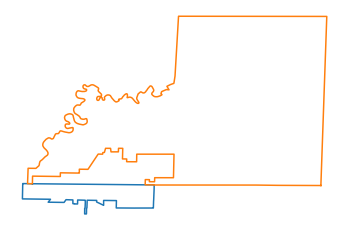

870. Nodes 349 and 86 are connected


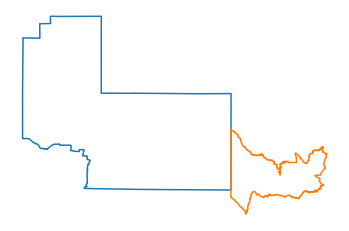

871. Nodes 349 and 88 are connected


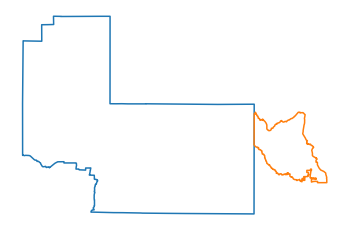

872. Nodes 349 and 95 are connected


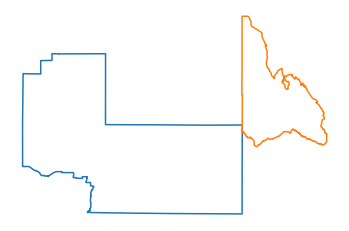

873. Nodes 349 and 145 are connected


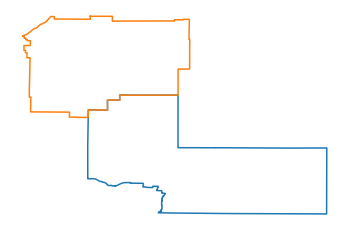

874. Nodes 349 and 293 are connected


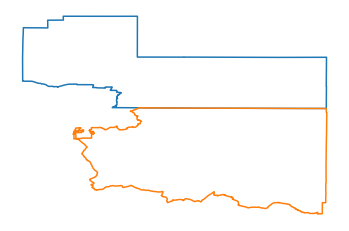

875. Nodes 349 and 311 are connected


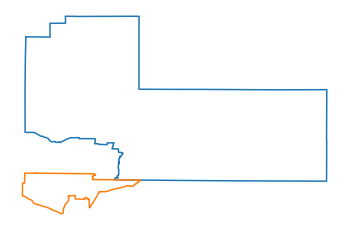

876. Nodes 349 and 344 are connected


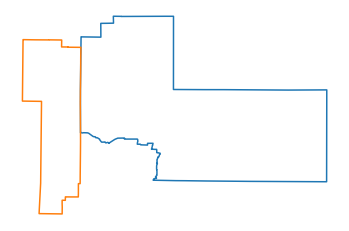

877. Nodes 350 and 95 are connected


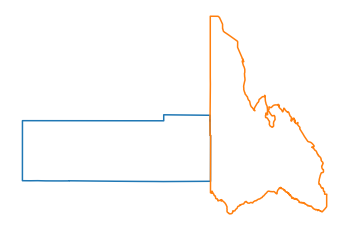

878. Nodes 350 and 349 are connected


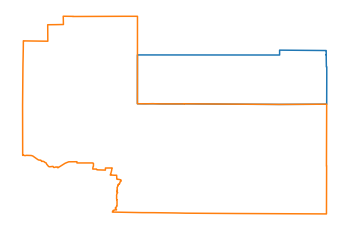

879. Nodes 351 and 95 are connected


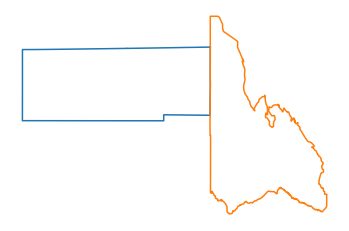

880. Nodes 351 and 145 are connected


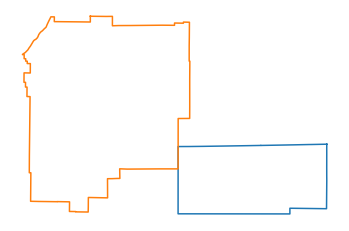

881. Nodes 351 and 349 are connected


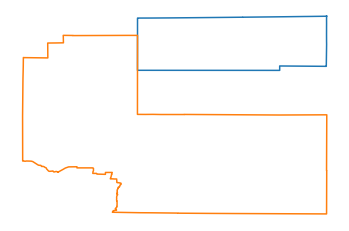

882. Nodes 351 and 350 are connected


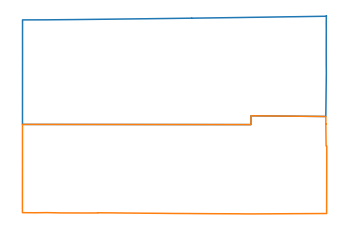

883. Nodes 353 and 94 are connected


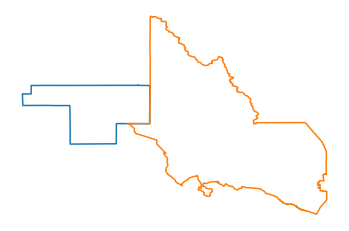

884. Nodes 353 and 95 are connected


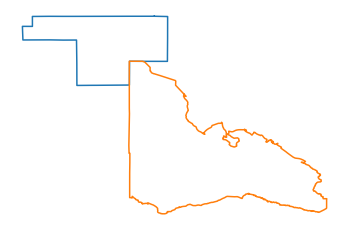

885. Nodes 353 and 351 are connected


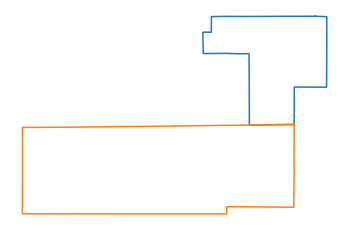

886. Nodes 353 and 352 are connected


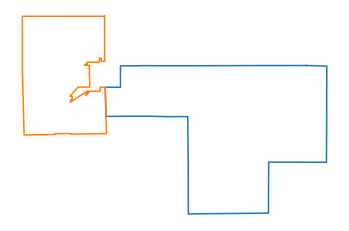

887. Nodes 354 and 148 are connected


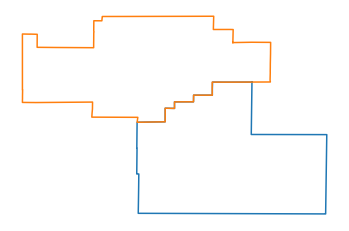

888. Nodes 354 and 149 are connected


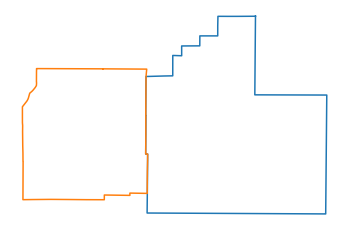

889. Nodes 354 and 352 are connected


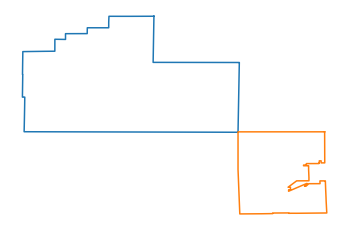

890. Nodes 356 and 352 are connected


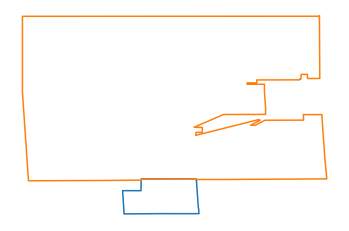

891. Nodes 357 and 145 are connected


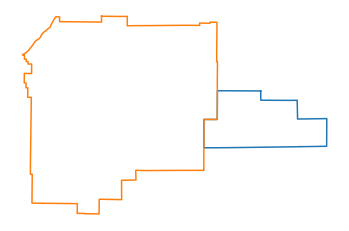

892. Nodes 357 and 351 are connected


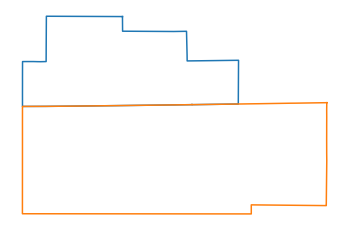

893. Nodes 357 and 352 are connected


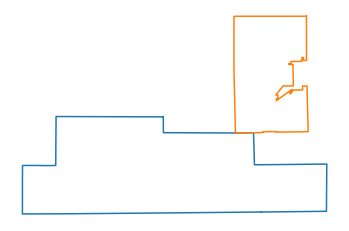

894. Nodes 358 and 311 are connected


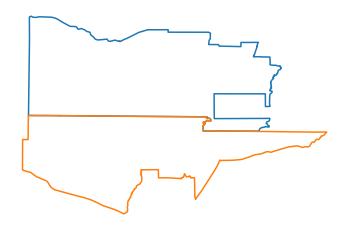

895. Nodes 358 and 344 are connected


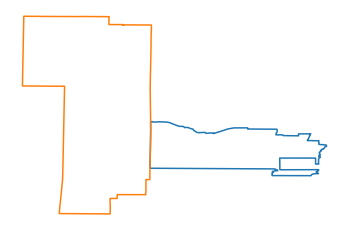

896. Nodes 358 and 349 are connected


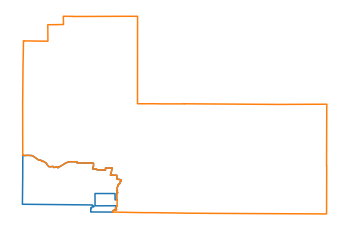

897. Nodes 358 and 355 are connected


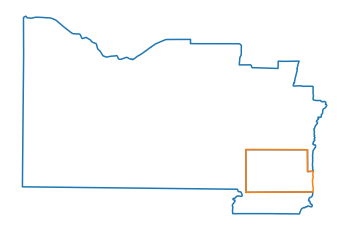

898. Nodes 359 and 352 are connected


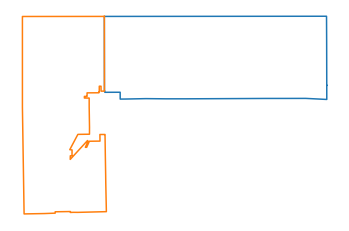

899. Nodes 359 and 353 are connected


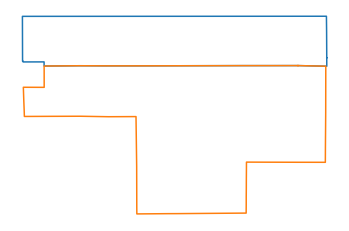

900. Nodes 360 and 145 are connected


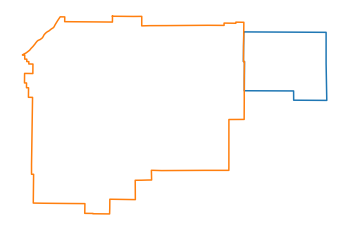

901. Nodes 360 and 352 are connected


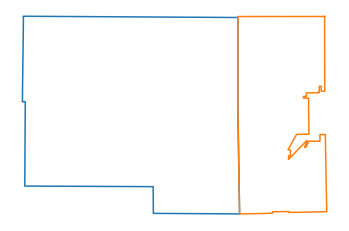

902. Nodes 360 and 354 are connected


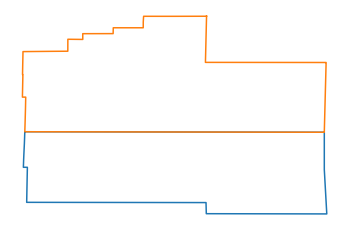

903. Nodes 360 and 357 are connected


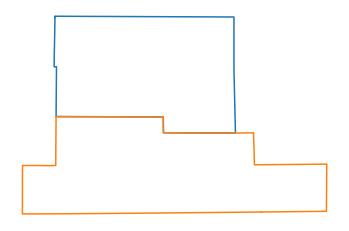

904. Nodes 361 and 94 are connected


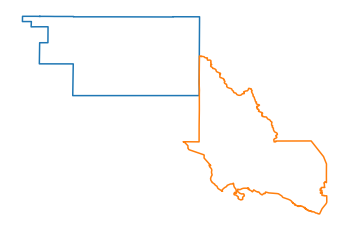

905. Nodes 361 and 148 are connected


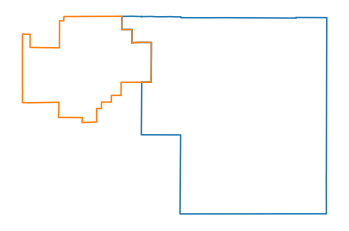

906. Nodes 361 and 352 are connected


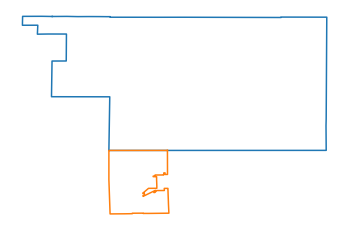

907. Nodes 361 and 354 are connected


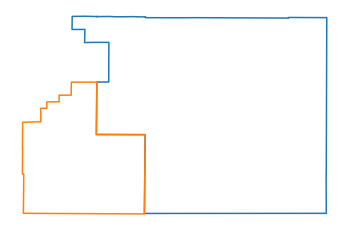

908. Nodes 361 and 359 are connected


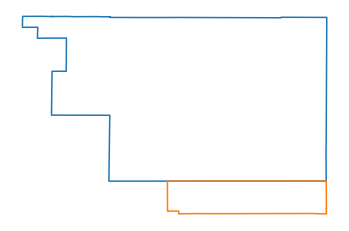

909. Nodes 362 and 352 are connected


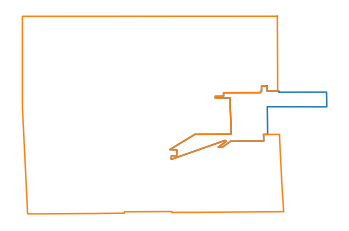

910. Nodes 362 and 353 are connected


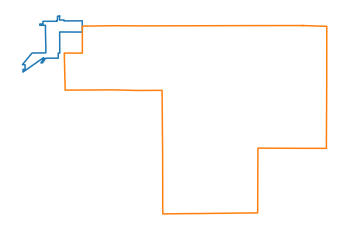

911. Nodes 362 and 359 are connected


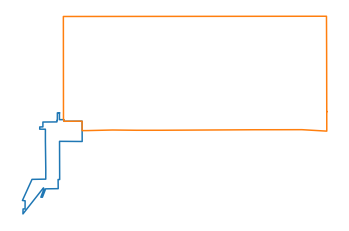

912. Nodes 363 and 352 are connected


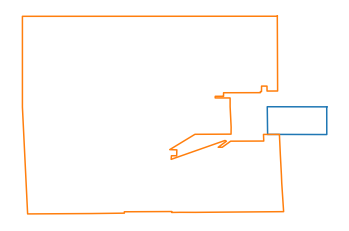

913. Nodes 363 and 353 are connected


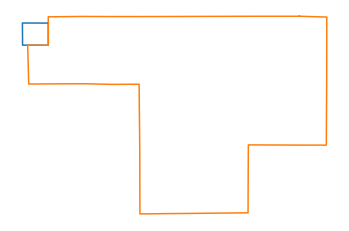

914. Nodes 363 and 362 are connected


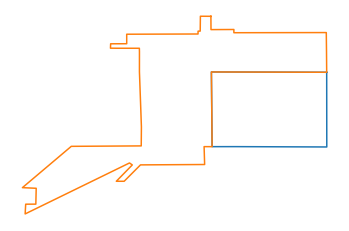

915. Nodes 364 and 351 are connected


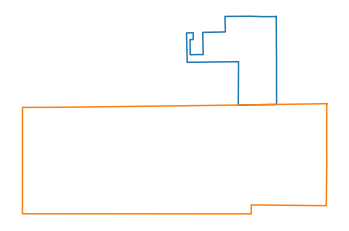

916. Nodes 364 and 352 are connected


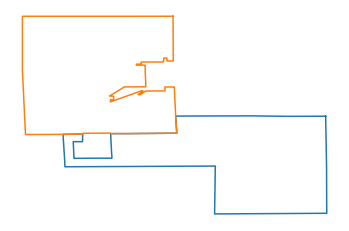

917. Nodes 364 and 353 are connected


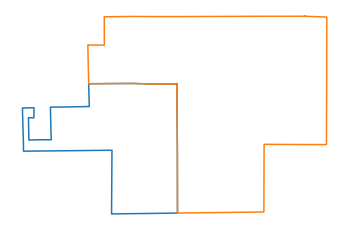

918. Nodes 364 and 356 are connected


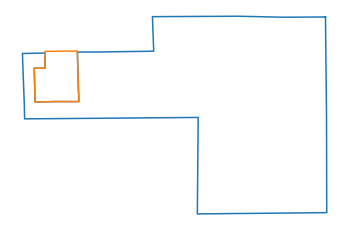

919. Nodes 364 and 357 are connected


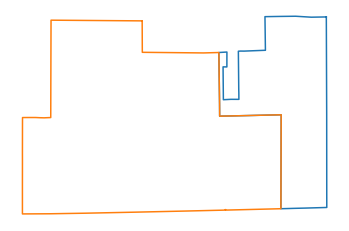

920. Nodes 365 and 349 are connected


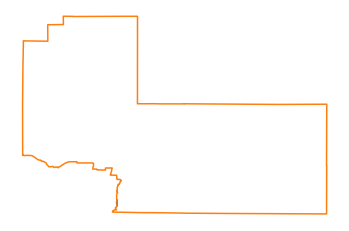

921. Nodes 365 and 355 are connected


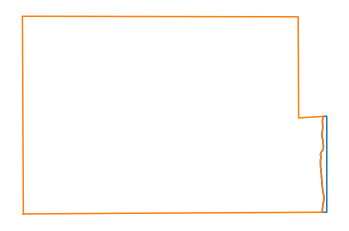

922. Nodes 365 and 358 are connected


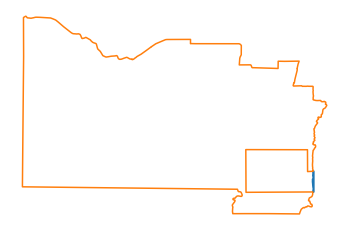

923. Nodes 366 and 133 are connected


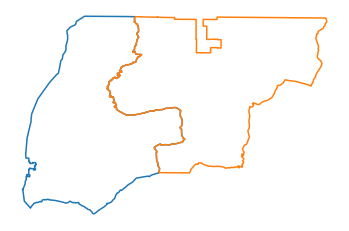

924. Nodes 366 and 135 are connected


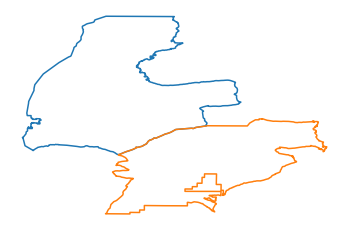

925. Nodes 366 and 138 are connected


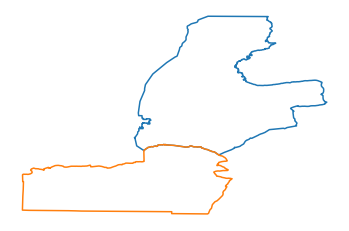

926. Nodes 366 and 168 are connected


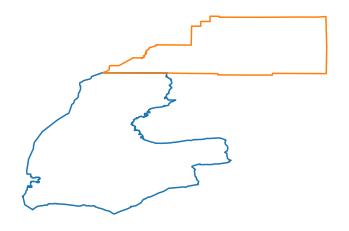

927. Nodes 366 and 172 are connected


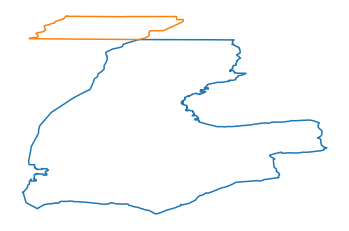

928. Nodes 367 and 138 are connected


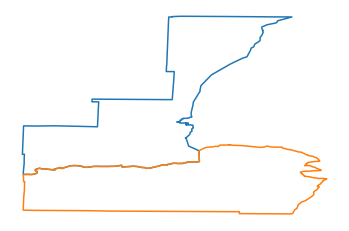

929. Nodes 367 and 172 are connected


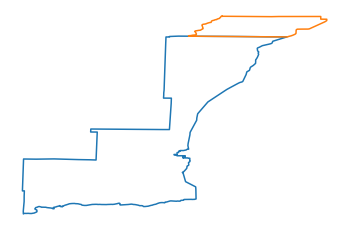

930. Nodes 367 and 234 are connected


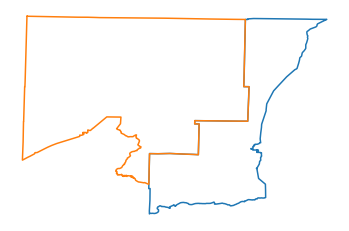

931. Nodes 367 and 266 are connected


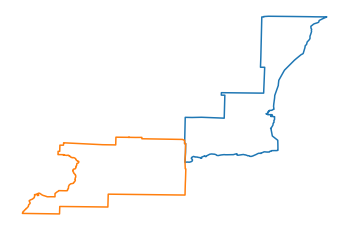

932. Nodes 367 and 277 are connected


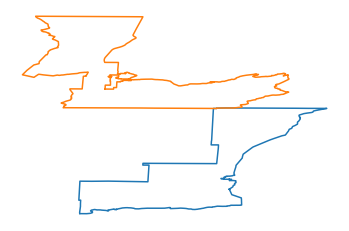

933. Nodes 367 and 366 are connected


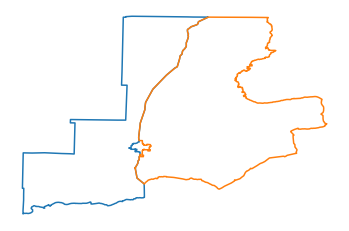

934. Nodes 368 and 366 are connected


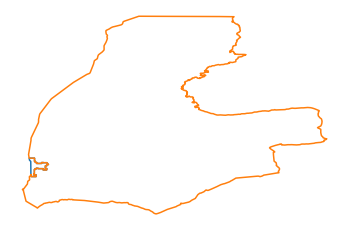

935. Nodes 368 and 367 are connected


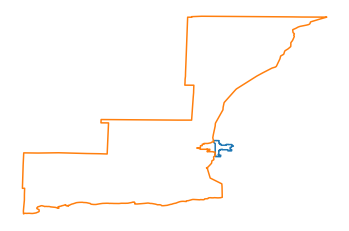

936. Nodes 369 and 367 are connected


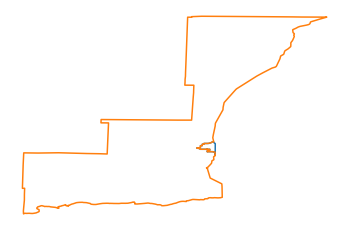

937. Nodes 369 and 368 are connected


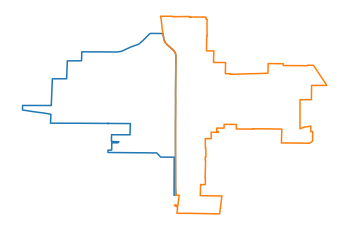

938. Nodes 371 and 370 are connected


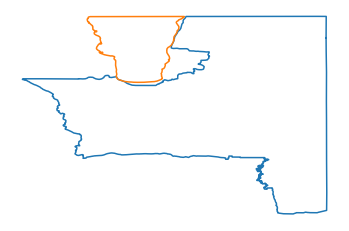

939. Nodes 372 and 371 are connected


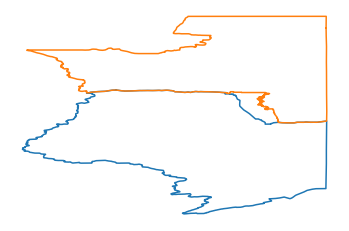

940. Nodes 373 and 370 are connected


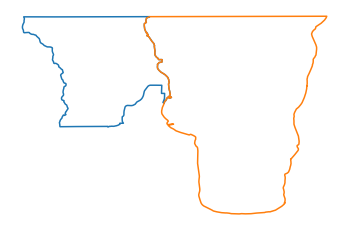

941. Nodes 374 and 371 are connected


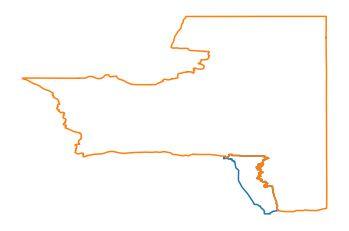

942. Nodes 374 and 372 are connected


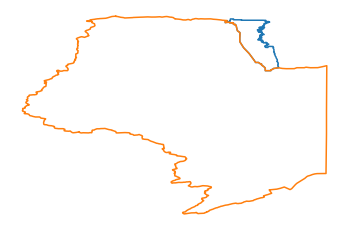

943. Nodes 375 and 370 are connected


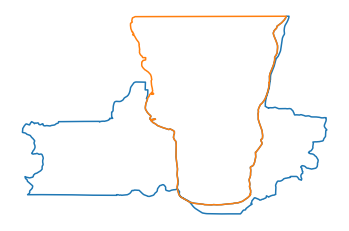

944. Nodes 375 and 371 are connected


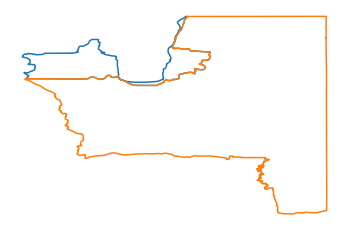

945. Nodes 375 and 373 are connected


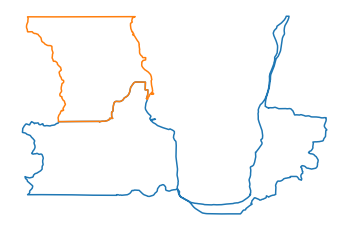

946. Nodes 376 and 372 are connected


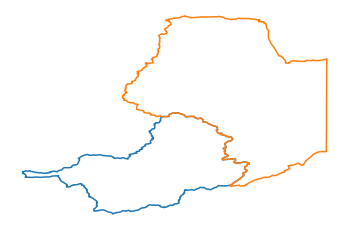

947. Nodes 378 and 377 are connected


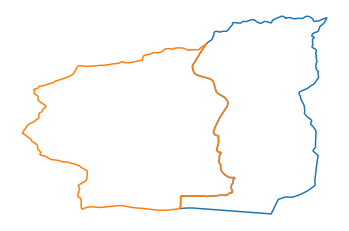

948. Nodes 379 and 376 are connected


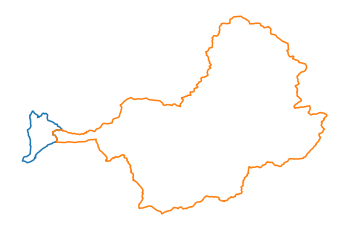

949. Nodes 379 and 378 are connected


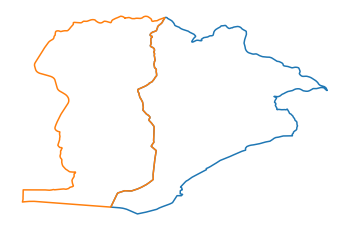

950. Nodes 380 and 376 are connected


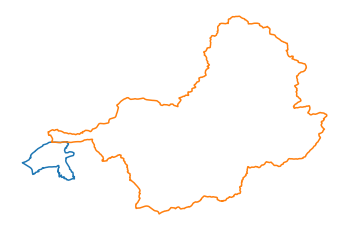

951. Nodes 380 and 379 are connected


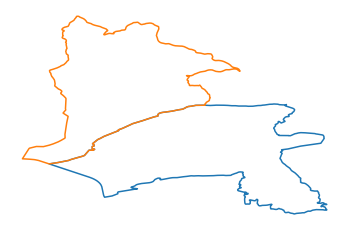

952. Nodes 381 and 380 are connected


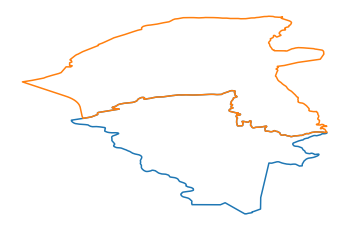

953. Nodes 382 and 377 are connected


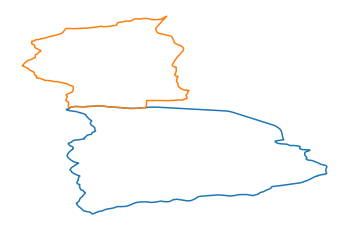

954. Nodes 382 and 378 are connected


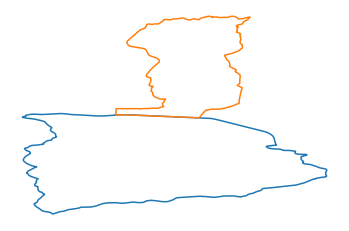

955. Nodes 382 and 379 are connected


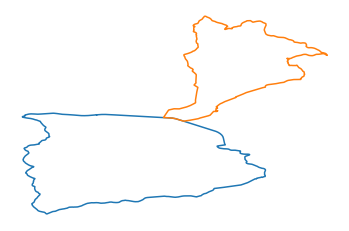

956. Nodes 382 and 380 are connected


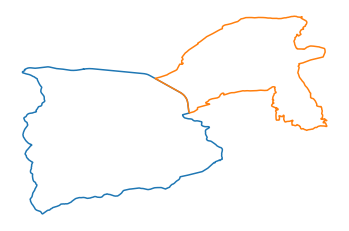

957. Nodes 382 and 381 are connected


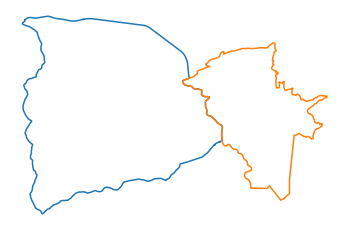

958. Nodes 383 and 381 are connected


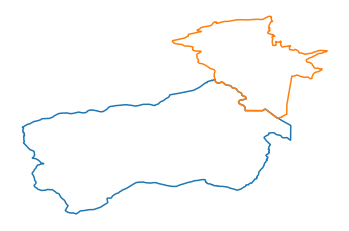

959. Nodes 383 and 382 are connected


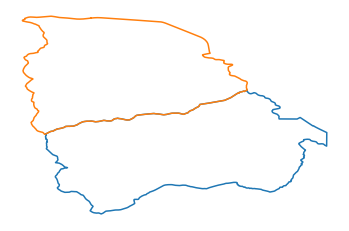

960. Nodes 384 and 383 are connected


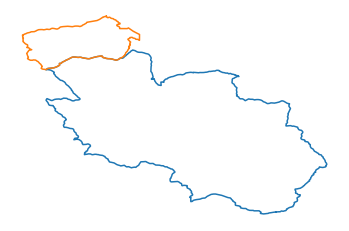

961. Nodes 385 and 383 are connected


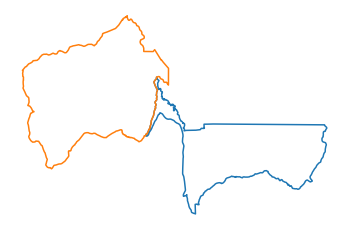

962. Nodes 385 and 384 are connected


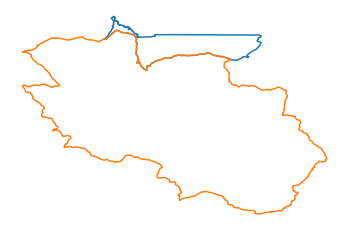

963. Nodes 386 and 383 are connected


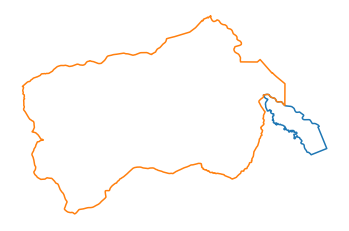

964. Nodes 386 and 385 are connected


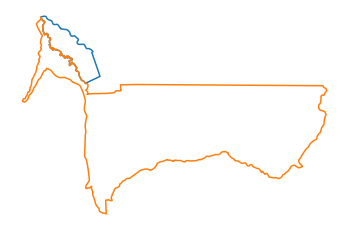

965. Nodes 387 and 385 are connected


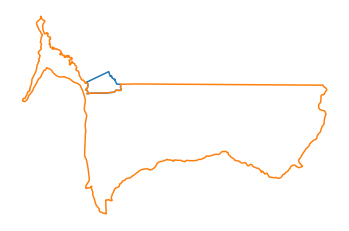

966. Nodes 387 and 386 are connected


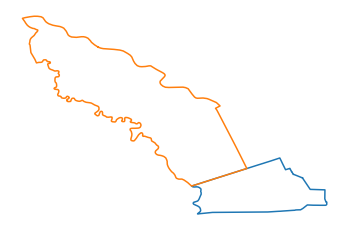

967. Nodes 388 and 386 are connected


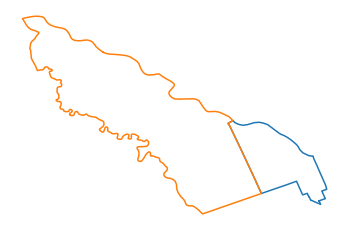

968. Nodes 388 and 387 are connected


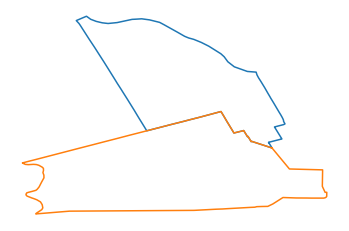

969. Nodes 389 and 383 are connected


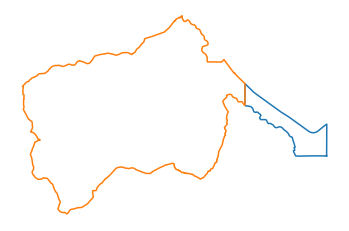

970. Nodes 389 and 385 are connected


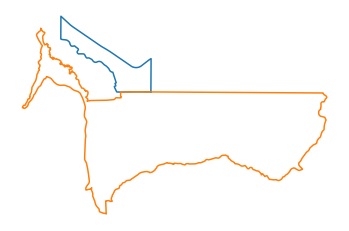

971. Nodes 389 and 386 are connected


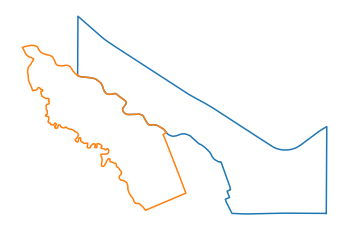

972. Nodes 389 and 387 are connected


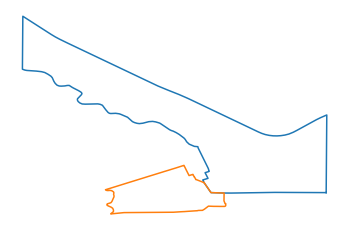

973. Nodes 389 and 388 are connected


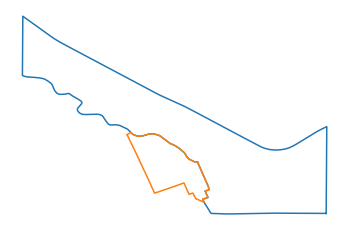

974. Nodes 390 and 376 are connected


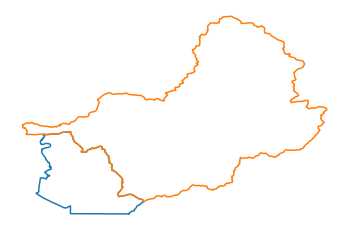

975. Nodes 390 and 380 are connected


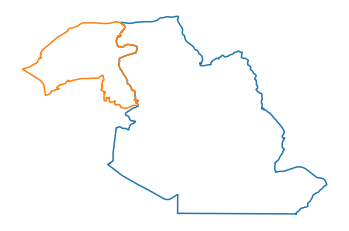

976. Nodes 390 and 381 are connected


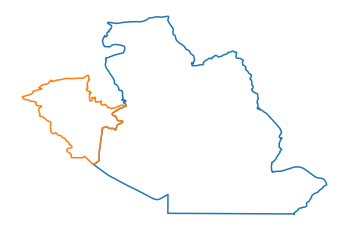

977. Nodes 390 and 383 are connected


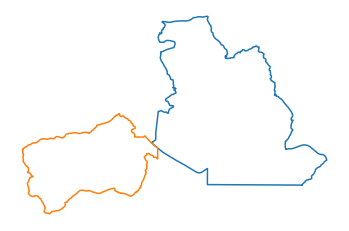

978. Nodes 390 and 385 are connected


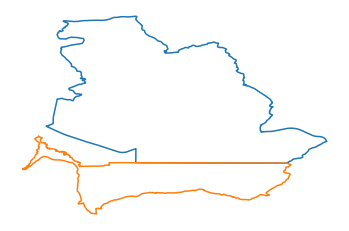

979. Nodes 390 and 389 are connected


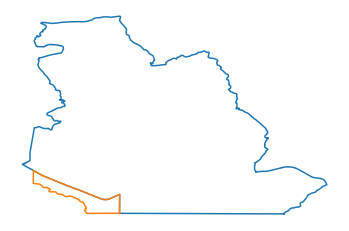

980. Nodes 391 and 90 are connected


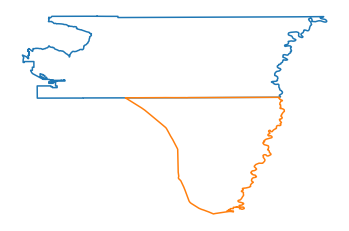

981. Nodes 391 and 96 are connected


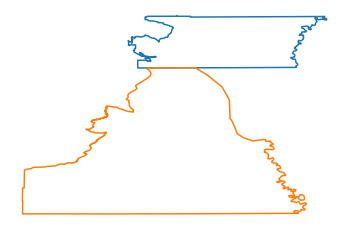

982. Nodes 391 and 108 are connected


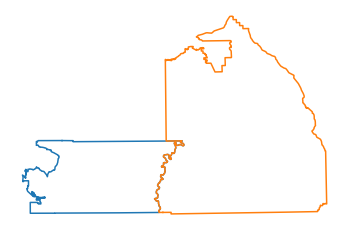

983. Nodes 392 and 391 are connected


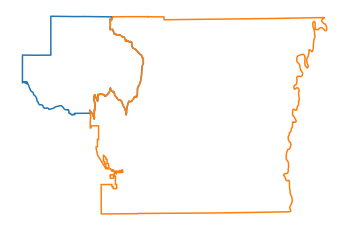

984. Nodes 393 and 94 are connected


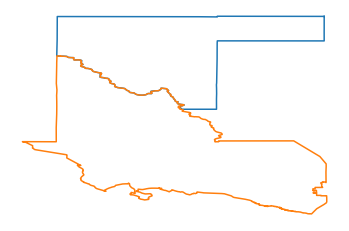

985. Nodes 393 and 361 are connected


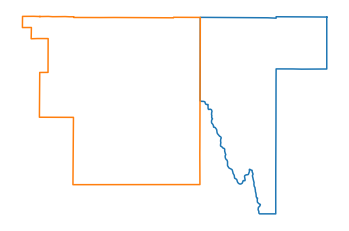

986. Nodes 393 and 392 are connected


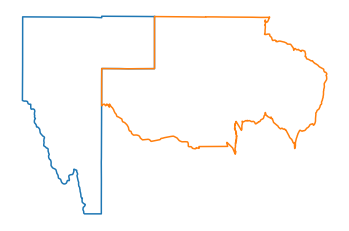

987. Nodes 394 and 391 are connected


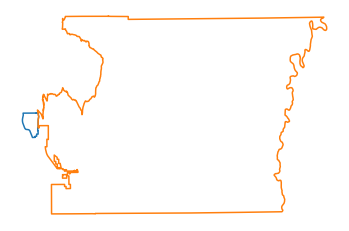

988. Nodes 394 and 392 are connected


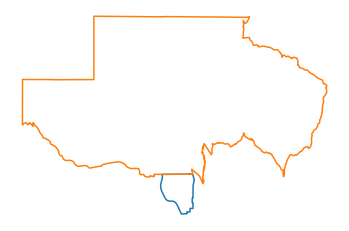

989. Nodes 395 and 391 are connected


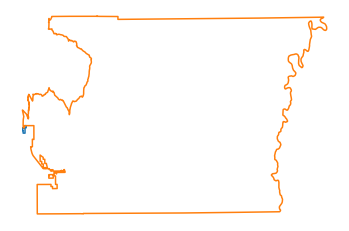

990. Nodes 395 and 394 are connected


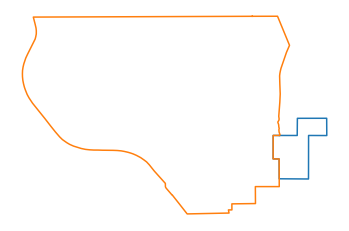

991. Nodes 396 and 391 are connected


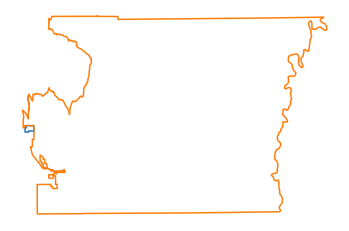

992. Nodes 396 and 395 are connected


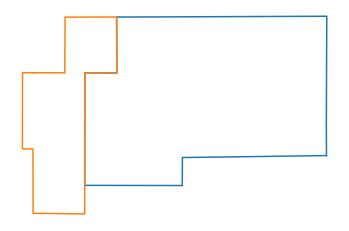

993. Nodes 397 and 391 are connected


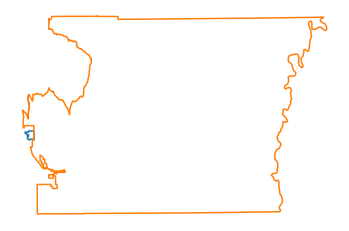

994. Nodes 397 and 395 are connected


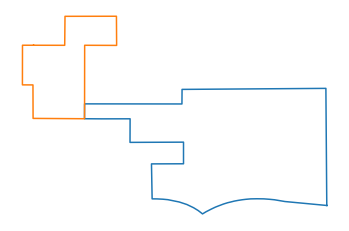

995. Nodes 397 and 396 are connected


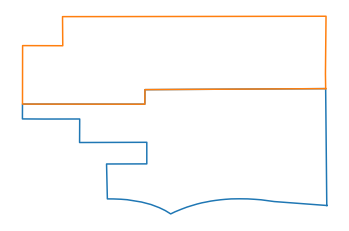

996. Nodes 398 and 394 are connected


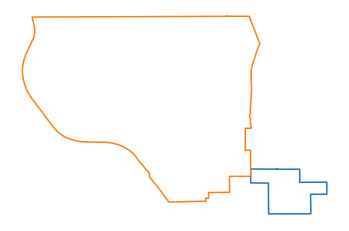

997. Nodes 398 and 395 are connected


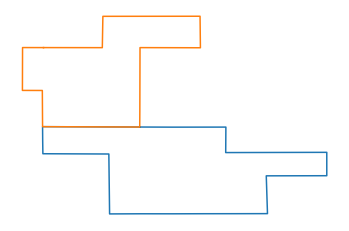

998. Nodes 398 and 397 are connected


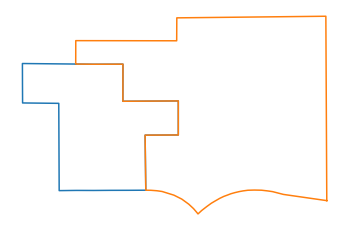

999. Nodes 399 and 394 are connected


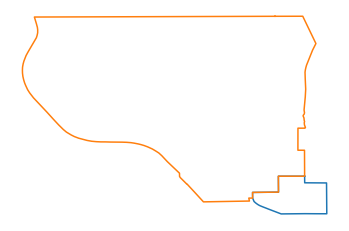

1000. Nodes 399 and 398 are connected


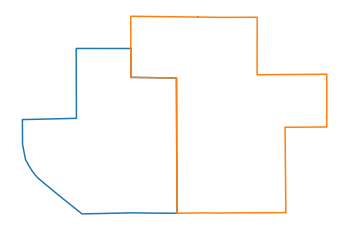

1001. Nodes 400 and 391 are connected


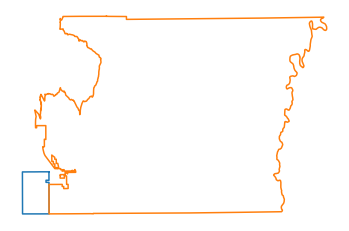

1002. Nodes 401 and 391 are connected


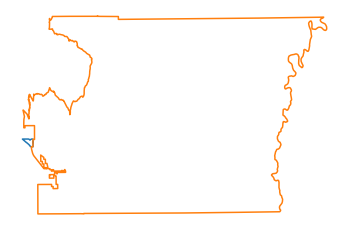

1003. Nodes 401 and 397 are connected


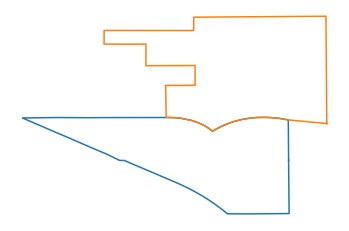

1004. Nodes 401 and 398 are connected


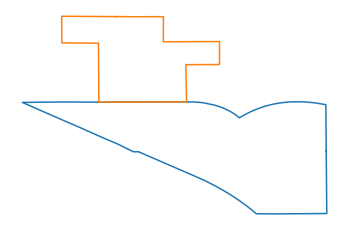

1005. Nodes 401 and 399 are connected


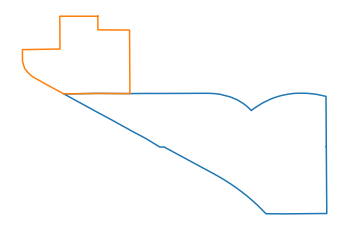

1006. Nodes 402 and 92 are connected


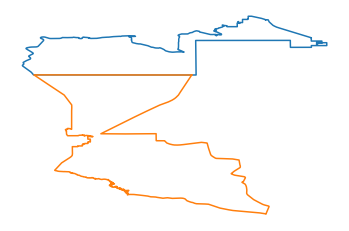

1007. Nodes 402 and 94 are connected


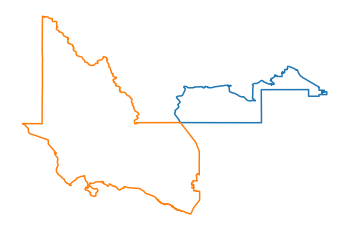

1008. Nodes 402 and 391 are connected


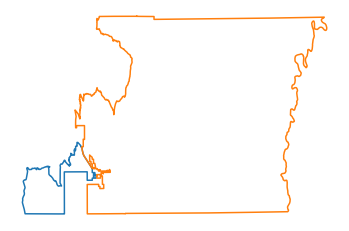

1009. Nodes 402 and 400 are connected


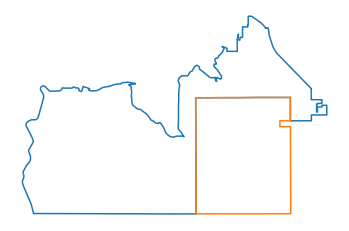

1010. Nodes 402 and 401 are connected


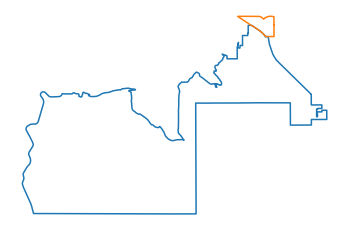

1011. Nodes 403 and 94 are connected


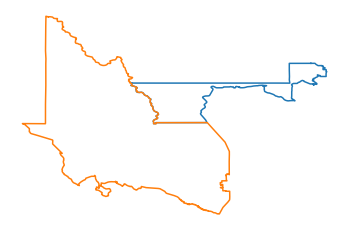

1012. Nodes 403 and 393 are connected


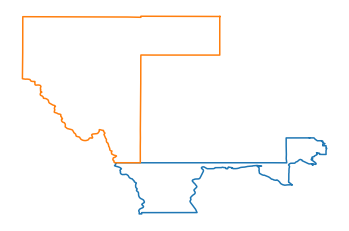

1013. Nodes 403 and 402 are connected


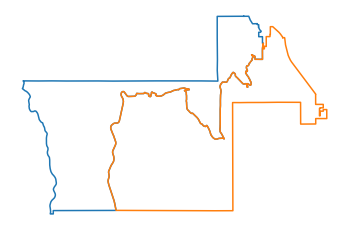

1014. Nodes 404 and 392 are connected


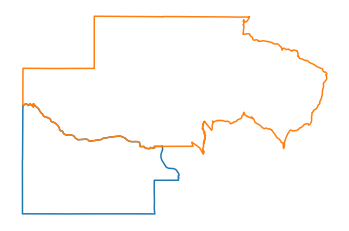

1015. Nodes 404 and 393 are connected


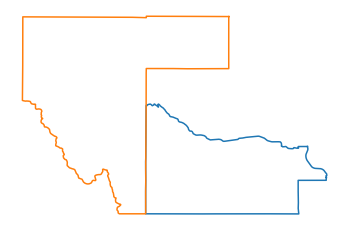

1016. Nodes 404 and 394 are connected


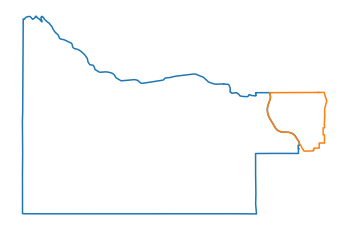

1017. Nodes 404 and 403 are connected


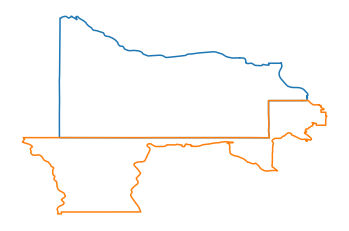

1018. Nodes 405 and 394 are connected


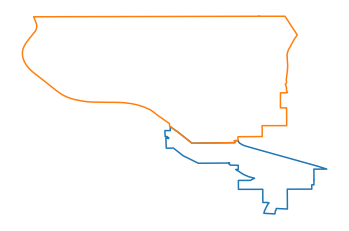

1019. Nodes 405 and 399 are connected


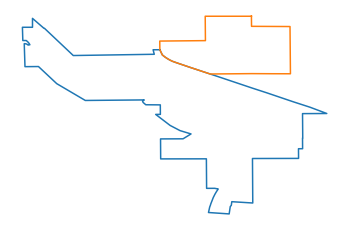

1020. Nodes 405 and 401 are connected


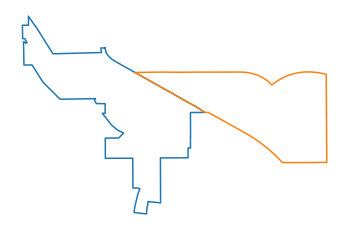

1021. Nodes 405 and 402 are connected


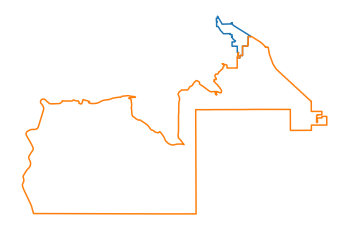

1022. Nodes 405 and 403 are connected


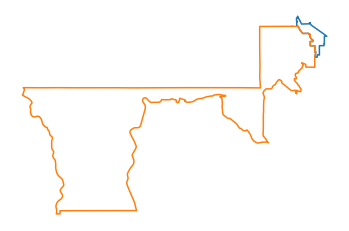

1023. Nodes 405 and 404 are connected


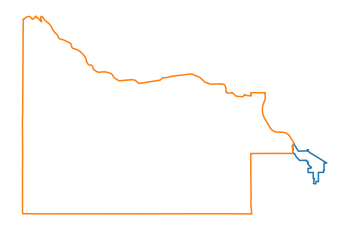

1024. Nodes 406 and 391 are connected


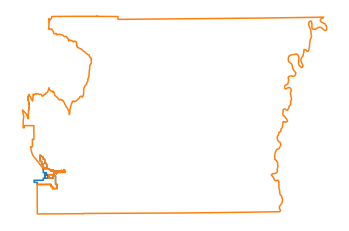

1025. Nodes 406 and 400 are connected


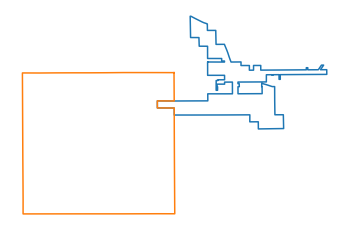

1026. Nodes 406 and 402 are connected


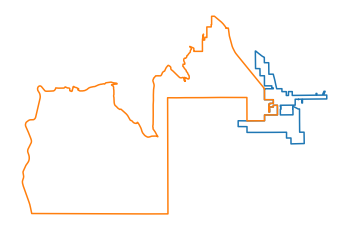

1027. Nodes 407 and 25 are connected


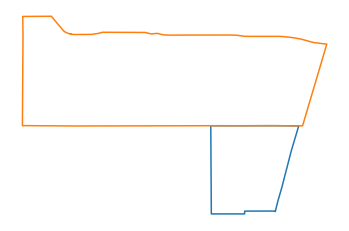

1028. Nodes 407 and 43 are connected


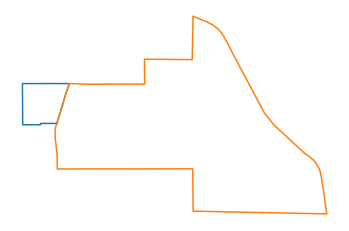

1029. Nodes 407 and 55 are connected


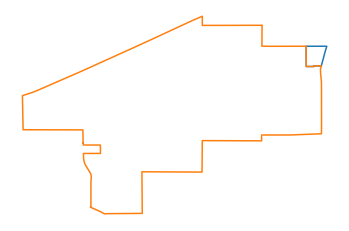

1030. Nodes 411 and 371 are connected


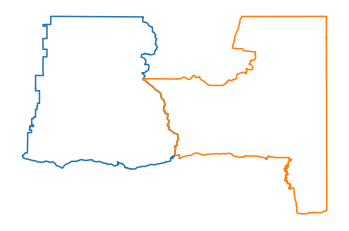

1031. Nodes 411 and 373 are connected


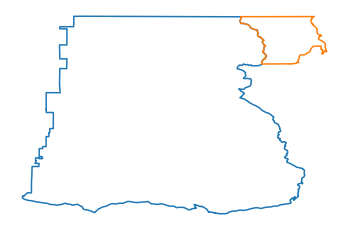

1032. Nodes 411 and 375 are connected


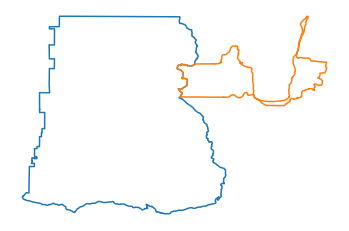

1033. Nodes 416 and 409 are connected


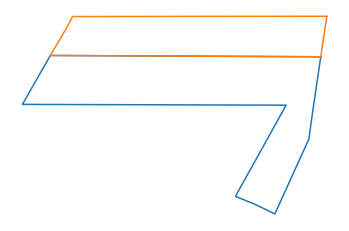

1034. Nodes 416 and 411 are connected


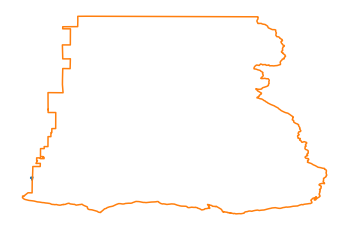

1035. Nodes 421 and 419 are connected


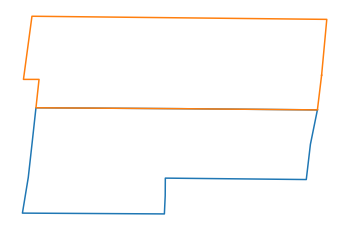

1036. Nodes 424 and 421 are connected


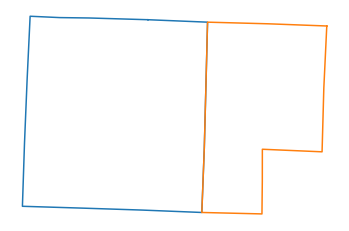

1037. Nodes 425 and 419 are connected


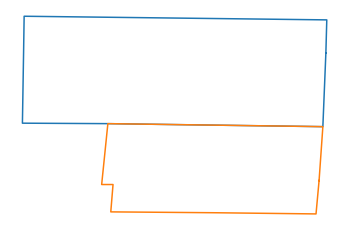

1038. Nodes 426 and 423 are connected


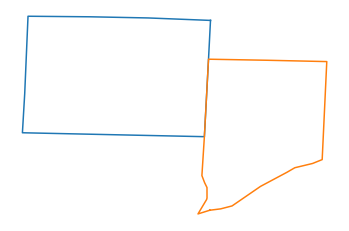

1039. Nodes 427 and 423 are connected


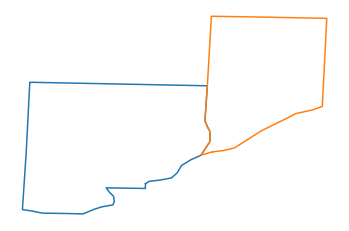

1040. Nodes 427 and 426 are connected


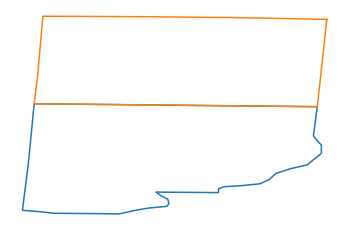

1041. Nodes 429 and 421 are connected


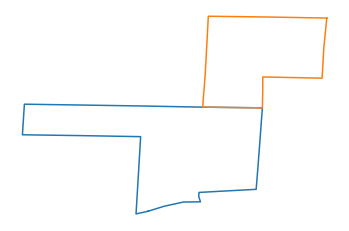

1042. Nodes 429 and 423 are connected


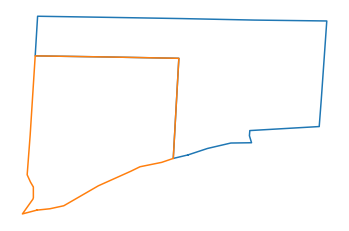

1043. Nodes 429 and 424 are connected


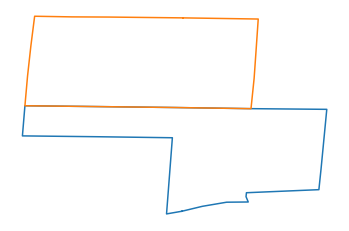

1044. Nodes 429 and 426 are connected


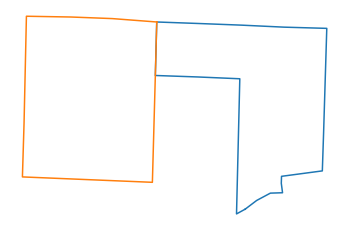

1045. Nodes 430 and 413 are connected


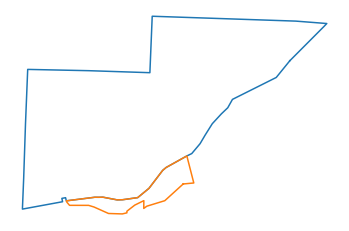

1046. Nodes 431 and 411 are connected


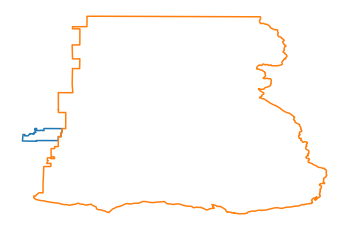

1047. Nodes 431 and 428 are connected


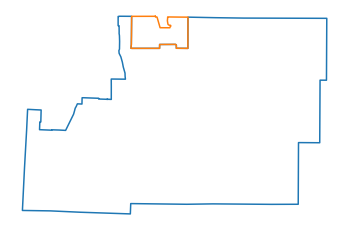

1048. Nodes 432 and 419 are connected


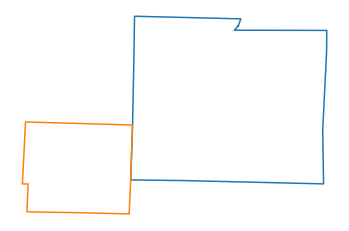

1049. Nodes 432 and 425 are connected


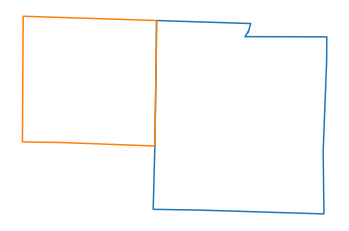

1050. Nodes 433 and 419 are connected


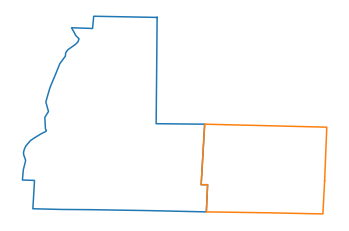

1051. Nodes 433 and 424 are connected


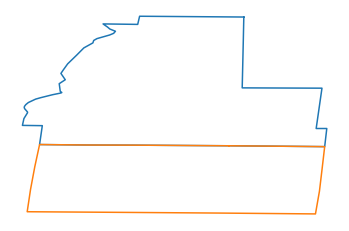

1052. Nodes 433 and 425 are connected


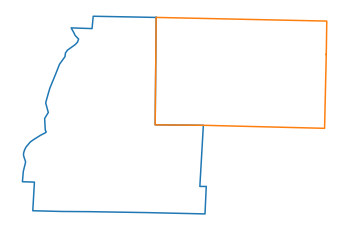

1053. Nodes 434 and 426 are connected


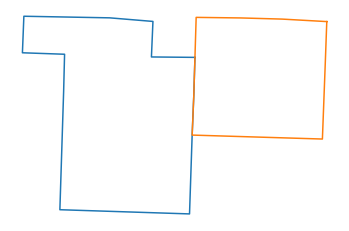

1054. Nodes 434 and 427 are connected


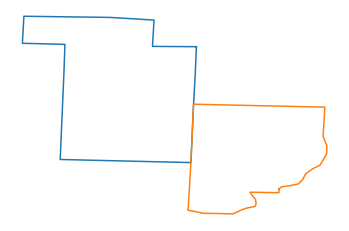

1055. Nodes 435 and 423 are connected


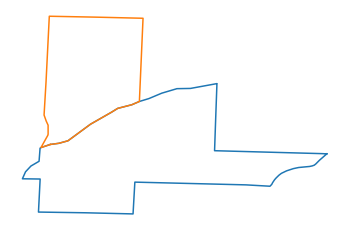

1056. Nodes 435 and 427 are connected


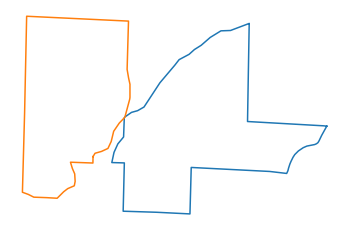

1057. Nodes 435 and 429 are connected


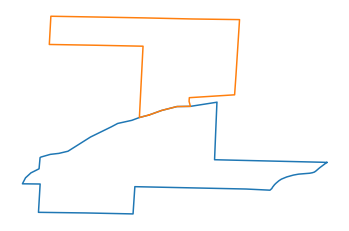

1058. Nodes 435 and 430 are connected


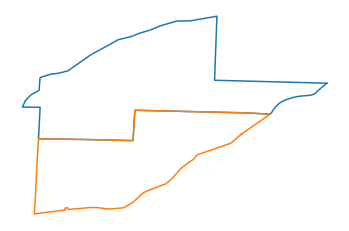

1059. Nodes 436 and 411 are connected


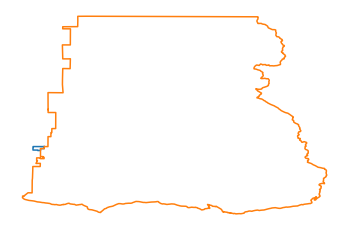

1060. Nodes 437 and 432 are connected


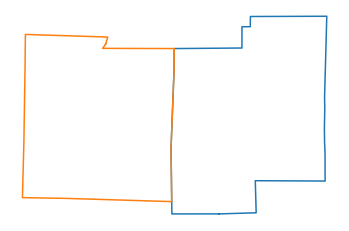

1061. Nodes 437 and 436 are connected


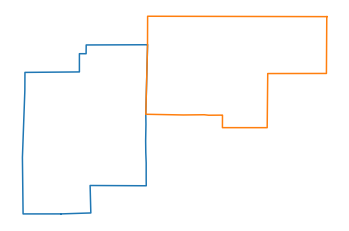

1062. Nodes 438 and 419 are connected


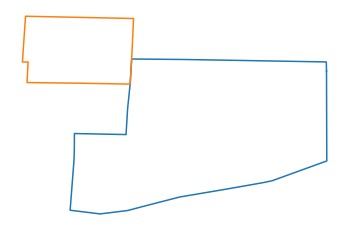

1063. Nodes 438 and 421 are connected


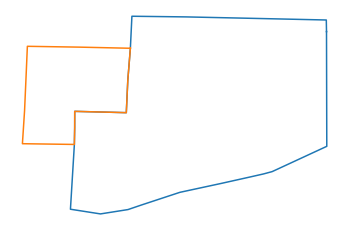

1064. Nodes 438 and 429 are connected


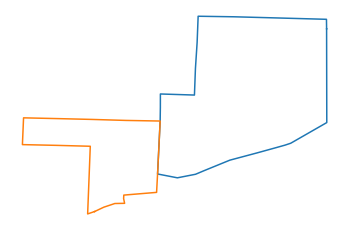

1065. Nodes 438 and 432 are connected


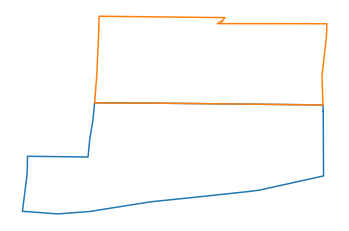

1066. Nodes 438 and 437 are connected


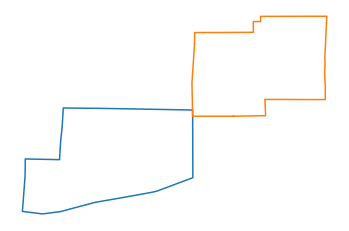

1067. Nodes 439 and 417 are connected


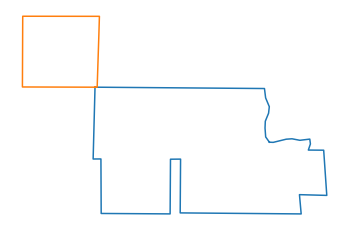

1068. Nodes 440 and 410 are connected


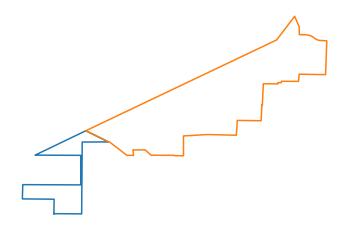

1069. Nodes 440 and 415 are connected


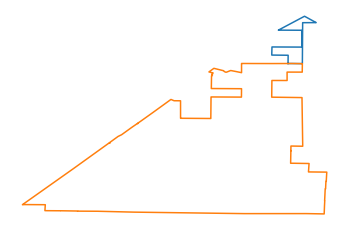

1070. Nodes 440 and 417 are connected


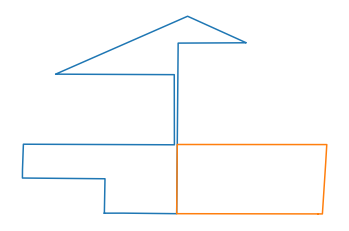

1071. Nodes 440 and 418 are connected


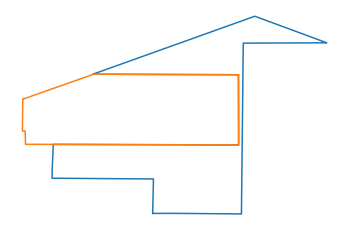

1072. Nodes 442 and 439 are connected


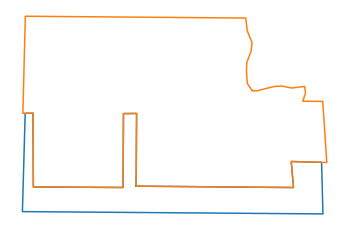

1073. Nodes 445 and 411 are connected


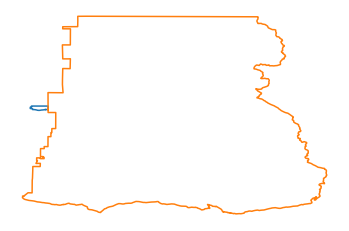

1074. Nodes 447 and 424 are connected


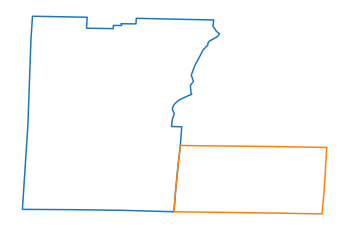

1075. Nodes 447 and 426 are connected


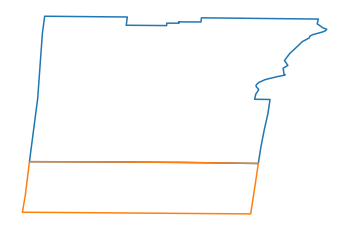

1076. Nodes 447 and 433 are connected


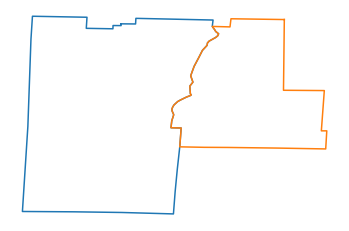

1077. Nodes 448 and 410 are connected


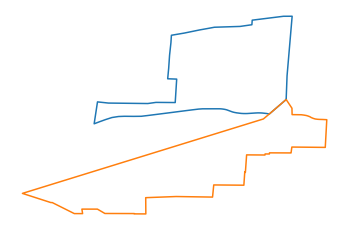

1078. Nodes 449 and 441 are connected


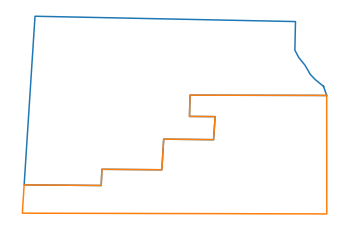

1079. Nodes 449 and 443 are connected


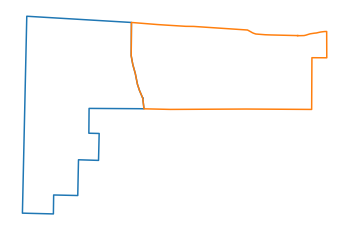

1080. Nodes 450 and 413 are connected


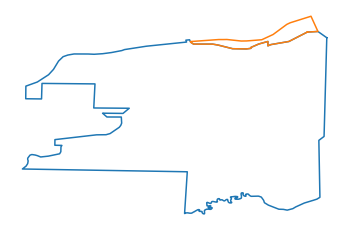

1081. Nodes 450 and 414 are connected


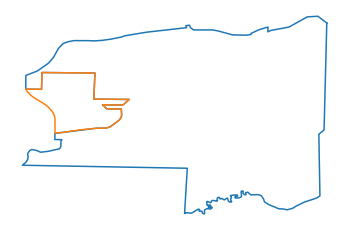

1082. Nodes 450 and 430 are connected


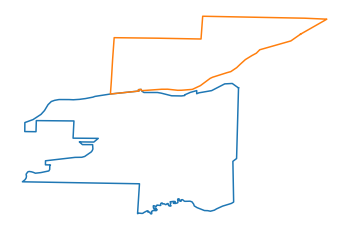

1083. Nodes 451 and 410 are connected


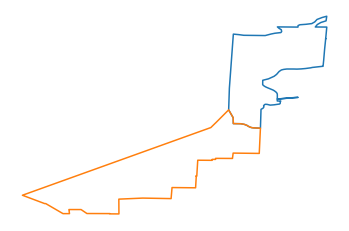

1084. Nodes 451 and 414 are connected


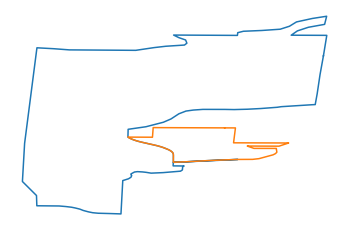

1085. Nodes 451 and 427 are connected


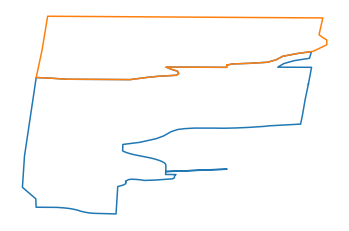

1086. Nodes 451 and 430 are connected


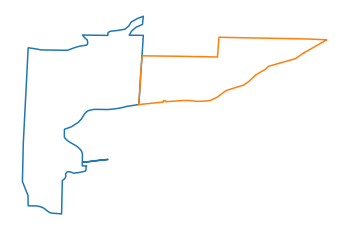

1087. Nodes 451 and 435 are connected


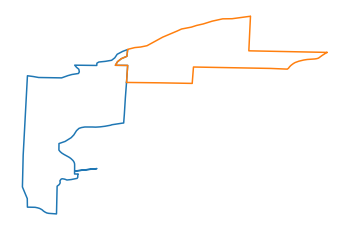

1088. Nodes 451 and 448 are connected


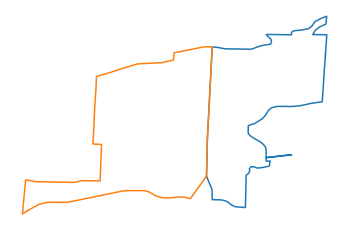

1089. Nodes 451 and 450 are connected


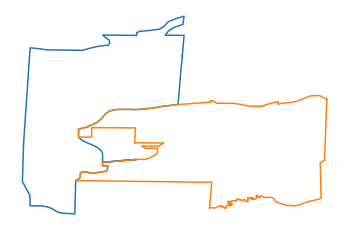

1090. Nodes 452 and 448 are connected


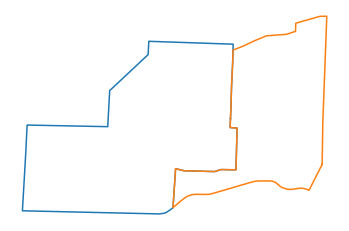

1091. Nodes 453 and 411 are connected


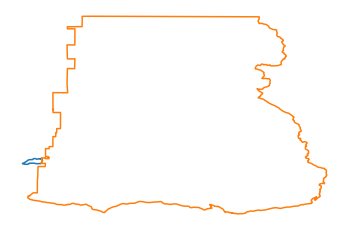

1092. Nodes 453 and 435 are connected


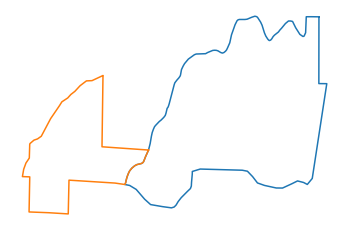

1093. Nodes 455 and 408 are connected


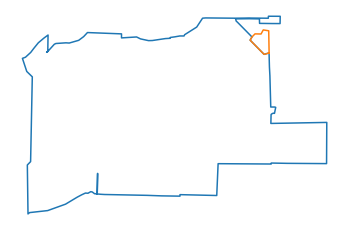

1094. Nodes 455 and 412 are connected


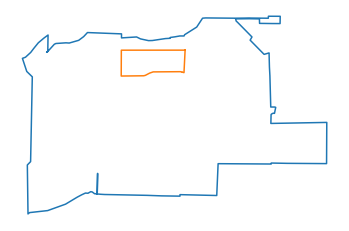

1095. Nodes 455 and 413 are connected


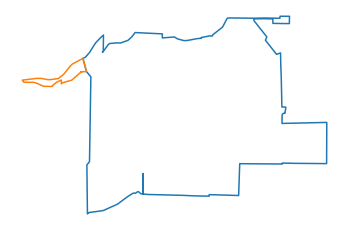

1096. Nodes 455 and 430 are connected


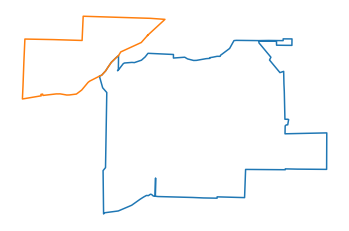

1097. Nodes 455 and 450 are connected


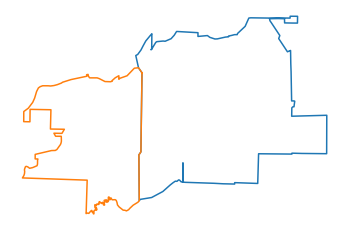

1098. Nodes 457 and 410 are connected


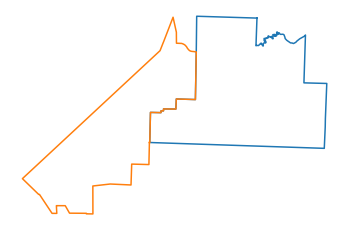

1099. Nodes 457 and 450 are connected


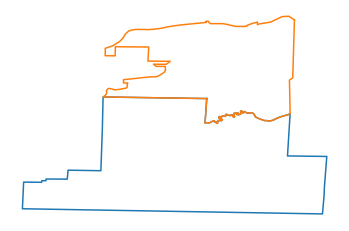

1100. Nodes 457 and 451 are connected


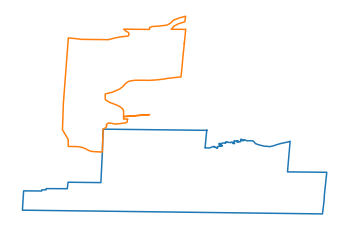

1101. Nodes 458 and 427 are connected


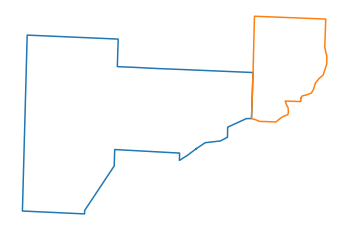

1102. Nodes 458 and 434 are connected


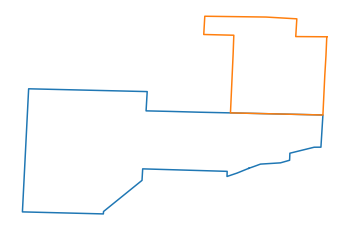

1103. Nodes 458 and 448 are connected


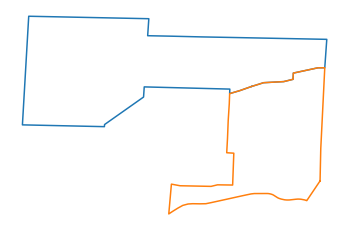

1104. Nodes 458 and 452 are connected


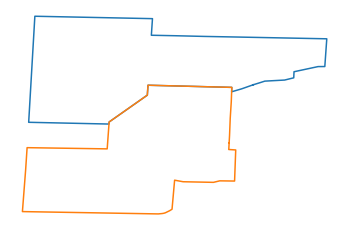

1105. Nodes 459 and 454 are connected


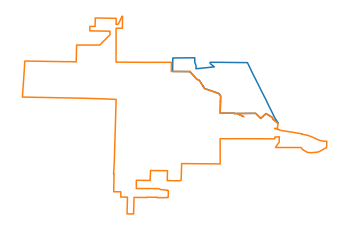

1106. Nodes 460 and 177 are connected


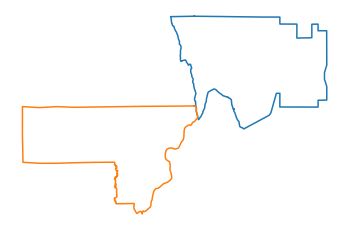

1107. Nodes 460 and 180 are connected


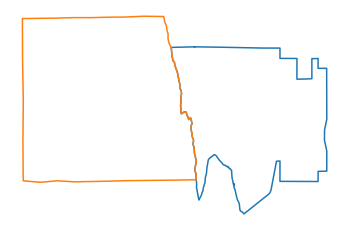

1108. Nodes 461 and 411 are connected


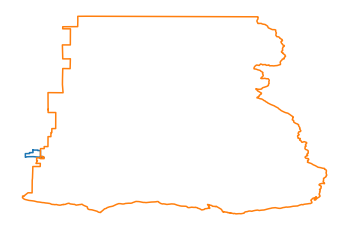

1109. Nodes 461 and 436 are connected


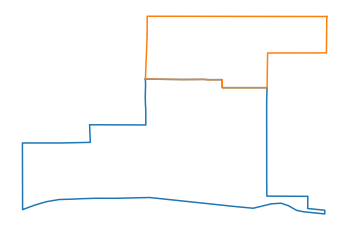

1110. Nodes 461 and 437 are connected


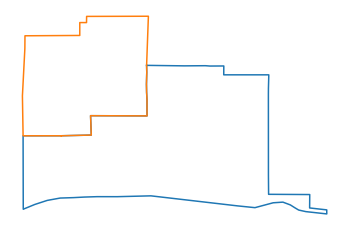

1111. Nodes 461 and 438 are connected


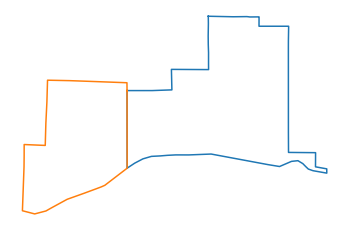

1112. Nodes 462 and 409 are connected


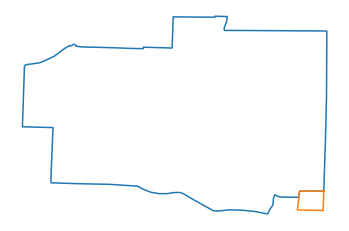

1113. Nodes 462 and 411 are connected


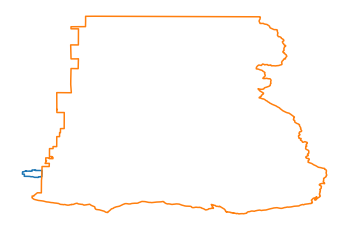

1114. Nodes 462 and 455 are connected


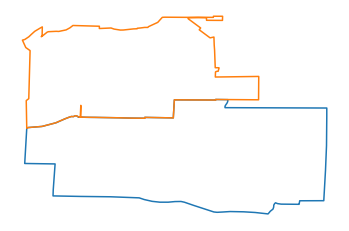

1115. Nodes 462 and 457 are connected


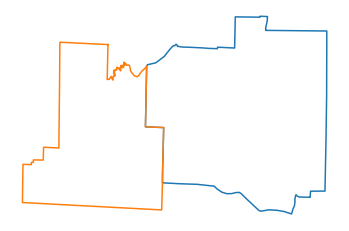

1116. Nodes 464 and 409 are connected


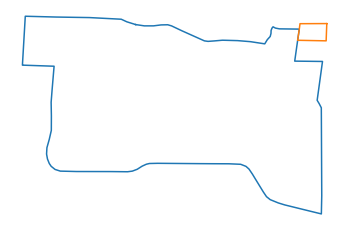

1117. Nodes 464 and 411 are connected


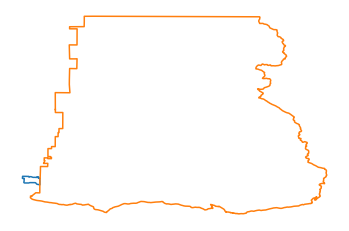

1118. Nodes 464 and 416 are connected


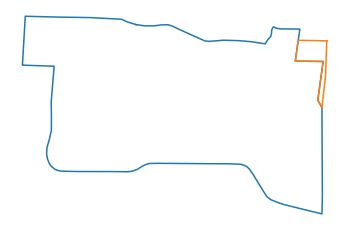

1119. Nodes 464 and 462 are connected


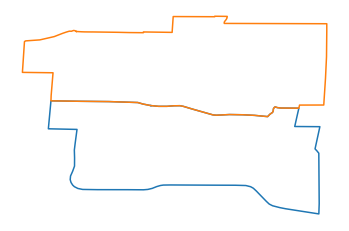

1120. Nodes 464 and 463 are connected


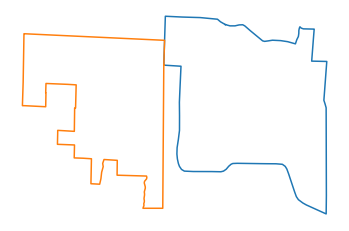

1121. Nodes 466 and 410 are connected


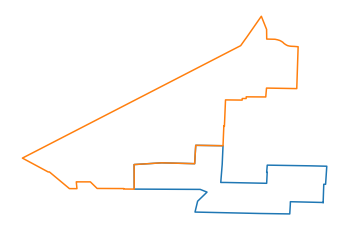

1122. Nodes 466 and 463 are connected


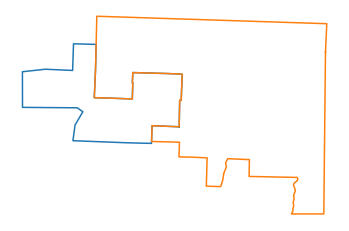

1123. Nodes 467 and 431 are connected


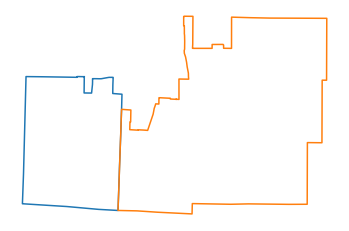

1124. Nodes 468 and 443 are connected


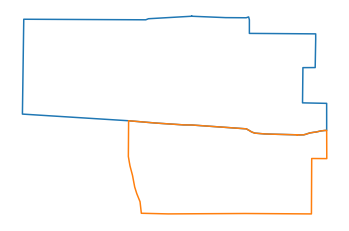

1125. Nodes 468 and 445 are connected


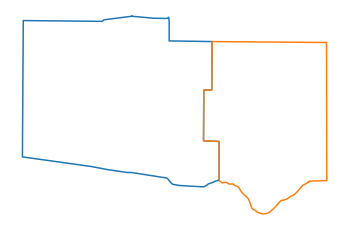

1126. Nodes 468 and 449 are connected


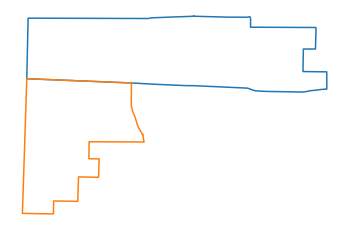

1127. Nodes 469 and 411 are connected


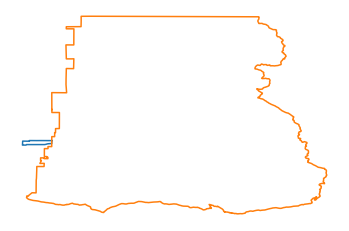

1128. Nodes 469 and 431 are connected


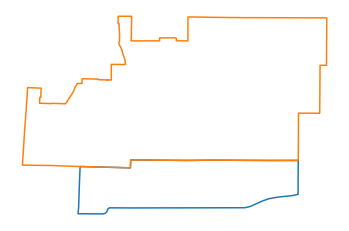

1129. Nodes 470 and 465 are connected


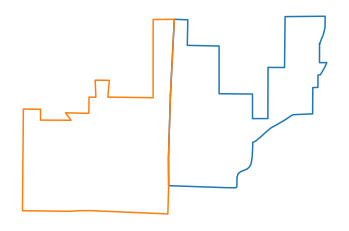

1130. Nodes 471 and 468 are connected


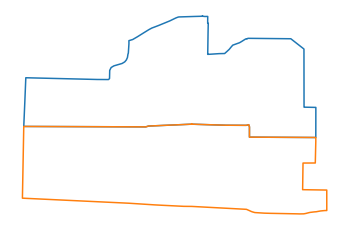

1131. Nodes 471 and 470 are connected


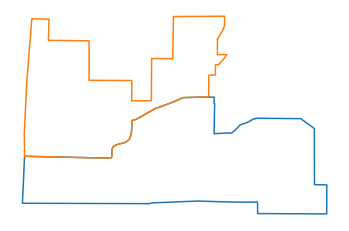

1132. Nodes 472 and 179 are connected


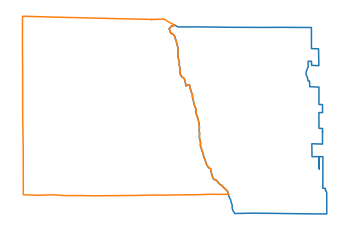

1133. Nodes 472 and 180 are connected


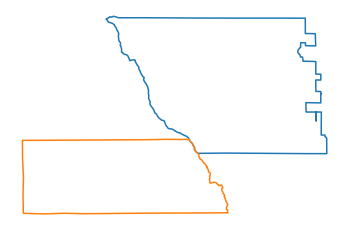

1134. Nodes 472 and 460 are connected


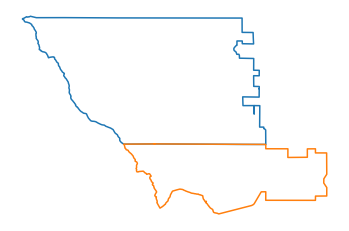

1135. Nodes 473 and 411 are connected


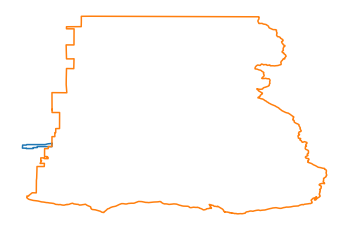

1136. Nodes 473 and 432 are connected


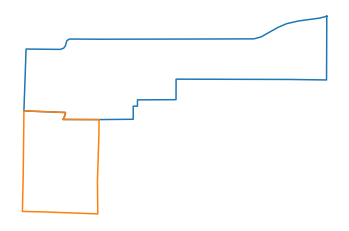

1137. Nodes 473 and 436 are connected


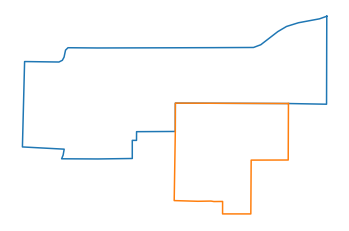

1138. Nodes 473 and 437 are connected


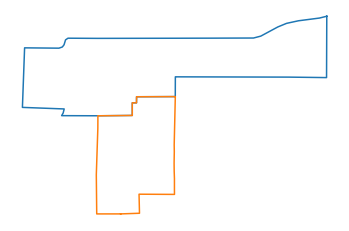

1139. Nodes 473 and 469 are connected


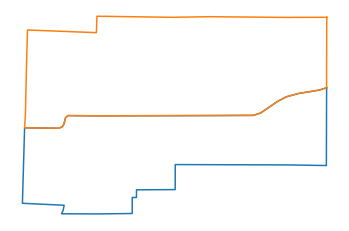

1140. Nodes 474 and 411 are connected


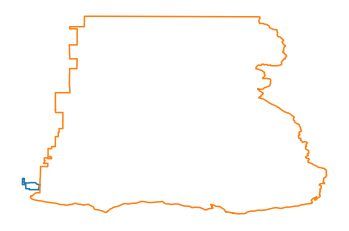

1141. Nodes 474 and 463 are connected


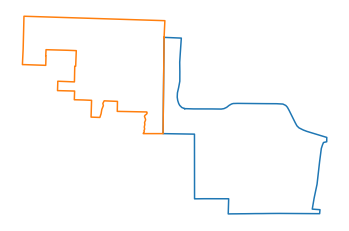

1142. Nodes 474 and 464 are connected


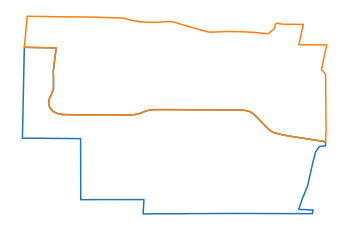

1143. Nodes 476 and 456 are connected


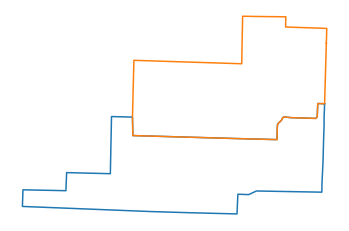

1144. Nodes 477 and 411 are connected


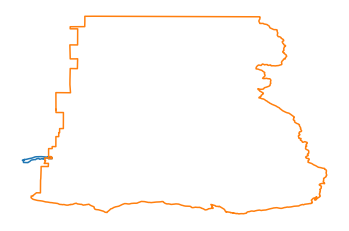

1145. Nodes 477 and 429 are connected


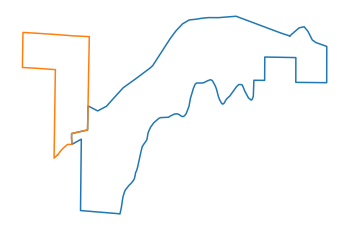

1146. Nodes 477 and 435 are connected


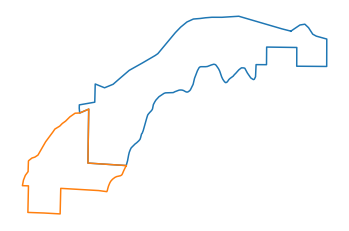

1147. Nodes 477 and 438 are connected


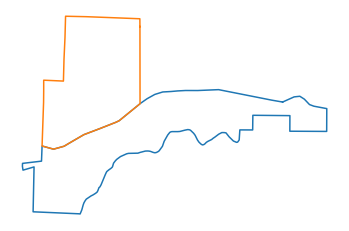

1148. Nodes 477 and 453 are connected


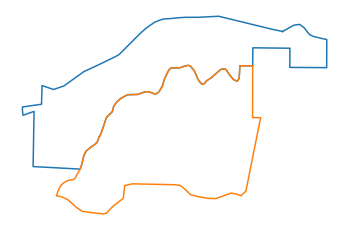

1149. Nodes 477 and 461 are connected


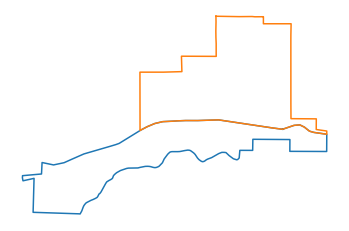

1150. Nodes 478 and 426 are connected


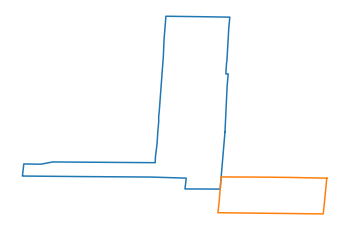

1151. Nodes 478 and 434 are connected


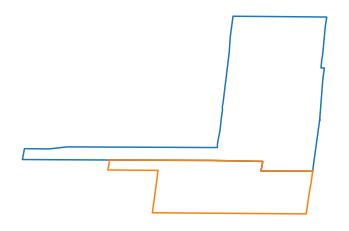

1152. Nodes 478 and 447 are connected


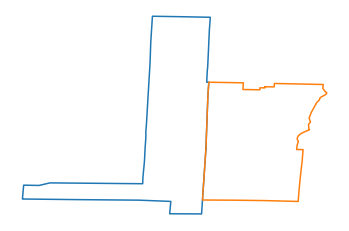

1153. Nodes 478 and 456 are connected


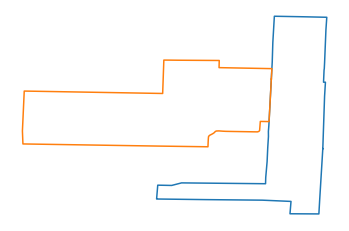

1154. Nodes 478 and 476 are connected


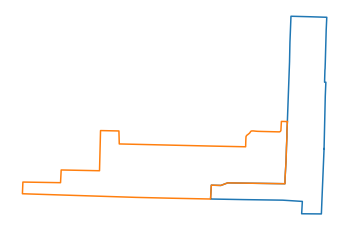

1155. Nodes 479 and 425 are connected


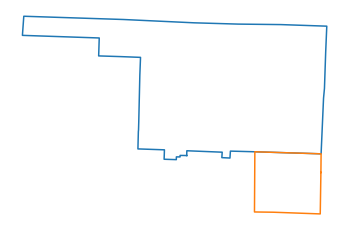

1156. Nodes 479 and 431 are connected


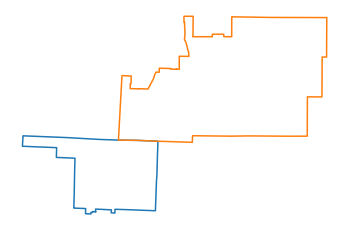

1157. Nodes 479 and 433 are connected


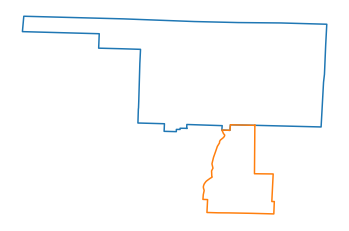

1158. Nodes 479 and 447 are connected


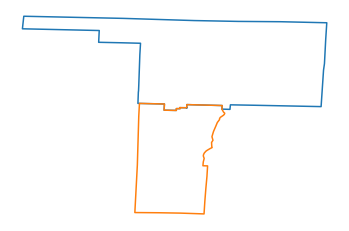

1159. Nodes 479 and 467 are connected


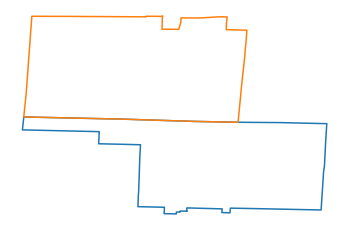

1160. Nodes 479 and 469 are connected


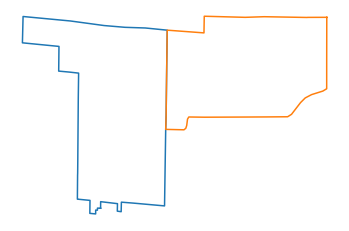

1161. Nodes 479 and 473 are connected


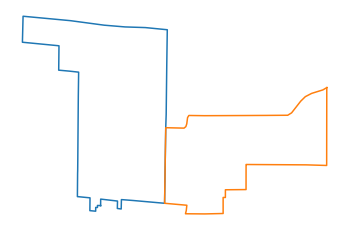

1162. Nodes 479 and 478 are connected


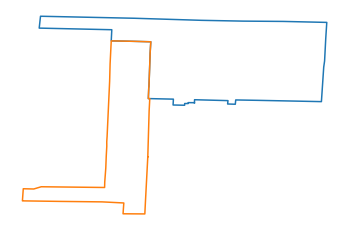

1163. Nodes 480 and 449 are connected


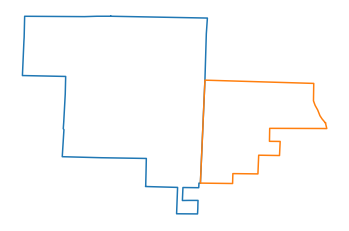

1164. Nodes 480 and 465 are connected


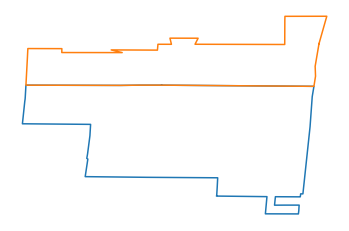

1165. Nodes 480 and 468 are connected


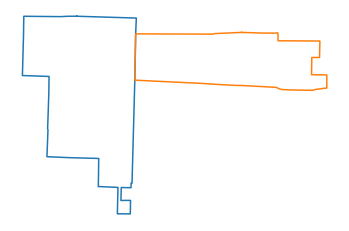

1166. Nodes 481 and 408 are connected


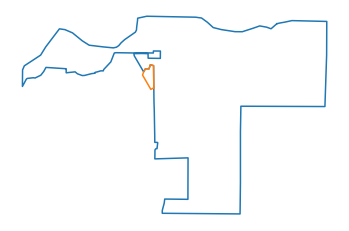

1167. Nodes 481 and 411 are connected


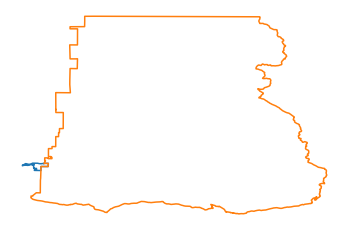

1168. Nodes 481 and 430 are connected


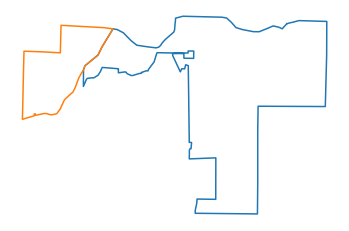

1169. Nodes 481 and 453 are connected


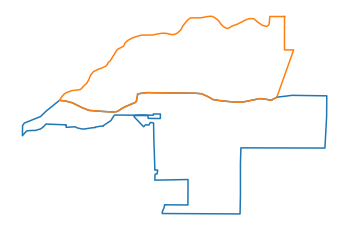

1170. Nodes 481 and 455 are connected


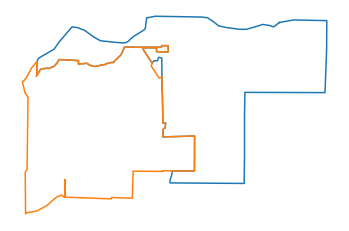

1171. Nodes 481 and 462 are connected


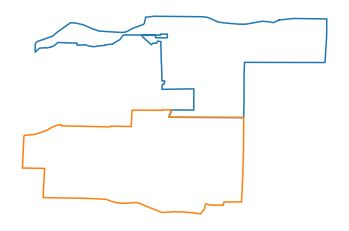

1172. Nodes 483 and 420 are connected


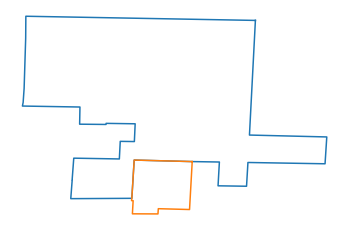

1173. Nodes 483 and 422 are connected


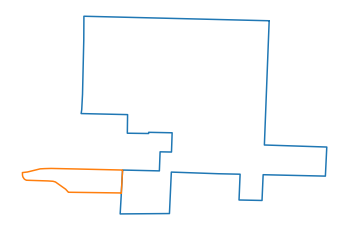

1174. Nodes 483 and 452 are connected


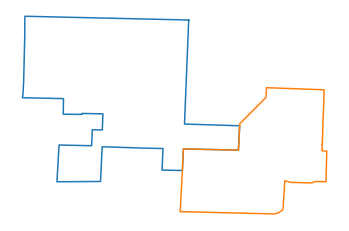

1175. Nodes 483 and 458 are connected


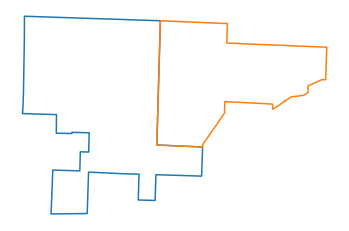

1176. Nodes 484 and 212 are connected


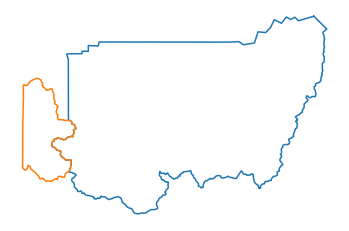

1177. Nodes 484 and 372 are connected


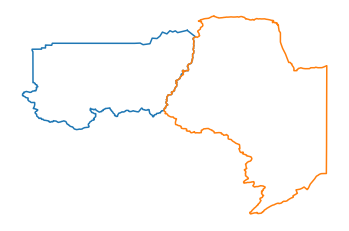

1178. Nodes 485 and 411 are connected


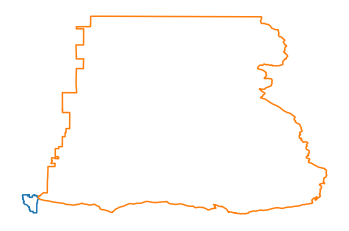

1179. Nodes 485 and 446 are connected


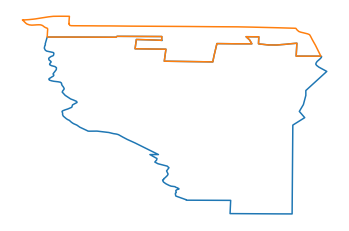

1180. Nodes 486 and 415 are connected


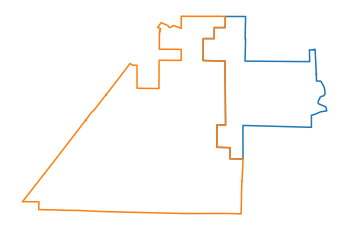

1181. Nodes 486 and 439 are connected


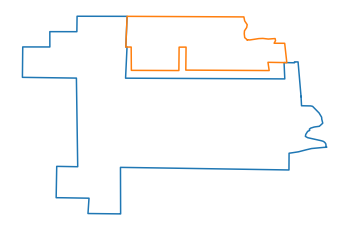

1182. Nodes 486 and 442 are connected


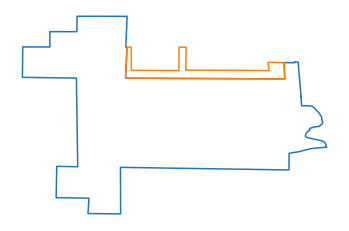

1183. Nodes 487 and 415 are connected


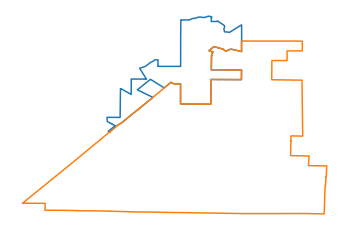

1184. Nodes 488 and 410 are connected


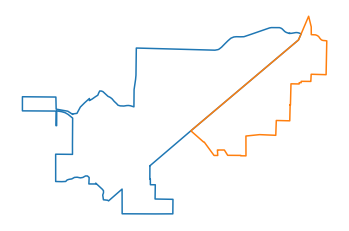

1185. Nodes 488 and 415 are connected


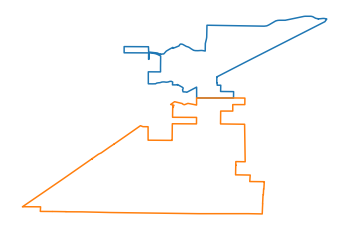

1186. Nodes 488 and 418 are connected


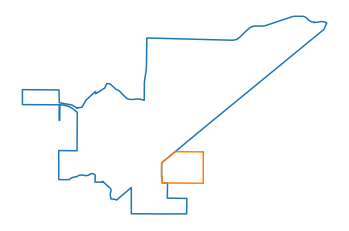

1187. Nodes 488 and 440 are connected


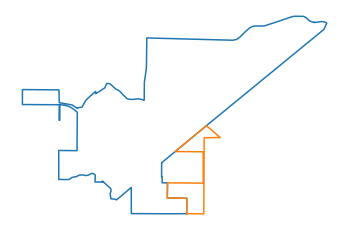

1188. Nodes 488 and 448 are connected


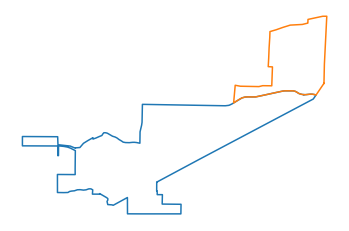

1189. Nodes 488 and 452 are connected


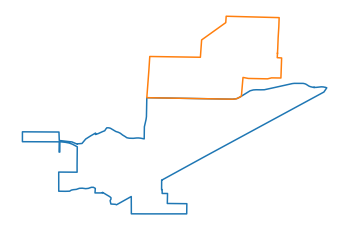

1190. Nodes 488 and 487 are connected


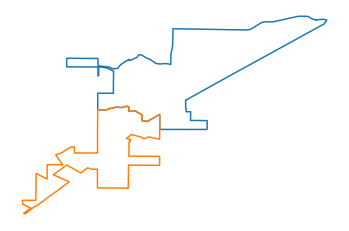

1191. Nodes 489 and 411 are connected


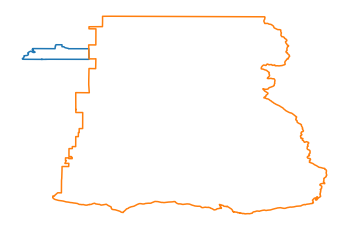

1192. Nodes 489 and 482 are connected


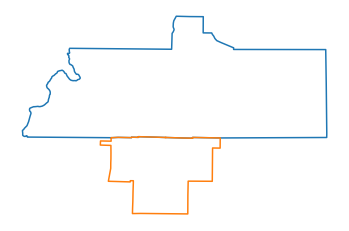

1193. Nodes 490 and 434 are connected


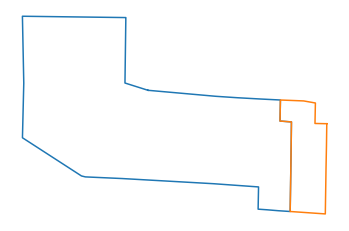

1194. Nodes 490 and 458 are connected


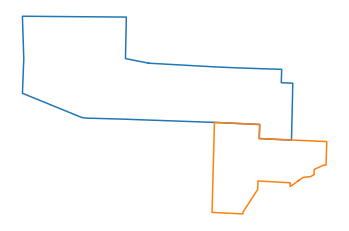

1195. Nodes 490 and 476 are connected


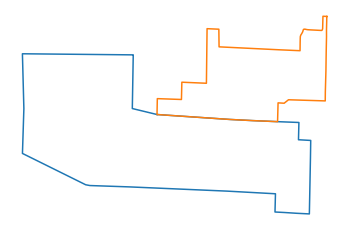

1196. Nodes 490 and 478 are connected


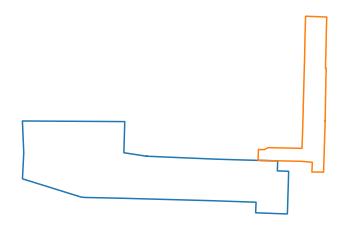

1197. Nodes 491 and 411 are connected


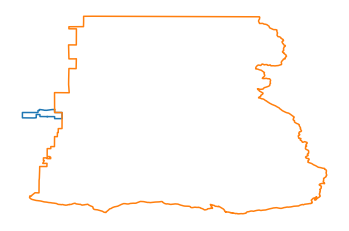

1198. Nodes 491 and 441 are connected


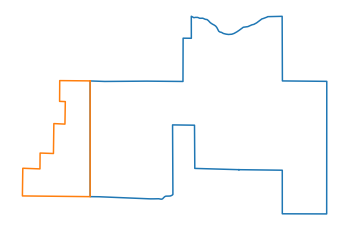

1199. Nodes 491 and 443 are connected


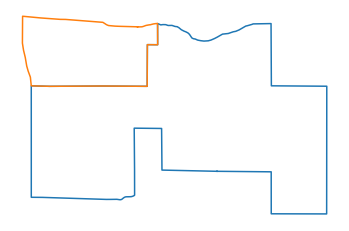

1200. Nodes 491 and 445 are connected


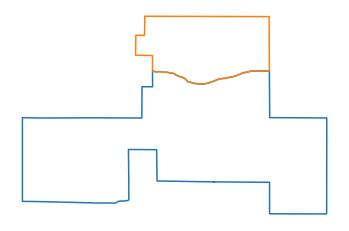

1201. Nodes 492 and 454 are connected


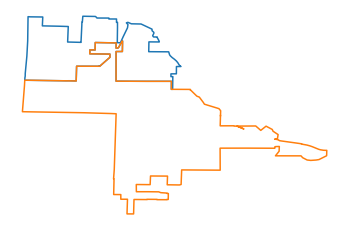

1202. Nodes 492 and 459 are connected


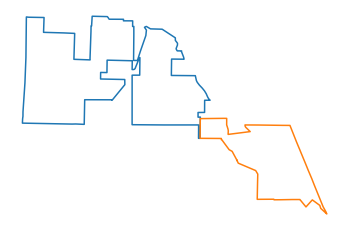

1203. Nodes 493 and 441 are connected


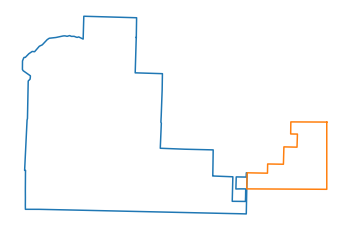

1204. Nodes 493 and 480 are connected


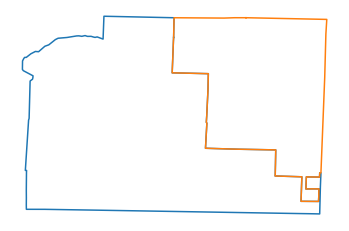

1205. Nodes 494 and 411 are connected


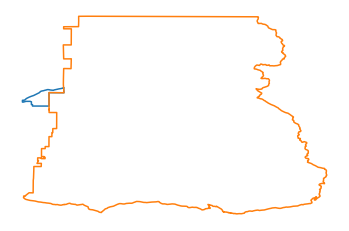

1206. Nodes 494 and 445 are connected


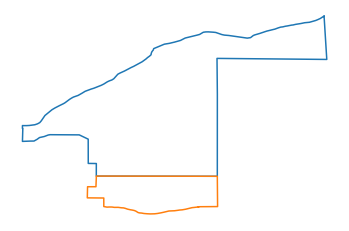

1207. Nodes 494 and 471 are connected


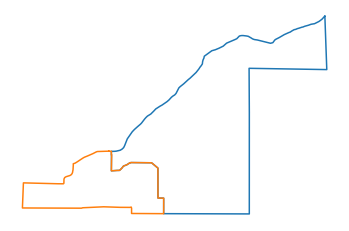

1208. Nodes 495 and 411 are connected


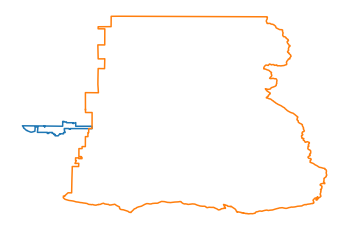

1209. Nodes 495 and 428 are connected


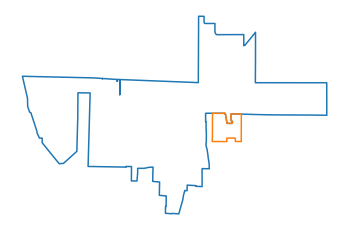

1210. Nodes 495 and 431 are connected


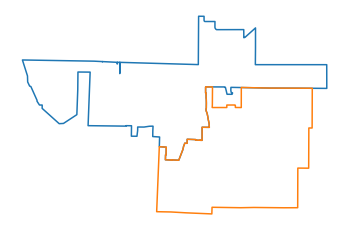

1211. Nodes 495 and 467 are connected


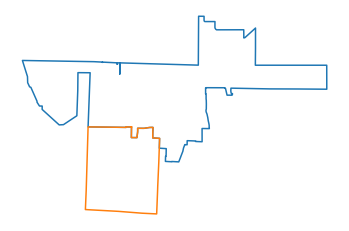

1212. Nodes 496 and 415 are connected


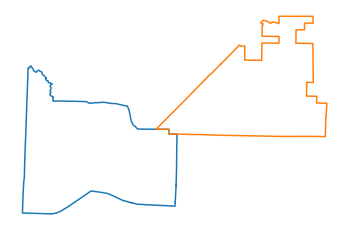

1213. Nodes 496 and 444 are connected


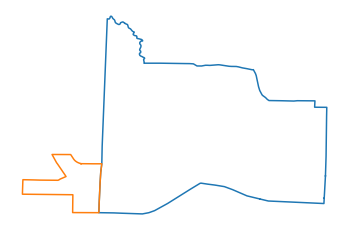

1214. Nodes 497 and 415 are connected


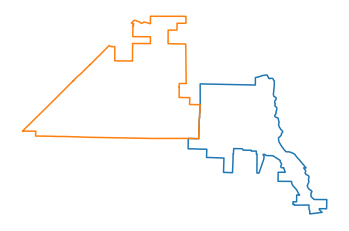

1215. Nodes 497 and 446 are connected


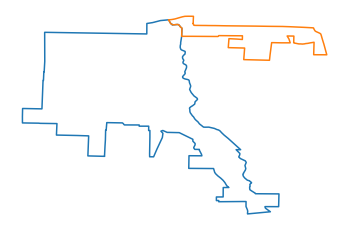

1216. Nodes 497 and 459 are connected


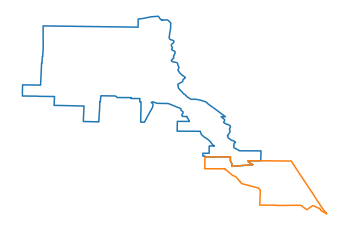

1217. Nodes 497 and 485 are connected


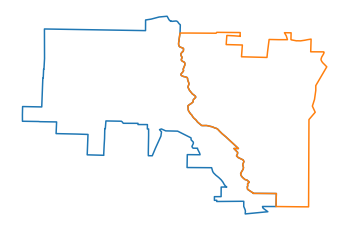

1218. Nodes 497 and 486 are connected


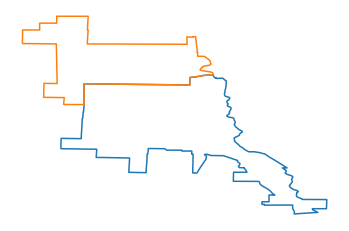

1219. Nodes 497 and 492 are connected


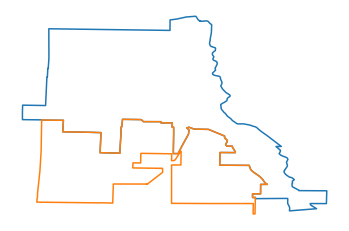

1220. Nodes 498 and 475 are connected


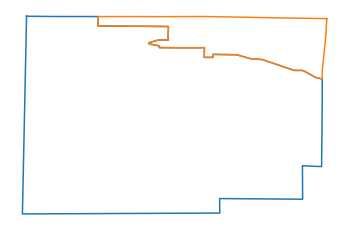

1221. Nodes 498 and 484 are connected


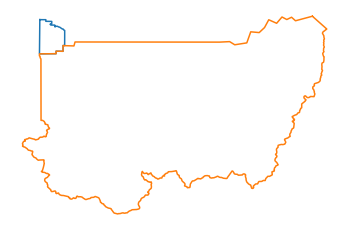

1222. Nodes 499 and 212 are connected


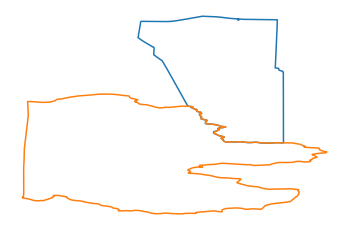

1223. Nodes 499 and 484 are connected


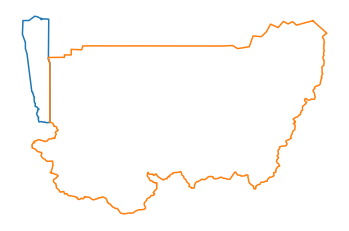

1224. Nodes 499 and 496 are connected


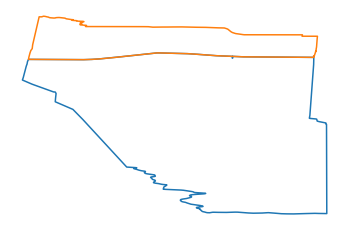

1225. Nodes 500 and 208 are connected


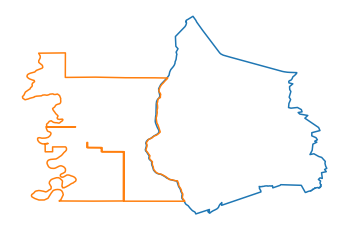

1226. Nodes 500 and 209 are connected


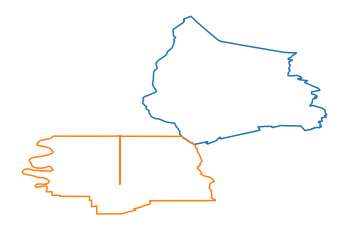

1227. Nodes 501 and 411 are connected


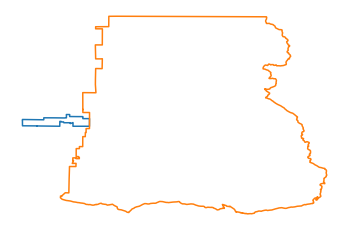

1228. Nodes 501 and 441 are connected


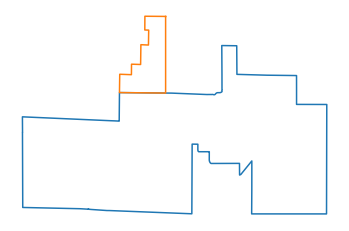

1229. Nodes 501 and 491 are connected


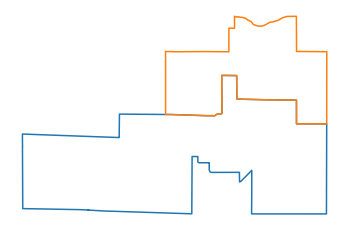

1230. Nodes 501 and 493 are connected


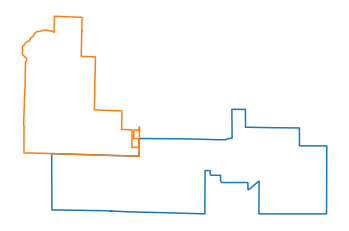

1231. Nodes 501 and 495 are connected


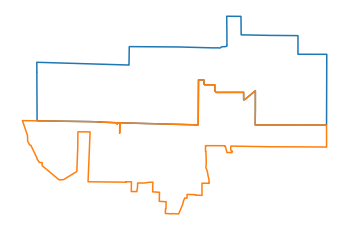

1232. Nodes 502 and 410 are connected


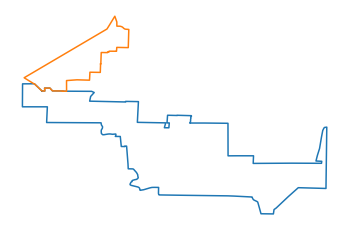

1233. Nodes 502 and 411 are connected


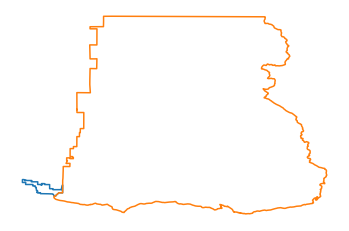

1234. Nodes 502 and 417 are connected


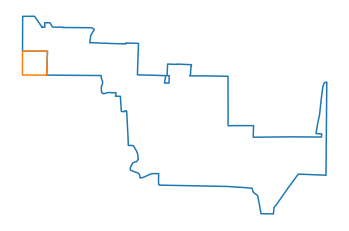

1235. Nodes 502 and 439 are connected


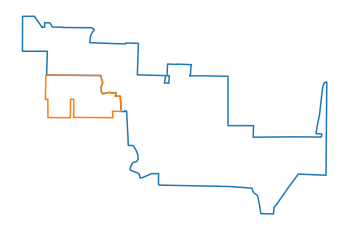

1236. Nodes 502 and 440 are connected


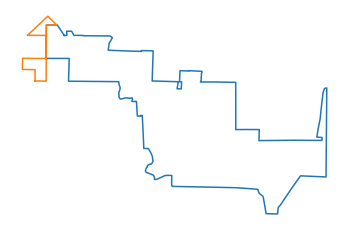

1237. Nodes 502 and 446 are connected


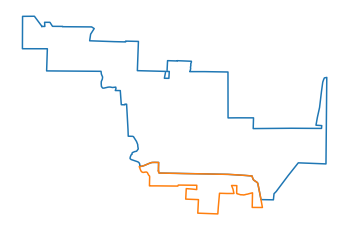

1238. Nodes 502 and 463 are connected


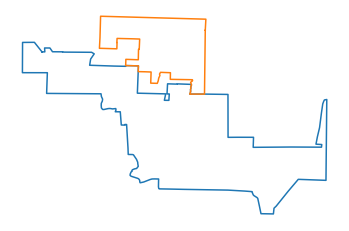

1239. Nodes 502 and 466 are connected


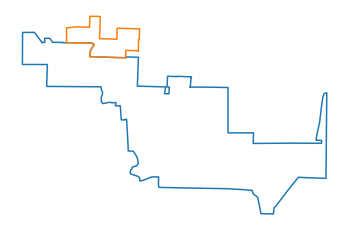

1240. Nodes 502 and 474 are connected


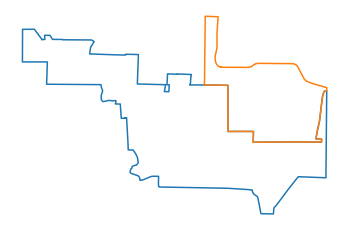

1241. Nodes 502 and 486 are connected


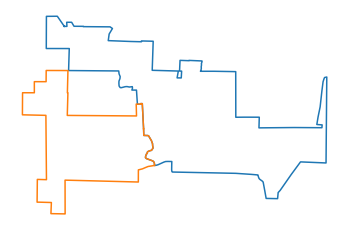

1242. Nodes 503 and 411 are connected


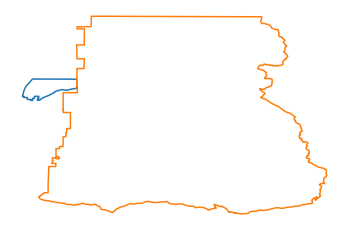

1243. Nodes 503 and 470 are connected


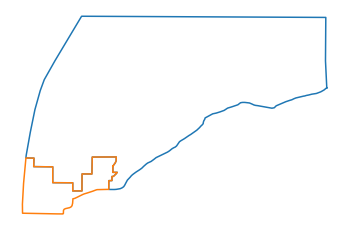

1244. Nodes 503 and 471 are connected


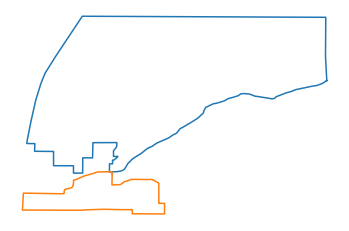

1245. Nodes 503 and 494 are connected


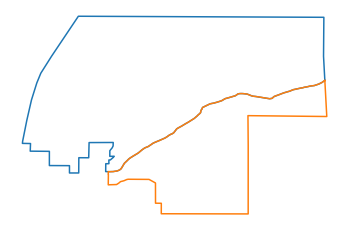

1246. Nodes 504 and 456 are connected


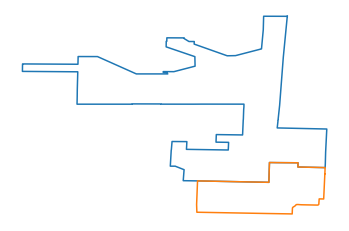

1247. Nodes 504 and 467 are connected


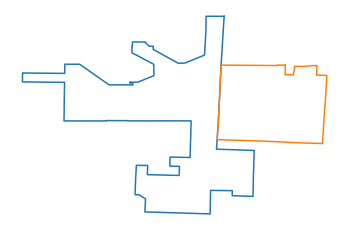

1248. Nodes 504 and 478 are connected


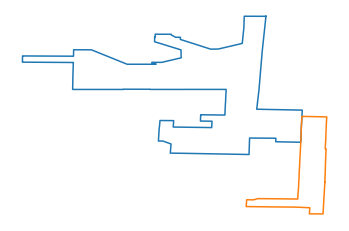

1249. Nodes 504 and 479 are connected


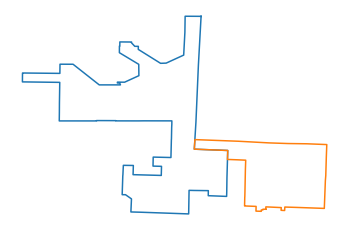

1250. Nodes 504 and 495 are connected


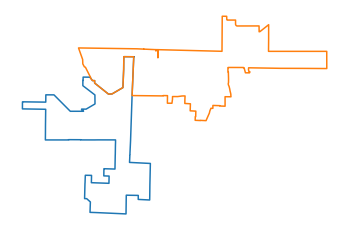

1251. Nodes 505 and 465 are connected


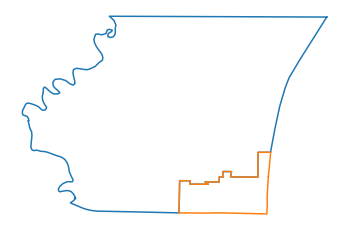

1252. Nodes 505 and 503 are connected


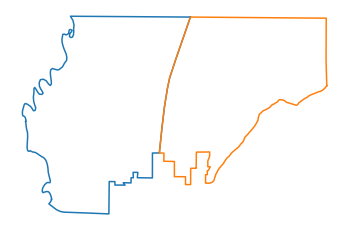

1253. Nodes 506 and 472 are connected


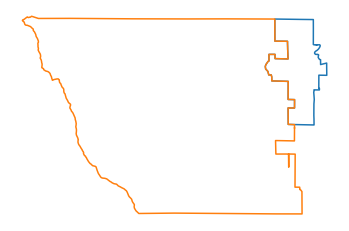

1254. Nodes 507 and 460 are connected


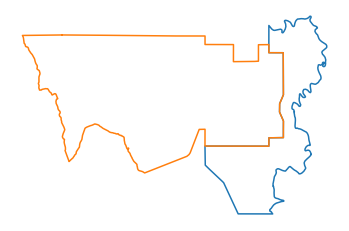

1255. Nodes 507 and 505 are connected


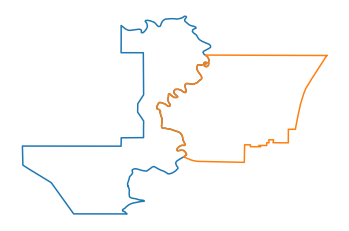

1256. Nodes 508 and 499 are connected


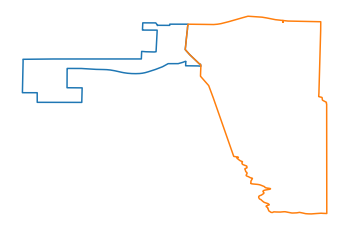

1257. Nodes 509 and 460 are connected


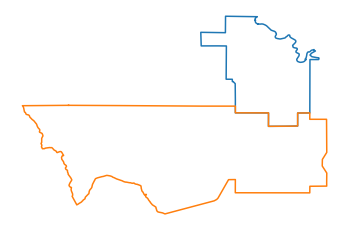

1258. Nodes 509 and 472 are connected


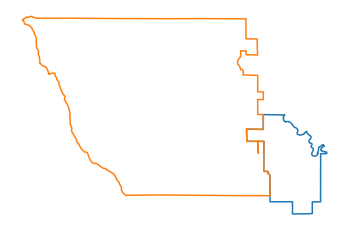

1259. Nodes 509 and 506 are connected


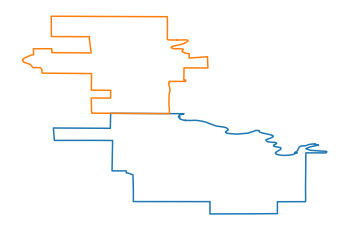

1260. Nodes 509 and 507 are connected


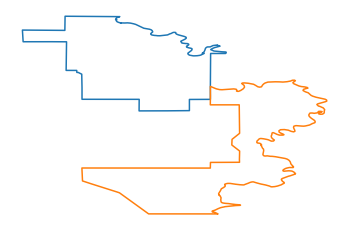

1261. Nodes 510 and 209 are connected


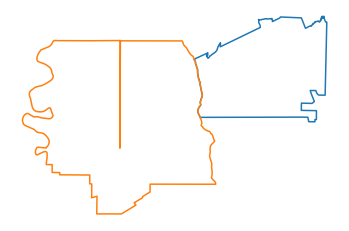

1262. Nodes 510 and 444 are connected


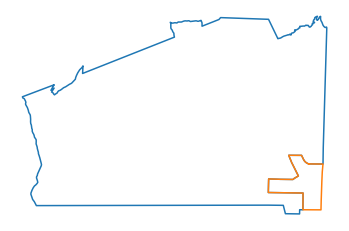

1263. Nodes 510 and 496 are connected


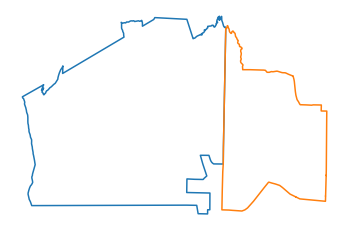

1264. Nodes 510 and 500 are connected


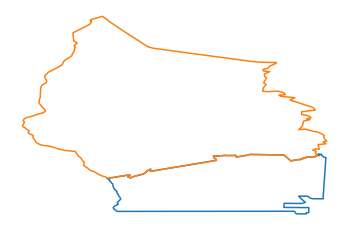

1265. Nodes 510 and 508 are connected


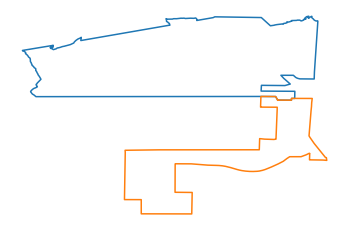

1266. Nodes 511 and 506 are connected


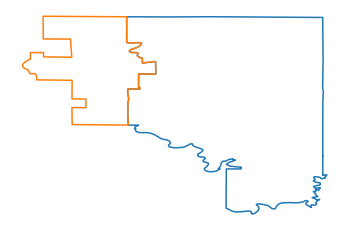

1267. Nodes 511 and 507 are connected


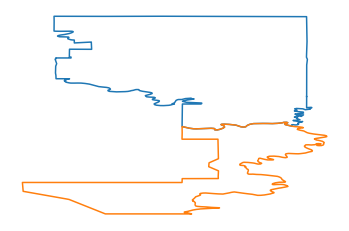

1268. Nodes 511 and 509 are connected


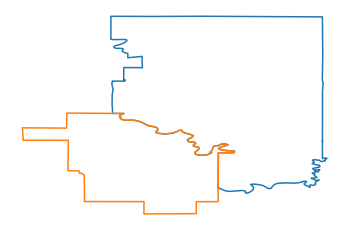

1269. Nodes 512 and 489 are connected


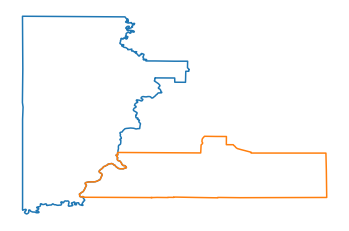

1270. Nodes 512 and 511 are connected


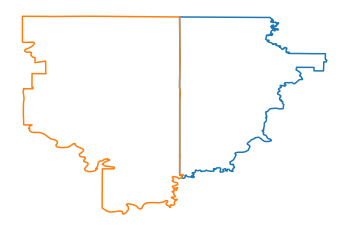

1271. Nodes 513 and 411 are connected


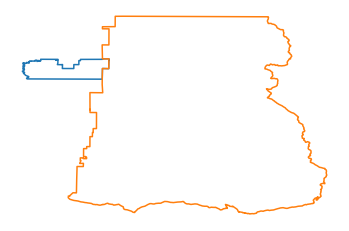

1272. Nodes 513 and 482 are connected


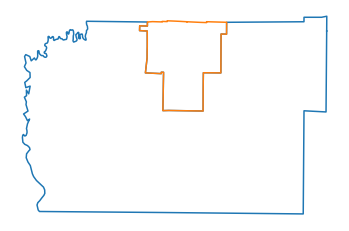

1273. Nodes 513 and 489 are connected


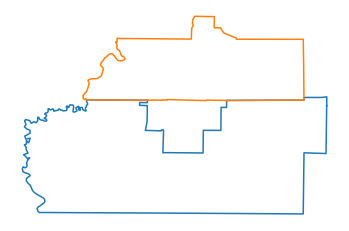

1274. Nodes 513 and 503 are connected


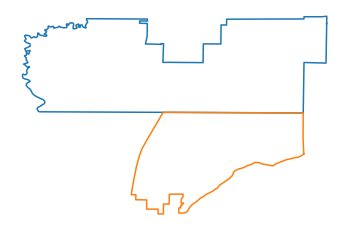

1275. Nodes 513 and 505 are connected


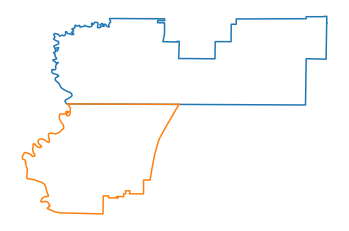

1276. Nodes 513 and 507 are connected


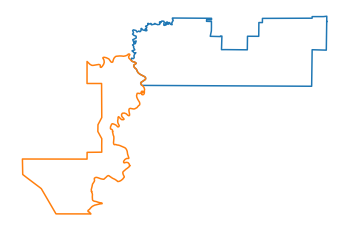

1277. Nodes 513 and 511 are connected


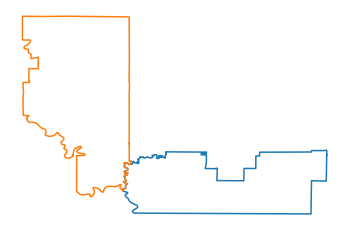

1278. Nodes 513 and 512 are connected


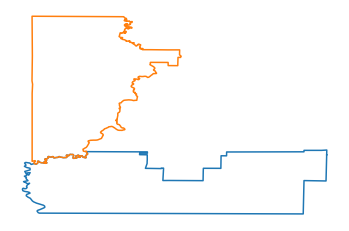

1279. Nodes 514 and 411 are connected


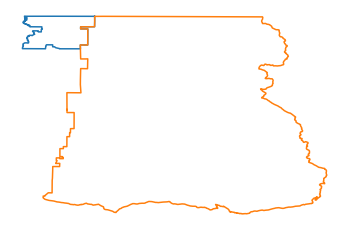

1280. Nodes 514 and 489 are connected


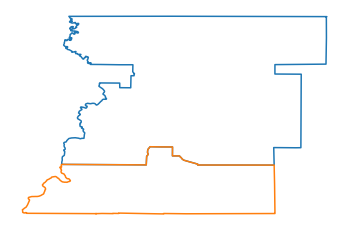

1281. Nodes 514 and 512 are connected


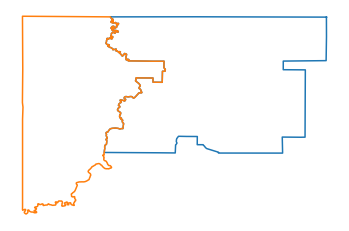

1282. Nodes 515 and 415 are connected


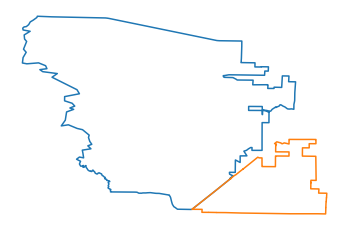

1283. Nodes 515 and 420 are connected


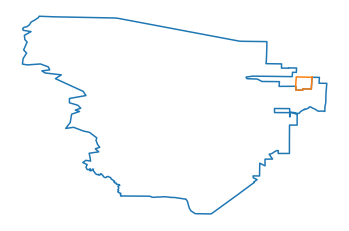

1284. Nodes 515 and 422 are connected


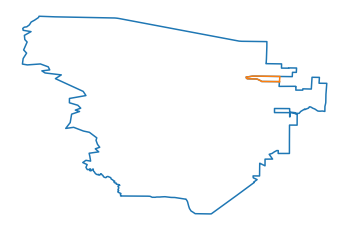

1285. Nodes 515 and 452 are connected


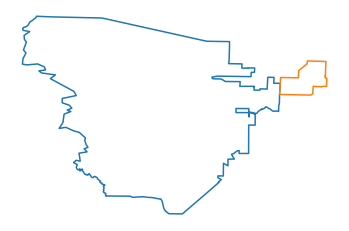

1286. Nodes 515 and 483 are connected


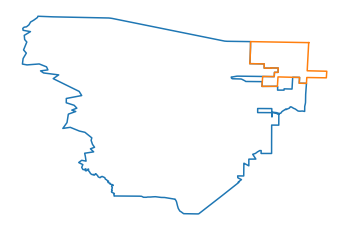

1287. Nodes 515 and 487 are connected


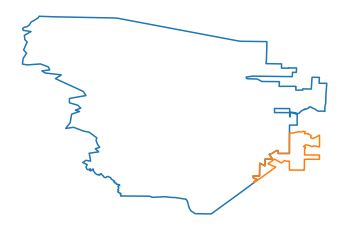

1288. Nodes 515 and 488 are connected


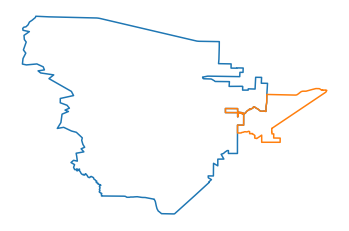

1289. Nodes 515 and 490 are connected


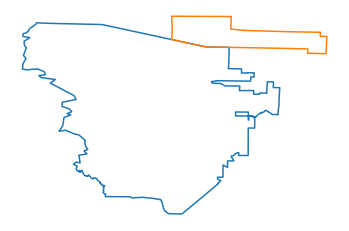

1290. Nodes 515 and 496 are connected


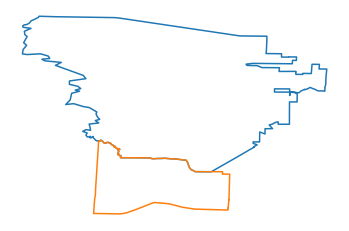

1291. Nodes 515 and 500 are connected


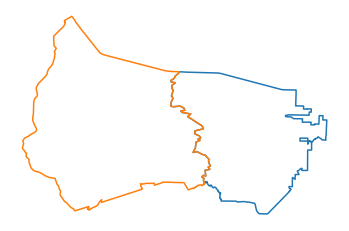

1292. Nodes 515 and 510 are connected


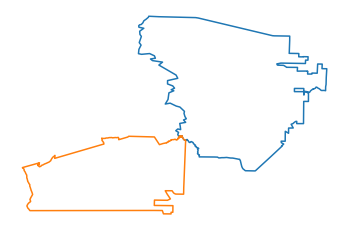

1293. Nodes 516 and 209 are connected


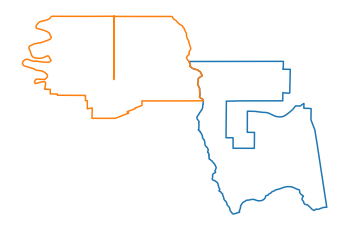

1294. Nodes 516 and 211 are connected


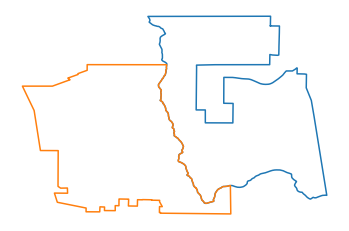

1295. Nodes 516 and 212 are connected


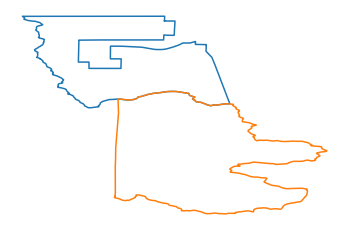

1296. Nodes 516 and 499 are connected


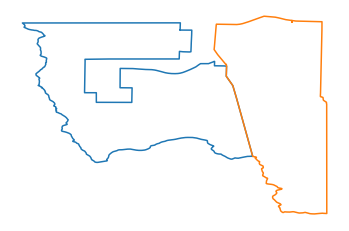

1297. Nodes 516 and 508 are connected


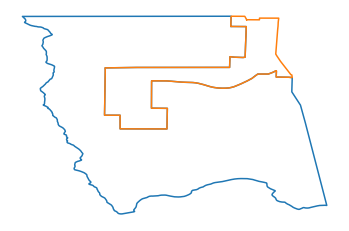

1298. Nodes 516 and 510 are connected


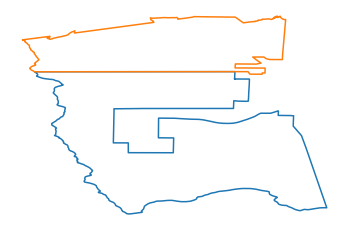

1299. Nodes 517 and 456 are connected


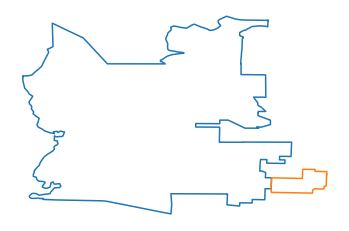

1300. Nodes 517 and 476 are connected


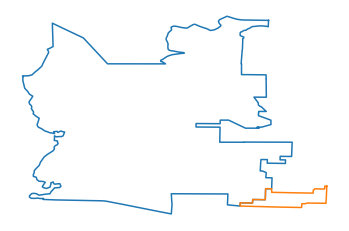

1301. Nodes 517 and 490 are connected


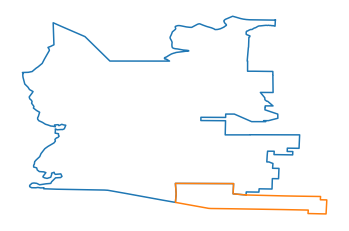

1302. Nodes 517 and 493 are connected


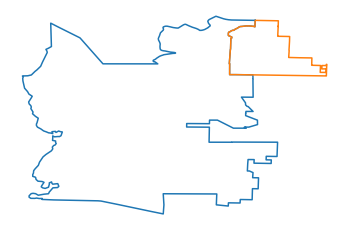

1303. Nodes 517 and 495 are connected


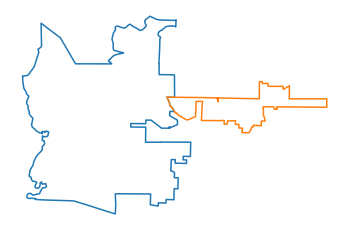

1304. Nodes 517 and 501 are connected


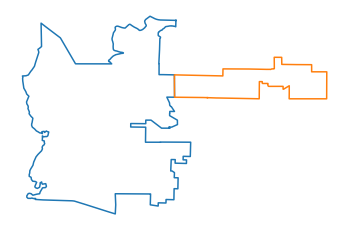

1305. Nodes 517 and 504 are connected


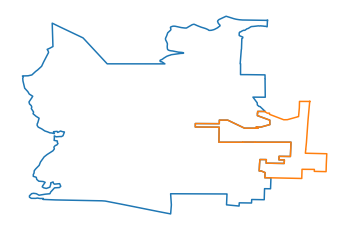

1306. Nodes 517 and 505 are connected


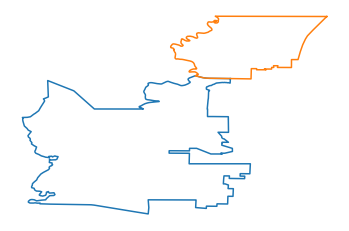

1307. Nodes 517 and 507 are connected


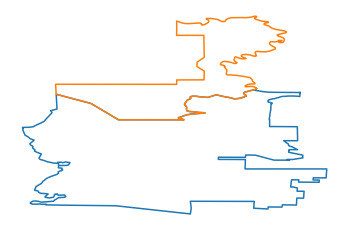

1308. Nodes 517 and 515 are connected


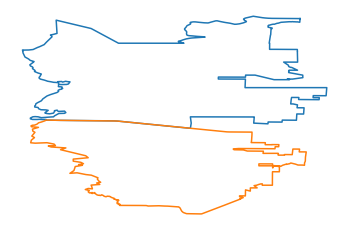

1309. Nodes 518 and 460 are connected


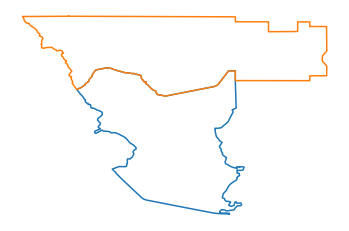

1310. Nodes 518 and 500 are connected


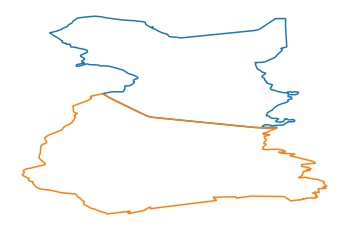

1311. Nodes 518 and 507 are connected


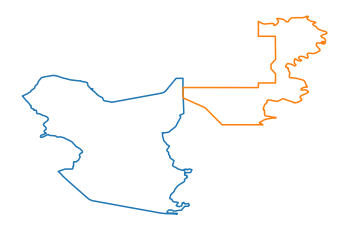

1312. Nodes 518 and 517 are connected


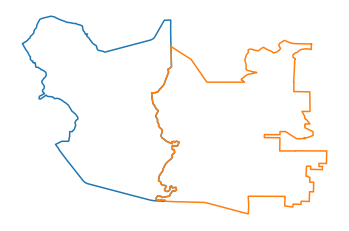

1313. Nodes 522 and 521 are connected


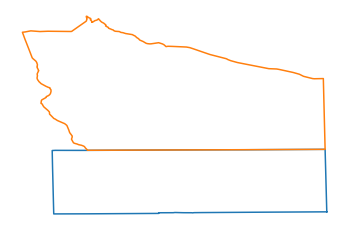

1314. Nodes 525 and 519 are connected


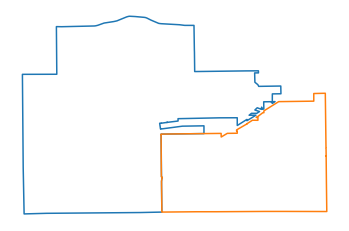

1315. Nodes 526 and 113 are connected


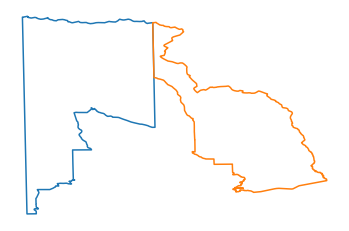

1316. Nodes 526 and 130 are connected


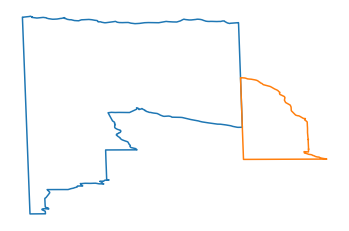

1317. Nodes 526 and 280 are connected


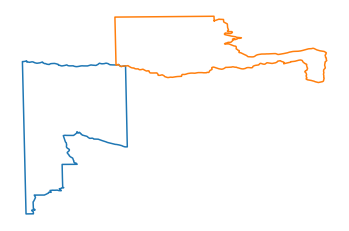

1318. Nodes 526 and 521 are connected


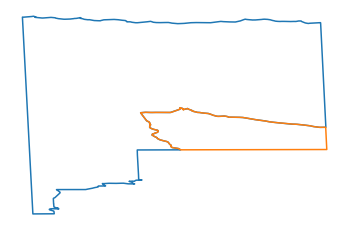

1319. Nodes 526 and 522 are connected


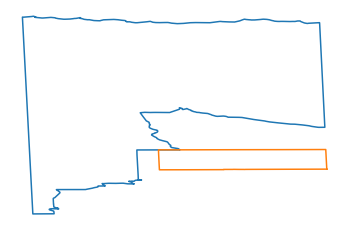

1320. Nodes 527 and 522 are connected


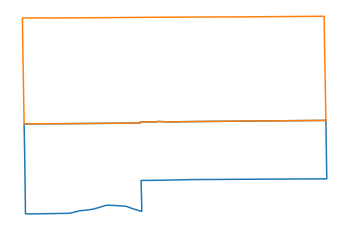

1321. Nodes 527 and 525 are connected


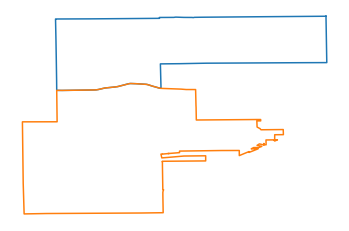

1322. Nodes 529 and 524 are connected


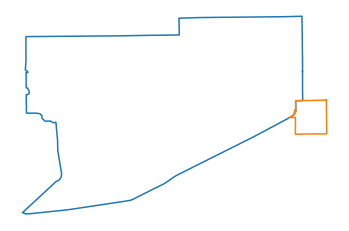

1323. Nodes 529 and 525 are connected


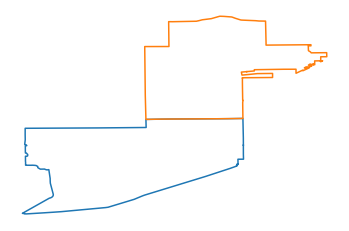

1324. Nodes 530 and 391 are connected


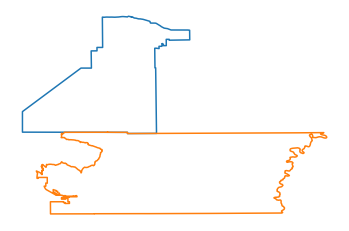

1325. Nodes 530 and 528 are connected


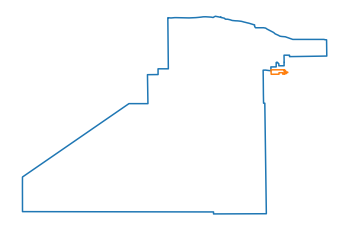

1326. Nodes 531 and 108 are connected


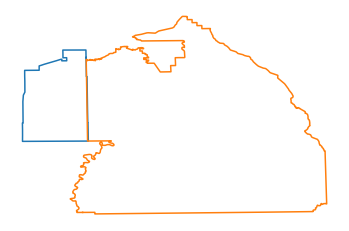

1327. Nodes 531 and 391 are connected


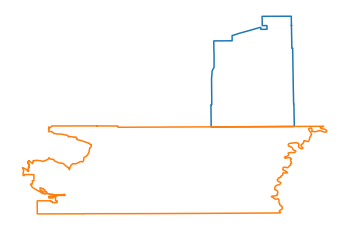

1328. Nodes 531 and 519 are connected


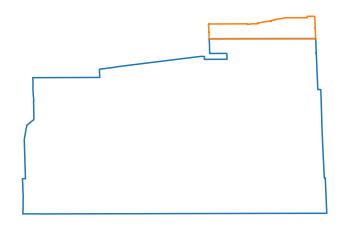

1329. Nodes 531 and 524 are connected


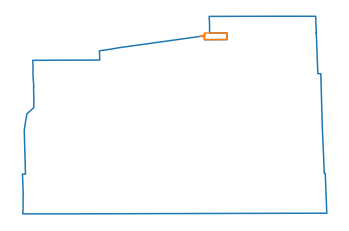

1330. Nodes 531 and 529 are connected


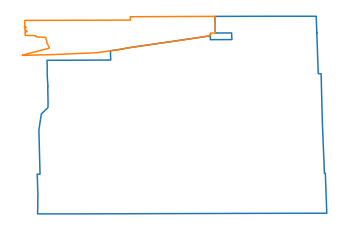

1331. Nodes 532 and 523 are connected


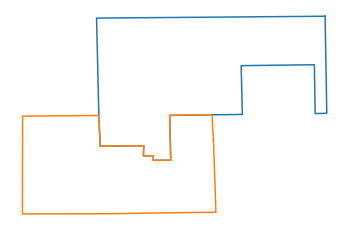

1332. Nodes 533 and 523 are connected


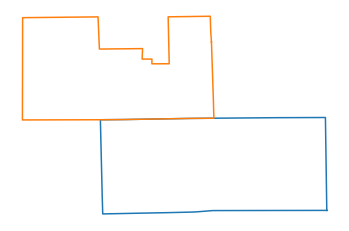

1333. Nodes 534 and 391 are connected


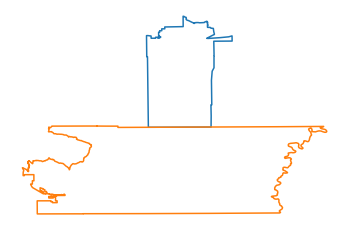

1334. Nodes 534 and 528 are connected


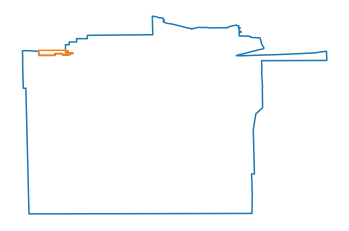

1335. Nodes 534 and 529 are connected


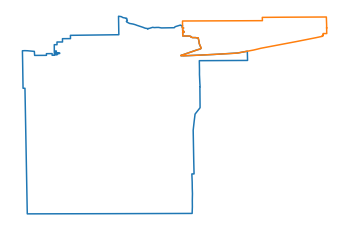

1336. Nodes 534 and 530 are connected


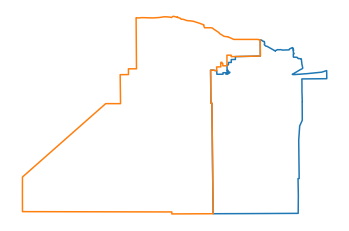

1337. Nodes 534 and 531 are connected


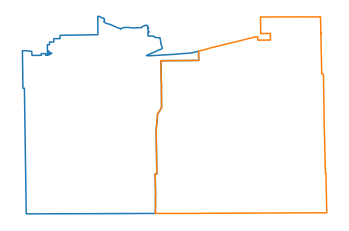

1338. Nodes 535 and 520 are connected


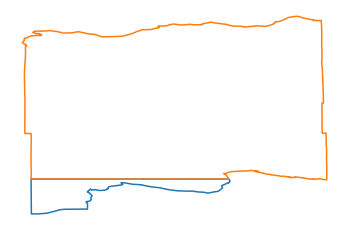

1339. Nodes 536 and 523 are connected


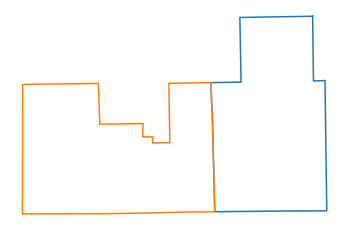

1340. Nodes 536 and 532 are connected


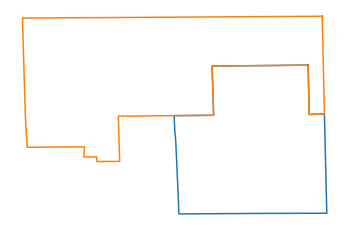

1341. Nodes 536 and 533 are connected


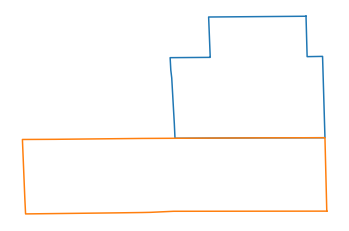

1342. Nodes 537 and 529 are connected


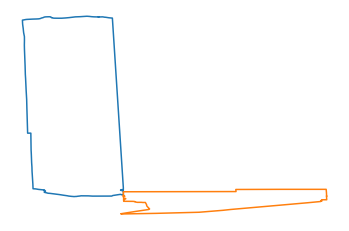

1343. Nodes 537 and 534 are connected


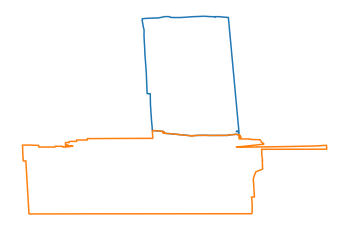

1344. Nodes 538 and 520 are connected


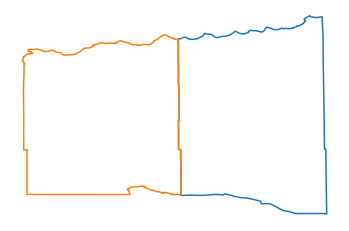

1345. Nodes 538 and 530 are connected


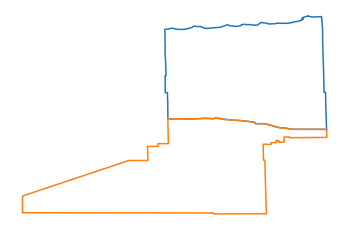

1346. Nodes 538 and 537 are connected


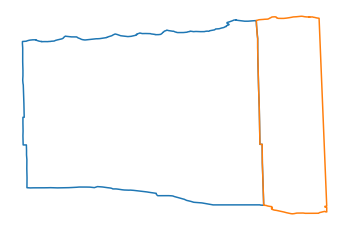

1347. Nodes 539 and 525 are connected


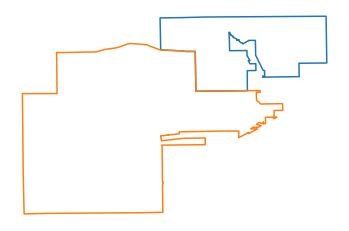

1348. Nodes 539 and 527 are connected


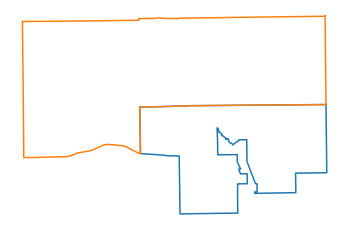

1349. Nodes 539 and 532 are connected


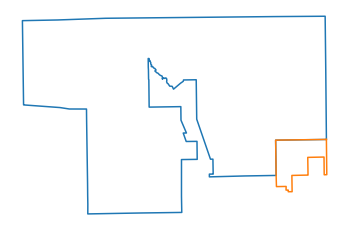

1350. Nodes 540 and 528 are connected


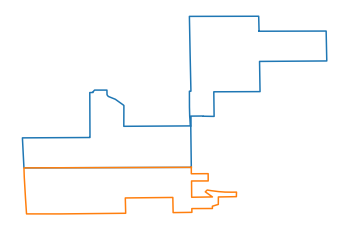

1351. Nodes 540 and 530 are connected


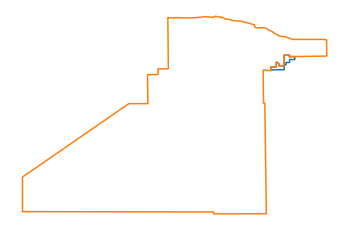

1352. Nodes 540 and 534 are connected


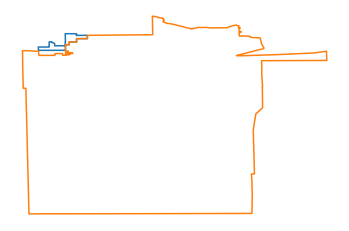

1353. Nodes 541 and 519 are connected


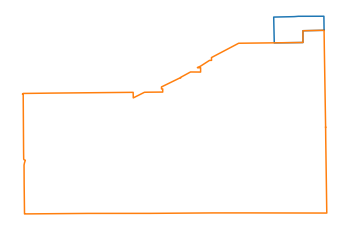

1354. Nodes 541 and 533 are connected


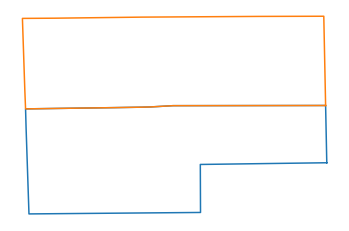

1355. Nodes 542 and 525 are connected


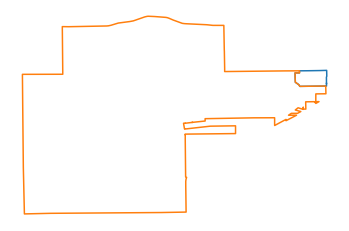

1356. Nodes 543 and 522 are connected


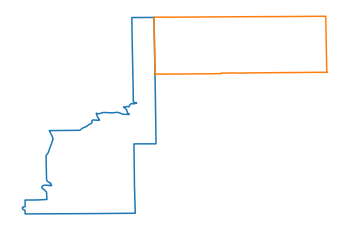

1357. Nodes 543 and 525 are connected


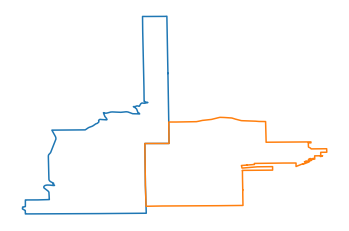

1358. Nodes 543 and 526 are connected


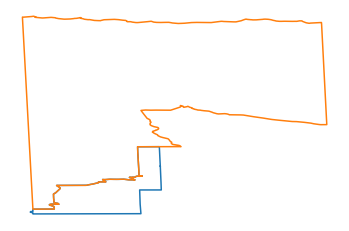

1359. Nodes 543 and 527 are connected


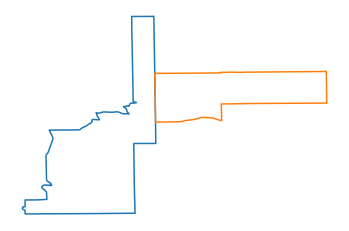

1360. Nodes 543 and 529 are connected


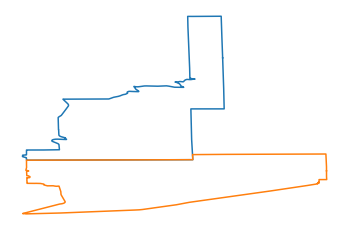

1361. Nodes 543 and 537 are connected


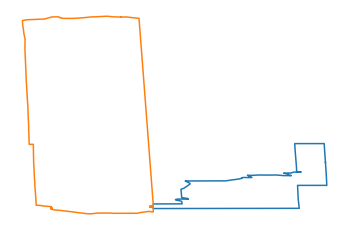

1362. Nodes 544 and 520 are connected


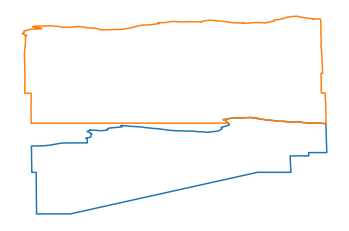

1363. Nodes 544 and 530 are connected


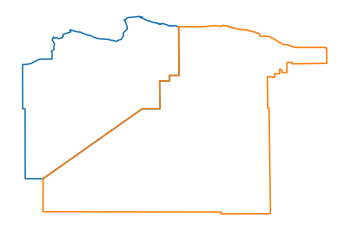

1364. Nodes 544 and 535 are connected


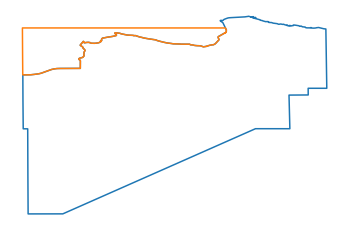

1365. Nodes 545 and 523 are connected


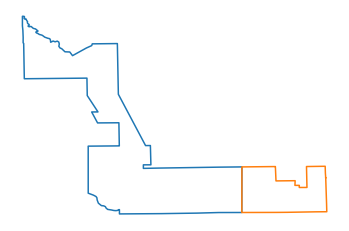

1366. Nodes 545 and 525 are connected


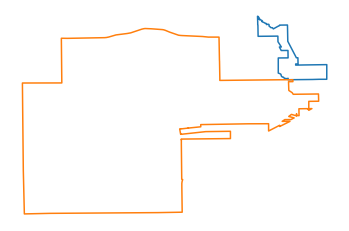

1367. Nodes 545 and 539 are connected


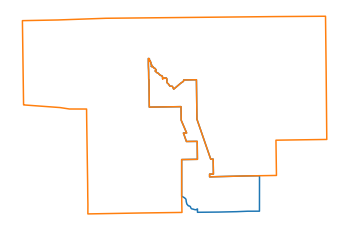

1368. Nodes 545 and 542 are connected


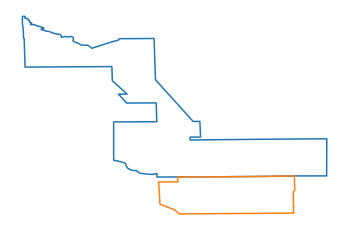

1369. Nodes 546 and 525 are connected


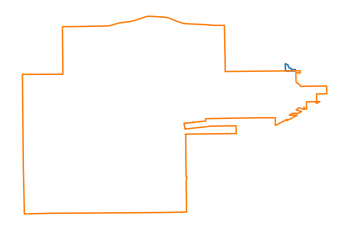

1370. Nodes 546 and 539 are connected


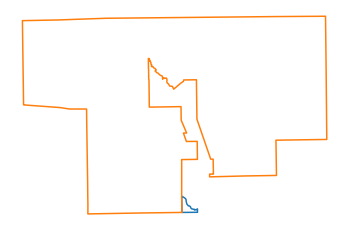

1371. Nodes 546 and 545 are connected


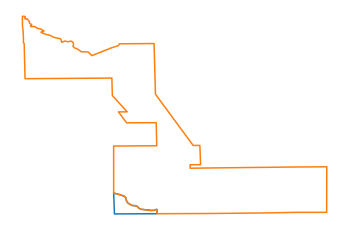

1372. Nodes 547 and 519 are connected


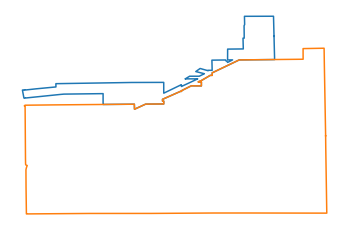

1373. Nodes 547 and 523 are connected


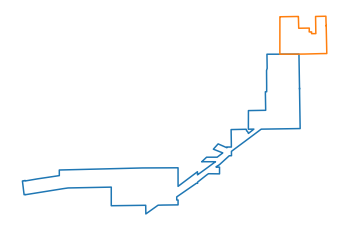

1374. Nodes 547 and 525 are connected


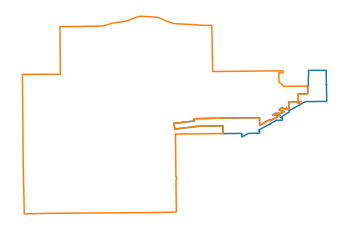

1375. Nodes 547 and 533 are connected


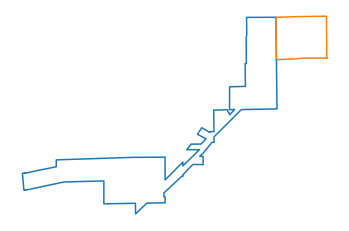

1376. Nodes 547 and 541 are connected


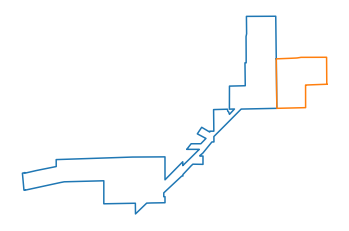

1377. Nodes 547 and 542 are connected


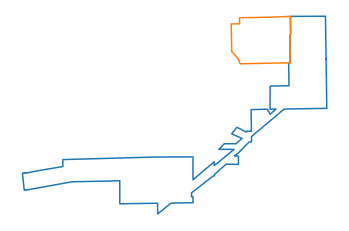

1378. Nodes 547 and 545 are connected


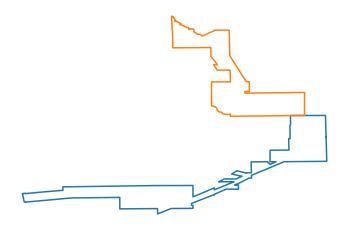

1379. Nodes 548 and 177 are connected


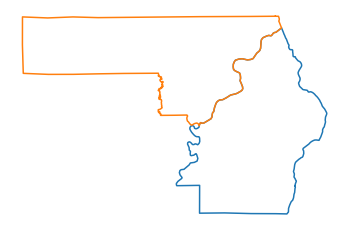

1380. Nodes 548 and 197 are connected


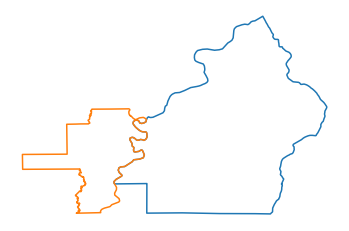

1381. Nodes 548 and 208 are connected


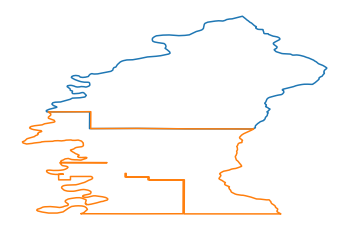

1382. Nodes 548 and 460 are connected


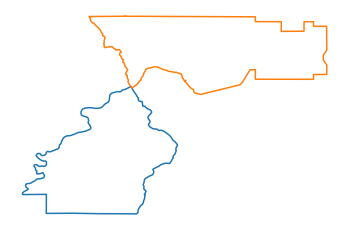

1383. Nodes 548 and 500 are connected


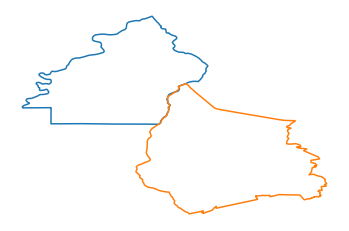

1384. Nodes 548 and 518 are connected


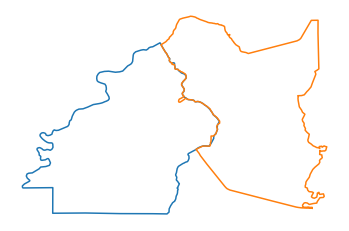

1385. Nodes 549 and 463 are connected


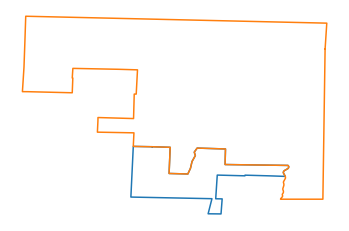

1386. Nodes 549 and 502 are connected


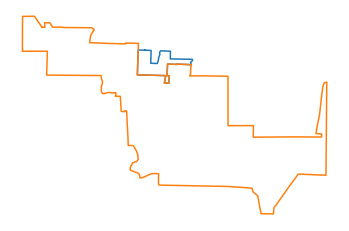

1387. Nodes 555 and 551 are connected


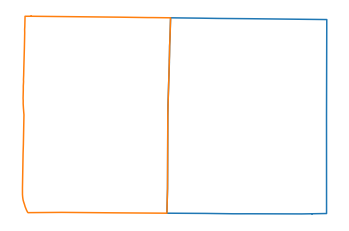

1388. Nodes 555 and 553 are connected


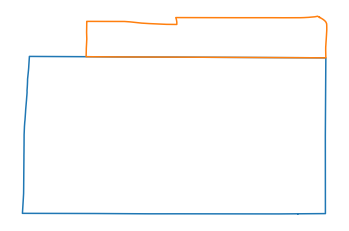

1389. Nodes 555 and 554 are connected


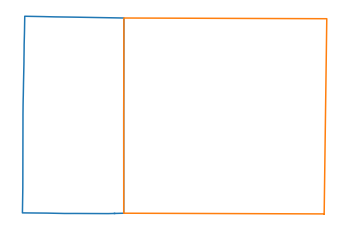

1390. Nodes 557 and 551 are connected


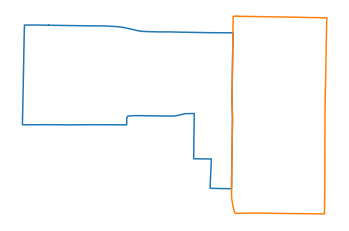

1391. Nodes 558 and 551 are connected


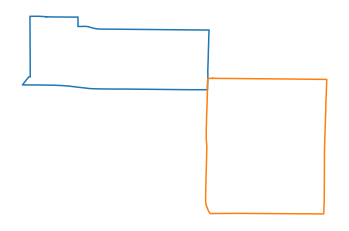

1392. Nodes 558 and 557 are connected


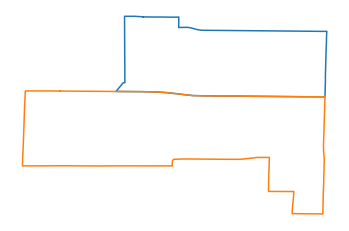

1393. Nodes 559 and 553 are connected


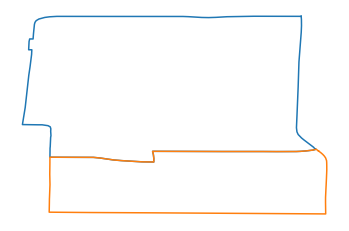

1394. Nodes 560 and 553 are connected


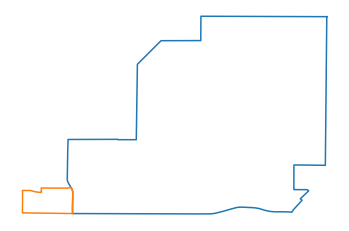

1395. Nodes 560 and 554 are connected


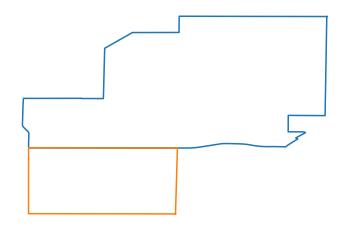

1396. Nodes 560 and 559 are connected


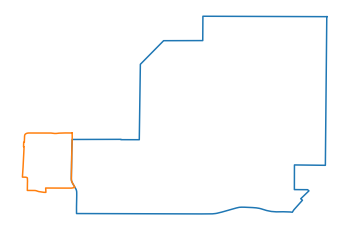

1397. Nodes 561 and 552 are connected


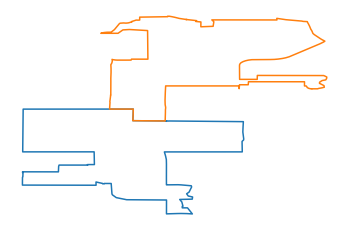

1398. Nodes 564 and 552 are connected


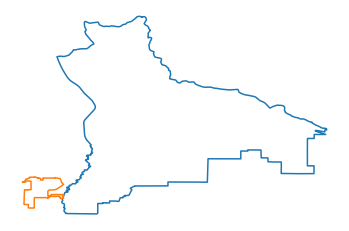

1399. Nodes 564 and 557 are connected


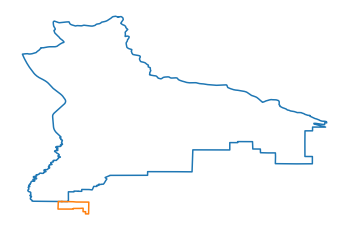

1400. Nodes 564 and 558 are connected


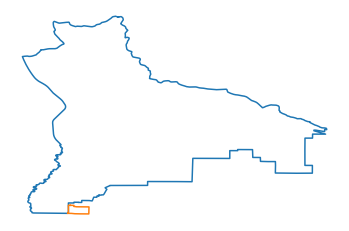

1401. Nodes 564 and 560 are connected


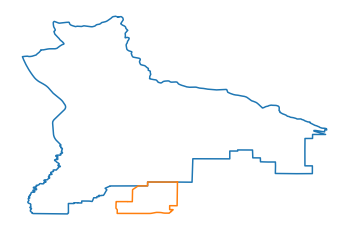

1402. Nodes 565 and 559 are connected


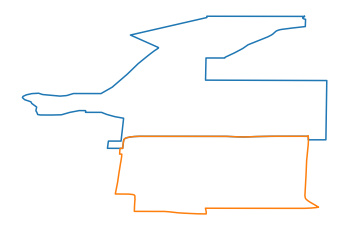

1403. Nodes 565 and 564 are connected


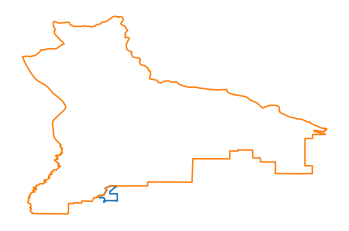

1404. Nodes 566 and 550 are connected


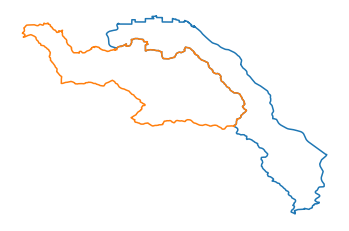

1405. Nodes 566 and 562 are connected


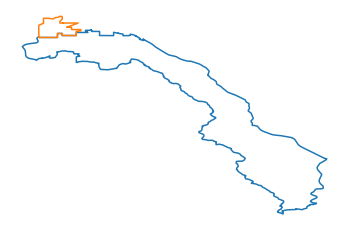

1406. Nodes 566 and 563 are connected


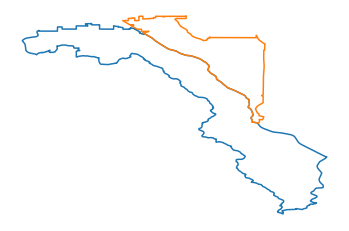

1407. Nodes 567 and 562 are connected


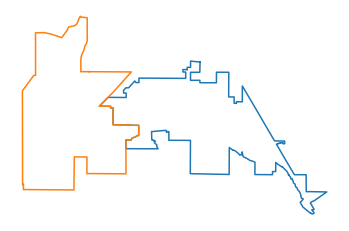

1408. Nodes 567 and 563 are connected


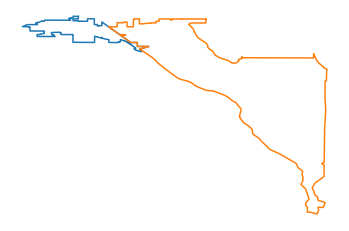

1409. Nodes 567 and 566 are connected


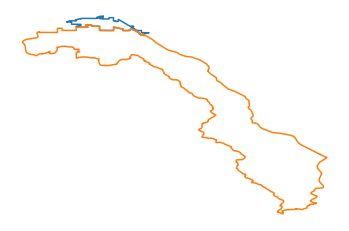

1410. Nodes 569 and 552 are connected


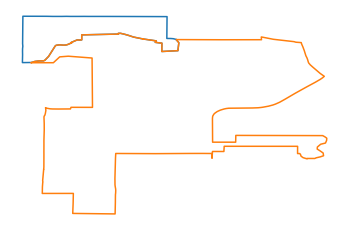

1411. Nodes 570 and 552 are connected


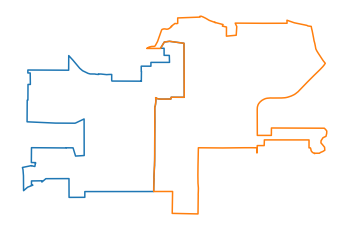

1412. Nodes 570 and 561 are connected


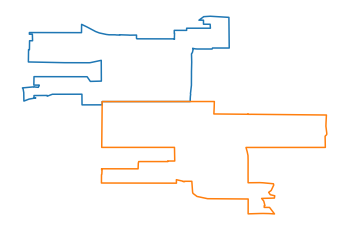

1413. Nodes 571 and 552 are connected


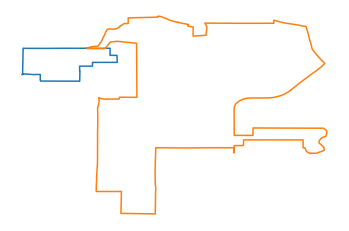

1414. Nodes 571 and 569 are connected


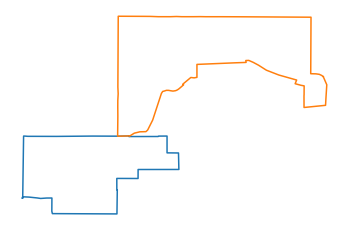

1415. Nodes 571 and 570 are connected


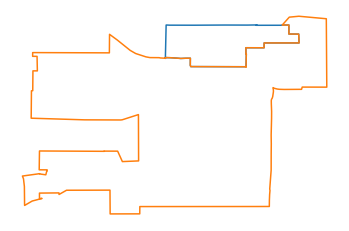

1416. Nodes 572 and 570 are connected


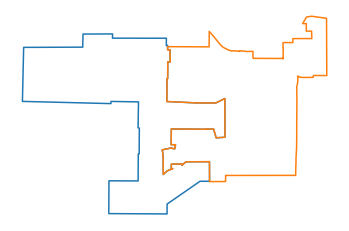

1417. Nodes 573 and 561 are connected


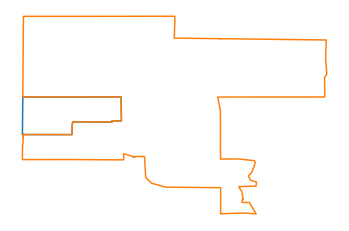

1418. Nodes 574 and 561 are connected


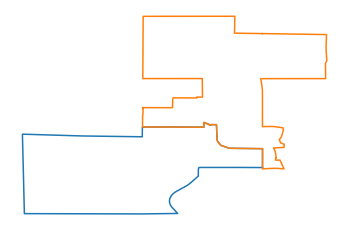

1419. Nodes 575 and 561 are connected


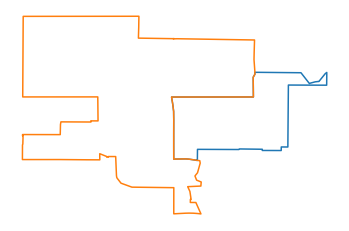

1420. Nodes 577 and 552 are connected


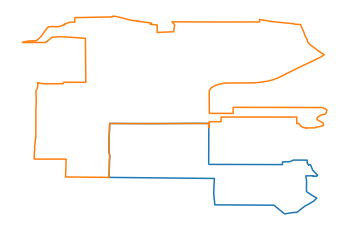

1421. Nodes 577 and 561 are connected


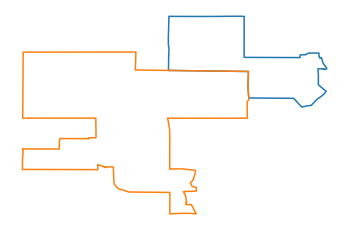

1422. Nodes 577 and 575 are connected


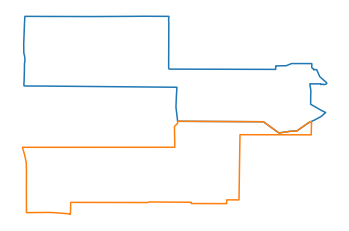

1423. Nodes 577 and 576 are connected


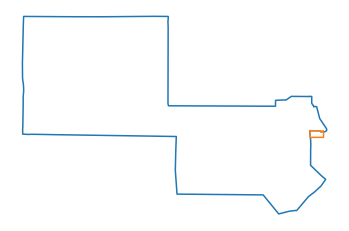

1424. Nodes 578 and 552 are connected


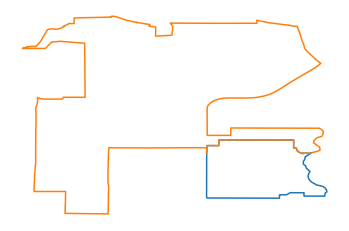

1425. Nodes 578 and 564 are connected


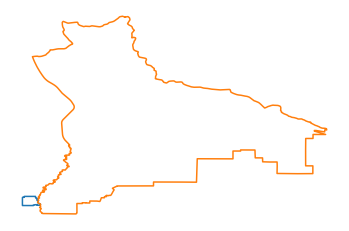

1426. Nodes 578 and 577 are connected


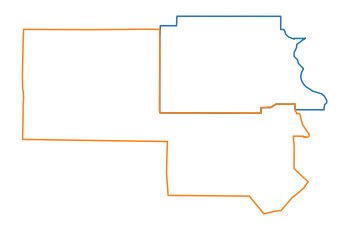

1427. Nodes 579 and 564 are connected


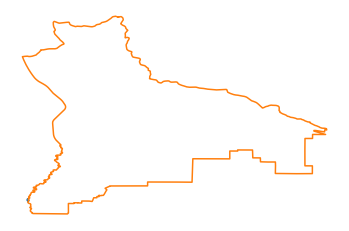

1428. Nodes 579 and 578 are connected


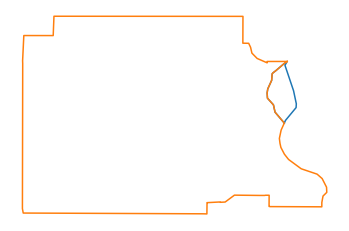

1429. Nodes 580 and 552 are connected


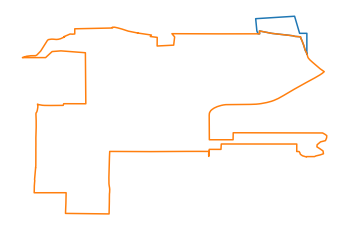

1430. Nodes 581 and 564 are connected


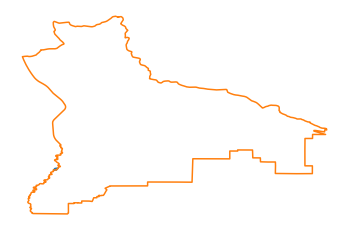

1431. Nodes 582 and 564 are connected


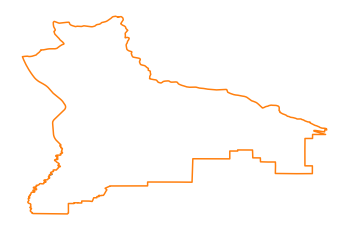

1432. Nodes 583 and 564 are connected


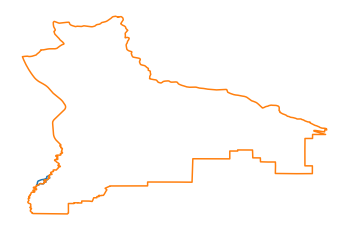

1433. Nodes 584 and 552 are connected


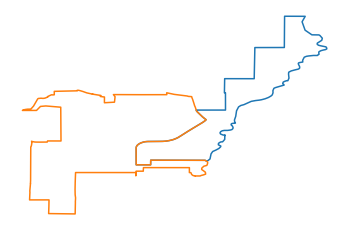

1434. Nodes 584 and 564 are connected


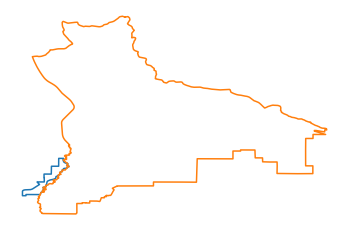

1435. Nodes 584 and 581 are connected


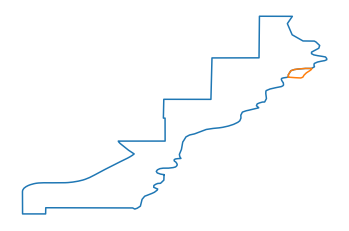

1436. Nodes 584 and 582 are connected


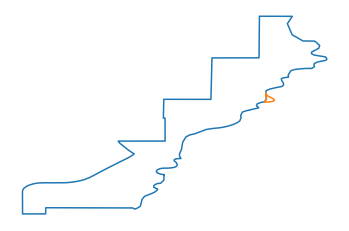

1437. Nodes 584 and 583 are connected


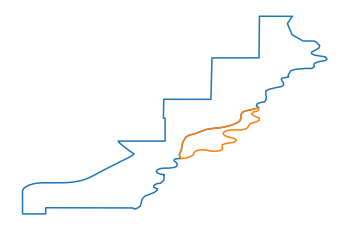

1438. Nodes 585 and 564 are connected


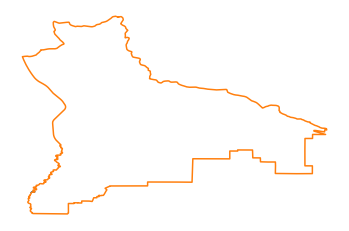

1439. Nodes 585 and 584 are connected


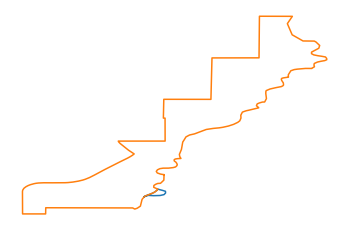

1440. Nodes 586 and 564 are connected


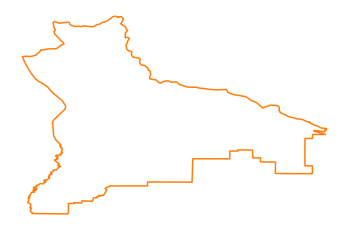

1441. Nodes 586 and 584 are connected


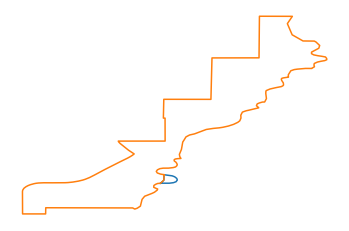

1442. Nodes 587 and 563 are connected


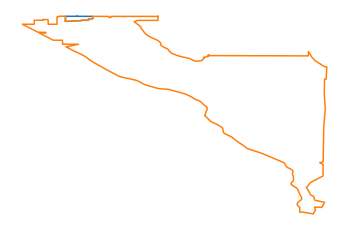

1443. Nodes 588 and 563 are connected


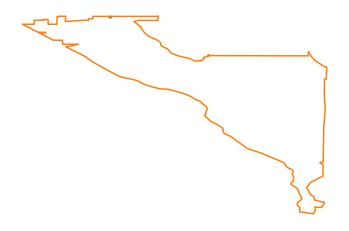

1444. Nodes 589 and 563 are connected


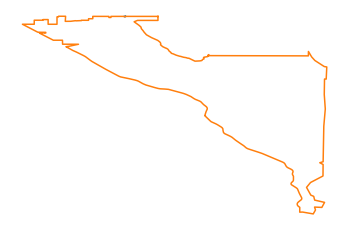

1445. Nodes 590 and 558 are connected


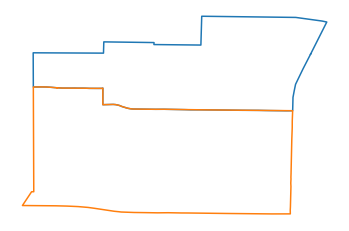

1446. Nodes 590 and 564 are connected


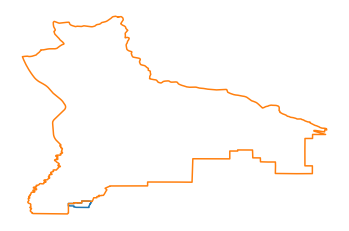

1447. Nodes 591 and 551 are connected


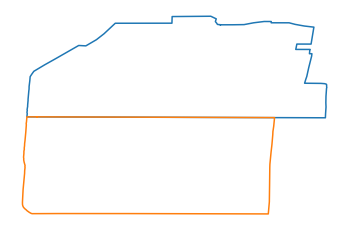

1448. Nodes 591 and 553 are connected


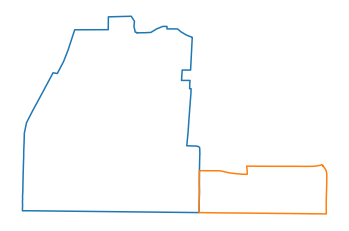

1449. Nodes 591 and 555 are connected


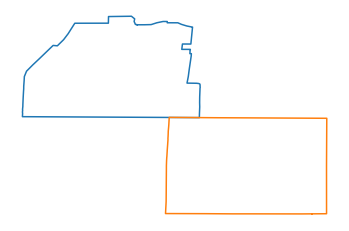

1450. Nodes 591 and 558 are connected


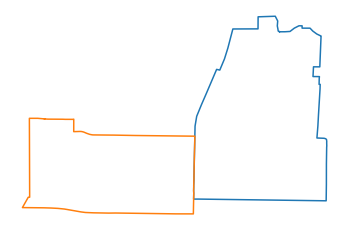

1451. Nodes 591 and 559 are connected


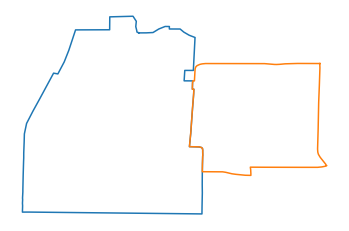

1452. Nodes 591 and 564 are connected


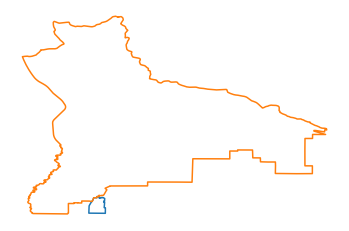

1453. Nodes 591 and 565 are connected


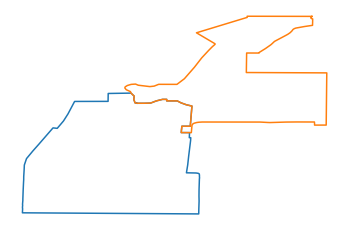

1454. Nodes 591 and 590 are connected


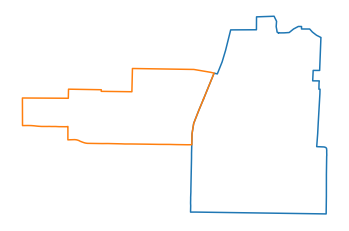

1455. Nodes 592 and 556 are connected


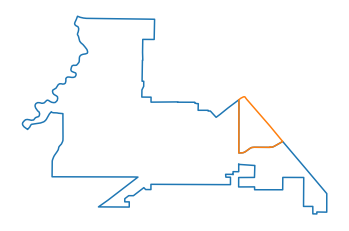

1456. Nodes 592 and 557 are connected


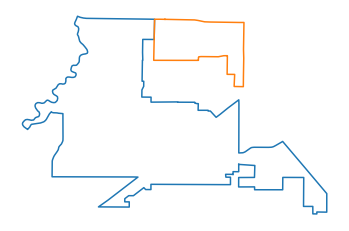

1457. Nodes 592 and 562 are connected


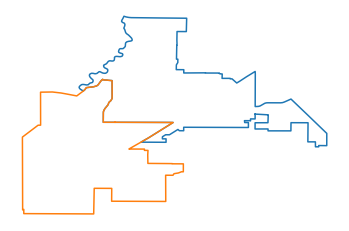

1458. Nodes 592 and 564 are connected


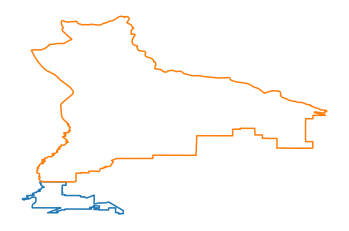

1459. Nodes 592 and 567 are connected


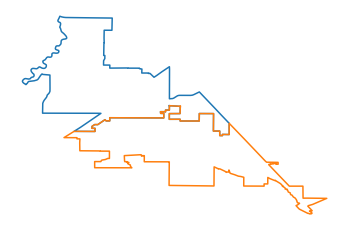

1460. Nodes 593 and 592 are connected


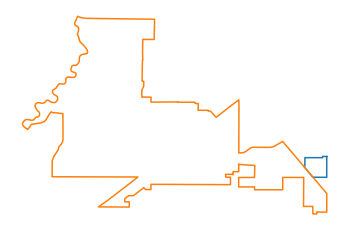

1461. Nodes 594 and 551 are connected


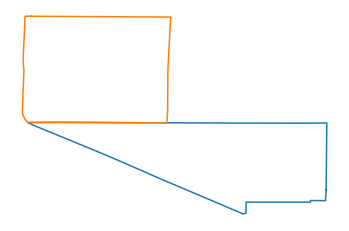

1462. Nodes 594 and 555 are connected


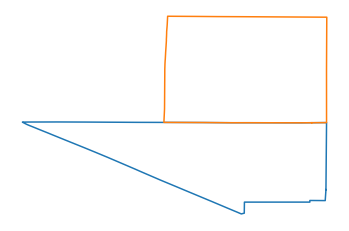

1463. Nodes 594 and 556 are connected


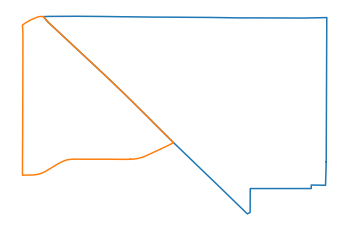

1464. Nodes 594 and 592 are connected


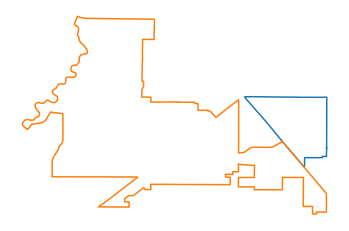

1465. Nodes 594 and 593 are connected


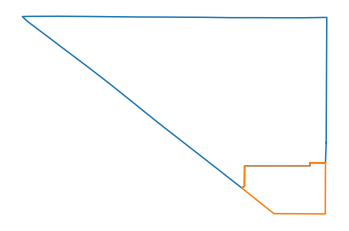

1466. Nodes 595 and 554 are connected


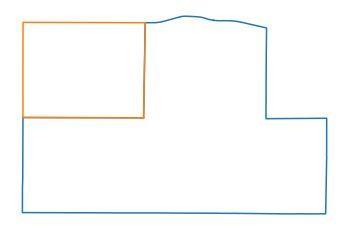

1467. Nodes 595 and 560 are connected


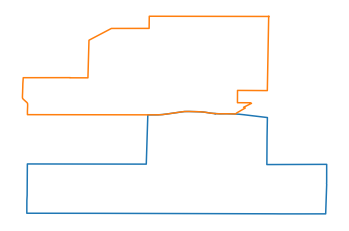

1468. Nodes 595 and 563 are connected


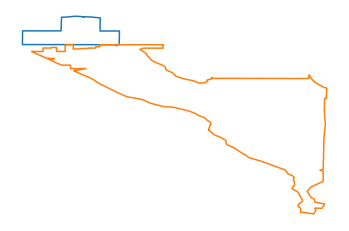

1469. Nodes 595 and 587 are connected


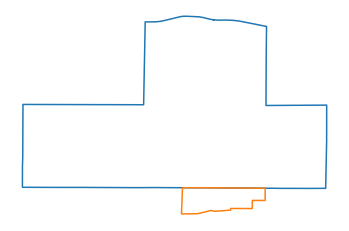

1470. Nodes 595 and 588 are connected


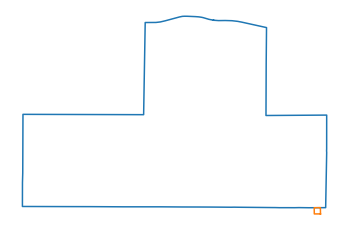

1471. Nodes 595 and 593 are connected


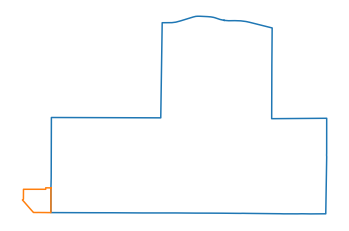

1472. Nodes 595 and 594 are connected


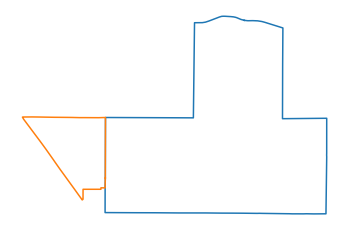

1473. Nodes 596 and 563 are connected


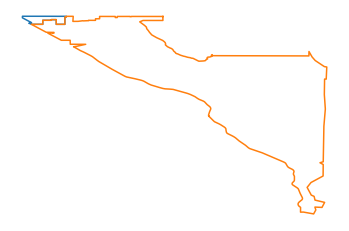

1474. Nodes 596 and 567 are connected


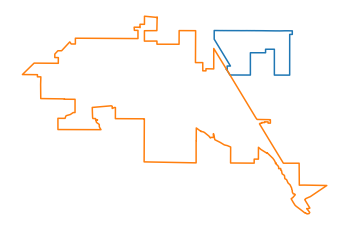

1475. Nodes 596 and 595 are connected


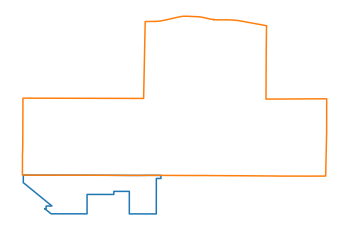

1476. Nodes 597 and 567 are connected


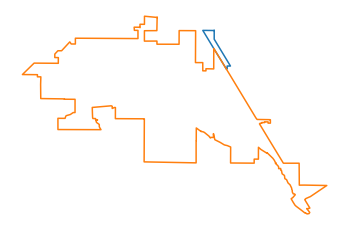

1477. Nodes 597 and 592 are connected


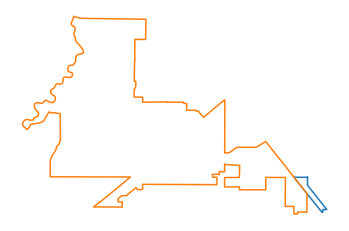

1478. Nodes 597 and 593 are connected


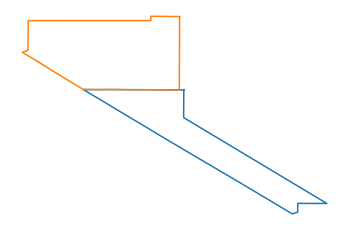

1479. Nodes 597 and 595 are connected


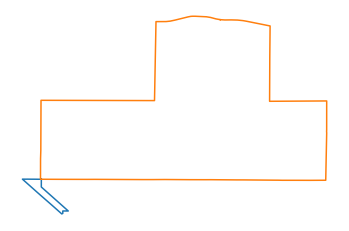

1480. Nodes 597 and 596 are connected


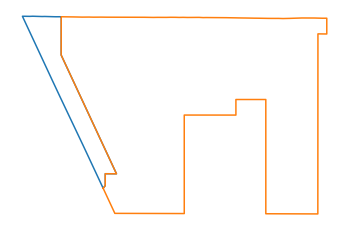

1481. Nodes 598 and 559 are connected


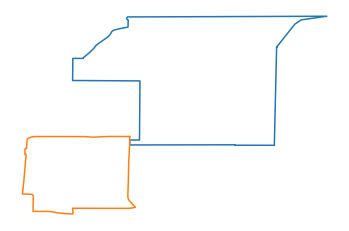

1482. Nodes 598 and 560 are connected


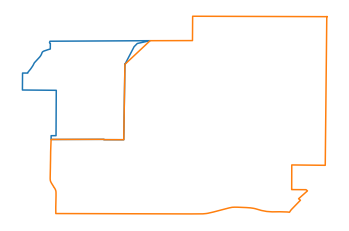

1483. Nodes 598 and 564 are connected


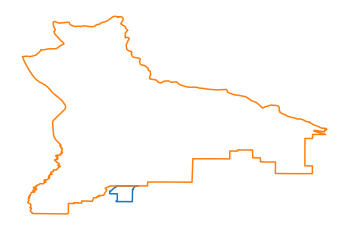

1484. Nodes 598 and 565 are connected


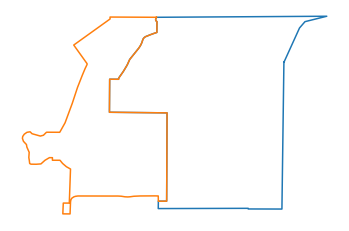

1485. Nodes 599 and 560 are connected


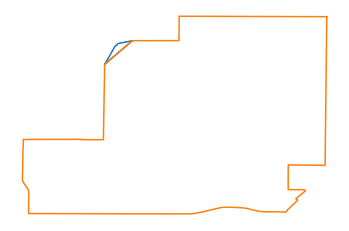

1486. Nodes 599 and 598 are connected


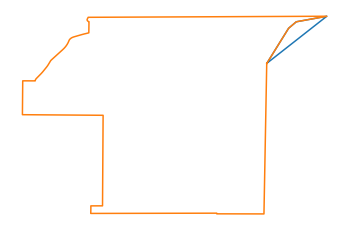

1487. Nodes 600 and 557 are connected


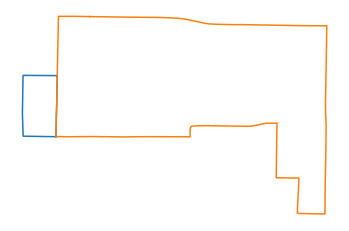

1488. Nodes 600 and 592 are connected


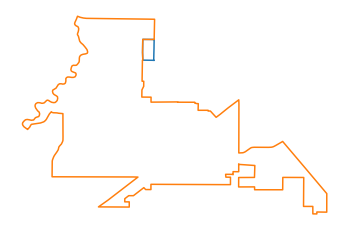

1489. Nodes 601 and 551 are connected


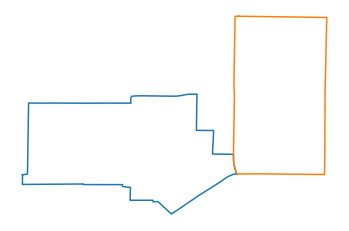

1490. Nodes 601 and 556 are connected


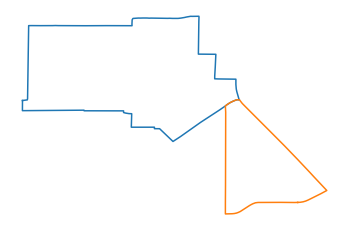

1491. Nodes 601 and 557 are connected


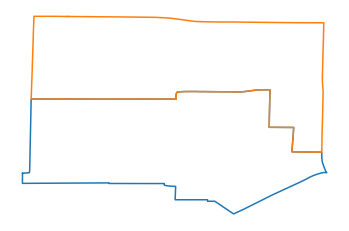

1492. Nodes 601 and 592 are connected


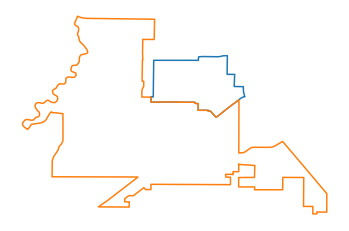

1493. Nodes 602 and 592 are connected


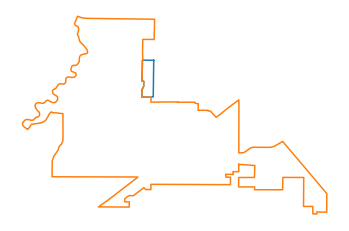

1494. Nodes 602 and 601 are connected


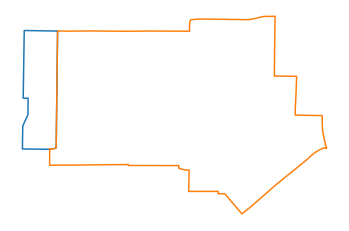

1495. Nodes 603 and 563 are connected


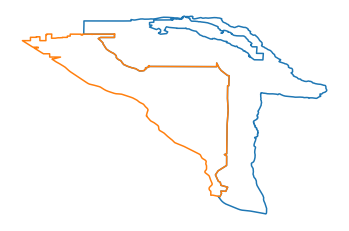

1496. Nodes 603 and 566 are connected


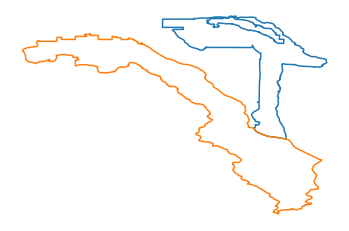

1497. Nodes 603 and 589 are connected


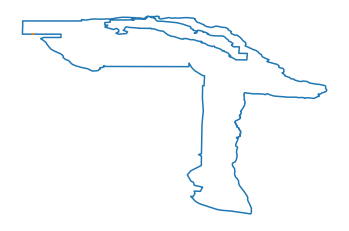

1498. Nodes 603 and 595 are connected


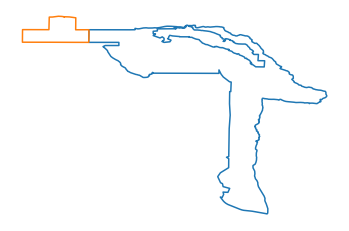

1499. Nodes 604 and 520 are connected


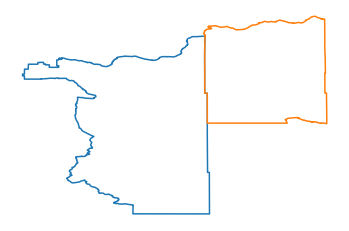

1500. Nodes 604 and 535 are connected


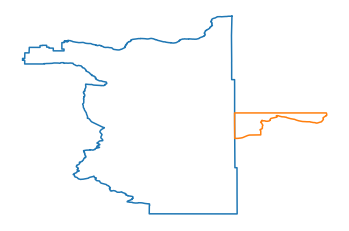

1501. Nodes 604 and 544 are connected


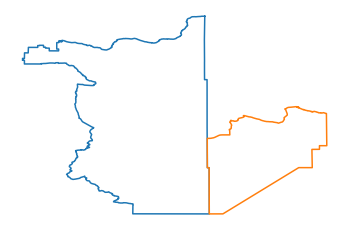

1502. Nodes 604 and 560 are connected


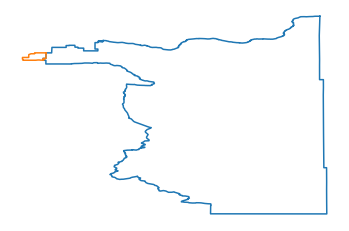

1503. Nodes 604 and 564 are connected


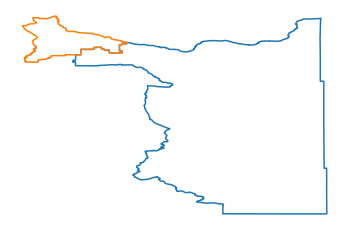

1504. Nodes 604 and 566 are connected


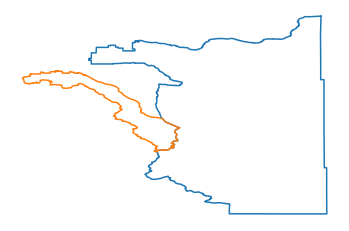

1505. Nodes 604 and 595 are connected


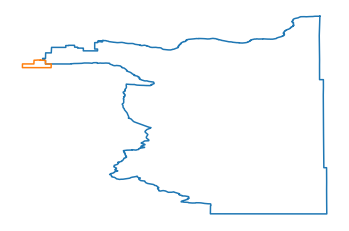

1506. Nodes 604 and 603 are connected


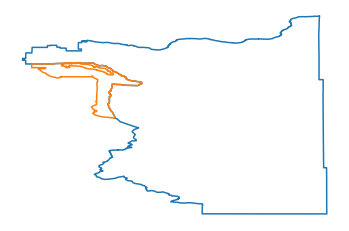

1507. Nodes 606 and 603 are connected


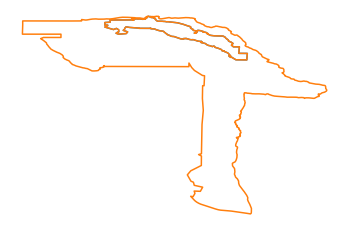

1508. Nodes 606 and 604 are connected


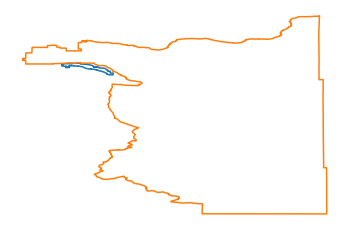

1509. Nodes 607 and 550 are connected


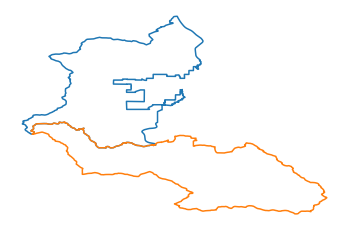

1510. Nodes 607 and 552 are connected


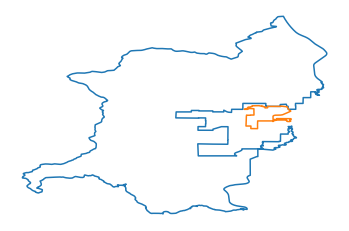

1511. Nodes 607 and 561 are connected


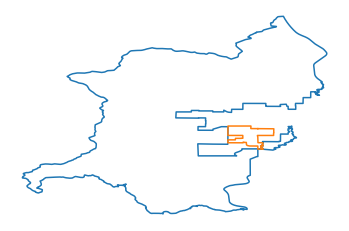

1512. Nodes 607 and 562 are connected


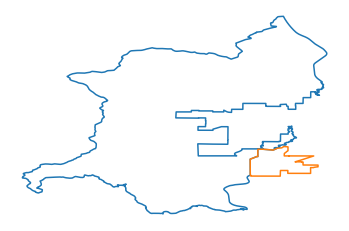

1513. Nodes 607 and 564 are connected


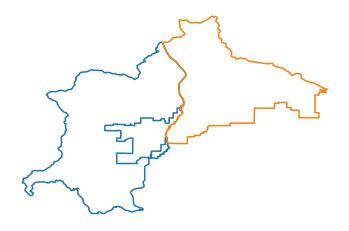

1514. Nodes 607 and 566 are connected


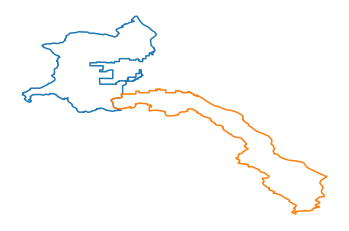

1515. Nodes 607 and 568 are connected


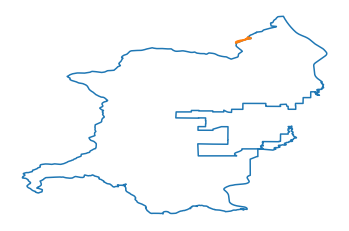

1516. Nodes 607 and 569 are connected


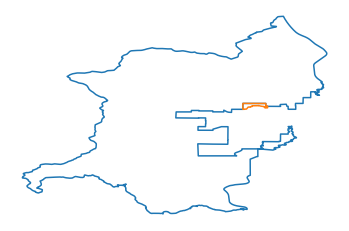

1517. Nodes 607 and 570 are connected


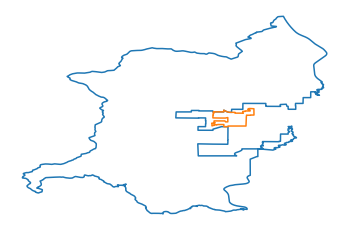

1518. Nodes 607 and 571 are connected


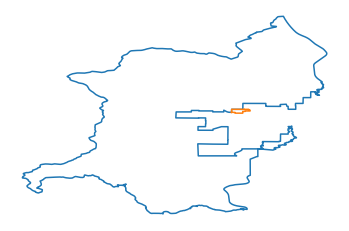

1519. Nodes 607 and 572 are connected


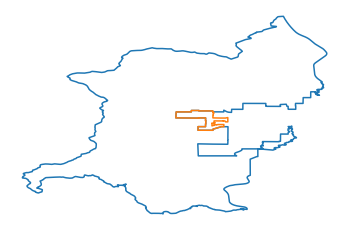

1520. Nodes 607 and 573 are connected


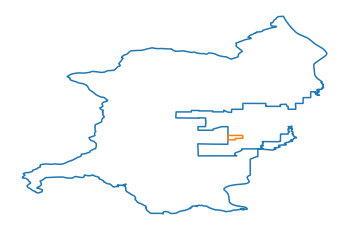

1521. Nodes 607 and 574 are connected


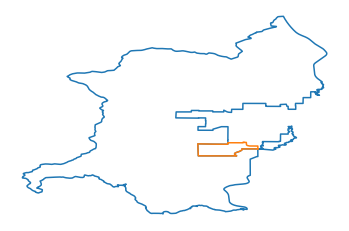

1522. Nodes 607 and 575 are connected


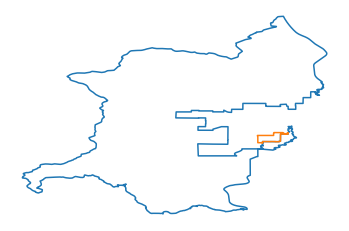

1523. Nodes 607 and 576 are connected


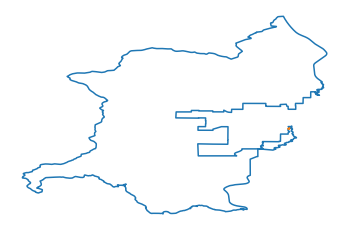

1524. Nodes 607 and 577 are connected


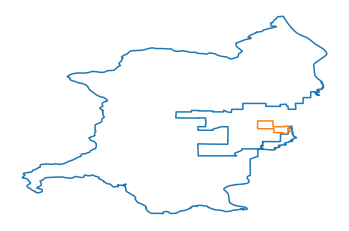

1525. Nodes 607 and 578 are connected


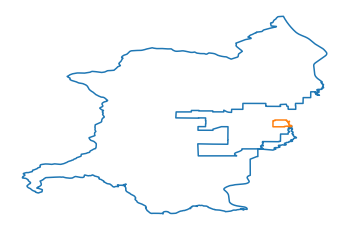

1526. Nodes 607 and 580 are connected


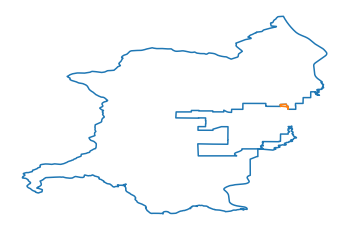

1527. Nodes 607 and 584 are connected


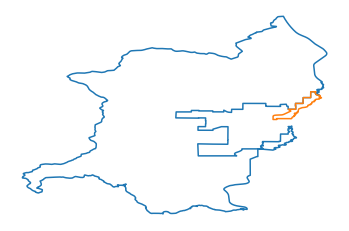

1528. Nodes 607 and 592 are connected


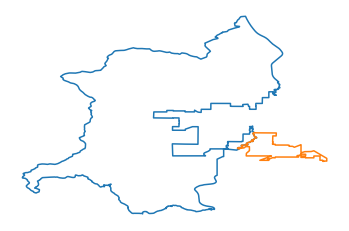

1529. Nodes 607 and 605 are connected


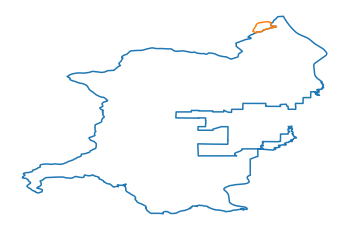

1530. Nodes 612 and 610 are connected


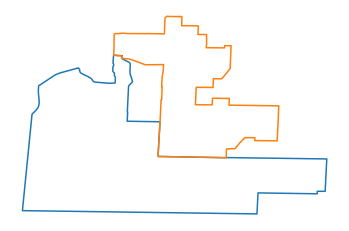

1531. Nodes 612 and 611 are connected


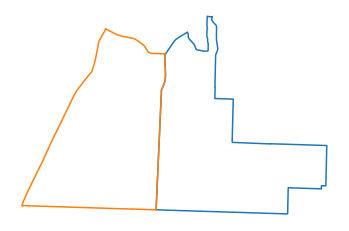

1532. Nodes 613 and 610 are connected


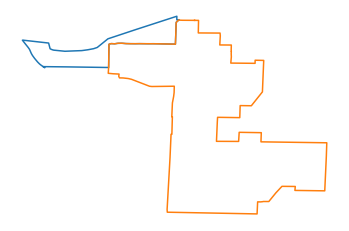

1533. Nodes 615 and 229 are connected


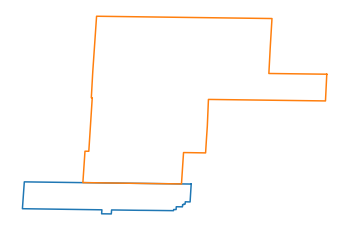

1534. Nodes 615 and 231 are connected


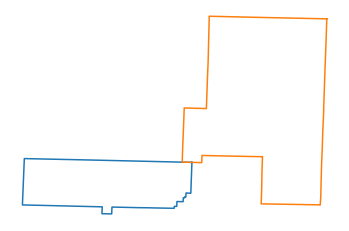

1535. Nodes 616 and 231 are connected


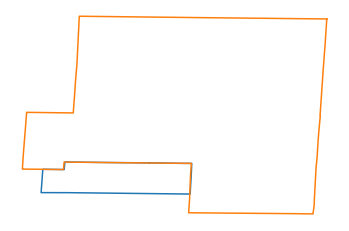

1536. Nodes 616 and 615 are connected


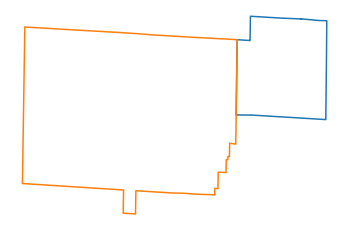

1537. Nodes 617 and 609 are connected


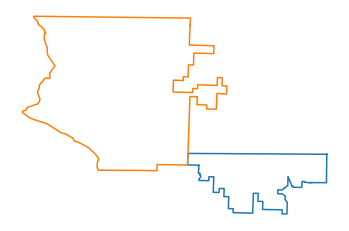

1538. Nodes 618 and 4 are connected


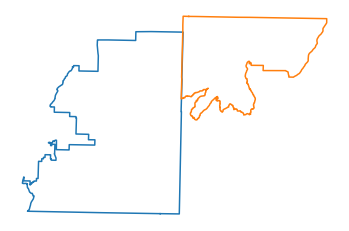

1539. Nodes 618 and 11 are connected


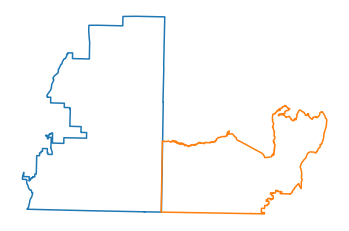

1540. Nodes 618 and 15 are connected


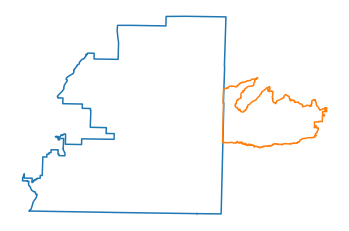

1541. Nodes 618 and 266 are connected


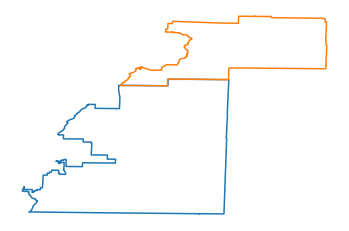

1542. Nodes 620 and 614 are connected


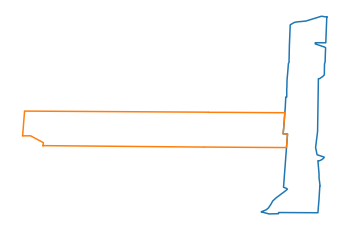

1543. Nodes 620 and 618 are connected


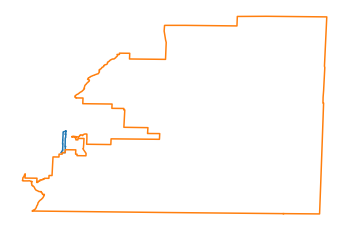

1544. Nodes 622 and 609 are connected


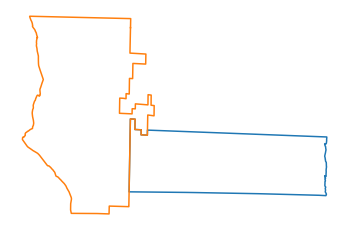

1545. Nodes 622 and 617 are connected


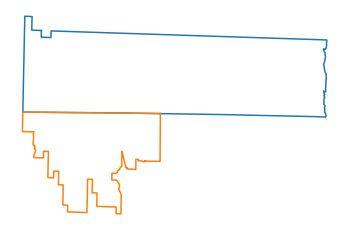

1546. Nodes 625 and 624 are connected


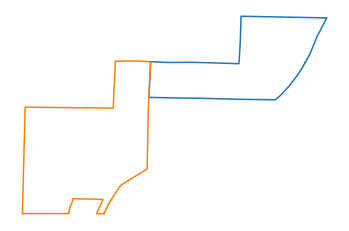

1547. Nodes 626 and 624 are connected


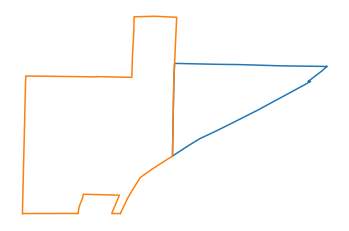

1548. Nodes 626 and 625 are connected


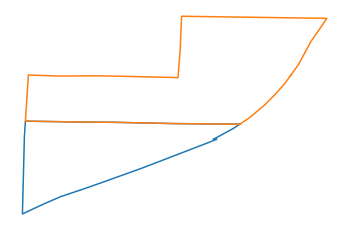

1549. Nodes 628 and 619 are connected


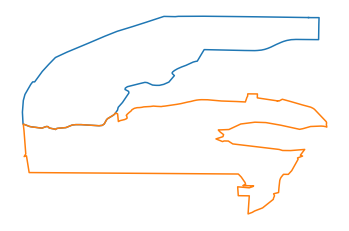

1550. Nodes 628 and 624 are connected


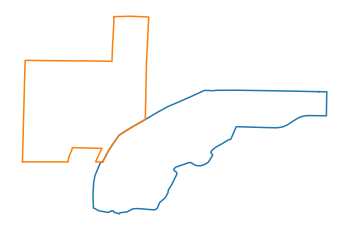

1551. Nodes 628 and 626 are connected


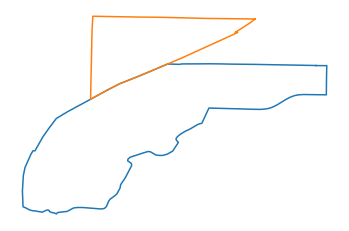

1552. Nodes 629 and 626 are connected


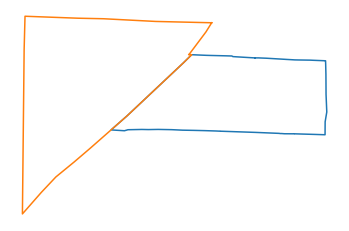

1553. Nodes 629 and 628 are connected


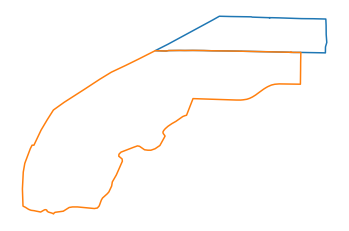

1554. Nodes 630 and 625 are connected


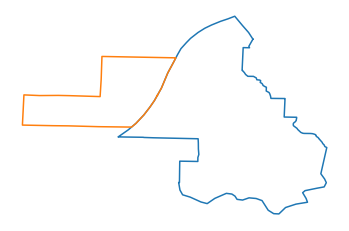

1555. Nodes 630 and 626 are connected


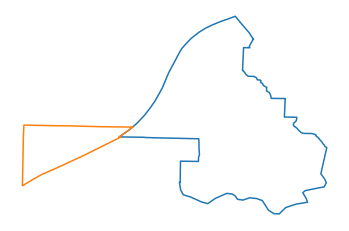

1556. Nodes 630 and 628 are connected


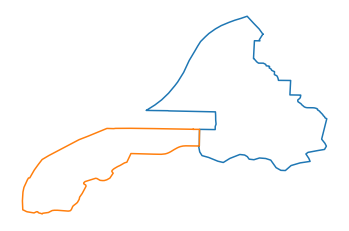

1557. Nodes 630 and 629 are connected


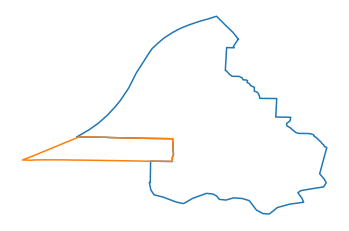

1558. Nodes 631 and 621 are connected


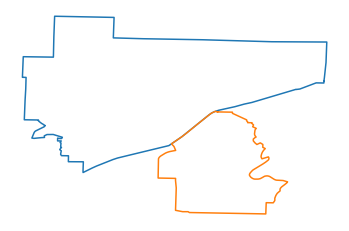

1559. Nodes 632 and 608 are connected


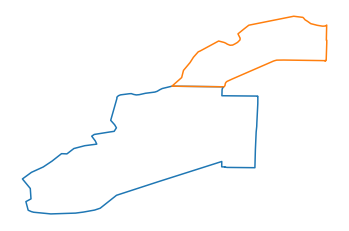

1560. Nodes 632 and 610 are connected


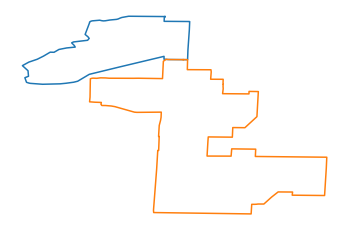

1561. Nodes 632 and 613 are connected


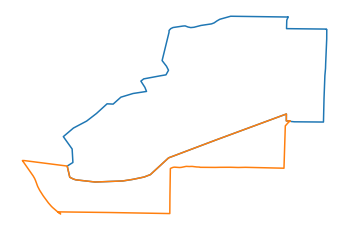

1562. Nodes 632 and 630 are connected


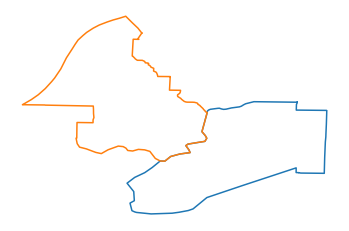

1563. Nodes 633 and 608 are connected


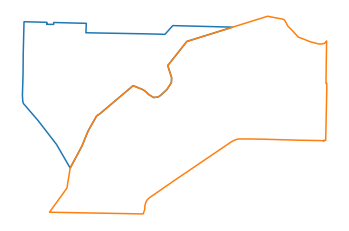

1564. Nodes 634 and 608 are connected


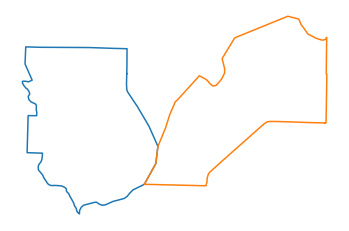

1565. Nodes 634 and 630 are connected


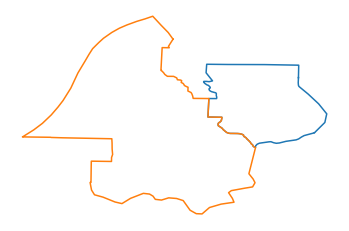

1566. Nodes 634 and 632 are connected


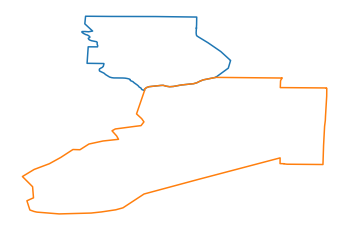

1567. Nodes 634 and 633 are connected


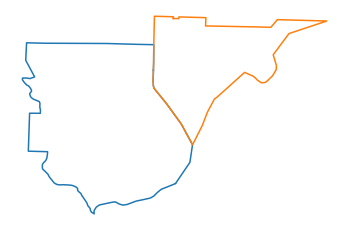

1568. Nodes 637 and 618 are connected


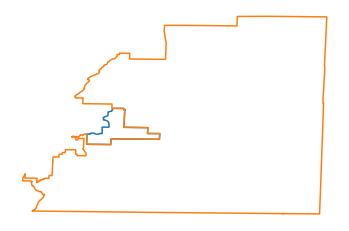

1569. Nodes 638 and 625 are connected


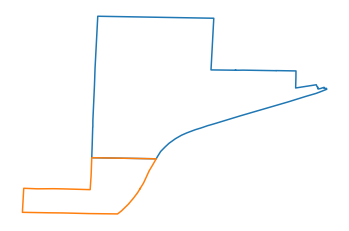

1570. Nodes 638 and 630 are connected


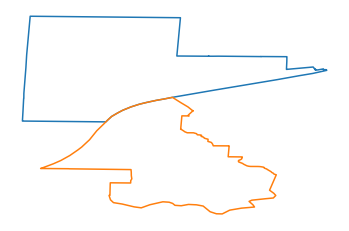

1571. Nodes 639 and 617 are connected


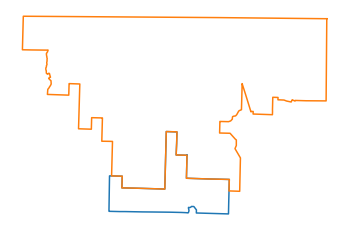

1572. Nodes 640 and 639 are connected


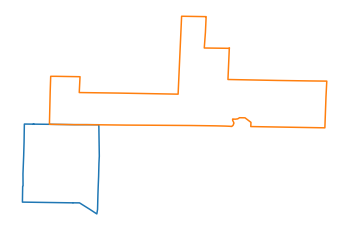

1573. Nodes 641 and 609 are connected


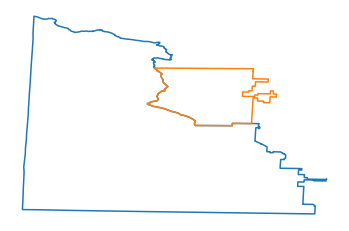

1574. Nodes 641 and 617 are connected


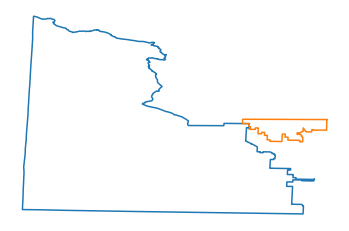

1575. Nodes 641 and 640 are connected


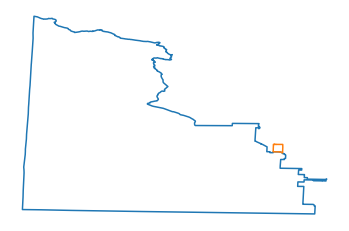

1576. Nodes 642 and 617 are connected


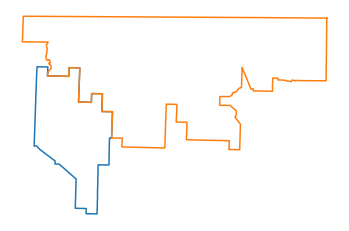

1577. Nodes 642 and 639 are connected


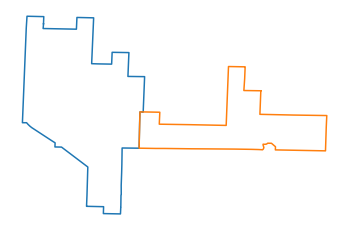

1578. Nodes 642 and 640 are connected


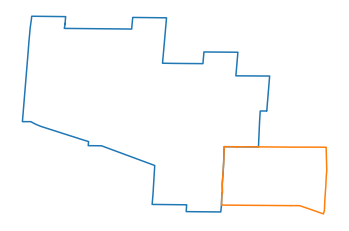

1579. Nodes 642 and 641 are connected


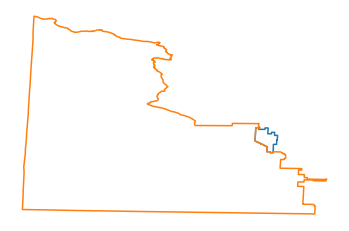

1580. Nodes 643 and 636 are connected


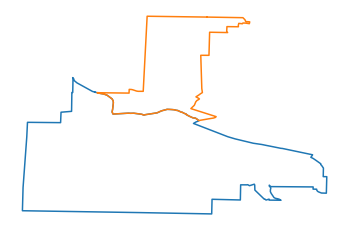

1581. Nodes 643 and 641 are connected


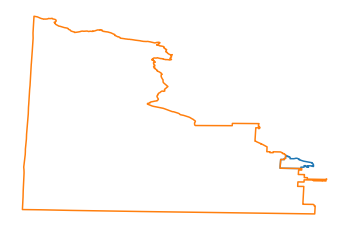

1582. Nodes 644 and 639 are connected


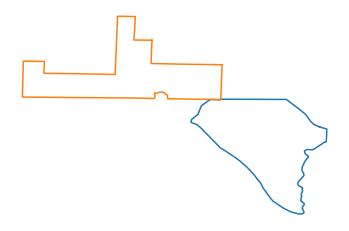

1583. Nodes 645 and 641 are connected


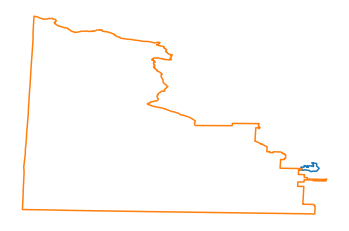

1584. Nodes 645 and 643 are connected


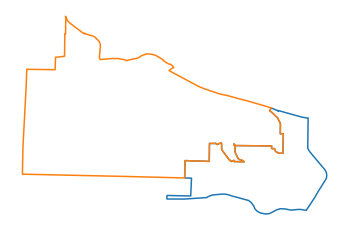

1585. Nodes 646 and 641 are connected


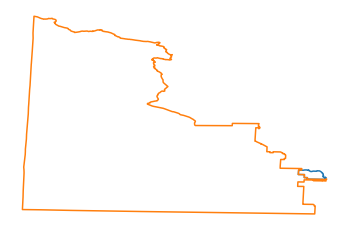

1586. Nodes 646 and 645 are connected


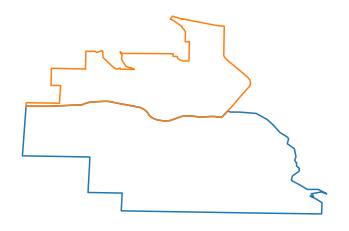

1587. Nodes 647 and 609 are connected


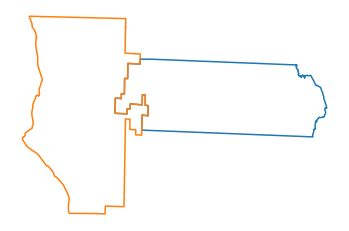

1588. Nodes 647 and 622 are connected


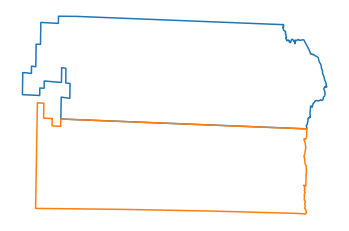

1589. Nodes 648 and 624 are connected


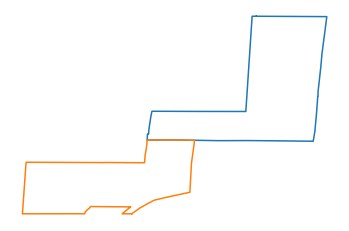

1590. Nodes 648 and 625 are connected


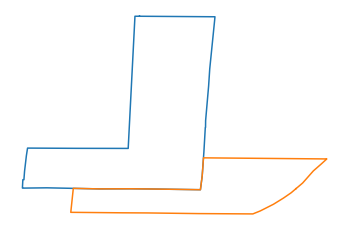

1591. Nodes 648 and 638 are connected


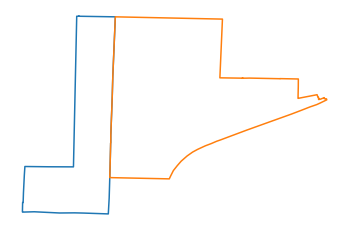

1592. Nodes 649 and 648 are connected


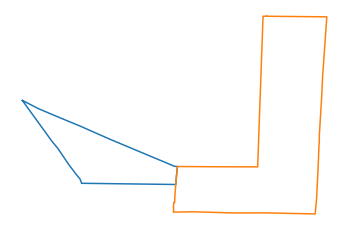

1593. Nodes 650 and 624 are connected


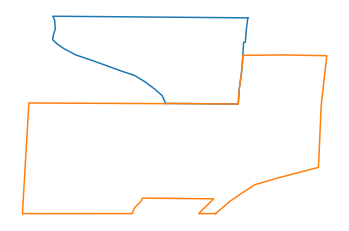

1594. Nodes 650 and 648 are connected


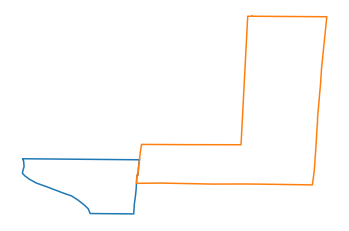

1595. Nodes 650 and 649 are connected


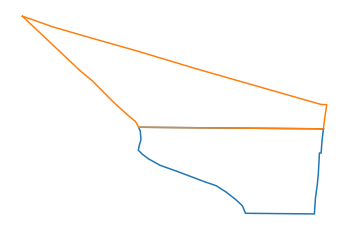

1596. Nodes 651 and 627 are connected


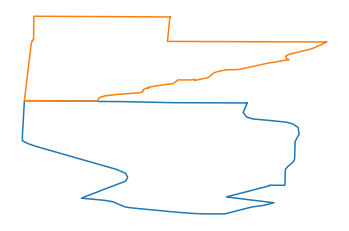

1597. Nodes 651 and 645 are connected


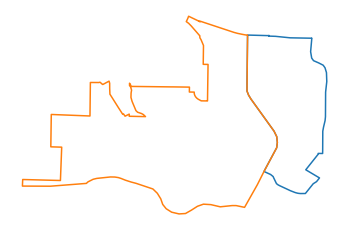

1598. Nodes 652 and 624 are connected


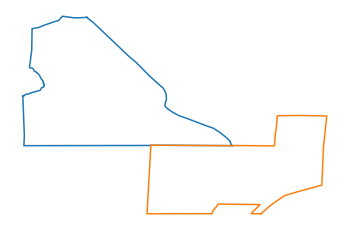

1599. Nodes 652 and 649 are connected


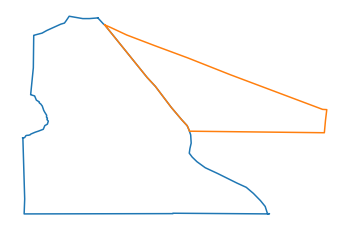

1600. Nodes 652 and 650 are connected


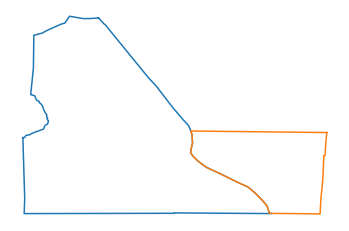

1601. Nodes 653 and 651 are connected


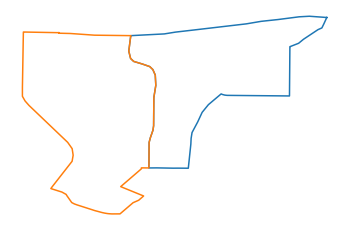

1602. Nodes 653 and 652 are connected


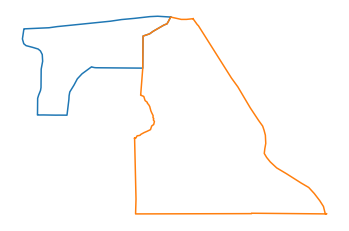

1603. Nodes 654 and 652 are connected


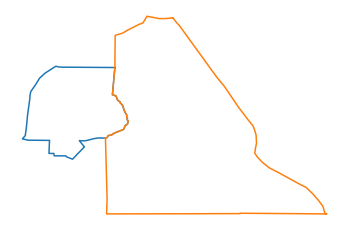

1604. Nodes 654 and 653 are connected


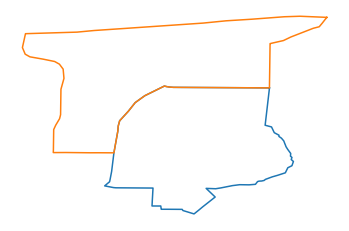

1605. Nodes 656 and 611 are connected


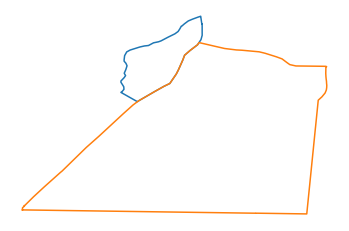

1606. Nodes 656 and 619 are connected


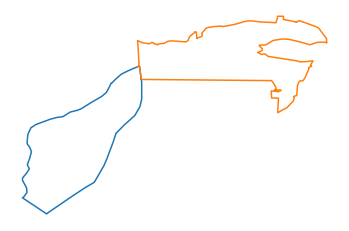

1607. Nodes 656 and 655 are connected


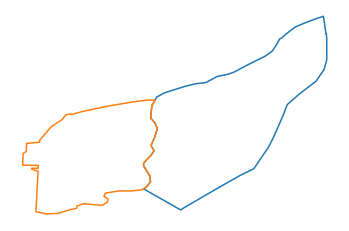

1608. Nodes 657 and 630 are connected


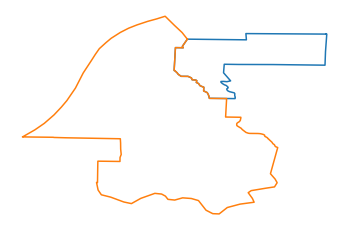

1609. Nodes 657 and 633 are connected


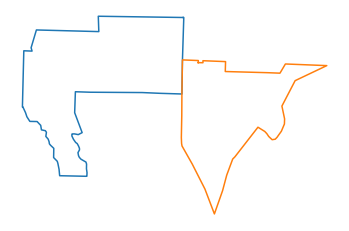

1610. Nodes 657 and 634 are connected


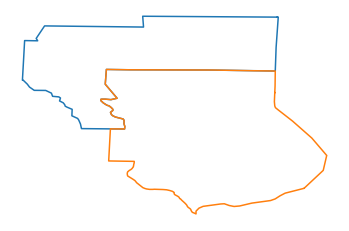

1611. Nodes 658 and 630 are connected


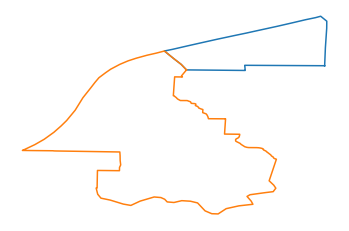

1612. Nodes 658 and 638 are connected


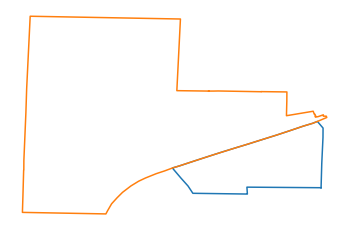

1613. Nodes 658 and 657 are connected


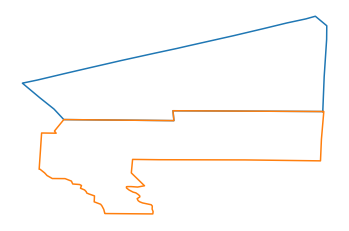

1614. Nodes 659 and 611 are connected


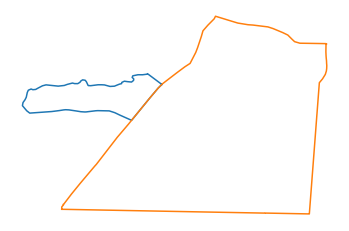

1615. Nodes 659 and 655 are connected


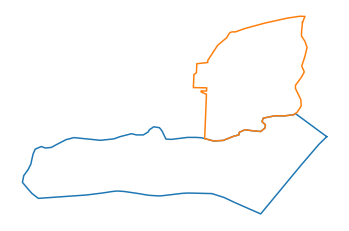

1616. Nodes 659 and 656 are connected


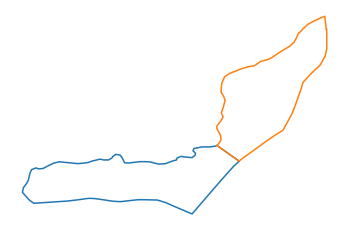

1617. Nodes 660 and 621 are connected


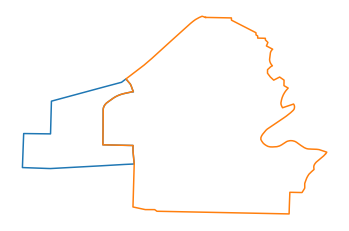

1618. Nodes 660 and 631 are connected


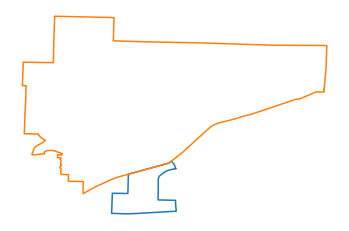

1619. Nodes 661 and 623 are connected


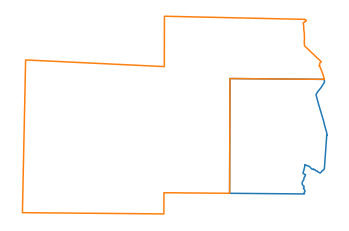

1620. Nodes 662 and 609 are connected


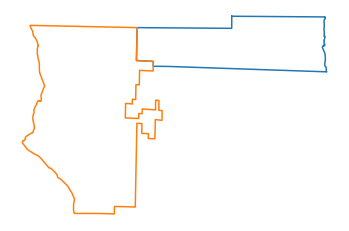

1621. Nodes 662 and 623 are connected


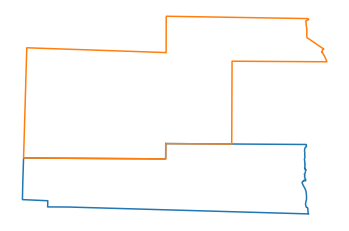

1622. Nodes 662 and 647 are connected


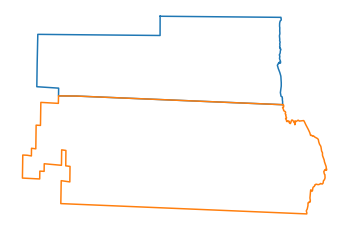

1623. Nodes 662 and 661 are connected


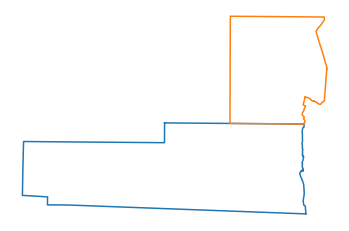

1624. Nodes 663 and 610 are connected


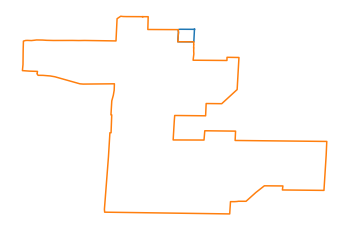

1625. Nodes 664 and 631 are connected


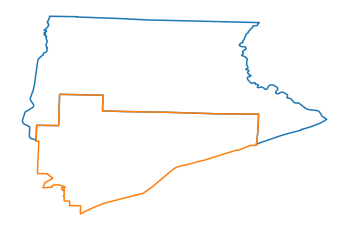

1626. Nodes 665 and 610 are connected


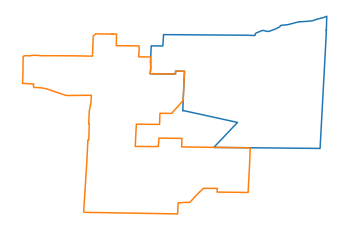

1627. Nodes 665 and 663 are connected


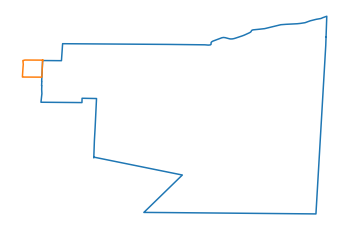

1628. Nodes 666 and 613 are connected


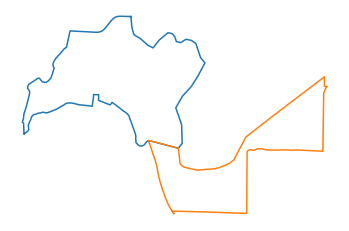

1629. Nodes 666 and 619 are connected


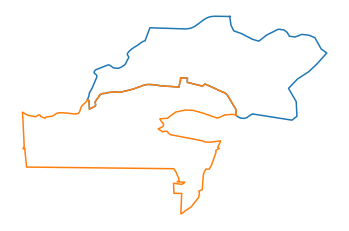

1630. Nodes 666 and 628 are connected


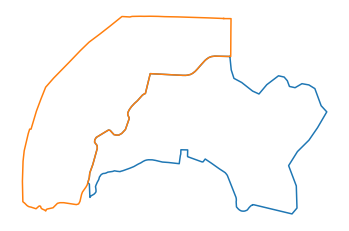

1631. Nodes 666 and 630 are connected


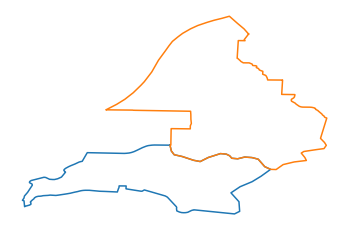

1632. Nodes 666 and 632 are connected


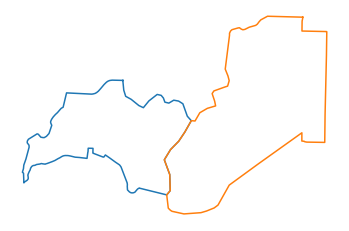

1633. Nodes 667 and 612 are connected


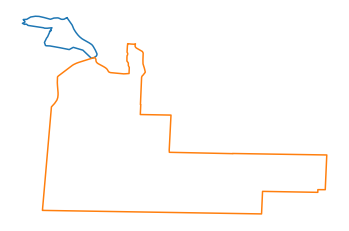

1634. Nodes 667 and 613 are connected


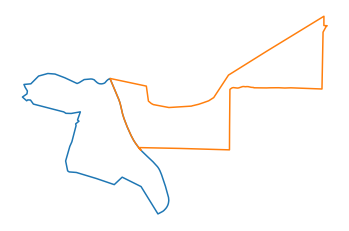

1635. Nodes 667 and 619 are connected


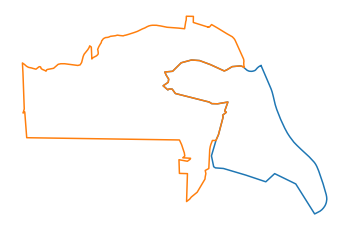

1636. Nodes 667 and 666 are connected


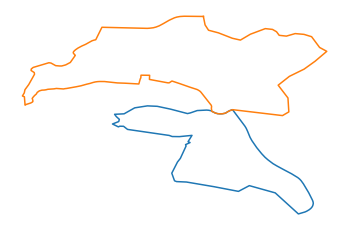

1637. Nodes 668 and 611 are connected


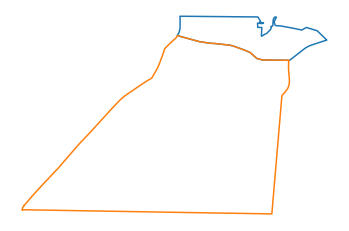

1638. Nodes 668 and 612 are connected


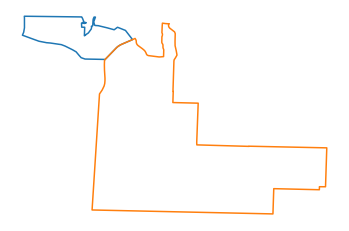

1639. Nodes 668 and 619 are connected


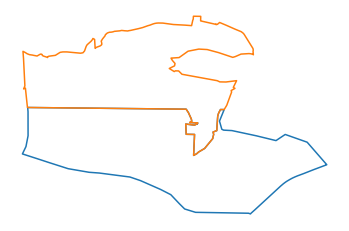

1640. Nodes 668 and 656 are connected


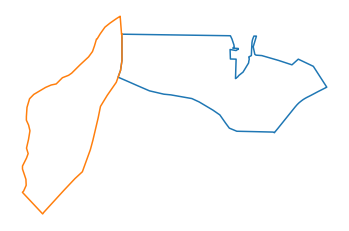

1641. Nodes 668 and 667 are connected


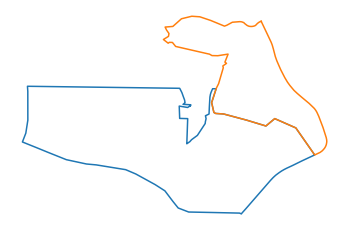

1642. Nodes 669 and 641 are connected


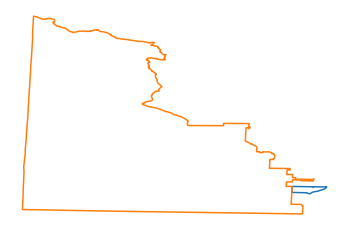

1643. Nodes 669 and 655 are connected


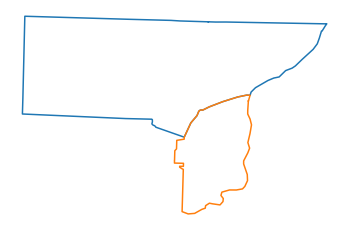

1644. Nodes 669 and 656 are connected


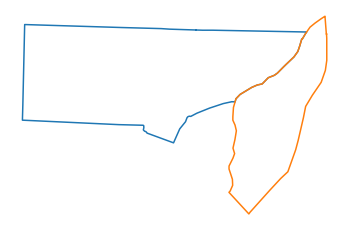

1645. Nodes 670 and 641 are connected


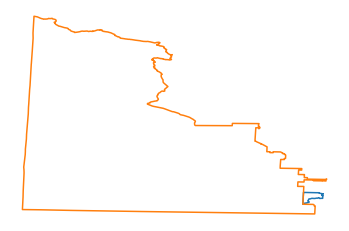

1646. Nodes 670 and 655 are connected


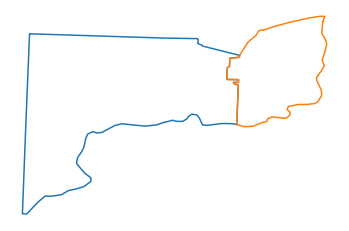

1647. Nodes 670 and 659 are connected


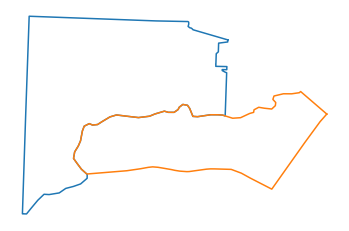

1648. Nodes 670 and 669 are connected


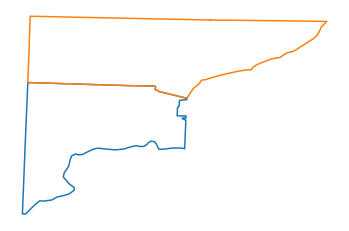

1649. Nodes 671 and 611 are connected


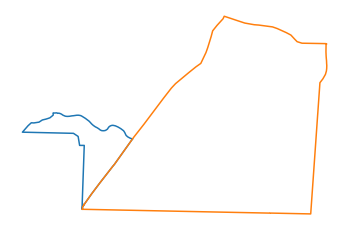

1650. Nodes 671 and 641 are connected


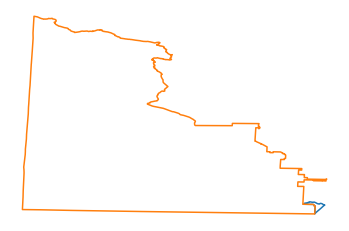

1651. Nodes 671 and 659 are connected


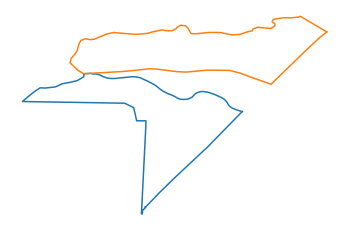

1652. Nodes 671 and 670 are connected


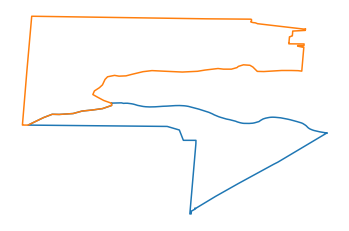

1653. Nodes 672 and 614 are connected


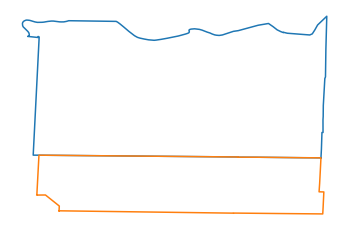

1654. Nodes 672 and 620 are connected


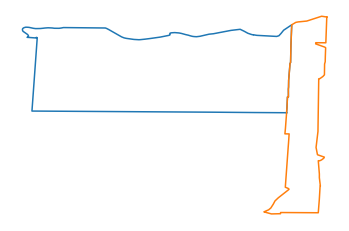

1655. Nodes 673 and 627 are connected


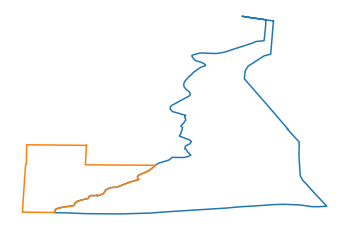

1656. Nodes 673 and 644 are connected


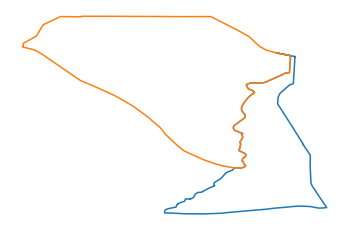

1657. Nodes 673 and 651 are connected


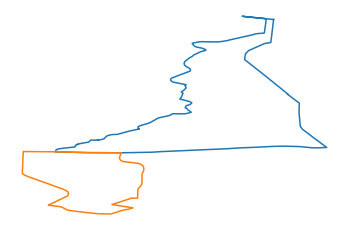

1658. Nodes 673 and 652 are connected


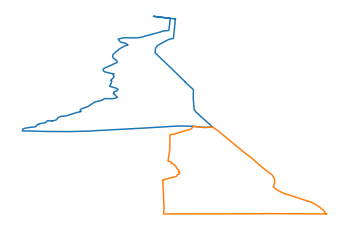

1659. Nodes 673 and 653 are connected


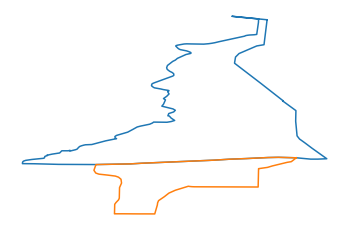

1660. Nodes 674 and 624 are connected


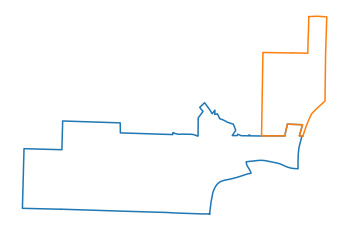

1661. Nodes 674 and 628 are connected


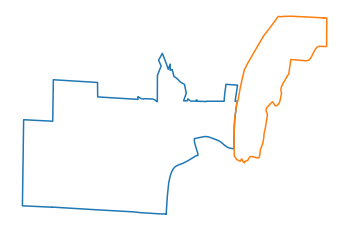

1662. Nodes 674 and 641 are connected


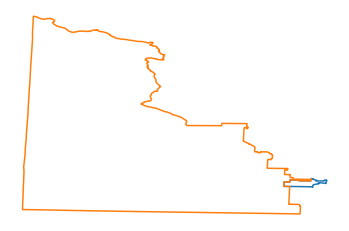

1663. Nodes 674 and 669 are connected


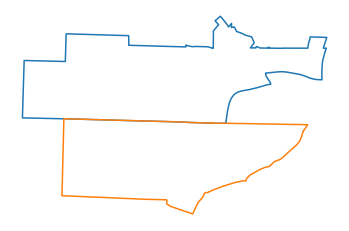

1664. Nodes 675 and 631 are connected


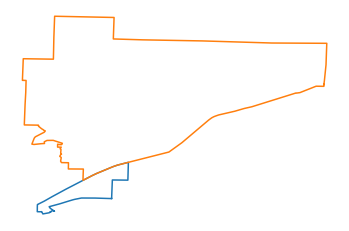

1665. Nodes 675 and 660 are connected


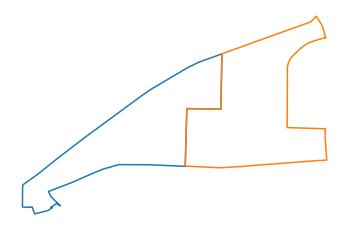

1666. Nodes 676 and 231 are connected


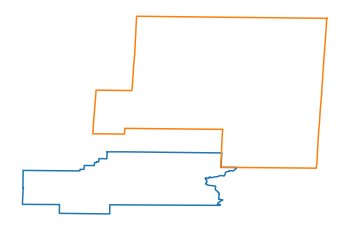

1667. Nodes 676 and 615 are connected


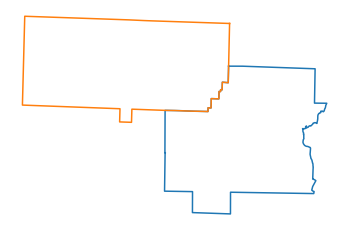

1668. Nodes 676 and 616 are connected


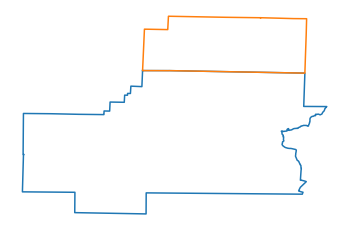

1669. Nodes 676 and 623 are connected


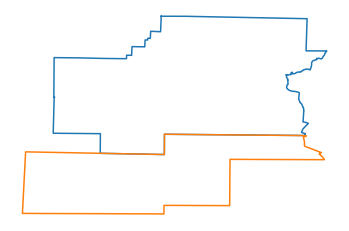

1670. Nodes 677 and 608 are connected


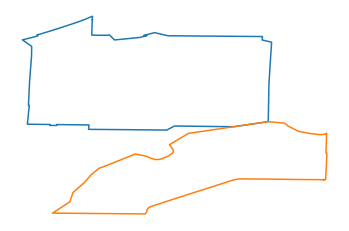

1671. Nodes 677 and 633 are connected


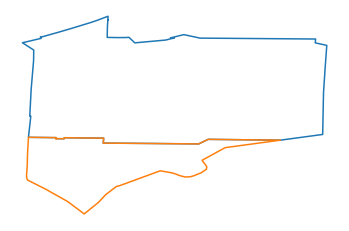

1672. Nodes 677 and 638 are connected


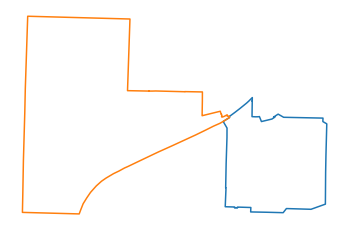

1673. Nodes 677 and 657 are connected


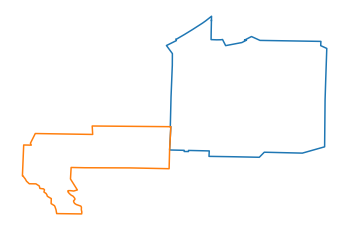

1674. Nodes 677 and 658 are connected


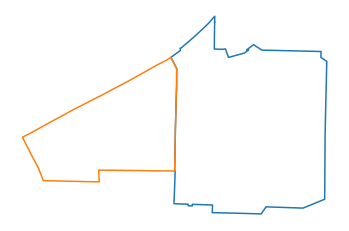

1675. Nodes 677 and 675 are connected


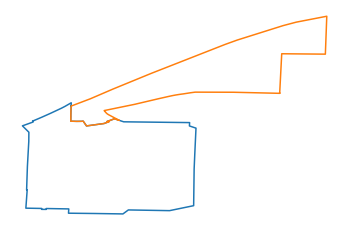

1676. Nodes 678 and 608 are connected


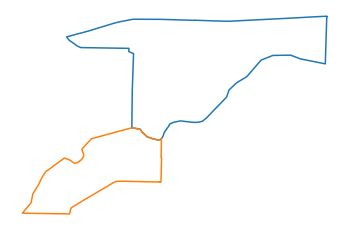

1677. Nodes 678 and 621 are connected


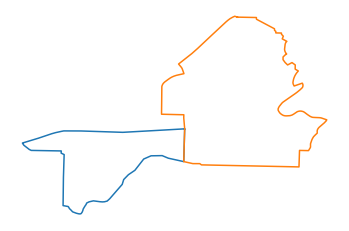

1678. Nodes 678 and 660 are connected


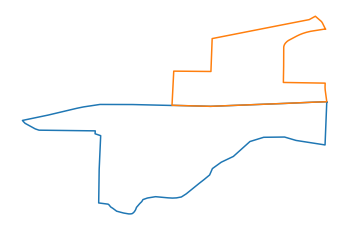

1679. Nodes 678 and 675 are connected


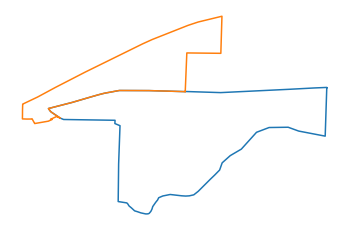

1680. Nodes 678 and 677 are connected


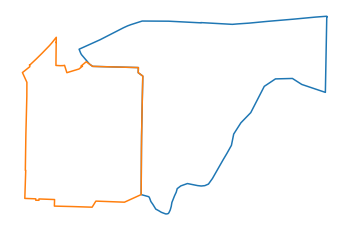

1681. Nodes 679 and 610 are connected


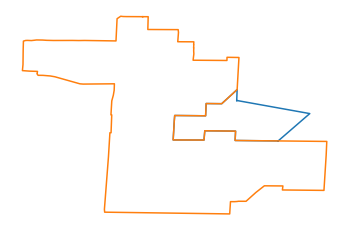

1682. Nodes 679 and 665 are connected


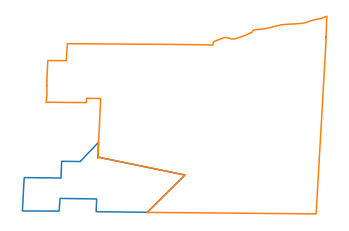

1683. Nodes 680 and 231 are connected


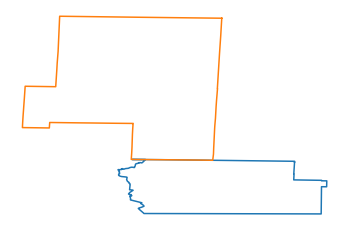

1684. Nodes 680 and 264 are connected


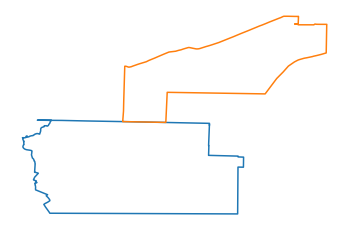

1685. Nodes 680 and 268 are connected


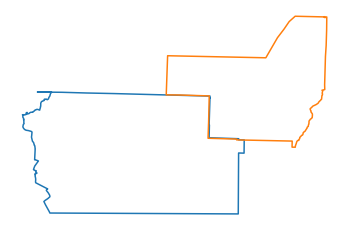

1686. Nodes 680 and 618 are connected


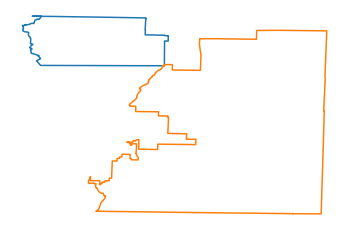

1687. Nodes 680 and 623 are connected


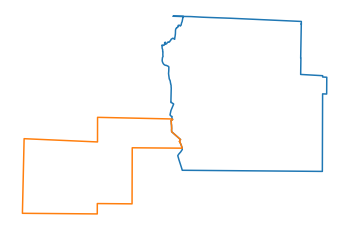

1688. Nodes 680 and 661 are connected


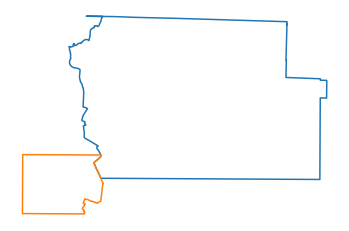

1689. Nodes 680 and 676 are connected


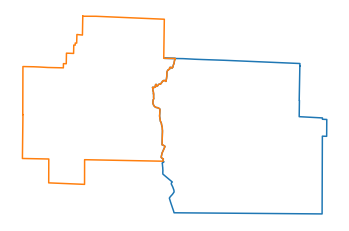

1690. Nodes 681 and 618 are connected


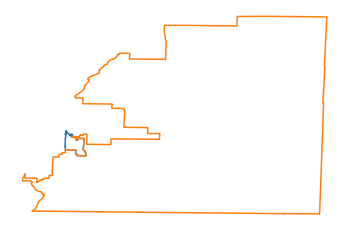

1691. Nodes 681 and 620 are connected


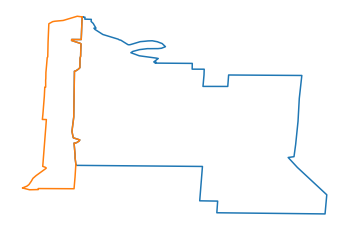

1692. Nodes 682 and 618 are connected


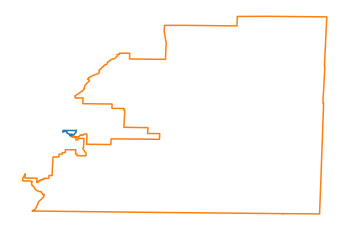

1693. Nodes 682 and 620 are connected


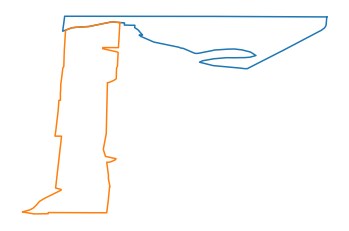

1694. Nodes 682 and 635 are connected


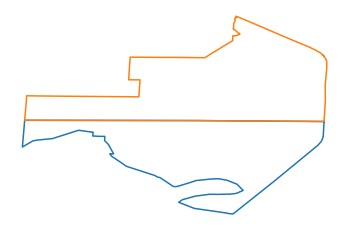

1695. Nodes 682 and 672 are connected


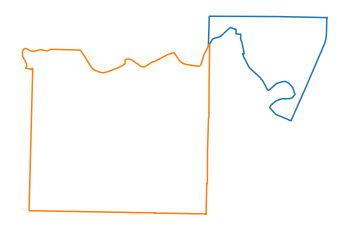

1696. Nodes 682 and 681 are connected


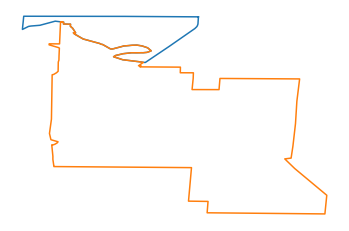

1697. Nodes 683 and 640 are connected


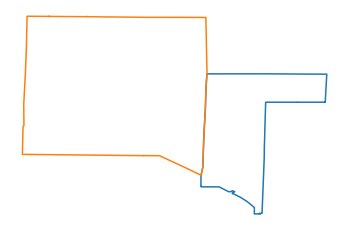

1698. Nodes 683 and 641 are connected


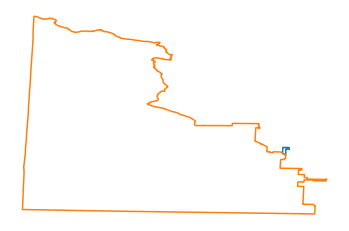

1699. Nodes 684 and 618 are connected


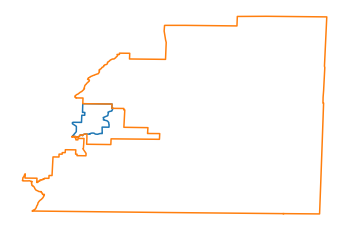

1700. Nodes 684 and 635 are connected


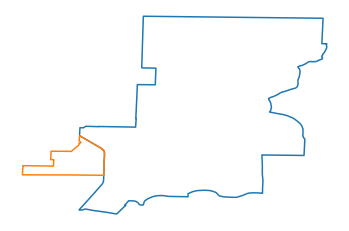

1701. Nodes 684 and 637 are connected


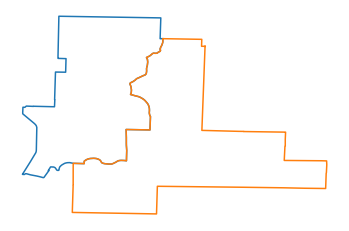

1702. Nodes 684 and 682 are connected


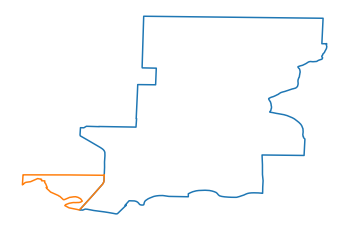

1703. Nodes 685 and 636 are connected


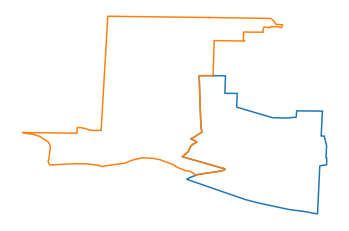

1704. Nodes 685 and 643 are connected


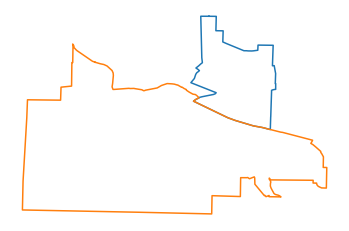

1705. Nodes 686 and 610 are connected


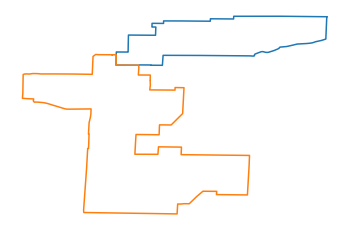

1706. Nodes 686 and 632 are connected


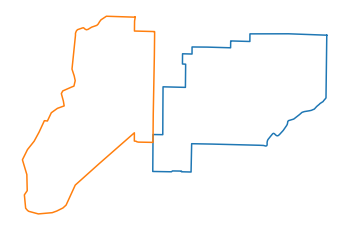

1707. Nodes 686 and 663 are connected


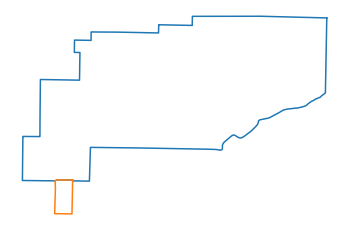

1708. Nodes 686 and 665 are connected


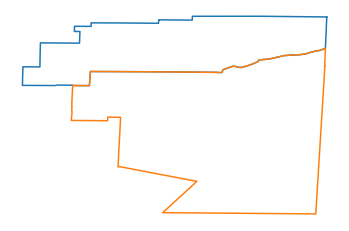

1709. Nodes 687 and 608 are connected


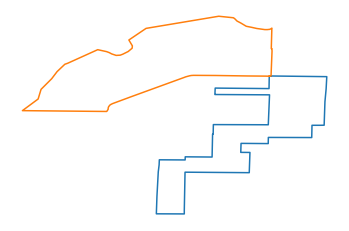

1710. Nodes 687 and 632 are connected


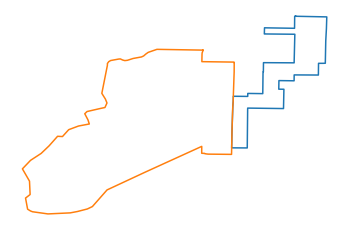

1711. Nodes 687 and 686 are connected


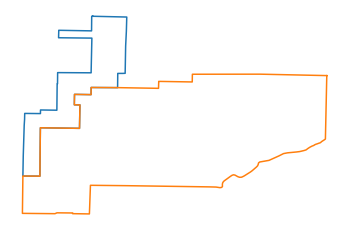

1712. Nodes 689 and 610 are connected


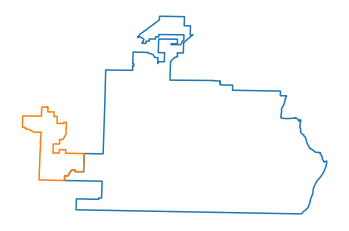

1713. Nodes 689 and 612 are connected


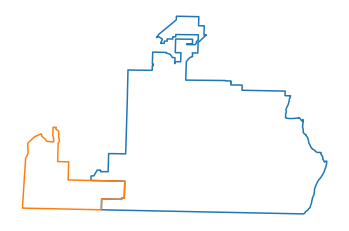

1714. Nodes 689 and 618 are connected


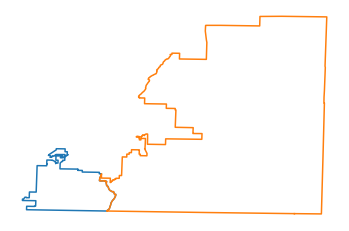

1715. Nodes 689 and 621 are connected


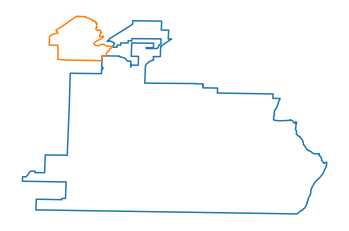

1716. Nodes 689 and 665 are connected


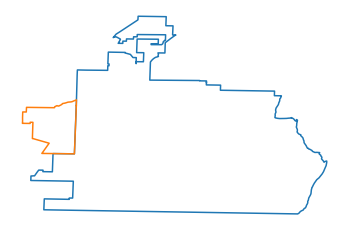

1717. Nodes 689 and 686 are connected


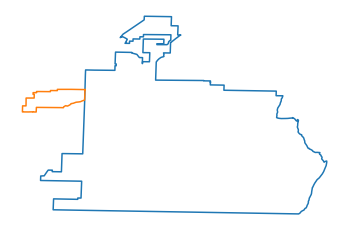

1718. Nodes 689 and 688 are connected


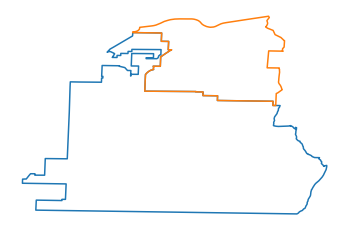

1719. Nodes 690 and 614 are connected


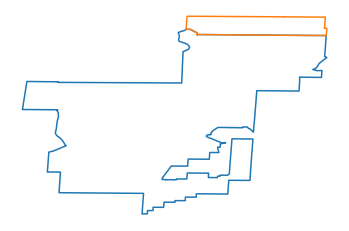

1720. Nodes 690 and 618 are connected


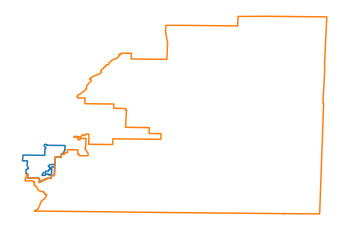

1721. Nodes 690 and 620 are connected


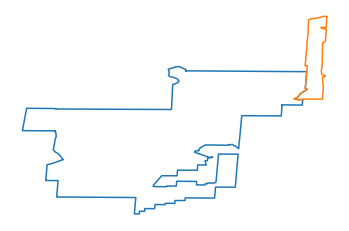

1722. Nodes 690 and 688 are connected


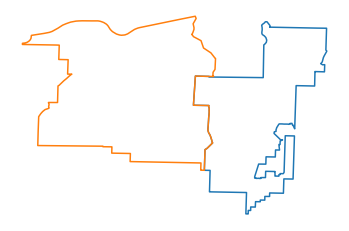

1723. Nodes 690 and 689 are connected


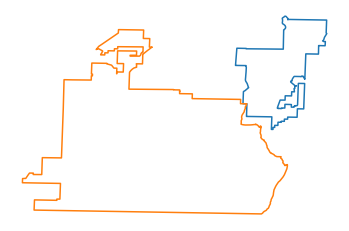

1724. Nodes 691 and 618 are connected


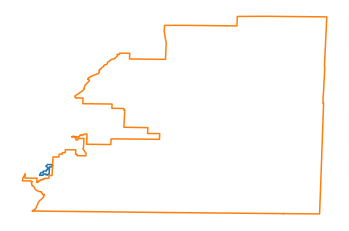

1725. Nodes 691 and 690 are connected


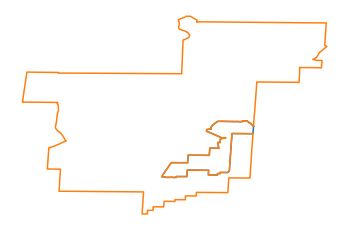

1726. Nodes 692 and 621 are connected


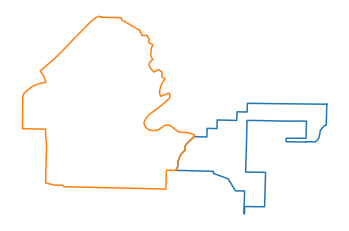

1727. Nodes 692 and 689 are connected


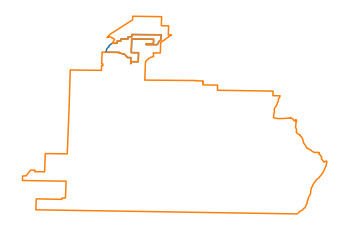

1728. Nodes 693 and 610 are connected


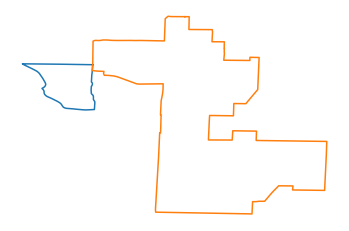

1729. Nodes 693 and 612 are connected


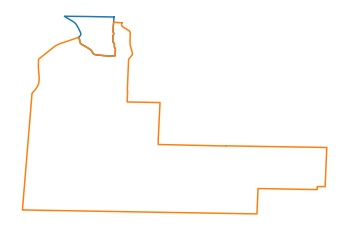

1730. Nodes 693 and 613 are connected


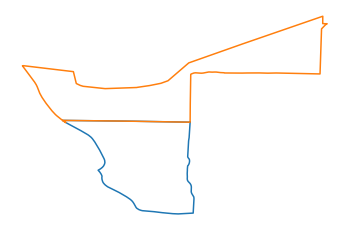

1731. Nodes 693 and 667 are connected


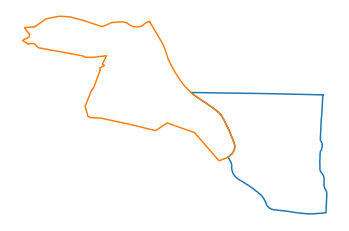

1732. Nodes 694 and 611 are connected


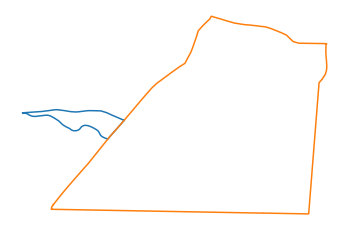

1733. Nodes 694 and 659 are connected


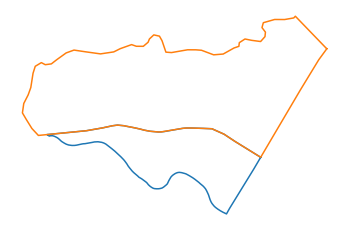

1734. Nodes 694 and 671 are connected


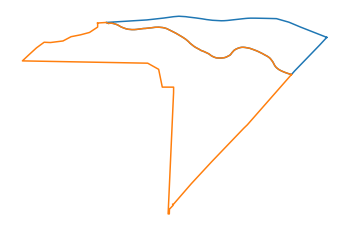

1735. Nodes 695 and 686 are connected


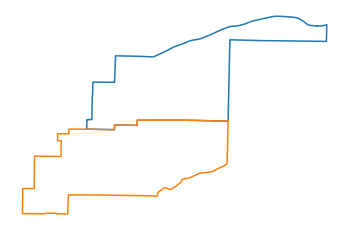

1736. Nodes 695 and 687 are connected


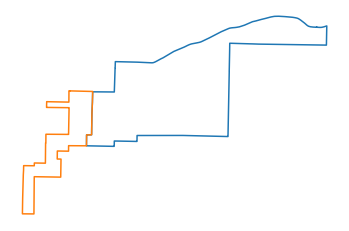

1737. Nodes 695 and 689 are connected


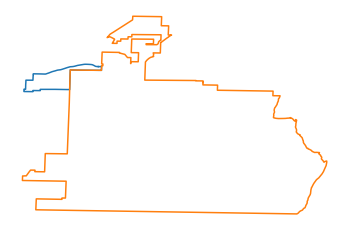

1738. Nodes 696 and 608 are connected


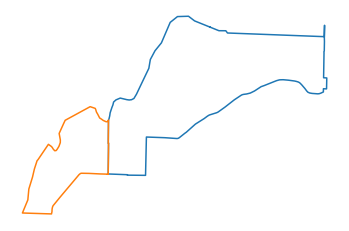

1739. Nodes 696 and 621 are connected


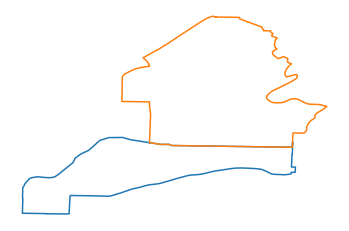

1740. Nodes 696 and 678 are connected


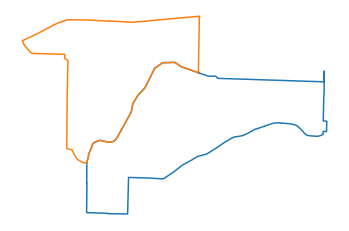

1741. Nodes 696 and 687 are connected


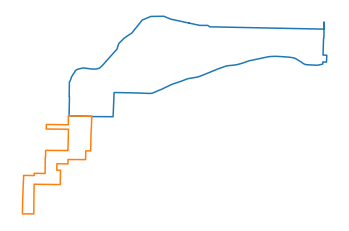

1742. Nodes 696 and 689 are connected


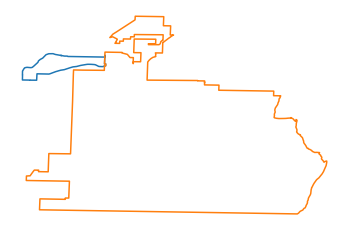

1743. Nodes 696 and 695 are connected


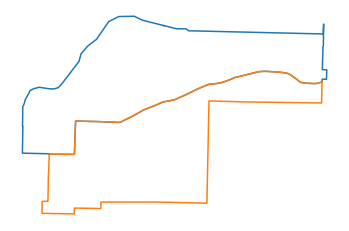

1744. Nodes 697 and 614 are connected


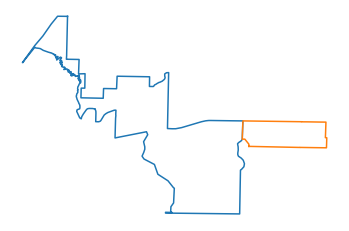

1745. Nodes 697 and 672 are connected


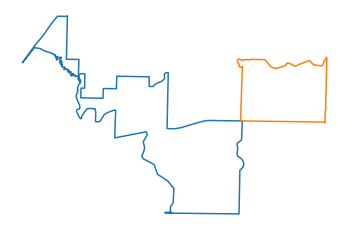

1746. Nodes 697 and 688 are connected


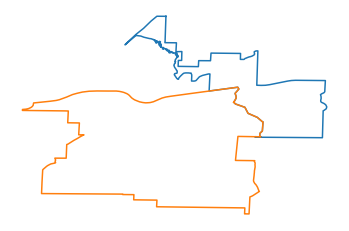

1747. Nodes 697 and 690 are connected


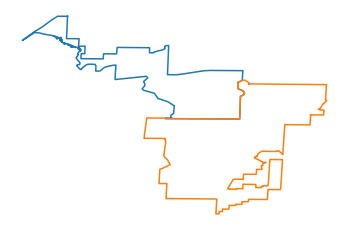

1748. Nodes 698 and 631 are connected


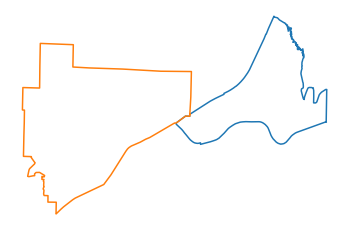

1749. Nodes 698 and 664 are connected


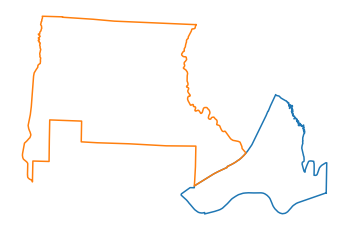

1750. Nodes 698 and 688 are connected


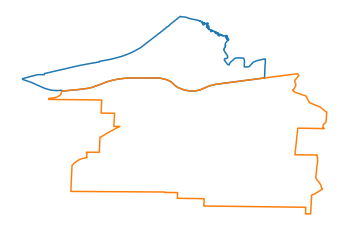

1751. Nodes 698 and 697 are connected


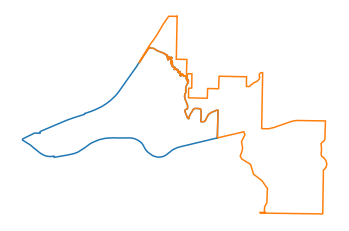

1752. Nodes 699 and 672 are connected


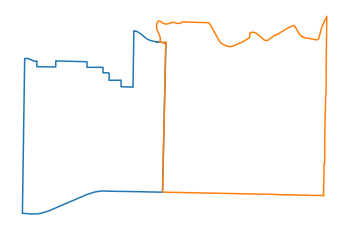

1753. Nodes 699 and 697 are connected


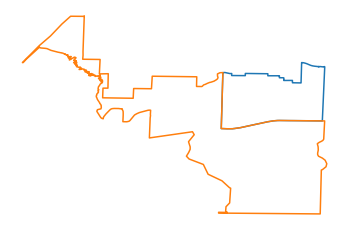

1754. Nodes 700 and 636 are connected


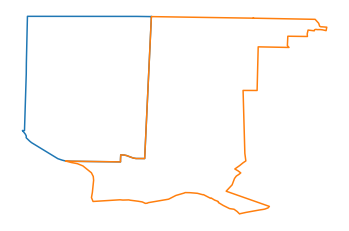

1755. Nodes 700 and 641 are connected


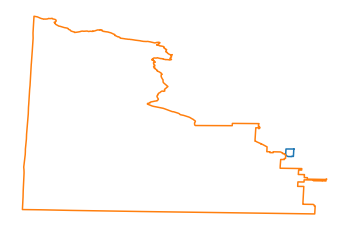

1756. Nodes 700 and 643 are connected


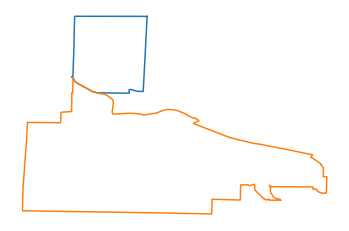

1757. Nodes 700 and 683 are connected


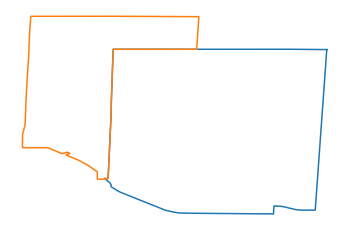

1758. Nodes 701 and 618 are connected


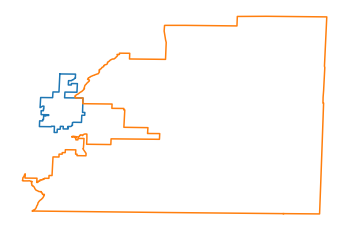

1759. Nodes 701 and 635 are connected


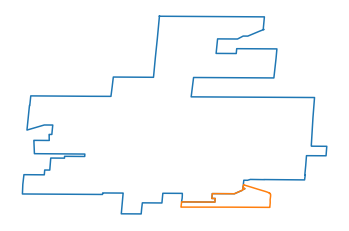

1760. Nodes 701 and 684 are connected


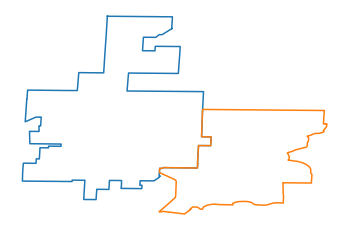

1761. Nodes 702 and 701 are connected


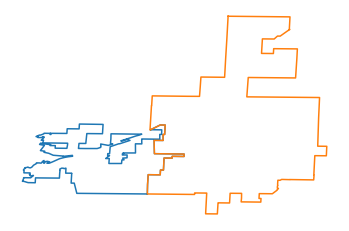

1762. Nodes 703 and 618 are connected


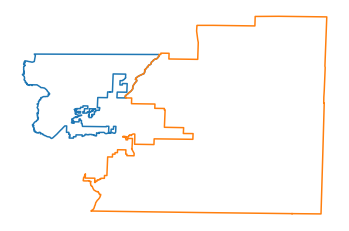

1763. Nodes 703 and 622 are connected


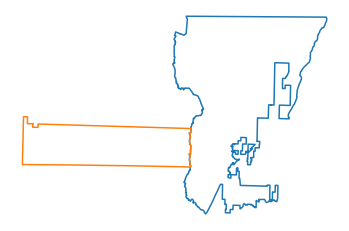

1764. Nodes 703 and 635 are connected


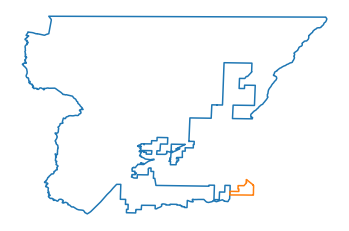

1765. Nodes 703 and 647 are connected


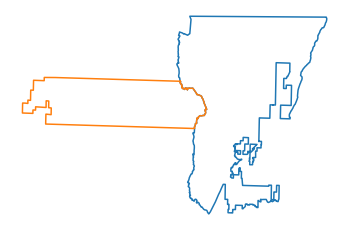

1766. Nodes 703 and 661 are connected


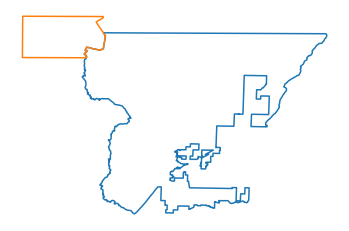

1767. Nodes 703 and 662 are connected


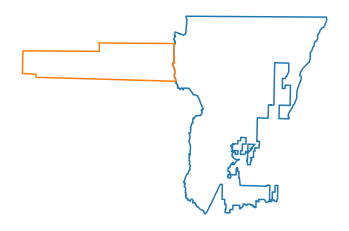

1768. Nodes 703 and 664 are connected


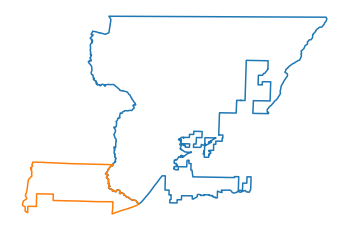

1769. Nodes 703 and 672 are connected


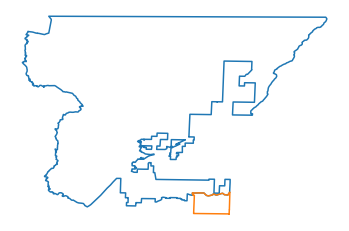

1770. Nodes 703 and 680 are connected


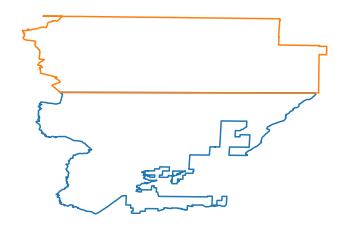

1771. Nodes 703 and 682 are connected


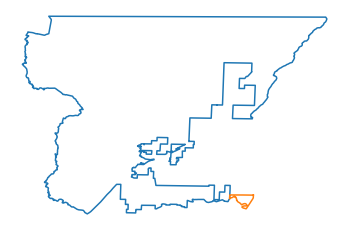

1772. Nodes 703 and 697 are connected


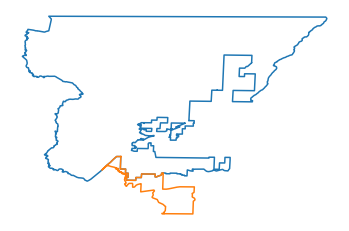

1773. Nodes 703 and 698 are connected


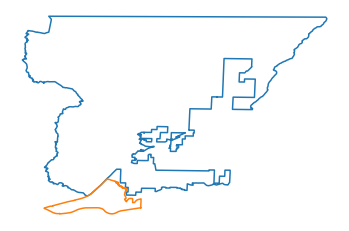

1774. Nodes 703 and 699 are connected


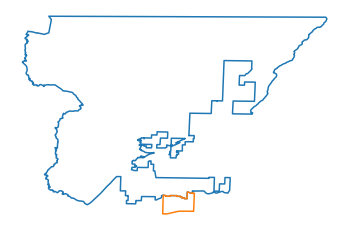

1775. Nodes 703 and 701 are connected


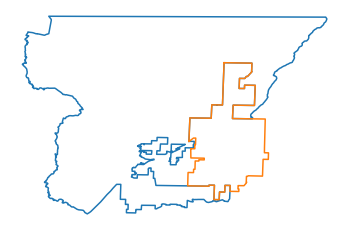

1776. Nodes 703 and 702 are connected


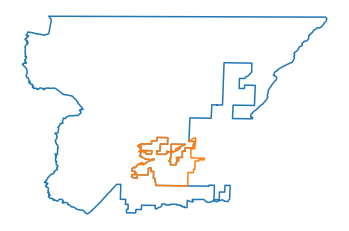

1777. Nodes 704 and 624 are connected


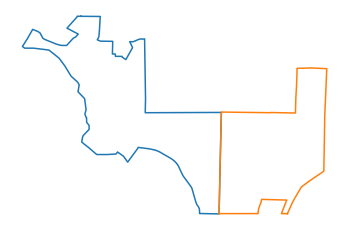

1778. Nodes 704 and 645 are connected


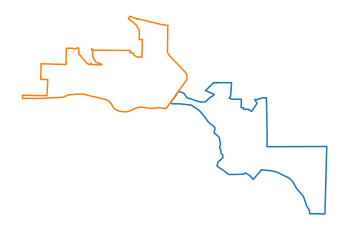

1779. Nodes 704 and 646 are connected


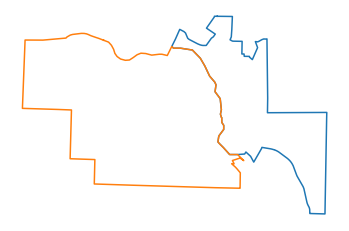

1780. Nodes 704 and 651 are connected


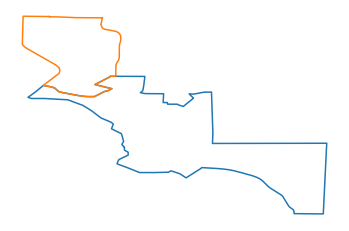

1781. Nodes 704 and 652 are connected


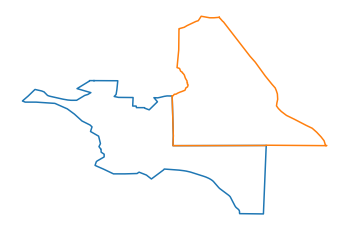

1782. Nodes 704 and 653 are connected


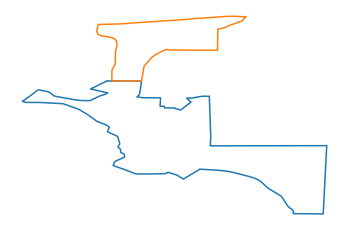

1783. Nodes 704 and 654 are connected


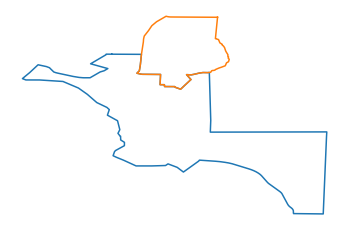

1784. Nodes 704 and 674 are connected


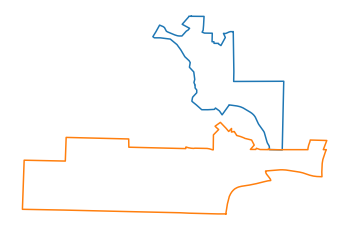

1785. Nodes 705 and 641 are connected


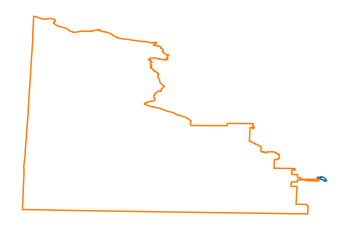

1786. Nodes 705 and 646 are connected


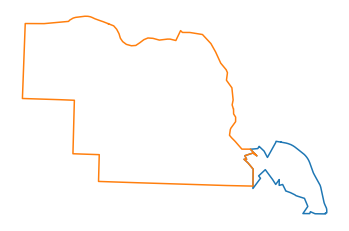

1787. Nodes 705 and 674 are connected


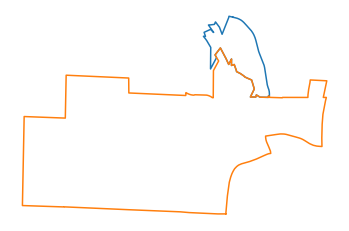

1788. Nodes 705 and 704 are connected


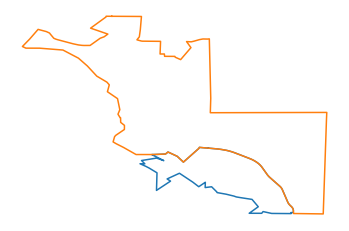

1789. Nodes 706 and 617 are connected


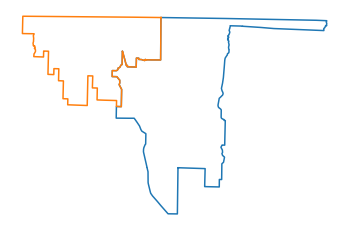

1790. Nodes 706 and 622 are connected


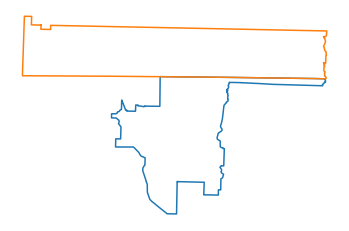

1791. Nodes 706 and 631 are connected


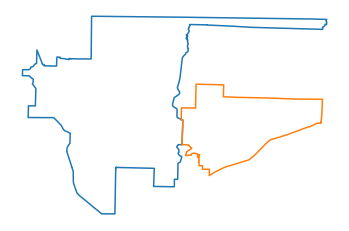

1792. Nodes 706 and 638 are connected


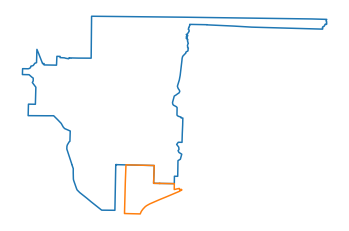

1793. Nodes 706 and 639 are connected


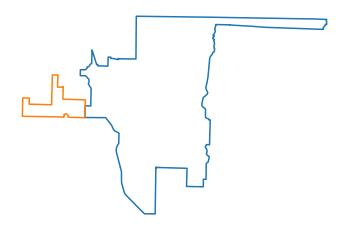

1794. Nodes 706 and 644 are connected


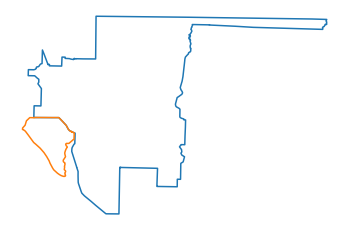

1795. Nodes 706 and 648 are connected


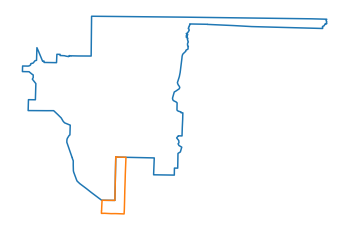

1796. Nodes 706 and 649 are connected


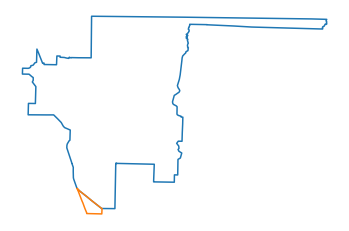

1797. Nodes 706 and 652 are connected


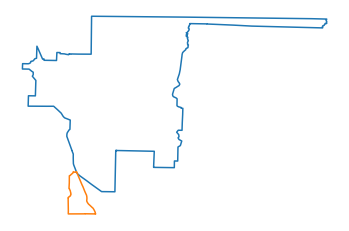

1798. Nodes 706 and 664 are connected


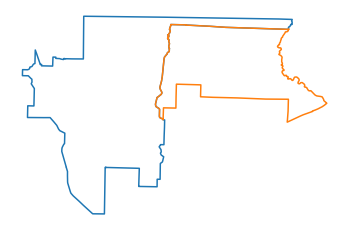

1799. Nodes 706 and 673 are connected


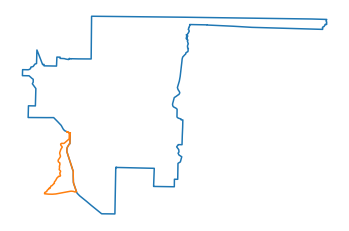

1800. Nodes 706 and 703 are connected


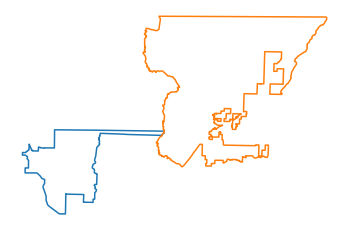

1801. Nodes 707 and 228 are connected


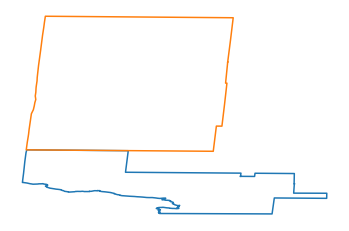

1802. Nodes 707 and 609 are connected


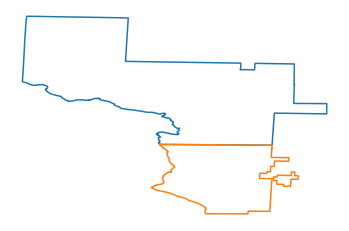

1803. Nodes 707 and 615 are connected


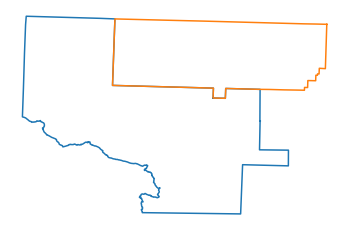

1804. Nodes 707 and 623 are connected


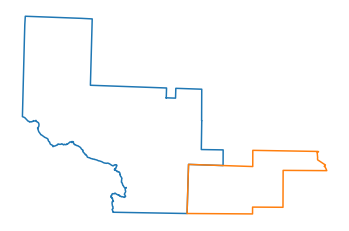

1805. Nodes 707 and 641 are connected


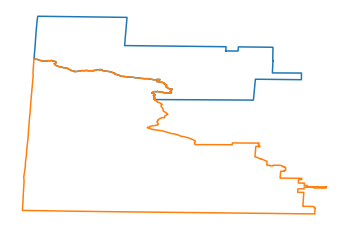

1806. Nodes 707 and 676 are connected


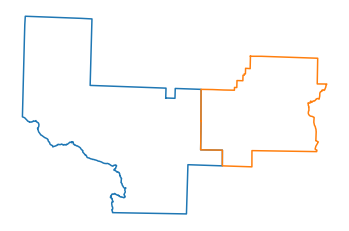

1807. Nodes 708 and 268 are connected


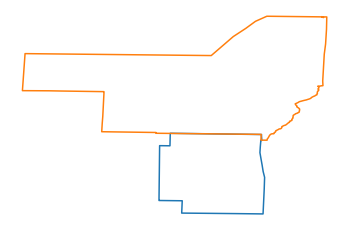

1808. Nodes 708 and 618 are connected


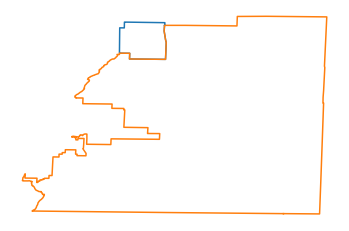

1809. Nodes 708 and 680 are connected


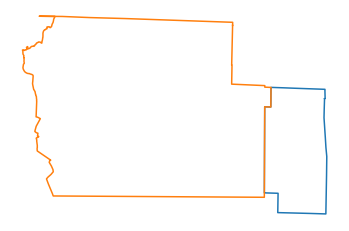

1810. Nodes 709 and 636 are connected


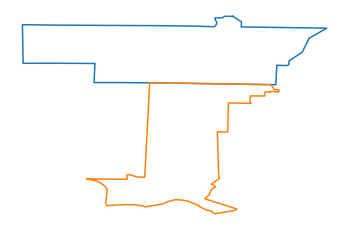

1811. Nodes 709 and 639 are connected


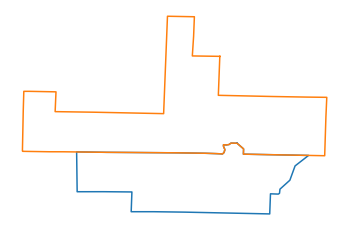

1812. Nodes 709 and 640 are connected


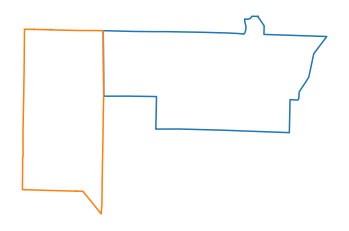

1813. Nodes 709 and 644 are connected


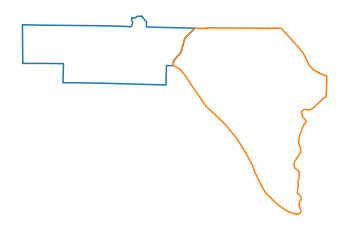

1814. Nodes 709 and 683 are connected


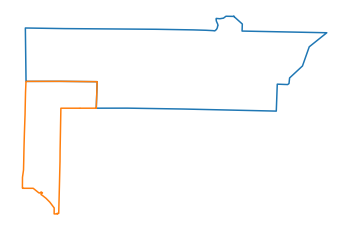

1815. Nodes 709 and 700 are connected


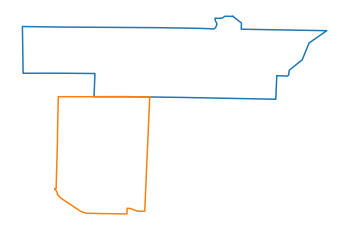

1816. Nodes 710 and 627 are connected


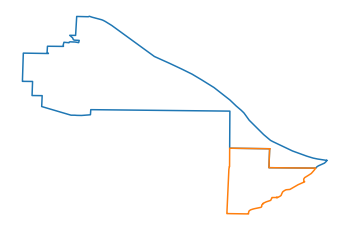

1817. Nodes 710 and 636 are connected


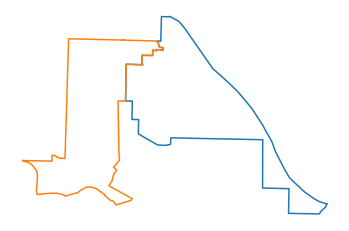

1818. Nodes 710 and 644 are connected


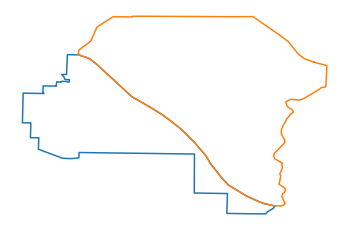

1819. Nodes 710 and 673 are connected


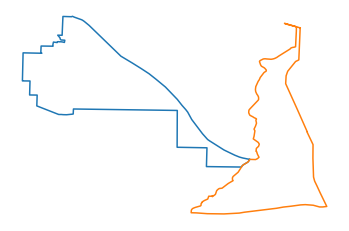

1820. Nodes 710 and 685 are connected


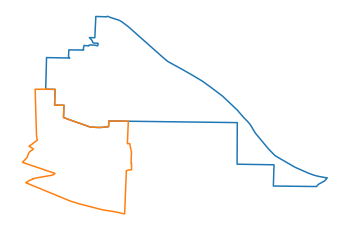

1821. Nodes 710 and 709 are connected


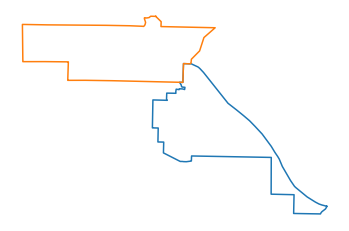

1822. Nodes 711 and 619 are connected


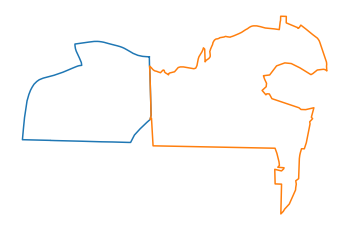

1823. Nodes 711 and 628 are connected


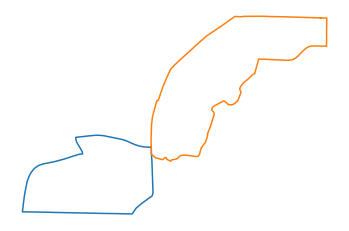

1824. Nodes 711 and 656 are connected


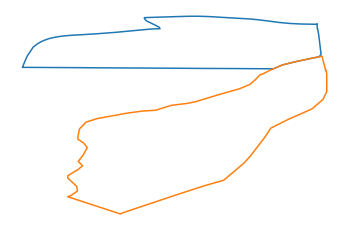

1825. Nodes 711 and 669 are connected


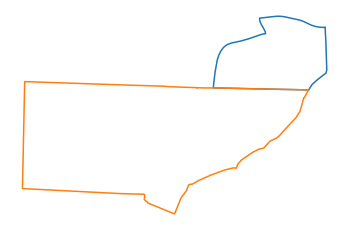

1826. Nodes 711 and 674 are connected


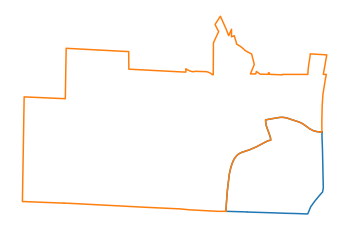

1827. Nodes 712 and 610 are connected


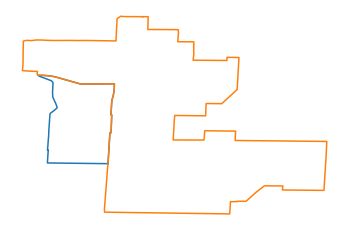

1828. Nodes 712 and 612 are connected


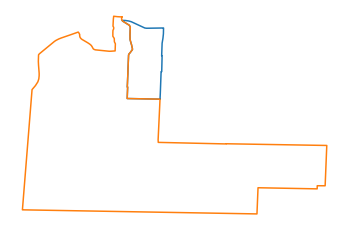

1829. Nodes 713 and 631 are connected


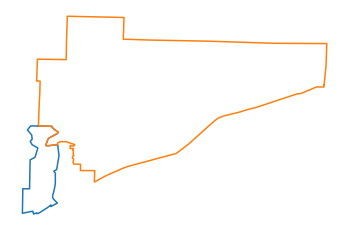

1830. Nodes 713 and 638 are connected


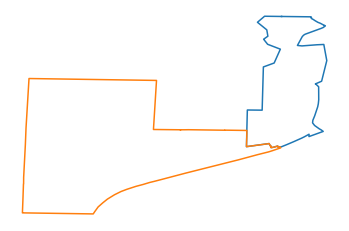

1831. Nodes 713 and 675 are connected


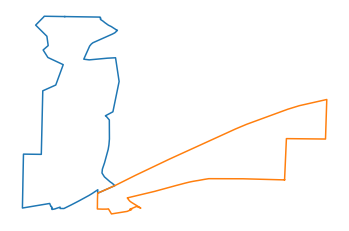

1832. Nodes 713 and 677 are connected


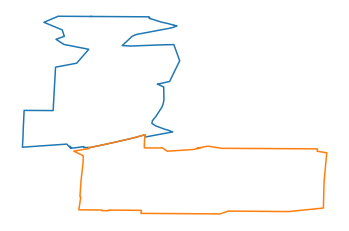

1833. Nodes 713 and 706 are connected


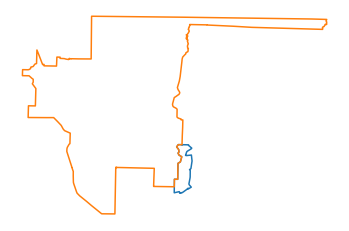

1834. Nodes 714 and 631 are connected


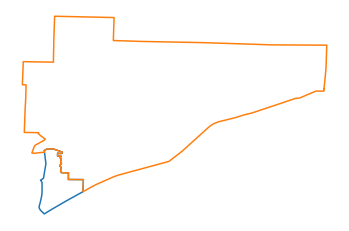

1835. Nodes 714 and 675 are connected


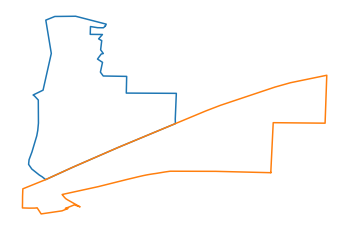

1836. Nodes 714 and 713 are connected


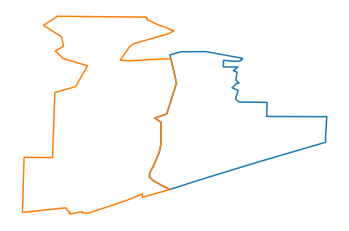

1837. Nodes 715 and 608 are connected


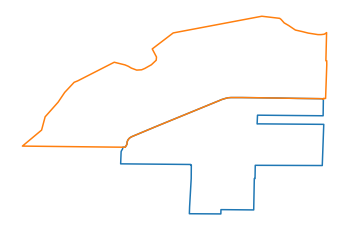

1838. Nodes 715 and 632 are connected


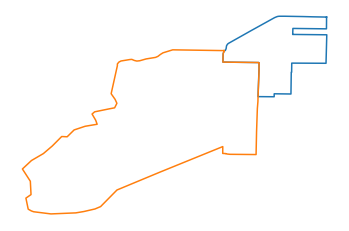

1839. Nodes 715 and 687 are connected


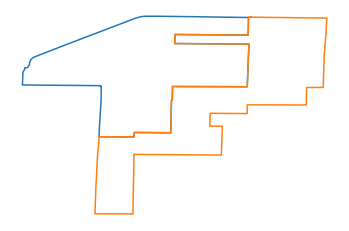

1840. Nodes 716 and 621 are connected


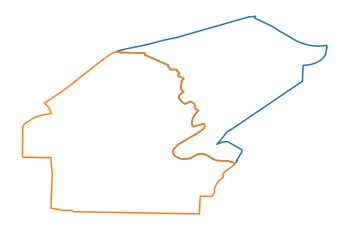

1841. Nodes 716 and 631 are connected


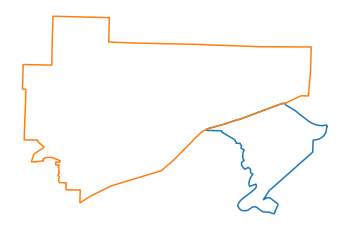

1842. Nodes 716 and 688 are connected


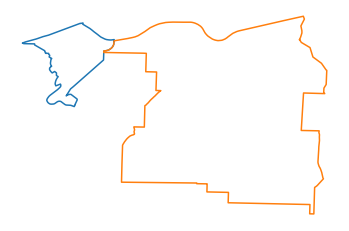

1843. Nodes 716 and 689 are connected


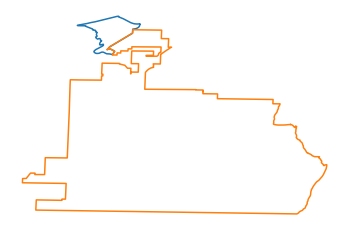

1844. Nodes 716 and 698 are connected


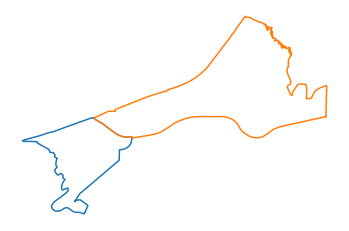

1845. Nodes 717 and 627 are connected


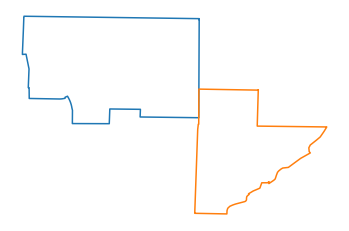

1846. Nodes 717 and 685 are connected


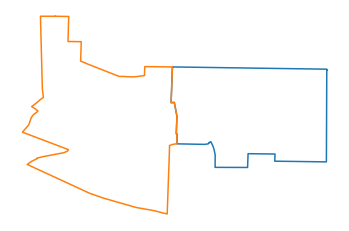

1847. Nodes 717 and 710 are connected


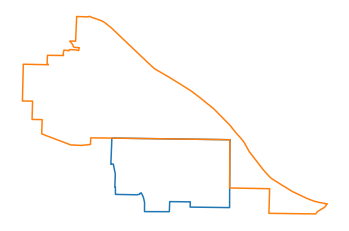

1848. Nodes 718 and 627 are connected


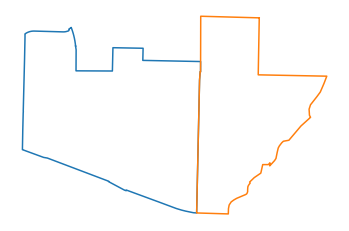

1849. Nodes 718 and 643 are connected


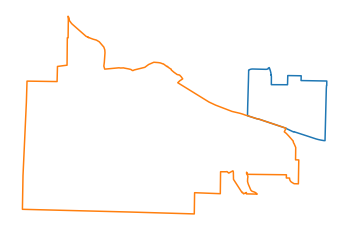

1850. Nodes 718 and 645 are connected


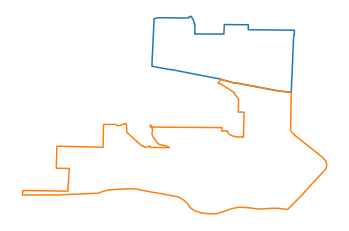

1851. Nodes 718 and 685 are connected


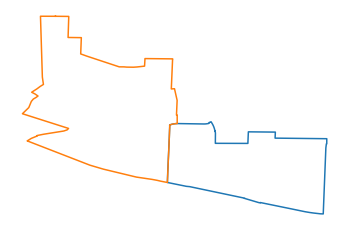

1852. Nodes 718 and 717 are connected


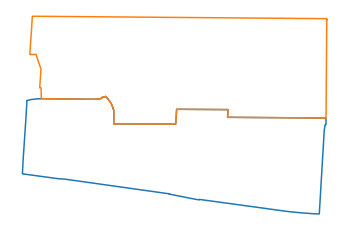

1853. Nodes 722 and 719 are connected


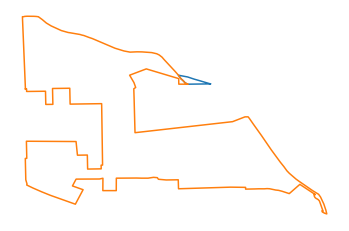

1854. Nodes 724 and 719 are connected


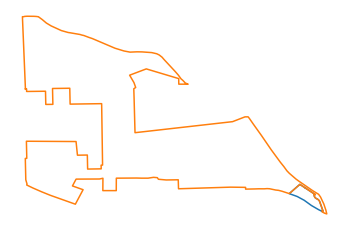

1855. Nodes 726 and 722 are connected


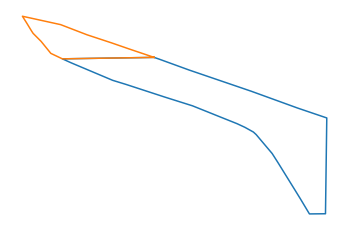

1856. Nodes 726 and 723 are connected


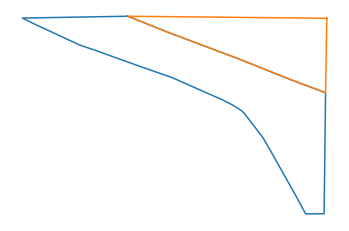

1857. Nodes 727 and 719 are connected


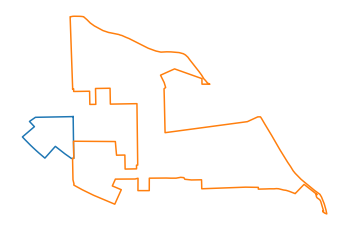

1858. Nodes 729 and 719 are connected


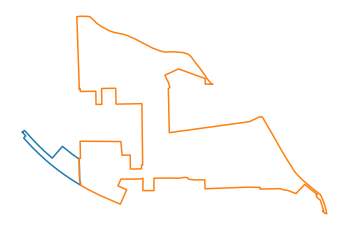

1859. Nodes 729 and 721 are connected


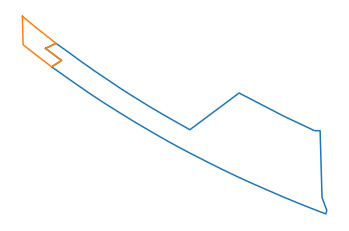

1860. Nodes 729 and 727 are connected


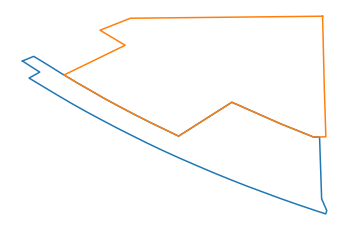

1861. Nodes 731 and 719 are connected


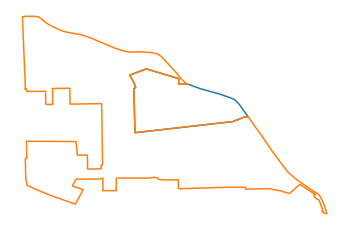

1862. Nodes 731 and 726 are connected


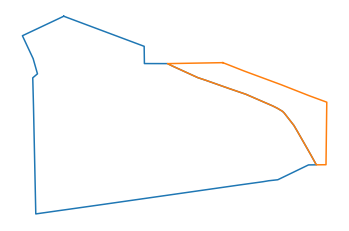

1863. Nodes 733 and 719 are connected


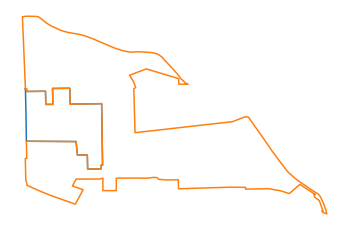

1864. Nodes 733 and 727 are connected


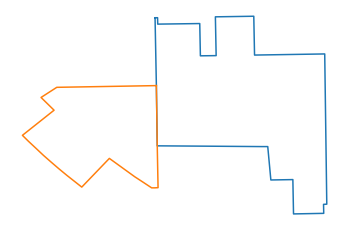

1865. Nodes 734 and 719 are connected


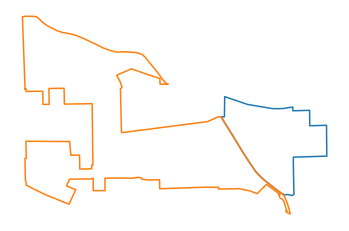

1866. Nodes 734 and 726 are connected


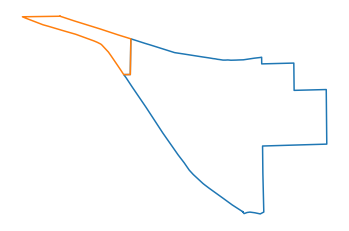

1867. Nodes 734 and 728 are connected


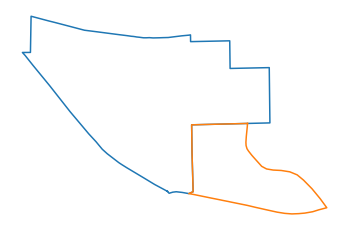

1868. Nodes 735 and 720 are connected


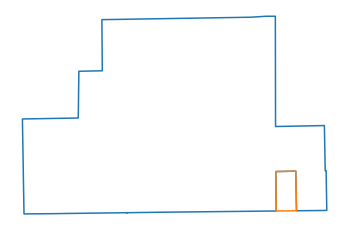

1869. Nodes 735 and 725 are connected


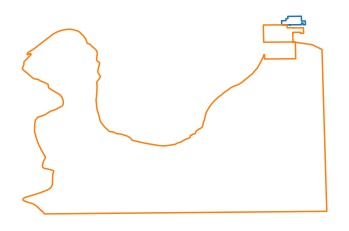

1870. Nodes 736 and 719 are connected


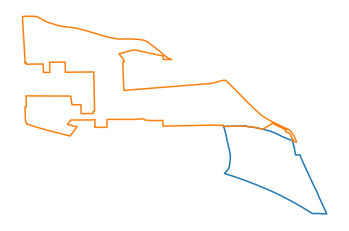

1871. Nodes 736 and 724 are connected


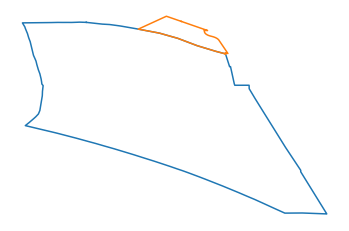

1872. Nodes 737 and 725 are connected


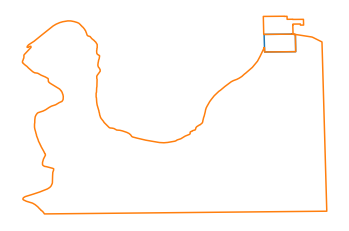

1873. Nodes 739 and 719 are connected


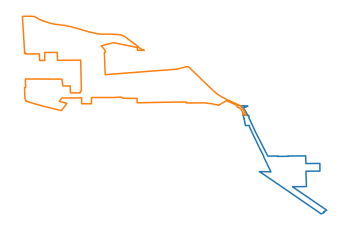

1874. Nodes 739 and 734 are connected


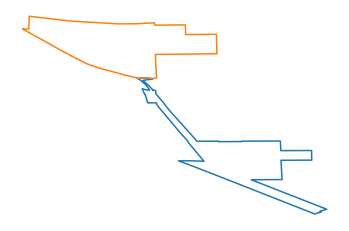

1875. Nodes 739 and 736 are connected


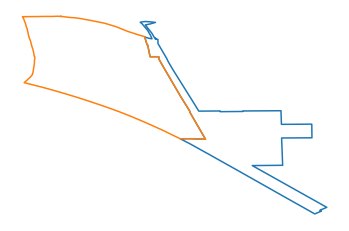

1876. Nodes 741 and 739 are connected


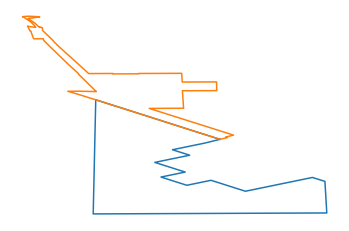

1877. Nodes 742 and 730 are connected


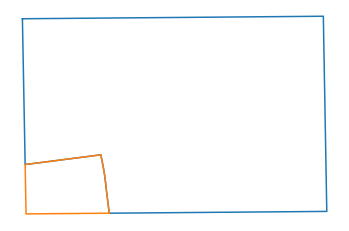

1878. Nodes 743 and 720 are connected


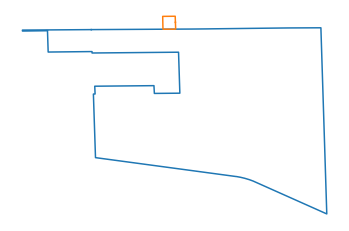

1879. Nodes 743 and 725 are connected


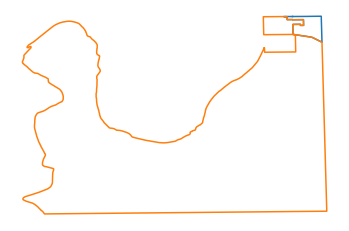

1880. Nodes 743 and 735 are connected


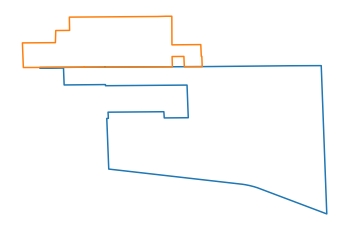

1881. Nodes 744 and 739 are connected


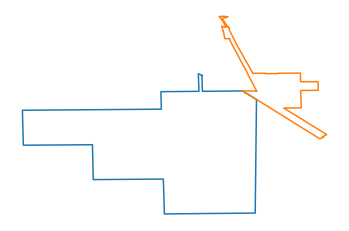

1882. Nodes 744 and 741 are connected


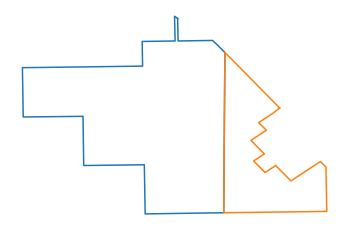

1883. Nodes 745 and 719 are connected


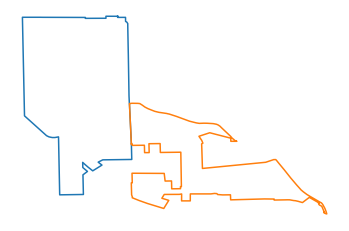

1884. Nodes 745 and 721 are connected


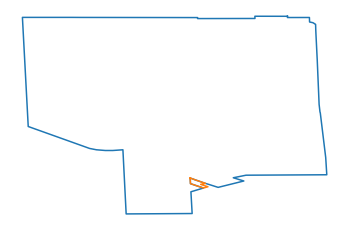

1885. Nodes 745 and 727 are connected


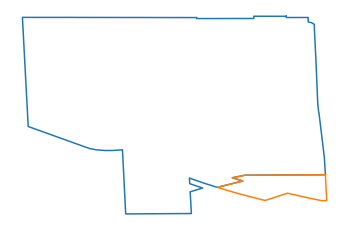

1886. Nodes 745 and 729 are connected


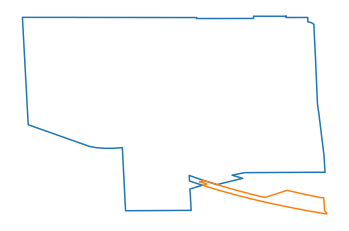

1887. Nodes 745 and 733 are connected


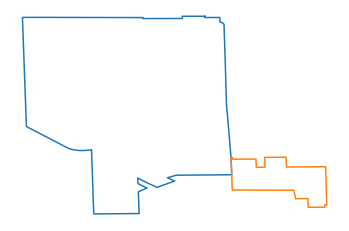

1888. Nodes 746 and 725 are connected


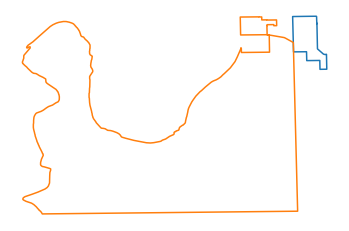

1889. Nodes 746 and 743 are connected


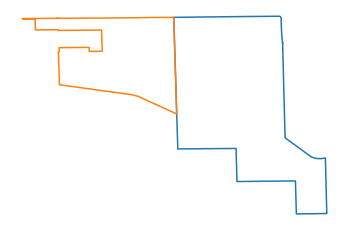

1890. Nodes 746 and 745 are connected


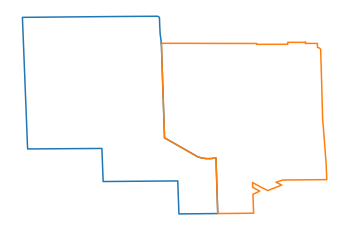

1891. Nodes 747 and 108 are connected


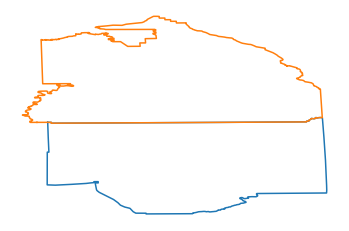

1892. Nodes 747 and 742 are connected


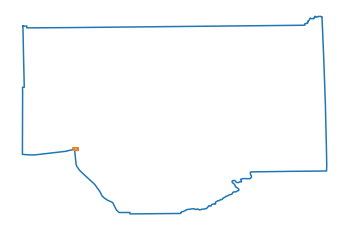

1893. Nodes 748 and 719 are connected


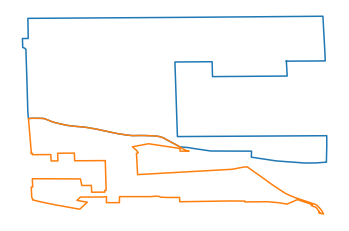

1894. Nodes 748 and 722 are connected


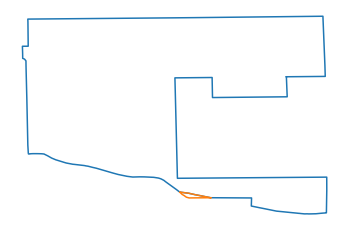

1895. Nodes 748 and 723 are connected


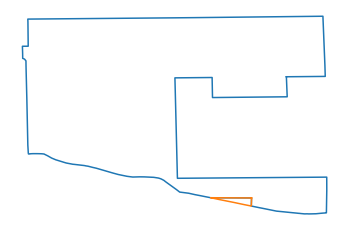

1896. Nodes 748 and 734 are connected


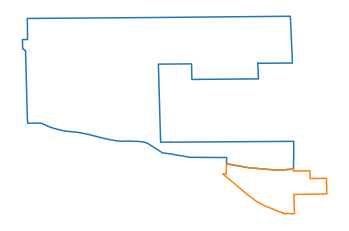

1897. Nodes 748 and 740 are connected


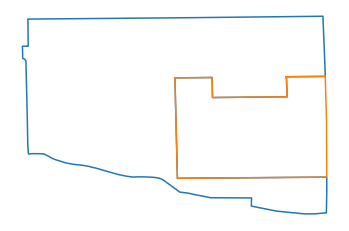

1898. Nodes 748 and 745 are connected


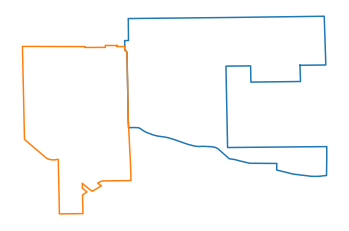

1899. Nodes 749 and 732 are connected


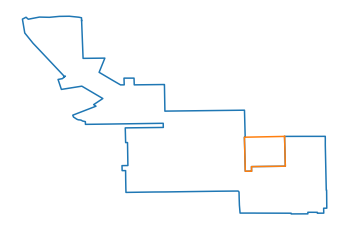

1900. Nodes 749 and 738 are connected


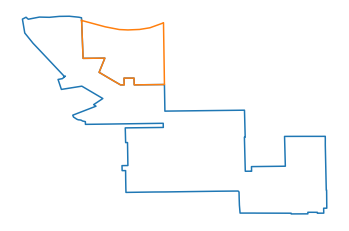

1901. Nodes 749 and 743 are connected


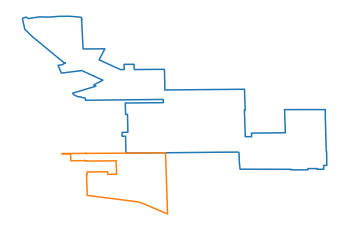

1902. Nodes 749 and 745 are connected


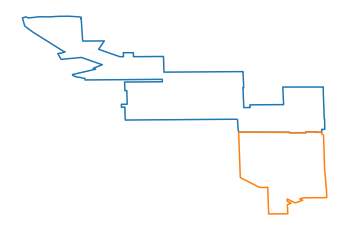

1903. Nodes 749 and 746 are connected


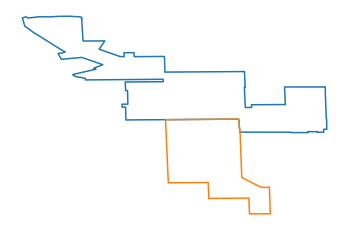

1904. Nodes 749 and 748 are connected


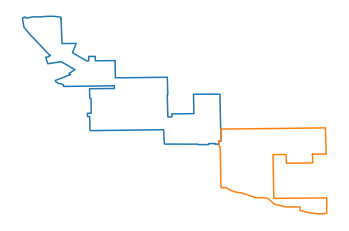

1905. Nodes 750 and 729 are connected


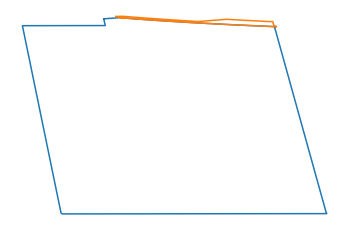

1906. Nodes 750 and 745 are connected


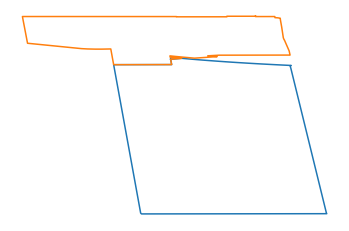

1907. Nodes 751 and 725 are connected


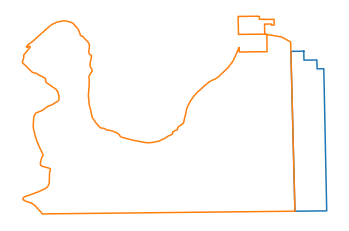

1908. Nodes 751 and 746 are connected


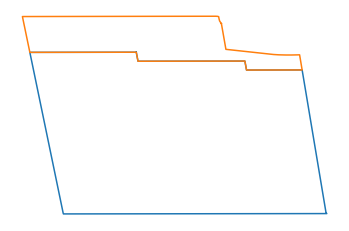

1909. Nodes 751 and 750 are connected


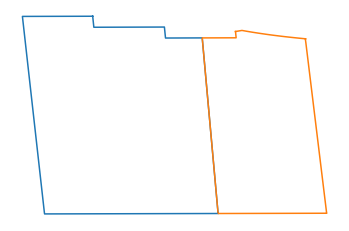

1910. Nodes 752 and 741 are connected


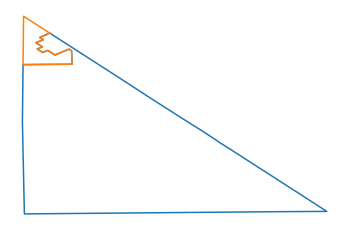

1911. Nodes 753 and 739 are connected


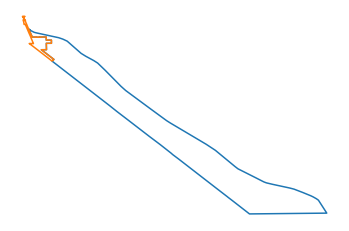

1912. Nodes 753 and 752 are connected


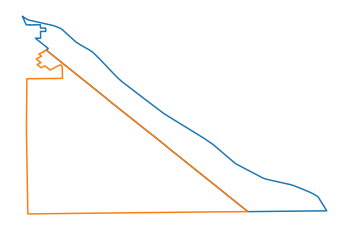

1913. Nodes 754 and 719 are connected


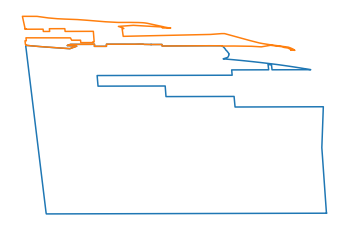

1914. Nodes 754 and 736 are connected


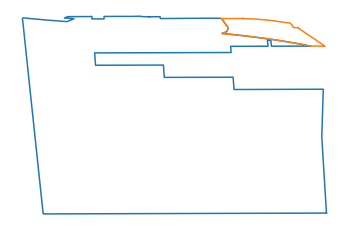

1915. Nodes 754 and 744 are connected


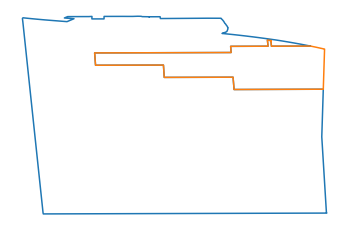

1916. Nodes 754 and 750 are connected


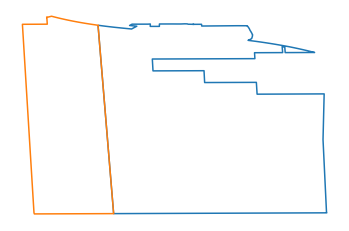

1917. Nodes 754 and 752 are connected


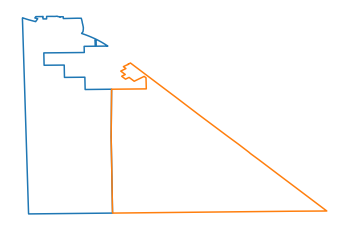

1918. Nodes 755 and 747 are connected


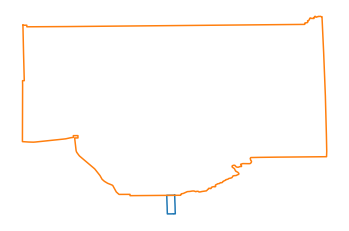

1919. Nodes 755 and 748 are connected


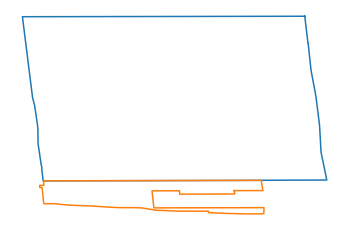

1920. Nodes 755 and 749 are connected


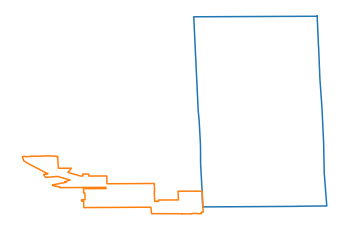

1921. Nodes 756 and 747 are connected


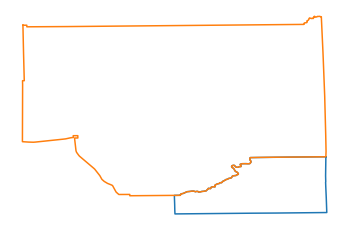

1922. Nodes 756 and 755 are connected


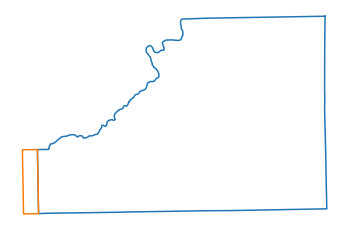

1923. Nodes 757 and 732 are connected


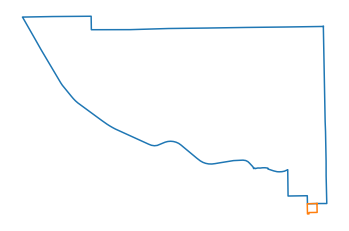

1924. Nodes 757 and 738 are connected


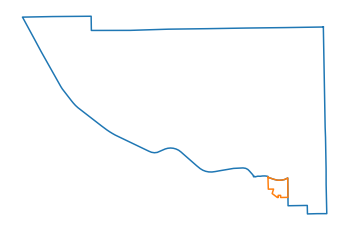

1925. Nodes 757 and 747 are connected


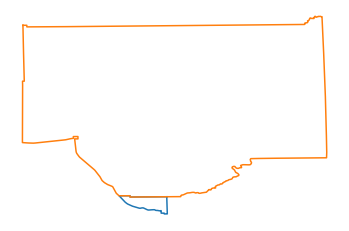

1926. Nodes 757 and 749 are connected


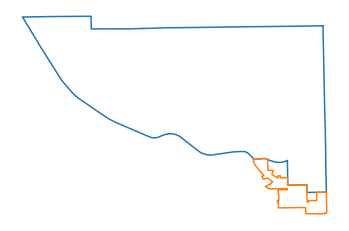

1927. Nodes 757 and 755 are connected


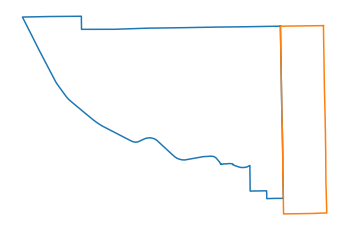

1928. Nodes 758 and 728 are connected


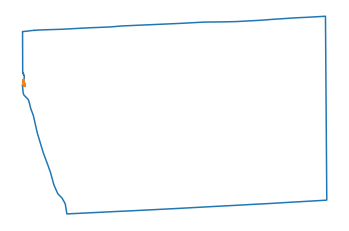

1929. Nodes 758 and 734 are connected


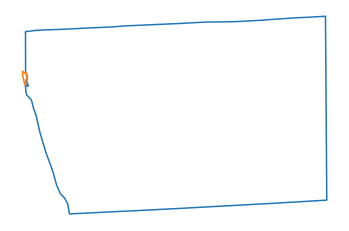

1930. Nodes 758 and 739 are connected


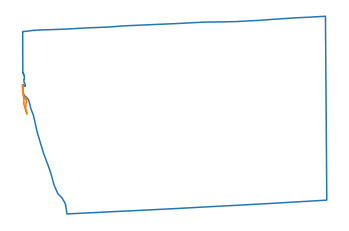

1931. Nodes 758 and 740 are connected


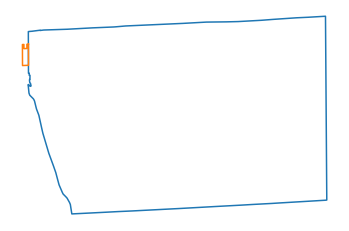

1932. Nodes 758 and 748 are connected


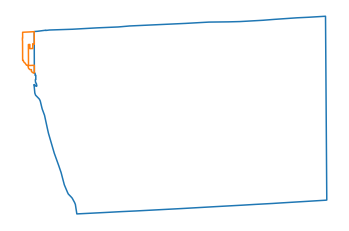

1933. Nodes 758 and 753 are connected


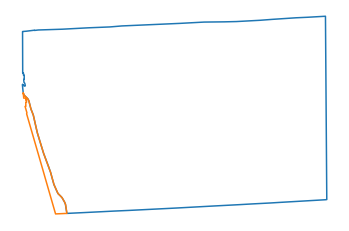

1934. Nodes 758 and 755 are connected


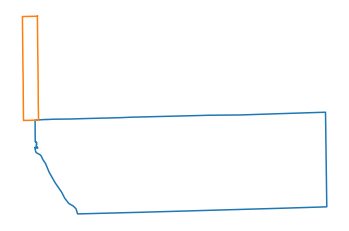

1935. Nodes 758 and 756 are connected


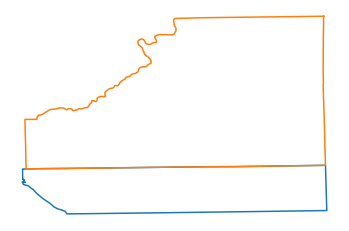

1936. Nodes 759 and 730 are connected


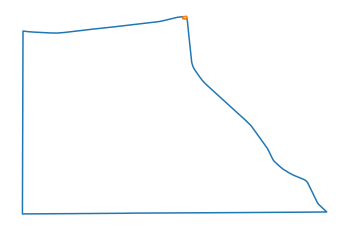

1937. Nodes 759 and 747 are connected


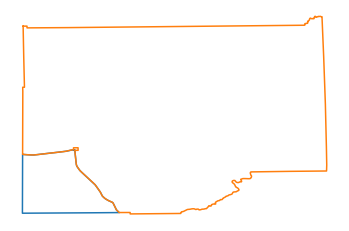

1938. Nodes 760 and 96 are connected


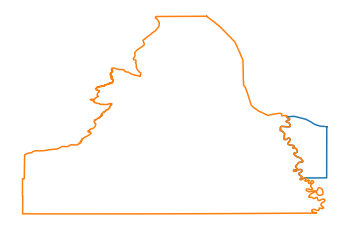

1939. Nodes 760 and 759 are connected


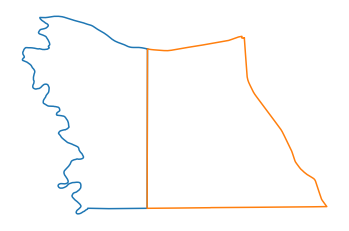

1940. Nodes 761 and 96 are connected


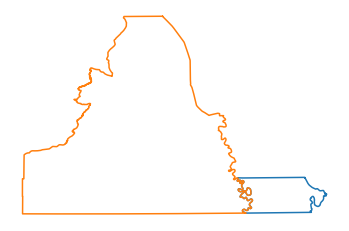

1941. Nodes 761 and 725 are connected


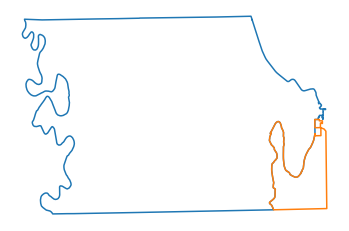

1942. Nodes 761 and 735 are connected


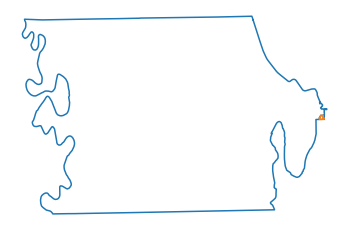

1943. Nodes 761 and 737 are connected


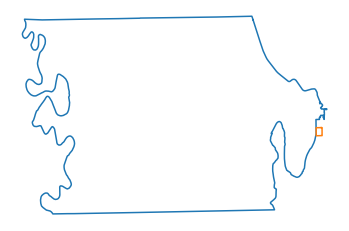

1944. Nodes 761 and 749 are connected


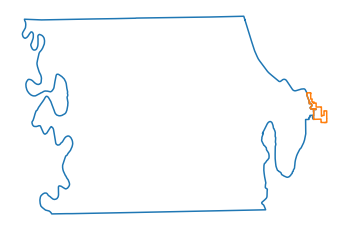

1945. Nodes 761 and 757 are connected


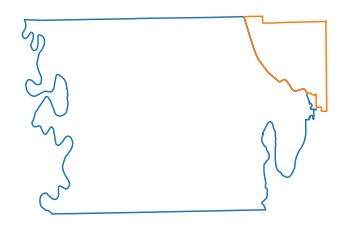

1946. Nodes 761 and 759 are connected


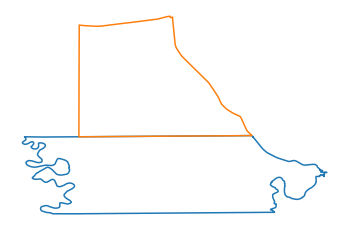

1947. Nodes 761 and 760 are connected


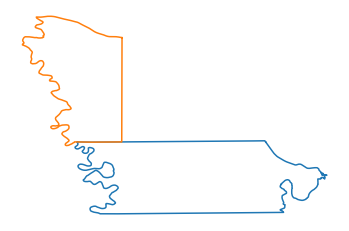

1948. Nodes 762 and 89 are connected


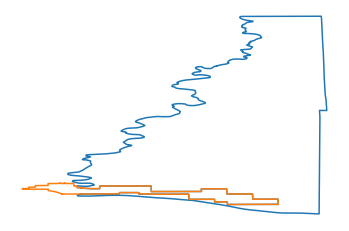

1949. Nodes 762 and 90 are connected


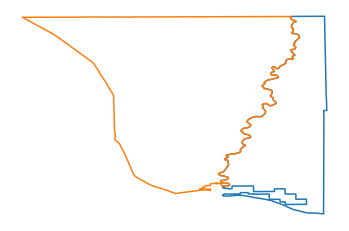

1950. Nodes 762 and 96 are connected


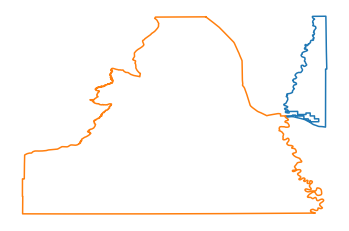

1951. Nodes 762 and 108 are connected


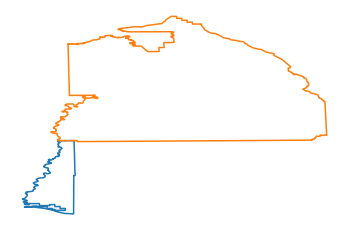

1952. Nodes 762 and 747 are connected


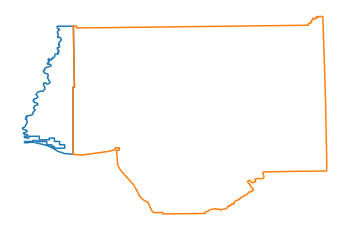

1953. Nodes 762 and 760 are connected


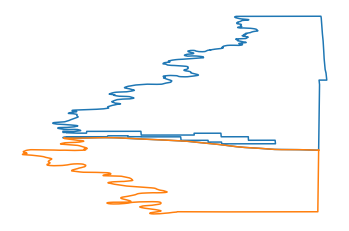

1954. Nodes 763 and 31 are connected


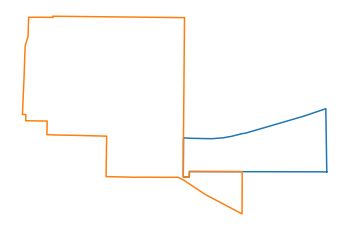

1955. Nodes 763 and 53 are connected


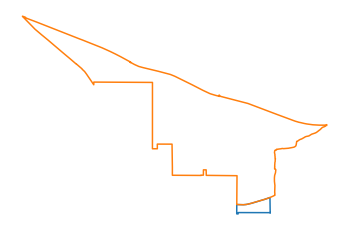

1956. Nodes 763 and 56 are connected


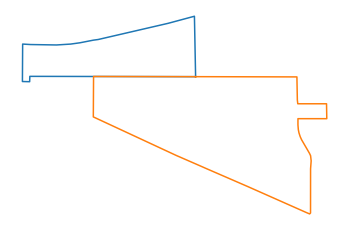

1957. Nodes 764 and 384 are connected


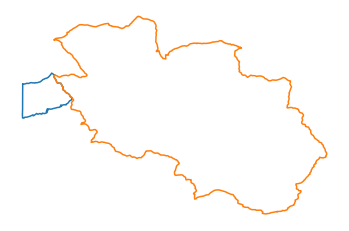

1958. Nodes 765 and 384 are connected


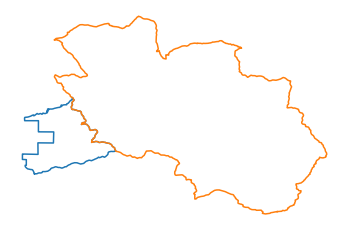

1959. Nodes 765 and 764 are connected


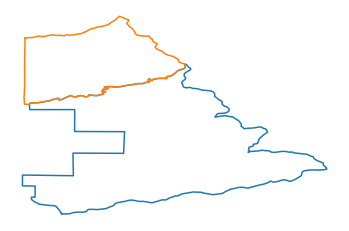

1960. Nodes 766 and 382 are connected


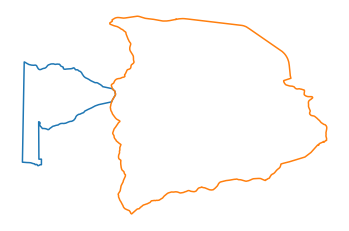

1961. Nodes 767 and 383 are connected


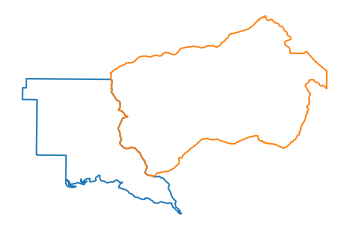

1962. Nodes 767 and 384 are connected


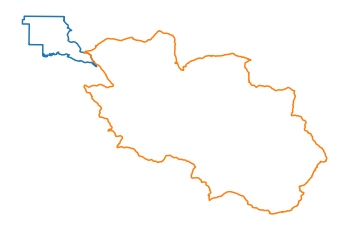

1963. Nodes 771 and 767 are connected


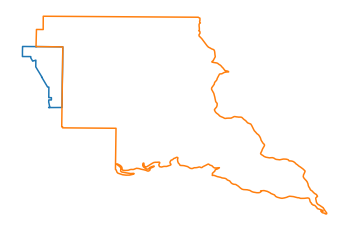

1964. Nodes 772 and 69 are connected


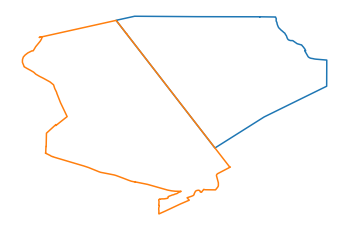

1965. Nodes 774 and 768 are connected


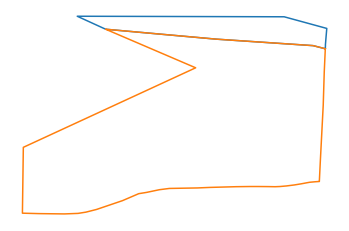

1966. Nodes 775 and 769 are connected


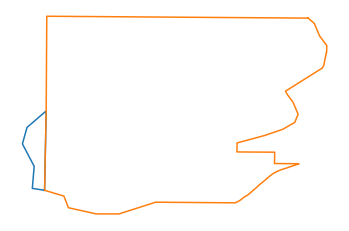

1967. Nodes 778 and 377 are connected


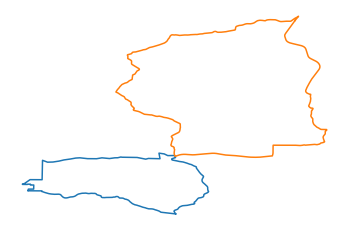

1968. Nodes 778 and 382 are connected


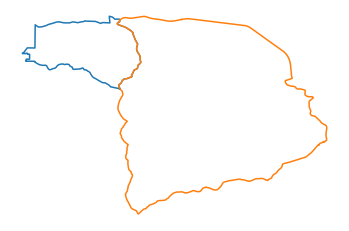

1969. Nodes 778 and 766 are connected


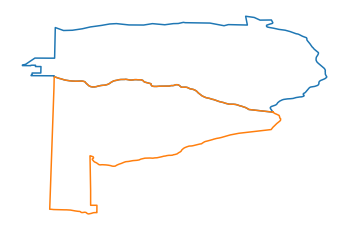

1970. Nodes 779 and 767 are connected


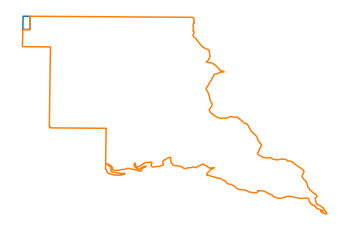

1971. Nodes 781 and 765 are connected


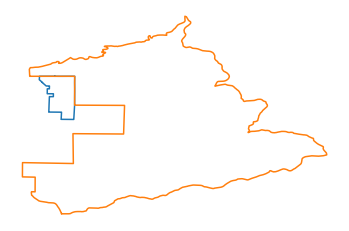

1972. Nodes 782 and 764 are connected


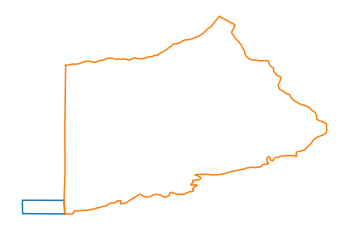

1973. Nodes 783 and 764 are connected


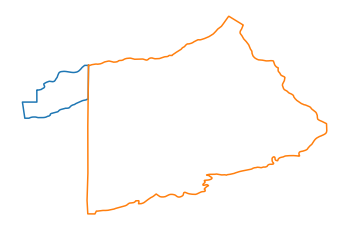

1974. Nodes 784 and 783 are connected


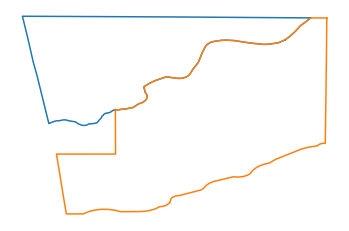

1975. Nodes 785 and 764 are connected


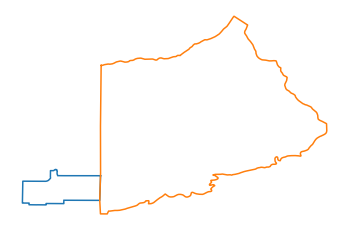

1976. Nodes 785 and 782 are connected


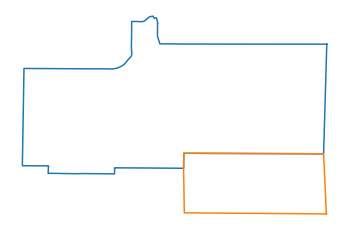

1977. Nodes 786 and 769 are connected


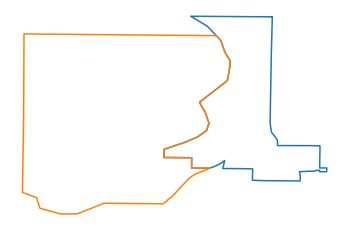

1978. Nodes 787 and 765 are connected


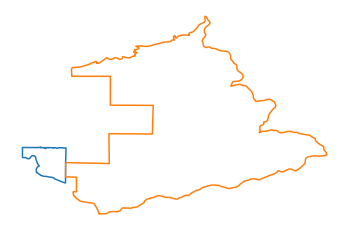

1979. Nodes 794 and 774 are connected


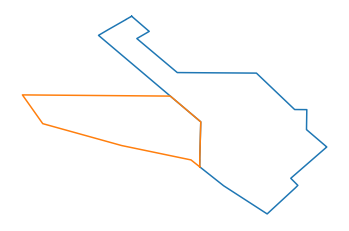

1980. Nodes 794 and 793 are connected


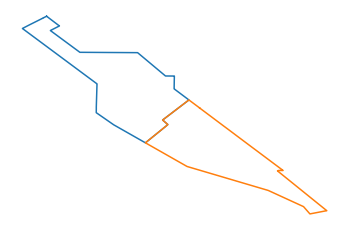

1981. Nodes 795 and 768 are connected


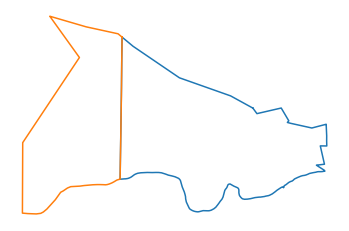

1982. Nodes 795 and 793 are connected


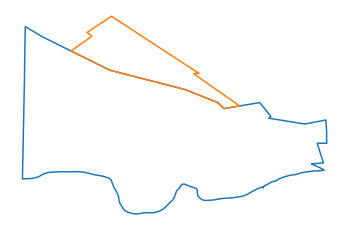

1983. Nodes 795 and 794 are connected


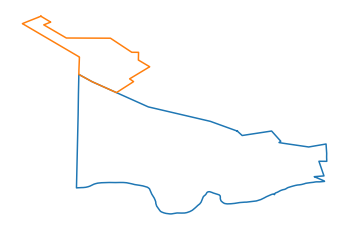

1984. Nodes 796 and 786 are connected


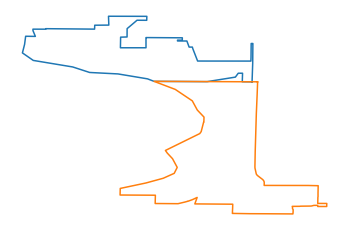

1985. Nodes 797 and 764 are connected


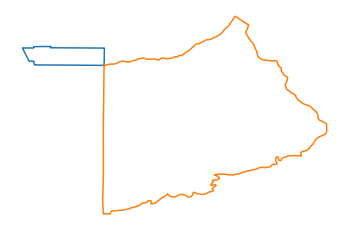

1986. Nodes 797 and 783 are connected


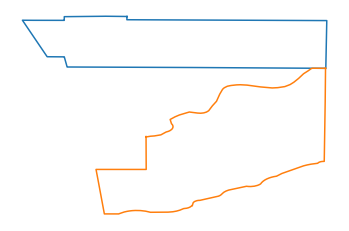

1987. Nodes 797 and 784 are connected


1988. Nodes 798 and 797 are connected


1989. Nodes 799 and 767 are connected


1990. Nodes 800 and 767 are connected


1991. Nodes 801 and 793 are connected


1992. Nodes 802 and 801 are connected


1993. Nodes 803 and 789 are connected


1994. Nodes 805 and 793 are connected


1995. Nodes 805 and 795 are connected


1996. Nodes 805 and 801 are connected


1997. Nodes 805 and 802 are connected


1998. Nodes 806 and 777 are connected


1999. Nodes 807 and 792 are connected


2000. Nodes 813 and 766 are connected


2001. Nodes 814 and 813 are connected


2002. Nodes 816 and 811 are connected


2003. Nodes 817 and 811 are connected


2004. Nodes 817 and 816 are connected


2005. Nodes 818 and 773 are connected


2006. Nodes 820 and 810 are connected


2007. Nodes 820 and 819 are connected


2008. Nodes 821 and 806 are connected


2009. Nodes 821 and 819 are connected


2010. Nodes 823 and 806 are connected


2011. Nodes 823 and 819 are connected


2012. Nodes 825 and 824 are connected


2013. Nodes 826 and 771 are connected


2014. Nodes 826 and 808 are connected


2015. Nodes 827 and 773 are connected


2016. Nodes 827 and 816 are connected


2017. Nodes 829 and 777 are connected


2018. Nodes 829 and 806 are connected


2019. Nodes 834 and 830 are connected


2020. Nodes 834 and 831 are connected


2021. Nodes 834 and 832 are connected


2022. Nodes 836 and 789 are connected


2023. Nodes 837 and 798 are connected


2024. Nodes 837 and 799 are connected


2025. Nodes 838 and 835 are connected


2026. Nodes 839 and 802 are connected


2027. Nodes 839 and 838 are connected


2028. Nodes 840 and 789 are connected


2029. Nodes 840 and 800 are connected


2030. Nodes 840 and 836 are connected


2031. Nodes 841 and 805 are connected


2032. Nodes 841 and 839 are connected


2033. Nodes 842 and 806 are connected


2034. Nodes 843 and 842 are connected


2035. Nodes 844 and 811 are connected


2036. Nodes 844 and 816 are connected


2037. Nodes 845 and 816 are connected


2038. Nodes 845 and 827 are connected


2039. Nodes 845 and 844 are connected


2040. Nodes 846 and 817 are connected


2041. Nodes 846 and 827 are connected


2042. Nodes 846 and 844 are connected


2043. Nodes 846 and 845 are connected


2044. Nodes 847 and 812 are connected


2045. Nodes 847 and 818 are connected


2046. Nodes 847 and 827 are connected


2047. Nodes 847 and 828 are connected


2048. Nodes 847 and 846 are connected


2049. Nodes 848 and 767 are connected


2050. Nodes 848 and 800 are connected


2051. Nodes 849 and 384 are connected


2052. Nodes 849 and 764 are connected


2053. Nodes 849 and 767 are connected


2054. Nodes 849 and 797 are connected


2055. Nodes 849 and 798 are connected


2056. Nodes 849 and 799 are connected


2057. Nodes 849 and 837 are connected


2058. Nodes 850 and 768 are connected


2059. Nodes 850 and 769 are connected


2060. Nodes 850 and 772 are connected


2061. Nodes 850 and 775 are connected


2062. Nodes 851 and 775 are connected


2063. Nodes 851 and 776 are connected


2064. Nodes 851 and 850 are connected


2065. Nodes 852 and 765 are connected


2066. Nodes 852 and 770 are connected


2067. Nodes 852 and 787 are connected


2068. Nodes 853 and 765 are connected


2069. Nodes 854 and 767 are connected


2070. Nodes 854 and 799 are connected


2071. Nodes 854 and 848 are connected


2072. Nodes 855 and 769 are connected


2073. Nodes 855 and 786 are connected


2074. Nodes 855 and 795 are connected


2075. Nodes 855 and 796 are connected


2076. Nodes 855 and 805 are connected


2077. Nodes 855 and 850 are connected


2078. Nodes 856 and 772 are connected


2079. Nodes 856 and 773 are connected


2080. Nodes 856 and 812 are connected


2081. Nodes 856 and 818 are connected


2082. Nodes 856 and 828 are connected


2083. Nodes 857 and 764 are connected


2084. Nodes 857 and 765 are connected


2085. Nodes 858 and 765 are connected


2086. Nodes 858 and 781 are connected


2087. Nodes 859 and 765 are connected


2088. Nodes 859 and 787 are connected


2089. Nodes 859 and 852 are connected


2090. Nodes 861 and 769 are connected


2091. Nodes 861 and 788 are connected


2092. Nodes 861 and 851 are connected


2093. Nodes 862 and 776 are connected


2094. Nodes 863 and 834 are connected


2095. Nodes 864 and 854 are connected


2096. Nodes 865 and 800 are connected


2097. Nodes 865 and 840 are connected


2098. Nodes 865 and 854 are connected


2099. Nodes 867 and 790 are connected


2100. Nodes 868 and 768 are connected


2101. Nodes 868 and 772 are connected


2102. Nodes 868 and 812 are connected


2103. Nodes 868 and 856 are connected


2104. Nodes 869 and 774 are connected


2105. Nodes 869 and 860 are connected


2106. Nodes 869 and 868 are connected


2107. Nodes 871 and 824 are connected


2108. Nodes 872 and 807 are connected


2109. Nodes 873 and 813 are connected


2110. Nodes 876 and 830 are connected


2111. Nodes 876 and 831 are connected


2112. Nodes 876 and 833 are connected


2113. Nodes 876 and 834 are connected


2114. Nodes 877 and 780 are connected


2115. Nodes 877 and 830 are connected


2116. Nodes 877 and 876 are connected


2117. Nodes 878 and 834 are connected


2118. Nodes 879 and 382 are connected


2119. Nodes 879 and 383 are connected


2120. Nodes 879 and 766 are connected


2121. Nodes 879 and 767 are connected


2122. Nodes 879 and 779 are connected


2123. Nodes 879 and 813 are connected


2124. Nodes 880 and 776 are connected


2125. Nodes 880 and 788 are connected


2126. Nodes 880 and 861 are connected


2127. Nodes 881 and 824 are connected


2128. Nodes 881 and 843 are connected


2129. Nodes 882 and 815 are connected


2130. Nodes 882 and 824 are connected


2131. Nodes 882 and 881 are connected


2132. Nodes 883 and 882 are connected


2133. Nodes 884 and 824 are connected


2134. Nodes 884 and 882 are connected


2135. Nodes 884 and 883 are connected


2136. Nodes 885 and 824 are connected


2137. Nodes 885 and 884 are connected


2138. Nodes 886 and 824 are connected


2139. Nodes 886 and 825 are connected


2140. Nodes 886 and 885 are connected


2141. Nodes 887 and 873 are connected


2142. Nodes 888 and 815 are connected


2143. Nodes 889 and 766 are connected


2144. Nodes 889 and 778 are connected


2145. Nodes 889 and 813 are connected


2146. Nodes 889 and 814 are connected


2147. Nodes 890 and 886 are connected


2148. Nodes 891 and 887 are connected


2149. Nodes 891 and 890 are connected


2150. Nodes 892 and 815 are connected


2151. Nodes 892 and 882 are connected


2152. Nodes 892 and 883 are connected


2153. Nodes 892 and 884 are connected


2154. Nodes 892 and 885 are connected


2155. Nodes 892 and 886 are connected


2156. Nodes 892 and 888 are connected


2157. Nodes 892 and 890 are connected


2158. Nodes 893 and 890 are connected


2159. Nodes 893 and 891 are connected


2160. Nodes 893 and 892 are connected


2161. Nodes 894 and 873 are connected


2162. Nodes 894 and 887 are connected


2163. Nodes 894 and 891 are connected


2164. Nodes 894 and 893 are connected


2165. Nodes 895 and 813 are connected


2166. Nodes 895 and 888 are connected


2167. Nodes 895 and 892 are connected


2168. Nodes 895 and 893 are connected


2169. Nodes 895 and 894 are connected


2170. Nodes 896 and 813 are connected


2171. Nodes 896 and 873 are connected


2172. Nodes 896 and 894 are connected


2173. Nodes 896 and 895 are connected


2174. Nodes 897 and 813 are connected


2175. Nodes 897 and 873 are connected


2176. Nodes 897 and 896 are connected


2177. Nodes 898 and 777 are connected


2178. Nodes 898 and 829 are connected


2179. Nodes 898 and 889 are connected


2180. Nodes 899 and 821 are connected


2181. Nodes 899 and 822 are connected


2182. Nodes 900 and 816 are connected


2183. Nodes 902 and 901 are connected


2184. Nodes 903 and 812 are connected


2185. Nodes 903 and 847 are connected


2186. Nodes 903 and 868 are connected


2187. Nodes 904 and 868 are connected


2188. Nodes 904 and 903 are connected


2189. Nodes 905 and 868 are connected


2190. Nodes 905 and 869 are connected


2191. Nodes 906 and 868 are connected


2192. Nodes 906 and 869 are connected


2193. Nodes 906 and 905 are connected


2194. Nodes 907 and 819 are connected


2195. Nodes 907 and 823 are connected


2196. Nodes 908 and 823 are connected


2197. Nodes 908 and 907 are connected


2198. Nodes 909 and 888 are connected


2199. Nodes 909 and 895 are connected


2200. Nodes 910 and 804 are connected


2201. Nodes 910 and 807 are connected


2202. Nodes 910 and 872 are connected


2203. Nodes 910 and 875 are connected


2204. Nodes 912 and 911 are connected


2205. Nodes 913 and 824 are connected


2206. Nodes 913 and 881 are connected


2207. Nodes 914 and 875 are connected


2208. Nodes 914 and 910 are connected


2209. Nodes 915 and 804 are connected


2210. Nodes 915 and 910 are connected


2211. Nodes 915 and 914 are connected


2212. Nodes 916 and 915 are connected


2213. Nodes 917 and 870 are connected


2214. Nodes 917 and 916 are connected


2215. Nodes 918 and 791 are connected


2216. Nodes 918 and 917 are connected


2217. Nodes 919 and 791 are connected


2218. Nodes 919 and 918 are connected


2219. Nodes 920 and 915 are connected


2220. Nodes 920 and 916 are connected


2221. Nodes 920 and 917 are connected


2222. Nodes 920 and 918 are connected


2223. Nodes 920 and 919 are connected


2224. Nodes 921 and 919 are connected


2225. Nodes 921 and 920 are connected


2226. Nodes 922 and 802 are connected


2227. Nodes 922 and 915 are connected


2228. Nodes 922 and 920 are connected


2229. Nodes 922 and 921 are connected


2230. Nodes 923 and 802 are connected


2231. Nodes 923 and 921 are connected


2232. Nodes 923 and 922 are connected


2233. Nodes 924 and 802 are connected


2234. Nodes 924 and 839 are connected


2235. Nodes 924 and 923 are connected


2236. Nodes 925 and 792 are connected


2237. Nodes 925 and 801 are connected


2238. Nodes 925 and 802 are connected


2239. Nodes 925 and 872 are connected


2240. Nodes 925 and 910 are connected


2241. Nodes 925 and 915 are connected


2242. Nodes 925 and 922 are connected


2243. Nodes 926 and 767 are connected


2244. Nodes 926 and 771 are connected


2245. Nodes 926 and 800 are connected


2246. Nodes 926 and 840 are connected


2247. Nodes 927 and 771 are connected


2248. Nodes 927 and 808 are connected


2249. Nodes 927 and 826 are connected


2250. Nodes 927 and 840 are connected


2251. Nodes 927 and 926 are connected


2252. Nodes 928 and 791 are connected


2253. Nodes 928 and 808 are connected


2254. Nodes 928 and 918 are connected


2255. Nodes 928 and 919 are connected


2256. Nodes 928 and 921 are connected


2257. Nodes 928 and 927 are connected


2258. Nodes 929 and 803 are connected


2259. Nodes 929 and 836 are connected


2260. Nodes 929 and 840 are connected


2261. Nodes 929 and 865 are connected


2262. Nodes 930 and 854 are connected


2263. Nodes 930 and 864 are connected


2264. Nodes 930 and 865 are connected


2265. Nodes 930 and 929 are connected


2266. Nodes 931 and 841 are connected


2267. Nodes 932 and 930 are connected


2268. Nodes 933 and 805 are connected


2269. Nodes 933 and 855 are connected


2270. Nodes 933 and 931 are connected


2271. Nodes 933 and 932 are connected


2272. Nodes 934 and 854 are connected


2273. Nodes 934 and 864 are connected


2274. Nodes 934 and 930 are connected


2275. Nodes 934 and 932 are connected


2276. Nodes 935 and 799 are connected


2277. Nodes 935 and 837 are connected


2278. Nodes 935 and 854 are connected


2279. Nodes 935 and 932 are connected


2280. Nodes 935 and 934 are connected


2281. Nodes 936 and 932 are connected


2282. Nodes 936 and 933 are connected


2283. Nodes 936 and 935 are connected


2284. Nodes 937 and 837 are connected


2285. Nodes 937 and 933 are connected


2286. Nodes 937 and 935 are connected


2287. Nodes 938 and 796 are connected


2288. Nodes 938 and 855 are connected


2289. Nodes 938 and 933 are connected


2290. Nodes 939 and 786 are connected


2291. Nodes 940 and 786 are connected


2292. Nodes 940 and 939 are connected


2293. Nodes 941 and 784 are connected


2294. Nodes 941 and 797 are connected


2295. Nodes 941 and 798 are connected


2296. Nodes 941 and 939 are connected


2297. Nodes 941 and 940 are connected


2298. Nodes 942 and 764 are connected


2299. Nodes 942 and 783 are connected


2300. Nodes 942 and 785 are connected


2301. Nodes 943 and 785 are connected


2302. Nodes 943 and 786 are connected


2303. Nodes 944 and 943 are connected


2304. Nodes 945 and 788 are connected


2305. Nodes 945 and 944 are connected


2306. Nodes 946 and 943 are connected


2307. Nodes 946 and 944 are connected


2308. Nodes 946 and 945 are connected


2309. Nodes 947 and 781 are connected


2310. Nodes 948 and 781 are connected


2311. Nodes 948 and 947 are connected


2312. Nodes 949 and 947 are connected


2313. Nodes 949 and 948 are connected


2314. Nodes 950 and 788 are connected


2315. Nodes 951 and 950 are connected


2316. Nodes 952 and 950 are connected


2317. Nodes 953 and 950 are connected


2318. Nodes 953 and 951 are connected


2319. Nodes 953 and 952 are connected


2320. Nodes 954 and 952 are connected


2321. Nodes 954 and 953 are connected


2322. Nodes 955 and 948 are connected


2323. Nodes 955 and 949 are connected


2324. Nodes 955 and 951 are connected


2325. Nodes 956 and 765 are connected


2326. Nodes 956 and 781 are connected


2327. Nodes 956 and 853 are connected


2328. Nodes 956 and 858 are connected


2329. Nodes 956 and 948 are connected


2330. Nodes 956 and 955 are connected


2331. Nodes 957 and 951 are connected


2332. Nodes 957 and 953 are connected


2333. Nodes 957 and 954 are connected


2334. Nodes 957 and 955 are connected


2335. Nodes 957 and 956 are connected


2336. Nodes 958 and 954 are connected


2337. Nodes 958 and 957 are connected


2338. Nodes 959 and 787 are connected


2339. Nodes 959 and 957 are connected


2340. Nodes 959 and 958 are connected


2341. Nodes 960 and 787 are connected


2342. Nodes 960 and 957 are connected


2343. Nodes 960 and 959 are connected


2344. Nodes 961 and 765 are connected


2345. Nodes 961 and 787 are connected


2346. Nodes 961 and 853 are connected


2347. Nodes 961 and 956 are connected


2348. Nodes 961 and 957 are connected


2349. Nodes 961 and 960 are connected


2350. Nodes 962 and 832 are connected


2351. Nodes 962 and 952 are connected


2352. Nodes 962 and 954 are connected


2353. Nodes 962 and 958 are connected


2354. Nodes 962 and 959 are connected


2355. Nodes 963 and 832 are connected


2356. Nodes 963 and 833 are connected


2357. Nodes 963 and 834 are connected


2358. Nodes 963 and 876 are connected


2359. Nodes 963 and 962 are connected


2360. Nodes 964 and 787 are connected


2361. Nodes 964 and 832 are connected


2362. Nodes 964 and 959 are connected


2363. Nodes 964 and 962 are connected


2364. Nodes 965 and 832 are connected


2365. Nodes 965 and 834 are connected


2366. Nodes 965 and 878 are connected


2367. Nodes 966 and 833 are connected


2368. Nodes 966 and 876 are connected


2369. Nodes 966 and 950 are connected


2370. Nodes 966 and 952 are connected


2371. Nodes 966 and 962 are connected


2372. Nodes 967 and 788 are connected


2373. Nodes 967 and 880 are connected


2374. Nodes 967 and 950 are connected


2375. Nodes 967 and 966 are connected


2376. Nodes 968 and 876 are connected


2377. Nodes 968 and 877 are connected


2378. Nodes 968 and 880 are connected


2379. Nodes 968 and 966 are connected


2380. Nodes 968 and 967 are connected


2381. Nodes 969 and 877 are connected


2382. Nodes 969 and 880 are connected


2383. Nodes 969 and 968 are connected


2384. Nodes 970 and 780 are connected


2385. Nodes 970 and 877 are connected


2386. Nodes 971 and 862 are connected


2387. Nodes 971 and 970 are connected


2388. Nodes 972 and 830 are connected


2389. Nodes 972 and 834 are connected


2390. Nodes 972 and 877 are connected


2391. Nodes 973 and 834 are connected


2392. Nodes 973 and 863 are connected


2393. Nodes 973 and 972 are connected


2394. Nodes 974 and 877 are connected


2395. Nodes 974 and 973 are connected


2396. Nodes 975 and 875 are connected


2397. Nodes 975 and 910 are connected


2398. Nodes 976 and 825 are connected


2399. Nodes 976 and 886 are connected


2400. Nodes 976 and 890 are connected


2401. Nodes 976 and 910 are connected


2402. Nodes 976 and 975 are connected


2403. Nodes 977 and 838 are connected


2404. Nodes 977 and 839 are connected


2405. Nodes 977 and 924 are connected


2406. Nodes 978 and 806 are connected


2407. Nodes 978 and 819 are connected


2408. Nodes 978 and 821 are connected


2409. Nodes 978 and 823 are connected


2410. Nodes 979 and 778 are connected


2411. Nodes 979 and 889 are connected


2412. Nodes 979 and 898 are connected


2413. Nodes 980 and 829 are connected


2414. Nodes 980 and 898 are connected


2415. Nodes 981 and 898 are connected


2416. Nodes 982 and 773 are connected


2417. Nodes 982 and 818 are connected


2418. Nodes 982 and 856 are connected


2419. Nodes 983 and 790 are connected


2420. Nodes 983 and 867 are connected


2421. Nodes 984 and 786 are connected


2422. Nodes 984 and 796 are connected


2423. Nodes 985 and 877 are connected


2424. Nodes 985 and 970 are connected


2425. Nodes 985 and 971 are connected


2426. Nodes 986 and 832 are connected


2427. Nodes 986 and 964 are connected


2428. Nodes 986 and 965 are connected


2429. Nodes 987 and 878 are connected


2430. Nodes 987 and 965 are connected


2431. Nodes 988 and 903 are connected


2432. Nodes 988 and 904 are connected


2433. Nodes 989 and 931 are connected


2434. Nodes 989 and 933 are connected


2435. Nodes 990 and 799 are connected


2436. Nodes 990 and 935 are connected


2437. Nodes 991 and 786 are connected


2438. Nodes 991 and 943 are connected


2439. Nodes 991 and 944 are connected


2440. Nodes 992 and 770 are connected


2441. Nodes 992 and 877 are connected


2442. Nodes 992 and 974 are connected


2443. Nodes 993 and 867 are connected


2444. Nodes 994 and 789 are connected


2445. Nodes 994 and 803 are connected


2446. Nodes 994 and 838 are connected


2447. Nodes 994 and 840 are connected


2448. Nodes 994 and 924 are connected


2449. Nodes 994 and 927 are connected


2450. Nodes 994 and 977 are connected


2451. Nodes 995 and 777 are connected


2452. Nodes 995 and 806 are connected


2453. Nodes 995 and 815 are connected


2454. Nodes 995 and 843 are connected


2455. Nodes 995 and 881 are connected


2456. Nodes 995 and 882 are connected


2457. Nodes 995 and 888 are connected


2458. Nodes 996 and 790 are connected


2459. Nodes 997 and 846 are connected


2460. Nodes 997 and 847 are connected


2461. Nodes 997 and 903 are connected


2462. Nodes 997 and 904 are connected


2463. Nodes 997 and 988 are connected


2464. Nodes 998 and 813 are connected


2465. Nodes 998 and 814 are connected


2466. Nodes 998 and 889 are connected


2467. Nodes 998 and 895 are connected


2468. Nodes 998 and 898 are connected


2469. Nodes 998 and 909 are connected


2470. Nodes 999 and 810 are connected


2471. Nodes 999 and 820 are connected


2472. Nodes 1001 and 900 are connected


2473. Nodes 1002 and 902 are connected


2474. Nodes 1002 and 1000 are connected


2475. Nodes 1003 and 1002 are connected


2476. Nodes 1004 and 824 are connected


2477. Nodes 1004 and 871 are connected


2478. Nodes 1004 and 912 are connected


2479. Nodes 1004 and 913 are connected


2480. Nodes 1005 and 809 are connected


2481. Nodes 1005 and 1003 are connected


2482. Nodes 1006 and 806 are connected


2483. Nodes 1006 and 823 are connected


2484. Nodes 1006 and 842 are connected


2485. Nodes 1006 and 843 are connected


2486. Nodes 1006 and 881 are connected


2487. Nodes 1006 and 908 are connected


2488. Nodes 1007 and 806 are connected


2489. Nodes 1007 and 823 are connected


2490. Nodes 1007 and 1006 are connected


2491. Nodes 1008 and 787 are connected


2492. Nodes 1008 and 852 are connected


2493. Nodes 1008 and 964 are connected


2494. Nodes 1008 and 986 are connected


2495. Nodes 1009 and 786 are connected


2496. Nodes 1009 and 796 are connected


2497. Nodes 1009 and 937 are connected


2498. Nodes 1010 and 860 are connected


2499. Nodes 1010 and 869 are connected


2500. Nodes 1011 and 912 are connected


2501. Nodes 1011 and 1004 are connected


2502. Nodes 1012 and 767 are connected


2503. Nodes 1012 and 771 are connected


2504. Nodes 1012 and 779 are connected


2505. Nodes 1012 and 808 are connected


2506. Nodes 1012 and 826 are connected


2507. Nodes 1012 and 870 are connected


2508. Nodes 1012 and 879 are connected


2509. Nodes 1012 and 918 are connected


2510. Nodes 1013 and 890 are connected


2511. Nodes 1013 and 891 are connected


2512. Nodes 1013 and 975 are connected


2513. Nodes 1013 and 976 are connected


2514. Nodes 1014 and 813 are connected


2515. Nodes 1014 and 873 are connected


2516. Nodes 1014 and 874 are connected


2517. Nodes 1014 and 887 are connected


2518. Nodes 1014 and 891 are connected


2519. Nodes 1014 and 1013 are connected


2520. Nodes 1015 and 874 are connected


2521. Nodes 1015 and 875 are connected


2522. Nodes 1015 and 975 are connected


2523. Nodes 1015 and 1013 are connected


2524. Nodes 1016 and 820 are connected


2525. Nodes 1016 and 821 are connected


2526. Nodes 1016 and 899 are connected


2527. Nodes 1016 and 999 are connected


2528. Nodes 1017 and 999 are connected


2529. Nodes 1017 and 1016 are connected


2530. Nodes 1018 and 900 are connected


2531. Nodes 1019 and 900 are connected


2532. Nodes 1019 and 901 are connected


2533. Nodes 1019 and 902 are connected


2534. Nodes 1019 and 999 are connected


2535. Nodes 1019 and 1001 are connected


2536. Nodes 1019 and 1017 are connected


2537. Nodes 1019 and 1018 are connected


2538. Nodes 1020 and 816 are connected


2539. Nodes 1020 and 822 are connected


2540. Nodes 1020 and 1018 are connected


2541. Nodes 1021 and 822 are connected


2542. Nodes 1021 and 1017 are connected


2543. Nodes 1021 and 1020 are connected


2544. Nodes 1022 and 822 are connected


2545. Nodes 1022 and 899 are connected


2546. Nodes 1022 and 1016 are connected


2547. Nodes 1022 and 1017 are connected


2548. Nodes 1022 and 1021 are connected


2549. Nodes 1023 and 901 are connected


2550. Nodes 1023 and 902 are connected


2551. Nodes 1023 and 1019 are connected


2552. Nodes 1024 and 904 are connected


2553. Nodes 1024 and 997 are connected


2554. Nodes 1024 and 1023 are connected


2555. Nodes 1025 and 1002 are connected


2556. Nodes 1025 and 1023 are connected


2557. Nodes 1025 and 1024 are connected


2558. Nodes 1026 and 1002 are connected


2559. Nodes 1026 and 1003 are connected


2560. Nodes 1027 and 868 are connected


2561. Nodes 1027 and 904 are connected


2562. Nodes 1027 and 905 are connected


2563. Nodes 1027 and 1024 are connected


2564. Nodes 1028 and 905 are connected


2565. Nodes 1028 and 1027 are connected


2566. Nodes 1029 and 1003 are connected


2567. Nodes 1029 and 1005 are connected


2568. Nodes 1030 and 810 are connected


2569. Nodes 1030 and 820 are connected


2570. Nodes 1030 and 902 are connected


2571. Nodes 1030 and 999 are connected


2572. Nodes 1030 and 1000 are connected


2573. Nodes 1030 and 1002 are connected


2574. Nodes 1030 and 1019 are connected


2575. Nodes 1031 and 819 are connected


2576. Nodes 1031 and 820 are connected


2577. Nodes 1031 and 907 are connected


2578. Nodes 1031 and 908 are connected


2579. Nodes 1031 and 1000 are connected


2580. Nodes 1031 and 1002 are connected


2581. Nodes 1031 and 1003 are connected


2582. Nodes 1031 and 1030 are connected


2583. Nodes 1032 and 911 are connected


2584. Nodes 1032 and 912 are connected


2585. Nodes 1032 and 913 are connected


2586. Nodes 1032 and 1003 are connected


2587. Nodes 1032 and 1004 are connected


2588. Nodes 1033 and 911 are connected


2589. Nodes 1033 and 1003 are connected


2590. Nodes 1033 and 1005 are connected


2591. Nodes 1033 and 1032 are connected


2592. Nodes 1034 and 908 are connected


2593. Nodes 1034 and 913 are connected


2594. Nodes 1034 and 1003 are connected


2595. Nodes 1034 and 1032 are connected


2596. Nodes 1035 and 792 are connected


2597. Nodes 1035 and 807 are connected


2598. Nodes 1035 and 910 are connected


2599. Nodes 1035 and 925 are connected


2600. Nodes 1036 and 866 are connected


2601. Nodes 1036 and 1011 are connected


2602. Nodes 1036 and 1035 are connected


2603. Nodes 1037 and 790 are connected


2604. Nodes 1037 and 867 are connected


2605. Nodes 1037 and 983 are connected


2606. Nodes 1037 and 996 are connected


2607. Nodes 1037 and 1011 are connected


2608. Nodes 1037 and 1036 are connected


2609. Nodes 1038 and 911 are connected


2610. Nodes 1038 and 912 are connected


2611. Nodes 1038 and 1011 are connected


2612. Nodes 1039 and 793 are connected


2613. Nodes 1039 and 794 are connected


2614. Nodes 1040 and 925 are connected


2615. Nodes 1040 and 1039 are connected


2616. Nodes 1041 and 803 are connected


2617. Nodes 1041 and 835 are connected


2618. Nodes 1041 and 838 are connected


2619. Nodes 1041 and 929 are connected


2620. Nodes 1041 and 930 are connected


2621. Nodes 1041 and 932 are connected


2622. Nodes 1041 and 994 are connected


2623. Nodes 1042 and 835 are connected


2624. Nodes 1042 and 838 are connected


2625. Nodes 1042 and 839 are connected


2626. Nodes 1042 and 841 are connected


2627. Nodes 1042 and 931 are connected


2628. Nodes 1042 and 932 are connected


2629. Nodes 1042 and 933 are connected


2630. Nodes 1042 and 1041 are connected


2631. Nodes 1043 and 837 are connected


2632. Nodes 1043 and 937 are connected


2633. Nodes 1043 and 1009 are connected


2634. Nodes 1044 and 786 are connected


2635. Nodes 1045 and 786 are connected


2636. Nodes 1045 and 940 are connected


2637. Nodes 1045 and 1044 are connected


2638. Nodes 1046 and 783 are connected


2639. Nodes 1046 and 784 are connected


2640. Nodes 1046 and 940 are connected


2641. Nodes 1046 and 941 are connected


2642. Nodes 1046 and 1045 are connected


2643. Nodes 1047 and 785 are connected


2644. Nodes 1047 and 942 are connected


2645. Nodes 1048 and 785 are connected


2646. Nodes 1048 and 786 are connected


2647. Nodes 1048 and 943 are connected


2648. Nodes 1048 and 1044 are connected


2649. Nodes 1048 and 1047 are connected


2650. Nodes 1049 and 769 are connected


2651. Nodes 1049 and 786 are connected


2652. Nodes 1049 and 788 are connected


2653. Nodes 1049 and 861 are connected


2654. Nodes 1049 and 991 are connected


2655. Nodes 1050 and 788 are connected


2656. Nodes 1050 and 944 are connected


2657. Nodes 1050 and 945 are connected


2658. Nodes 1050 and 991 are connected


2659. Nodes 1050 and 1049 are connected


2660. Nodes 1051 and 782 are connected


2661. Nodes 1051 and 785 are connected


2662. Nodes 1051 and 943 are connected


2663. Nodes 1052 and 949 are connected


2664. Nodes 1052 and 1051 are connected


2665. Nodes 1053 and 765 are connected


2666. Nodes 1053 and 781 are connected


2667. Nodes 1053 and 782 are connected


2668. Nodes 1053 and 857 are connected


2669. Nodes 1053 and 947 are connected


2670. Nodes 1053 and 949 are connected


2671. Nodes 1053 and 1051 are connected


2672. Nodes 1053 and 1052 are connected


2673. Nodes 1054 and 949 are connected


2674. Nodes 1054 and 951 are connected


2675. Nodes 1054 and 955 are connected


2676. Nodes 1054 and 1052 are connected


2677. Nodes 1055 and 788 are connected


2678. Nodes 1055 and 945 are connected


2679. Nodes 1055 and 946 are connected


2680. Nodes 1055 and 950 are connected


2681. Nodes 1055 and 951 are connected


2682. Nodes 1055 and 1054 are connected


2683. Nodes 1056 and 862 are connected


2684. Nodes 1056 and 880 are connected


2685. Nodes 1056 and 971 are connected


2686. Nodes 1056 and 985 are connected


2687. Nodes 1057 and 863 are connected


2688. Nodes 1057 and 878 are connected


2689. Nodes 1057 and 965 are connected


2690. Nodes 1057 and 973 are connected


2691. Nodes 1057 and 986 are connected


2692. Nodes 1057 and 987 are connected


2693. Nodes 1058 and 817 are connected


2694. Nodes 1058 and 900 are connected


2695. Nodes 1058 and 997 are connected


2696. Nodes 1058 and 1001 are connected


2697. Nodes 1059 and 860 are connected


2698. Nodes 1059 and 869 are connected


2699. Nodes 1059 and 905 are connected


2700. Nodes 1060 and 774 are connected


2701. Nodes 1060 and 794 are connected


2702. Nodes 1060 and 867 are connected


2703. Nodes 1060 and 869 are connected


2704. Nodes 1060 and 1010 are connected


2705. Nodes 1060 and 1037 are connected


2706. Nodes 1061 and 870 are connected


2707. Nodes 1061 and 875 are connected


2708. Nodes 1061 and 914 are connected


2709. Nodes 1061 and 915 are connected


2710. Nodes 1061 and 916 are connected


2711. Nodes 1061 and 917 are connected


2712. Nodes 1061 and 1012 are connected


2713. Nodes 1061 and 1015 are connected


2714. Nodes 1062 and 1015 are connected


2715. Nodes 1062 and 1061 are connected


2716. Nodes 1063 and 813 are connected


2717. Nodes 1063 and 874 are connected


2718. Nodes 1063 and 879 are connected


2719. Nodes 1063 and 1012 are connected


2720. Nodes 1063 and 1014 are connected


2721. Nodes 1063 and 1015 are connected


2722. Nodes 1063 and 1061 are connected


2723. Nodes 1063 and 1062 are connected


2724. Nodes 1064 and 866 are connected


2725. Nodes 1064 and 925 are connected


2726. Nodes 1064 and 996 are connected


2727. Nodes 1064 and 1035 are connected


2728. Nodes 1064 and 1036 are connected


2729. Nodes 1064 and 1037 are connected


2730. Nodes 1064 and 1040 are connected


2731. Nodes 1065 and 1010 are connected


2732. Nodes 1065 and 1011 are connected


2733. Nodes 1065 and 1037 are connected


2734. Nodes 1065 and 1060 are connected


2735. Nodes 1066 and 943 are connected


2736. Nodes 1066 and 946 are connected


2737. Nodes 1066 and 1051 are connected


2738. Nodes 1066 and 1052 are connected


2739. Nodes 1066 and 1054 are connected


2740. Nodes 1066 and 1055 are connected


2741. Nodes 1067 and 852 are connected


2742. Nodes 1067 and 986 are connected


2743. Nodes 1067 and 1008 are connected


2744. Nodes 1067 and 1057 are connected


2745. Nodes 1068 and 783 are connected


2746. Nodes 1068 and 942 are connected


2747. Nodes 1068 and 1044 are connected


2748. Nodes 1068 and 1045 are connected


2749. Nodes 1068 and 1046 are connected


2750. Nodes 1068 and 1047 are connected


2751. Nodes 1068 and 1048 are connected


2752. Nodes 1069 and 770 are connected


2753. Nodes 1069 and 852 are connected


2754. Nodes 1069 and 973 are connected


2755. Nodes 1069 and 974 are connected


2756. Nodes 1069 and 992 are connected


2757. Nodes 1069 and 1057 are connected


2758. Nodes 1069 and 1067 are connected


2759. Nodes 1070 and 877 are connected


2760. Nodes 1070 and 880 are connected


2761. Nodes 1070 and 969 are connected


2762. Nodes 1070 and 985 are connected


2763. Nodes 1070 and 1056 are connected


2764. Nodes 1071 and 796 are connected


2765. Nodes 1071 and 933 are connected


2766. Nodes 1071 and 937 are connected


2767. Nodes 1071 and 938 are connected


2768. Nodes 1071 and 1009 are connected


2769. Nodes 1072 and 786 are connected


2770. Nodes 1072 and 798 are connected


2771. Nodes 1072 and 837 are connected


2772. Nodes 1072 and 939 are connected


2773. Nodes 1072 and 941 are connected


2774. Nodes 1072 and 1009 are connected


2775. Nodes 1072 and 1043 are connected


2776. Nodes 1073 and 921 are connected


2777. Nodes 1073 and 923 are connected


2778. Nodes 1073 and 924 are connected


2779. Nodes 1073 and 927 are connected


2780. Nodes 1073 and 928 are connected


2781. Nodes 1073 and 994 are connected


2782. Nodes 1074 and 793 are connected


2783. Nodes 1074 and 801 are connected


2784. Nodes 1074 and 925 are connected


2785. Nodes 1074 and 1039 are connected


2786. Nodes 1074 and 1040 are connected


2787. Nodes 1075 and 790 are connected


2788. Nodes 1075 and 794 are connected


2789. Nodes 1075 and 867 are connected


2790. Nodes 1075 and 993 are connected


2791. Nodes 1075 and 996 are connected


2792. Nodes 1075 and 1039 are connected


2793. Nodes 1075 and 1040 are connected


2794. Nodes 1075 and 1060 are connected


2795. Nodes 1075 and 1064 are connected


2796. Nodes 1076 and 1060 are connected


2797. Nodes 1076 and 1075 are connected


2798. Nodes 1077 and 824 are connected


2799. Nodes 1077 and 825 are connected


2800. Nodes 1077 and 871 are connected


2801. Nodes 1077 and 976 are connected


2802. Nodes 1077 and 1004 are connected


2803. Nodes 1077 and 1011 are connected


2804. Nodes 1077 and 1035 are connected


2805. Nodes 1077 and 1036 are connected


2806. Nodes 1078 and 1010 are connected


2807. Nodes 1078 and 1011 are connected


2808. Nodes 1078 and 1038 are connected


2809. Nodes 1078 and 1065 are connected


2810. Nodes 1079 and 809 are connected


2811. Nodes 1079 and 860 are connected


2812. Nodes 1079 and 1005 are connected


2813. Nodes 1079 and 1010 are connected


2814. Nodes 1079 and 1038 are connected


2815. Nodes 1079 and 1078 are connected


2816. Nodes 1080 and 860 are connected


2817. Nodes 1080 and 1005 are connected


2818. Nodes 1080 and 1029 are connected


2819. Nodes 1080 and 1059 are connected


2820. Nodes 1080 and 1079 are connected


2821. Nodes 1081 and 905 are connected


2822. Nodes 1081 and 1028 are connected


2823. Nodes 1081 and 1059 are connected


2824. Nodes 1081 and 1080 are connected


2825. Nodes 1082 and 1026 are connected


2826. Nodes 1082 and 1028 are connected


2827. Nodes 1082 and 1029 are connected


2828. Nodes 1082 and 1080 are connected


2829. Nodes 1082 and 1081 are connected


2830. Nodes 1083 and 1026 are connected


2831. Nodes 1083 and 1027 are connected


2832. Nodes 1083 and 1028 are connected


2833. Nodes 1083 and 1082 are connected


2834. Nodes 1084 and 1002 are connected


2835. Nodes 1084 and 1024 are connected


2836. Nodes 1084 and 1025 are connected


2837. Nodes 1084 and 1026 are connected


2838. Nodes 1084 and 1027 are connected


2839. Nodes 1084 and 1083 are connected


2840. Nodes 1085 and 997 are connected


2841. Nodes 1085 and 1001 are connected


2842. Nodes 1085 and 1019 are connected


2843. Nodes 1085 and 1023 are connected


2844. Nodes 1085 and 1024 are connected


2845. Nodes 1085 and 1058 are connected


2846. Nodes 1086 and 809 are connected


2847. Nodes 1086 and 911 are connected


2848. Nodes 1086 and 1005 are connected


2849. Nodes 1086 and 1033 are connected


2850. Nodes 1086 and 1038 are connected


2851. Nodes 1086 and 1079 are connected


2852. Nodes 1087 and 908 are connected


2853. Nodes 1087 and 913 are connected


2854. Nodes 1087 and 1006 are connected


2855. Nodes 1087 and 1034 are connected


2856. Nodes 1088 and 1017 are connected


2857. Nodes 1088 and 1018 are connected


2858. Nodes 1088 and 1019 are connected


2859. Nodes 1088 and 1020 are connected


2860. Nodes 1088 and 1021 are connected


2861. Nodes 1089 and 777 are connected


2862. Nodes 1089 and 888 are connected


2863. Nodes 1089 and 898 are connected


2864. Nodes 1089 and 909 are connected


2865. Nodes 1089 and 981 are connected


2866. Nodes 1089 and 995 are connected


2867. Nodes 1089 and 998 are connected


2868. Nodes 1094 and 1093 are connected


2869. Nodes 1097 and 1094 are connected


2870. Nodes 1099 and 35 are connected


2871. Nodes 1099 and 141 are connected


2872. Nodes 1099 and 142 are connected


2873. Nodes 1099 and 144 are connected


2874. Nodes 1099 and 155 are connected


2875. Nodes 1099 and 156 are connected


2876. Nodes 1099 and 158 are connected


2877. Nodes 1099 and 159 are connected


2878. Nodes 1102 and 1101 are connected


2879. Nodes 1103 and 1091 are connected


2880. Nodes 1111 and 144 are connected


2881. Nodes 1111 and 148 are connected


2882. Nodes 1112 and 1091 are connected


2883. Nodes 1113 and 1099 are connected


2884. Nodes 1113 and 1106 are connected


2885. Nodes 1115 and 1114 are connected


2886. Nodes 1116 and 1096 are connected


2887. Nodes 1117 and 1101 are connected


2888. Nodes 1118 and 1094 are connected


2889. Nodes 1119 and 1114 are connected


2890. Nodes 1122 and 1093 are connected


2891. Nodes 1126 and 1092 are connected


2892. Nodes 1126 and 1105 are connected


2893. Nodes 1127 and 1095 are connected


2894. Nodes 1129 and 1098 are connected


2895. Nodes 1130 and 1113 are connected


2896. Nodes 1134 and 1112 are connected


2897. Nodes 1135 and 1104 are connected


2898. Nodes 1135 and 1128 are connected


2899. Nodes 1137 and 1105 are connected


2900. Nodes 1138 and 1107 are connected


2901. Nodes 1138 and 1131 are connected


2902. Nodes 1141 and 1099 are connected


2903. Nodes 1141 and 1106 are connected


2904. Nodes 1141 and 1113 are connected


2905. Nodes 1143 and 1109 are connected


2906. Nodes 1144 and 1092 are connected


2907. Nodes 1145 and 1096 are connected


2908. Nodes 1145 and 1101 are connected


2909. Nodes 1145 and 1117 are connected


2910. Nodes 1146 and 1125 are connected


2911. Nodes 1150 and 1090 are connected


2912. Nodes 1151 and 1146 are connected


2913. Nodes 1152 and 1119 are connected


2914. Nodes 1153 and 1132 are connected


2915. Nodes 1153 and 1148 are connected


2916. Nodes 1154 and 550 are connected


2917. Nodes 1154 and 607 are connected


2918. Nodes 1154 and 1094 are connected


2919. Nodes 1154 and 1140 are connected


2920. Nodes 1155 and 1099 are connected


2921. Nodes 1156 and 1148 are connected


2922. Nodes 1157 and 1127 are connected


2923. Nodes 1158 and 1131 are connected


2924. Nodes 1158 and 1149 are connected


2925. Nodes 1159 and 1147 are connected


2926. Nodes 1161 and 1097 are connected


2927. Nodes 1162 and 1102 are connected


2928. Nodes 1162 and 1139 are connected


2929. Nodes 1163 and 1101 are connected


2930. Nodes 1164 and 1122 are connected


2931. Nodes 1164 and 1133 are connected


2932. Nodes 1165 and 1109 are connected


2933. Nodes 1166 and 1151 are connected


2934. Nodes 1166 and 1156 are connected


2935. Nodes 1167 and 1093 are connected


2936. Nodes 1167 and 1094 are connected


2937. Nodes 1167 and 1097 are connected


2938. Nodes 1167 and 1161 are connected


2939. Nodes 1168 and 1148 are connected


2940. Nodes 1168 and 1153 are connected


2941. Nodes 1168 and 1156 are connected


2942. Nodes 1169 and 1123 are connected


2943. Nodes 1170 and 1124 are connected


2944. Nodes 1171 and 1101 are connected


2945. Nodes 1171 and 1165 are connected


2946. Nodes 1172 and 1144 are connected


2947. Nodes 1173 and 1090 are connected


2948. Nodes 1174 and 1132 are connected


2949. Nodes 1174 and 1153 are connected


2950. Nodes 1175 and 1157 are connected


2951. Nodes 1177 and 1098 are connected


2952. Nodes 1177 and 1104 are connected


2953. Nodes 1177 and 1128 are connected


2954. Nodes 1177 and 1139 are connected


2955. Nodes 1178 and 141 are connected


2956. Nodes 1178 and 1099 are connected


2957. Nodes 1178 and 1113 are connected


2958. Nodes 1178 and 1130 are connected


2959. Nodes 1180 and 1126 are connected


2960. Nodes 1182 and 1109 are connected


2961. Nodes 1182 and 1124 are connected


2962. Nodes 1182 and 1170 are connected


2963. Nodes 1183 and 361 are connected


2964. Nodes 1183 and 392 are connected


2965. Nodes 1183 and 393 are connected


2966. Nodes 1183 and 530 are connected


2967. Nodes 1183 and 544 are connected


2968. Nodes 1183 and 566 are connected


2969. Nodes 1183 and 604 are connected


2970. Nodes 1183 and 1111 are connected


2971. Nodes 1183 and 1112 are connected


2972. Nodes 1184 and 1183 are connected


2973. Nodes 1185 and 1090 are connected


2974. Nodes 1185 and 1150 are connected


2975. Nodes 1185 and 1173 are connected


2976. Nodes 1185 and 1176 are connected


2977. Nodes 1186 and 1094 are connected


2978. Nodes 1186 and 1135 are connected


2979. Nodes 1187 and 1120 are connected


2980. Nodes 1187 and 1138 are connected


2981. Nodes 1188 and 1140 are connected


2982. Nodes 1188 and 1182 are connected


2983. Nodes 1189 and 1160 are connected


2984. Nodes 1190 and 1105 are connected


2985. Nodes 1190 and 1112 are connected


2986. Nodes 1190 and 1137 are connected


2987. Nodes 1191 and 1111 are connected


2988. Nodes 1191 and 1112 are connected


2989. Nodes 1191 and 1160 are connected


2990. Nodes 1191 and 1183 are connected


2991. Nodes 1192 and 1100 are connected


2992. Nodes 1193 and 1133 are connected


2993. Nodes 1193 and 1164 are connected


2994. Nodes 1194 and 1160 are connected


2995. Nodes 1194 and 1190 are connected


2996. Nodes 1195 and 1175 are connected


2997. Nodes 1196 and 1107 are connected


2998. Nodes 1196 and 1131 are connected


2999. Nodes 1196 and 1149 are connected


3000. Nodes 1197 and 1094 are connected


3001. Nodes 1197 and 1104 are connected


3002. Nodes 1197 and 1142 are connected


3003. Nodes 1198 and 1094 are connected


3004. Nodes 1198 and 1097 are connected


3005. Nodes 1198 and 1098 are connected


3006. Nodes 1198 and 1104 are connected


3007. Nodes 1198 and 1129 are connected


3008. Nodes 1198 and 1142 are connected


3009. Nodes 1198 and 1177 are connected


3010. Nodes 1198 and 1197 are connected


3011. Nodes 1199 and 1111 are connected


3012. Nodes 1199 and 1191 are connected


3013. Nodes 1200 and 1126 are connected


3014. Nodes 1201 and 1144 are connected


3015. Nodes 1201 and 1147 are connected


3016. Nodes 1201 and 1159 are connected


3017. Nodes 1201 and 1180 are connected


3018. Nodes 1202 and 1111 are connected


3019. Nodes 1203 and 1125 are connected


3020. Nodes 1203 and 1143 are connected


3021. Nodes 1203 and 1146 are connected


3022. Nodes 1204 and 1133 are connected


3023. Nodes 1204 and 1195 are connected


3024. Nodes 1205 and 1144 are connected


3025. Nodes 1205 and 1172 are connected


3026. Nodes 1205 and 1184 are connected


3027. Nodes 1207 and 1191 are connected


3028. Nodes 1207 and 1199 are connected


3029. Nodes 1208 and 1136 are connected


3030. Nodes 1209 and 1109 are connected


3031. Nodes 1209 and 1143 are connected


3032. Nodes 1209 and 1182 are connected


3033. Nodes 1210 and 1112 are connected


3034. Nodes 1210 and 1137 are connected


3035. Nodes 1210 and 1190 are connected


3036. Nodes 1211 and 1128 are connected


3037. Nodes 1211 and 1177 are connected


3038. Nodes 1212 and 1095 are connected


3039. Nodes 1212 and 1119 are connected


3040. Nodes 1213 and 1127 are connected


3041. Nodes 1213 and 1157 are connected


3042. Nodes 1213 and 1175 are connected


3043. Nodes 1215 and 1096 are connected


3044. Nodes 1215 and 1116 are connected


3045. Nodes 1215 and 1171 are connected


3046. Nodes 1216 and 1126 are connected


3047. Nodes 1216 and 1200 are connected


3048. Nodes 1217 and 1156 are connected


3049. Nodes 1217 and 1166 are connected


3050. Nodes 1217 and 1168 are connected


3051. Nodes 1218 and 1179 are connected


3052. Nodes 1219 and 1094 are connected


3053. Nodes 1219 and 1140 are connected


3054. Nodes 1219 and 1154 are connected


3055. Nodes 1219 and 1170 are connected


3056. Nodes 1220 and 1176 are connected


3057. Nodes 1220 and 1192 are connected


3058. Nodes 1221 and 1185 are connected


3059. Nodes 1222 and 141 are connected


3060. Nodes 1222 and 144 are connected


3061. Nodes 1222 and 1111 are connected


3062. Nodes 1222 and 1178 are connected


3063. Nodes 1222 and 1202 are connected


3064. Nodes 1223 and 1195 are connected


3065. Nodes 1223 and 1204 are connected


3066. Nodes 1224 and 1148 are connected


3067. Nodes 1224 and 1214 are connected


3068. Nodes 1225 and 1109 are connected


3069. Nodes 1225 and 1182 are connected


3070. Nodes 1226 and 1124 are connected


3071. Nodes 1226 and 1140 are connected


3072. Nodes 1226 and 1170 are connected


3073. Nodes 1226 and 1219 are connected


3074. Nodes 1227 and 1153 are connected


3075. Nodes 1227 and 1168 are connected


3076. Nodes 1227 and 1217 are connected


3077. Nodes 1230 and 1183 are connected


3078. Nodes 1230 and 1184 are connected


3079. Nodes 1230 and 1200 are connected


3080. Nodes 1231 and 1170 are connected


3081. Nodes 1231 and 1182 are connected


3082. Nodes 1231 and 1225 are connected


3083. Nodes 1232 and 1096 are connected


3084. Nodes 1232 and 1101 are connected


3085. Nodes 1232 and 1145 are connected


3086. Nodes 1233 and 1229 are connected


3087. Nodes 1234 and 1147 are connected


3088. Nodes 1234 and 1201 are connected


3089. Nodes 1235 and 1139 are connected


3090. Nodes 1235 and 1177 are connected


3091. Nodes 1235 and 1206 are connected


3092. Nodes 1236 and 1160 are connected


3093. Nodes 1236 and 1191 are connected


3094. Nodes 1236 and 1194 are connected


3095. Nodes 1237 and 1120 are connected


3096. Nodes 1237 and 1187 are connected


3097. Nodes 1237 and 1218 are connected


3098. Nodes 1238 and 1101 are connected


3099. Nodes 1238 and 1237 are connected


3100. Nodes 1239 and 1113 are connected


3101. Nodes 1239 and 1178 are connected


3102. Nodes 1240 and 1110 are connected


3103. Nodes 1240 and 1173 are connected


3104. Nodes 1240 and 1233 are connected


3105. Nodes 1241 and 1150 are connected


3106. Nodes 1242 and 1097 are connected


3107. Nodes 1242 and 1129 are connected


3108. Nodes 1242 and 1161 are connected


3109. Nodes 1242 and 1198 are connected


3110. Nodes 1243 and 1112 are connected


3111. Nodes 1243 and 1190 are connected


3112. Nodes 1243 and 1191 are connected


3113. Nodes 1243 and 1194 are connected


3114. Nodes 1243 and 1236 are connected


3115. Nodes 1244 and 1121 are connected


3116. Nodes 1245 and 1090 are connected


3117. Nodes 1245 and 1110 are connected


3118. Nodes 1245 and 1150 are connected


3119. Nodes 1245 and 1173 are connected


3120. Nodes 1245 and 1233 are connected


3121. Nodes 1245 and 1240 are connected


3122. Nodes 1245 and 1241 are connected


3123. Nodes 1246 and 1094 are connected


3124. Nodes 1246 and 1104 are connected


3125. Nodes 1246 and 1135 are connected


3126. Nodes 1246 and 1186 are connected


3127. Nodes 1246 and 1197 are connected


3128. Nodes 1247 and 1143 are connected


3129. Nodes 1247 and 1151 are connected


3130. Nodes 1248 and 1103 are connected


3131. Nodes 1248 and 1112 are connected


3132. Nodes 1248 and 1183 are connected


3133. Nodes 1248 and 1230 are connected


3134. Nodes 1249 and 1160 are connected


3135. Nodes 1249 and 1189 are connected


3136. Nodes 1250 and 1107 are connected


3137. Nodes 1250 and 1125 are connected


3138. Nodes 1251 and 1106 are connected


3139. Nodes 1251 and 1113 are connected


3140. Nodes 1251 and 1194 are connected


3141. Nodes 1252 and 1111 are connected


3142. Nodes 1252 and 1123 are connected


3143. Nodes 1252 and 1160 are connected


3144. Nodes 1252 and 1191 are connected


3145. Nodes 1252 and 1199 are connected


3146. Nodes 1252 and 1207 are connected


3147. Nodes 1252 and 1249 are connected


3148. Nodes 1253 and 1173 are connected


3149. Nodes 1253 and 1176 are connected


3150. Nodes 1253 and 1185 are connected


3151. Nodes 1254 and 1120 are connected


3152. Nodes 1254 and 1158 are connected


3153. Nodes 1254 and 1224 are connected


3154. Nodes 1255 and 1139 are connected


3155. Nodes 1255 and 1206 are connected


3156. Nodes 1256 and 1191 are connected


3157. Nodes 1256 and 1207 are connected


3158. Nodes 1257 and 1123 are connected


3159. Nodes 1257 and 1249 are connected


3160. Nodes 1257 and 1252 are connected


3161. Nodes 1258 and 1121 are connected


3162. Nodes 1258 and 1147 are connected


3163. Nodes 1258 and 1234 are connected


3164. Nodes 1258 and 1244 are connected


3165. Nodes 1259 and 607 are connected


3166. Nodes 1259 and 1093 are connected


3167. Nodes 1259 and 1094 are connected


3168. Nodes 1259 and 1122 are connected


3169. Nodes 1259 and 1154 are connected


3170. Nodes 1259 and 1164 are connected


3171. Nodes 1259 and 1193 are connected


3172. Nodes 1259 and 1223 are connected


3173. Nodes 1260 and 1121 are connected


3174. Nodes 1261 and 1123 are connected


3175. Nodes 1261 and 1169 are connected


3176. Nodes 1261 and 1257 are connected


3177. Nodes 1262 and 1093 are connected


3178. Nodes 1262 and 1129 are connected


3179. Nodes 1262 and 1161 are connected


3180. Nodes 1262 and 1167 are connected


3181. Nodes 1262 and 1242 are connected


3182. Nodes 1263 and 1237 are connected


3183. Nodes 1264 and 1148 are connected


3184. Nodes 1264 and 1151 are connected


3185. Nodes 1264 and 1156 are connected


3186. Nodes 1264 and 1196 are connected


3187. Nodes 1265 and 1096 are connected


3188. Nodes 1265 and 1101 are connected


3189. Nodes 1265 and 1171 are connected


3190. Nodes 1265 and 1215 are connected


3191. Nodes 1265 and 1232 are connected


3192. Nodes 1266 and 1094 are connected


3193. Nodes 1266 and 1118 are connected


3194. Nodes 1266 and 1186 are connected


3195. Nodes 1267 and 550 are connected


3196. Nodes 1267 and 566 are connected


3197. Nodes 1267 and 1121 are connected


3198. Nodes 1267 and 1174 are connected


3199. Nodes 1267 and 1183 are connected


3200. Nodes 1267 and 1205 are connected


3201. Nodes 1267 and 1244 are connected


3202. Nodes 1268 and 1218 are connected


3203. Nodes 1268 and 1263 are connected


3204. Nodes 1269 and 1147 are connected


3205. Nodes 1269 and 1159 are connected


3206. Nodes 1269 and 1180 are connected


3207. Nodes 1269 and 1201 are connected


3208. Nodes 1270 and 1098 are connected


3209. Nodes 1270 and 1177 are connected


3210. Nodes 1270 and 1235 are connected


3211. Nodes 1271 and 1128 are connected


3212. Nodes 1271 and 1162 are connected


3213. Nodes 1271 and 1177 are connected


3214. Nodes 1272 and 1095 are connected


3215. Nodes 1272 and 1212 are connected


3216. Nodes 1273 and 1091 are connected


3217. Nodes 1273 and 1112 are connected


3218. Nodes 1273 and 1210 are connected


3219. Nodes 1274 and 1178 are connected


3220. Nodes 1274 and 1202 are connected


3221. Nodes 1274 and 1239 are connected


3222. Nodes 1275 and 1101 are connected


3223. Nodes 1275 and 1102 are connected


3224. Nodes 1275 and 1163 are connected


3225. Nodes 1276 and 1192 are connected


3226. Nodes 1276 and 1220 are connected


3227. Nodes 1277 and 1120 are connected


3228. Nodes 1277 and 1237 are connected


3229. Nodes 1277 and 1263 are connected


3230. Nodes 1277 and 1268 are connected


3231. Nodes 1278 and 1112 are connected


3232. Nodes 1278 and 1134 are connected


3233. Nodes 1279 and 1143 are connected


3234. Nodes 1279 and 1165 are connected


3235. Nodes 1279 and 1171 are connected


3236. Nodes 1279 and 1215 are connected


3237. Nodes 1280 and 1163 are connected


3238. Nodes 1280 and 1238 are connected


3239. Nodes 1281 and 1105 are connected


3240. Nodes 1281 and 1190 are connected


3241. Nodes 1281 and 1251 are connected


3242. Nodes 1282 and 1095 are connected


3243. Nodes 1282 and 1241 are connected


3244. Nodes 1282 and 1245 are connected


3245. Nodes 1283 and 1119 are connected


3246. Nodes 1284 and 1095 are connected


3247. Nodes 1284 and 1282 are connected


3248. Nodes 1285 and 1105 are connected


3249. Nodes 1285 and 1106 are connected


3250. Nodes 1285 and 1139 are connected


3251. Nodes 1285 and 1162 are connected


3252. Nodes 1285 and 1179 are connected


3253. Nodes 1285 and 1185 are connected


3254. Nodes 1285 and 1218 are connected


3255. Nodes 1285 and 1221 are connected


3256. Nodes 1285 and 1237 are connected


3257. Nodes 1285 and 1251 are connected


3258. Nodes 1285 and 1255 are connected


3259. Nodes 1285 and 1281 are connected


3260. Nodes 1286 and 1229 are connected


3261. Nodes 1286 and 1233 are connected


3262. Nodes 1286 and 1245 are connected


3263. Nodes 1286 and 1282 are connected


3264. Nodes 1287 and 1162 are connected


3265. Nodes 1287 and 1219 are connected


3266. Nodes 1287 and 1228 are connected


3267. Nodes 1288 and 1100 are connected


3268. Nodes 1288 and 1181 are connected


3269. Nodes 1288 and 1192 are connected


3270. Nodes 1288 and 1276 are connected


3271. Nodes 1289 and 1162 are connected


3272. Nodes 1289 and 1285 are connected


3273. Nodes 1290 and 1106 are connected


3274. Nodes 1290 and 1285 are connected


3275. Nodes 1291 and 1176 are connected


3276. Nodes 1291 and 1253 are connected


3277. Nodes 1292 and 1117 are connected


3278. Nodes 1293 and 1157 are connected


3279. Nodes 1294 and 1112 are connected


3280. Nodes 1294 and 1134 are connected


3281. Nodes 1294 and 1278 are connected


3282. Nodes 1295 and 1101 are connected


3283. Nodes 1295 and 1117 are connected


3284. Nodes 1295 and 1138 are connected


3285. Nodes 1295 and 1187 are connected


3286. Nodes 1295 and 1237 are connected


3287. Nodes 1295 and 1238 are connected


3288. Nodes 1295 and 1292 are connected


3289. Nodes 1296 and 1143 are connected


3290. Nodes 1296 and 1203 are connected


3291. Nodes 1296 and 1215 are connected


3292. Nodes 1297 and 1120 are connected


3293. Nodes 1297 and 1254 are connected


3294. Nodes 1297 and 1268 are connected


3295. Nodes 1298 and 1166 are connected


3296. Nodes 1299 and 1092 are connected


3297. Nodes 1299 and 1126 are connected


3298. Nodes 1299 and 1144 are connected


3299. Nodes 1299 and 1184 are connected


3300. Nodes 1299 and 1200 are connected


3301. Nodes 1299 and 1205 are connected


3302. Nodes 1300 and 1148 are connected


3303. Nodes 1300 and 1149 are connected


3304. Nodes 1300 and 1196 are connected


3305. Nodes 1300 and 1224 are connected


3306. Nodes 1300 and 1254 are connected


3307. Nodes 1300 and 1264 are connected


3308. Nodes 1301 and 1157 are connected


3309. Nodes 1301 and 1293 are connected


3310. Nodes 1302 and 1105 are connected


3311. Nodes 1302 and 1180 are connected


3312. Nodes 1302 and 1269 are connected


3313. Nodes 1302 and 1285 are connected


3314. Nodes 1303 and 1162 are connected


3315. Nodes 1303 and 1170 are connected


3316. Nodes 1303 and 1231 are connected


3317. Nodes 1303 and 1287 are connected


3318. Nodes 1304 and 1276 are connected


3319. Nodes 1305 and 550 are connected


3320. Nodes 1305 and 1151 are connected


3321. Nodes 1305 and 1153 are connected


3322. Nodes 1305 and 1154 are connected


3323. Nodes 1305 and 1166 are connected


3324. Nodes 1305 and 1174 are connected


3325. Nodes 1305 and 1217 are connected


3326. Nodes 1305 and 1227 are connected


3327. Nodes 1305 and 1267 are connected


3328. Nodes 1305 and 1298 are connected


3329. Nodes 1306 and 1166 are connected


3330. Nodes 1306 and 1217 are connected


3331. Nodes 1306 and 1298 are connected


3332. Nodes 1306 and 1305 are connected


3333. Nodes 1307 and 1100 are connected


3334. Nodes 1307 and 1221 are connected


3335. Nodes 1307 and 1288 are connected


3336. Nodes 1307 and 1290 are connected


3337. Nodes 1308 and 1108 are connected


3338. Nodes 1308 and 1113 are connected


3339. Nodes 1308 and 1169 are connected


3340. Nodes 1308 and 1239 are connected


3341. Nodes 1308 and 1251 are connected


3342. Nodes 1308 and 1261 are connected


3343. Nodes 1309 and 1135 are connected


3344. Nodes 1309 and 1162 are connected


3345. Nodes 1309 and 1228 are connected


3346. Nodes 1309 and 1287 are connected


3347. Nodes 1310 and 1176 are connected


3348. Nodes 1310 and 1220 are connected


3349. Nodes 1310 and 1291 are connected


3350. Nodes 1311 and 1126 are connected


3351. Nodes 1311 and 1144 are connected


3352. Nodes 1311 and 1180 are connected


3353. Nodes 1311 and 1201 are connected


3354. Nodes 1312 and 1093 are connected


3355. Nodes 1312 and 1133 are connected


3356. Nodes 1312 and 1204 are connected


3357. Nodes 1312 and 1293 are connected


3358. Nodes 1312 and 1301 are connected


3359. Nodes 1313 and 1121 are connected


3360. Nodes 1313 and 1174 are connected


3361. Nodes 1313 and 1260 are connected


3362. Nodes 1314 and 1172 are connected


3363. Nodes 1315 and 1111 are connected


3364. Nodes 1315 and 1169 are connected


3365. Nodes 1315 and 1202 are connected


3366. Nodes 1315 and 1239 are connected


3367. Nodes 1315 and 1252 are connected


3368. Nodes 1315 and 1308 are connected


3369. Nodes 1316 and 1141 are connected


3370. Nodes 1316 and 1155 are connected


3371. Nodes 1317 and 1165 are connected


3372. Nodes 1317 and 1225 are connected


3373. Nodes 1317 and 1231 are connected


3374. Nodes 1317 and 1303 are connected


3375. Nodes 1318 and 1173 are connected


3376. Nodes 1318 and 1233 are connected


3377. Nodes 1318 and 1240 are connected


3378. Nodes 1318 and 1253 are connected


3379. Nodes 1318 and 1291 are connected


3380. Nodes 1318 and 1310 are connected


3381. Nodes 1319 and 1128 are connected


3382. Nodes 1319 and 1162 are connected


3383. Nodes 1319 and 1271 are connected


3384. Nodes 1319 and 1309 are connected


3385. Nodes 1320 and 1136 are connected


3386. Nodes 1320 and 1179 are connected


3387. Nodes 1320 and 1208 are connected


3388. Nodes 1321 and 1116 are connected


3389. Nodes 1321 and 1292 are connected


3390. Nodes 1322 and 1144 are connected


3391. Nodes 1322 and 1201 are connected


3392. Nodes 1322 and 1234 are connected


3393. Nodes 1323 and 1093 are connected


3394. Nodes 1323 and 1122 are connected


3395. Nodes 1323 and 1133 are connected


3396. Nodes 1323 and 1164 are connected


3397. Nodes 1323 and 1312 are connected


3398. Nodes 1324 and 1187 are connected


3399. Nodes 1324 and 1237 are connected


3400. Nodes 1324 and 1295 are connected


3401. Nodes 1325 and 1100 are connected


3402. Nodes 1325 and 1192 are connected


3403. Nodes 1326 and 1114 are connected


3404. Nodes 1326 and 1115 are connected


3405. Nodes 1326 and 1119 are connected


3406. Nodes 1326 and 1293 are connected


3407. Nodes 1327 and 1174 are connected


3408. Nodes 1327 and 1313 are connected


3409. Nodes 1328 and 1176 are connected


3410. Nodes 1328 and 1220 are connected


3411. Nodes 1328 and 1325 are connected


3412. Nodes 1329 and 1090 are connected


3413. Nodes 1329 and 1185 are connected


3414. Nodes 1330 and 1157 are connected


3415. Nodes 1330 and 1175 are connected


3416. Nodes 1330 and 1195 are connected


3417. Nodes 1330 and 1204 are connected


3418. Nodes 1330 and 1301 are connected


3419. Nodes 1330 and 1312 are connected


3420. Nodes 1331 and 1223 are connected


3421. Nodes 1332 and 1108 are connected


3422. Nodes 1332 and 1160 are connected


3423. Nodes 1332 and 1194 are connected


3424. Nodes 1332 and 1249 are connected


3425. Nodes 1332 and 1251 are connected


3426. Nodes 1332 and 1308 are connected


3427. Nodes 1333 and 1108 are connected


3428. Nodes 1333 and 1249 are connected


3429. Nodes 1333 and 1257 are connected


3430. Nodes 1333 and 1261 are connected


3431. Nodes 1333 and 1332 are connected


3432. Nodes 1334 and 1208 are connected


3433. Nodes 1334 and 1268 are connected


3434. Nodes 1334 and 1297 are connected


3435. Nodes 1335 and 1136 are connected


3436. Nodes 1335 and 1214 are connected


3437. Nodes 1336 and 1103 are connected


3438. Nodes 1336 and 1294 are connected


3439. Nodes 1337 and 1133 are connected


3440. Nodes 1337 and 1312 are connected


3441. Nodes 1338 and 1181 are connected


3442. Nodes 1338 and 1276 are connected


3443. Nodes 1338 and 1288 are connected


3444. Nodes 1338 and 1304 are connected


3445. Nodes 1339 and 1318 are connected


3446. Nodes 1340 and 1120 are connected


3447. Nodes 1340 and 1131 are connected


3448. Nodes 1340 and 1138 are connected


3449. Nodes 1340 and 1187 are connected


3450. Nodes 1341 and 1092 are connected


3451. Nodes 1341 and 1126 are connected


3452. Nodes 1341 and 1144 are connected


3453. Nodes 1341 and 1311 are connected


3454. Nodes 1342 and 1241 are connected


3455. Nodes 1342 and 1255 are connected


3456. Nodes 1342 and 1285 are connected


3457. Nodes 1343 and 1105 are connected


3458. Nodes 1343 and 1126 are connected


3459. Nodes 1343 and 1137 are connected


3460. Nodes 1343 and 1210 are connected


3461. Nodes 1343 and 1273 are connected


3462. Nodes 1344 and 1091 are connected


3463. Nodes 1344 and 1103 are connected


3464. Nodes 1344 and 1126 are connected


3465. Nodes 1344 and 1200 are connected


3466. Nodes 1344 and 1216 are connected


3467. Nodes 1344 and 1230 are connected


3468. Nodes 1344 and 1248 are connected


3469. Nodes 1344 and 1273 are connected


3470. Nodes 1345 and 1135 are connected


3471. Nodes 1345 and 1186 are connected


3472. Nodes 1345 and 1228 are connected


3473. Nodes 1345 and 1266 are connected


3474. Nodes 1345 and 1309 are connected


3475. Nodes 1346 and 1144 are connected


3476. Nodes 1346 and 1172 are connected


3477. Nodes 1346 and 1234 are connected


3478. Nodes 1346 and 1314 are connected


3479. Nodes 1346 and 1322 are connected


3480. Nodes 1347 and 1140 are connected


3481. Nodes 1347 and 1188 are connected


3482. Nodes 1347 and 1209 are connected


3483. Nodes 1347 and 1247 are connected


3484. Nodes 1348 and 1128 are connected


3485. Nodes 1348 and 1177 are connected


3486. Nodes 1348 and 1271 are connected


3487. Nodes 1349 and 1140 are connected


3488. Nodes 1349 and 1151 are connected


3489. Nodes 1349 and 1154 are connected


3490. Nodes 1349 and 1247 are connected


3491. Nodes 1349 and 1347 are connected


3492. Nodes 1350 and 1095 are connected


3493. Nodes 1350 and 1206 are connected


3494. Nodes 1350 and 1282 are connected


3495. Nodes 1350 and 1284 are connected


3496. Nodes 1351 and 1157 are connected


3497. Nodes 1351 and 1293 are connected


3498. Nodes 1352 and 1192 are connected


3499. Nodes 1352 and 1220 are connected


3500. Nodes 1352 and 1328 are connected


3501. Nodes 1353 and 1234 are connected


3502. Nodes 1353 and 1244 are connected


3503. Nodes 1353 and 1258 are connected


3504. Nodes 1354 and 1175 are connected


3505. Nodes 1354 and 1195 are connected


3506. Nodes 1354 and 1229 are connected


3507. Nodes 1354 and 1286 are connected


3508. Nodes 1355 and 1107 are connected


3509. Nodes 1355 and 1138 are connected


3510. Nodes 1355 and 1292 are connected


3511. Nodes 1355 and 1321 are connected


3512. Nodes 1356 and 1098 are connected


3513. Nodes 1356 and 1115 are connected


3514. Nodes 1356 and 1119 are connected


3515. Nodes 1356 and 1129 are connected


3516. Nodes 1356 and 1270 are connected


3517. Nodes 1356 and 1283 are connected


3518. Nodes 1356 and 1326 are connected


3519. Nodes 1357 and 1220 are connected


3520. Nodes 1357 and 1276 are connected


3521. Nodes 1357 and 1304 are connected


3522. Nodes 1357 and 1310 are connected


3523. Nodes 1357 and 1318 are connected


3524. Nodes 1358 and 1241 are connected


3525. Nodes 1358 and 1255 are connected


3526. Nodes 1358 and 1282 are connected


KeyboardInterrupt: 

<Figure size 432x288 with 0 Axes>

In [101]:
counter = 0
for n in dec_graph.nodes:
    close_neighbors = neighborhood(dec_graph, n, 1)
    for m in close_neighbors:
        if m < n:
            counter += 1
            print(f'{counter}. Nodes {n} and {m} are connected')
            plot_outlines([n,m], new_gdf)

In [ ]:
# (9,7), (43, 25), 
# (58, 52)